In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')
plt.style.use('seaborn-v0_8-whitegrid')

# ===== CONFIGURATION (EDIT HERE) =====
EPSILON = 1e-10

# Indicator periods
CMO_PERIOD = 14
ADX_PERIOD = 14
HISTVOL_PERIOD = 20
VOLRATIO_PERIOD = 20

# Signal buffers
BUY_BUFFER = 2
SELL_BUFFER = 2

# Data config
DATA_FOLDER = Path('data')  # Relative to notebook
START_DATE = '2020-01-01'
END_DATE = '2024-12-31'

# Display
SHOW_PLOTS = True

print("✓ Config loaded")

✓ Config loaded


# Technical Strategy - Execution Only

**From 기술적.ipynb**: CMO(0.219), ADX(0.256), Hist_Vol(0.343), Vol_Ratio(0.182)

**Structure:**
```
team_project_3/
├── technical.ipynb
└── data/              ← Put CSV/Parquet files here
    ├── stock1.parquet
    └── stock2.csv
```

**Edit Cell 1** to change dates, indicators, or parameters

In [2]:
# ===== DATA LOADER (SIMPLE & ROBUST) =====

def load_stock_files():
    """Find all CSV/Parquet files in data folder"""
    if not DATA_FOLDER.exists():
        raise FileNotFoundError(f"Data folder not found: {DATA_FOLDER.absolute()}")
    
    files = list(DATA_FOLDER.glob('*.csv')) + list(DATA_FOLDER.glob('*.parquet'))
    
    if not files:
        raise FileNotFoundError(f"No CSV/Parquet files in {DATA_FOLDER}")
    
    return sorted(files)


def load_ohlcv(file_path, start, end):
    """Load and validate OHLCV data"""
    # Load file
    if file_path.suffix == '.parquet':
        df = pd.read_parquet(file_path)
        if 'Date' in df.columns:
            df = df.set_index('Date')
    else:  # CSV
        df = pd.read_csv(file_path, parse_dates=['Date'], index_col='Date')
    
    # Ensure datetime index
    df.index = pd.to_datetime(df.index)
    
    # Validate columns
    required = {'Open', 'High', 'Low', 'Close', 'Volume'}
    if not required.issubset(df.columns):
        raise ValueError(f"Missing columns: {required - set(df.columns)}")
    
    # Filter dates and select columns
    df = df.loc[(df.index >= start) & (df.index <= end), list(required)]
    
    if len(df) < max(CMO_PERIOD, ADX_PERIOD, HISTVOL_PERIOD, VOLRATIO_PERIOD):
        raise ValueError(f"Insufficient data: {len(df)} rows (need >= {max(CMO_PERIOD, ADX_PERIOD, HISTVOL_PERIOD, VOLRATIO_PERIOD)})")
    
    return df


stock_files = load_stock_files()
print(f"✓ Found {len(stock_files)} files:")
for f in stock_files:
    print(f"  - {f.name}")

✓ Found 200 files:
  - 000030_우리은행.parquet
  - 000070_삼양홀딩스.parquet
  - 000080_하이트진로.parquet
  - 000100_유한양행.parquet
  - 000120_CJ대한통운.parquet
  - 000140_하이트진로홀딩스.parquet
  - 000150_두산.parquet
  - 000210_대림산업.parquet
  - 000240_한국타이어월드와이드.parquet
  - 000270_기아차.parquet
  - 000430_대원강업.parquet
  - 000480_조선내화.parquet
  - 000640_동아쏘시오홀딩스.parquet
  - 000660_SK하이닉스.parquet
  - 000670_영풍.parquet
  - 000720_현대건설.parquet
  - 000810_삼성화재.parquet
  - 000830_삼성물산.parquet
  - 000880_한화.parquet
  - 000990_동부하이텍.parquet
  - 001040_CJ.parquet
  - 001120_LG상사.parquet
  - 001230_동국제강.parquet
  - 001430_세아베스틸.parquet
  - 001440_대한전선.parquet
  - 001680_대상.parquet
  - 001740_SK네트웍스.parquet
  - 001800_오리온.parquet
  - 002020_코오롱.parquet
  - 002240_고려제강.parquet
  - 002270_롯데푸드.parquet
  - 002350_넥센타이어.parquet
  - 002380_KCC.parquet
  - 002790_아모레G.parquet
  - 002960_한국쉘석유.parquet
  - 003000_부광약품.parquet
  - 003030_세아제강.parquet
  - 003240_태광산업.parquet
  - 003300_한일시멘트.parquet
  - 003410_쌍용양회.parquet
  - 0034

In [3]:
# ===== INDICATORS (OPTIMIZED & VALIDATED) =====

def safe_normalize(s):
    """Normalize with validation"""
    s_min, s_max = s.min(), s.max()
    if s_max - s_min < EPSILON:
        return pd.Series(50.0, index=s.index)  # Return neutral if flat
    return (s - s_min) / (s_max - s_min) * 100


def calc_CMO(close, period=CMO_PERIOD):
    d = close.diff()
    up = d.clip(lower=0).rolling(period).sum()
    dn = (-d).clip(lower=0).rolling(period).sum()
    cmo = 100 * (up - dn) / (up + dn + EPSILON)
    return safe_normalize(cmo)


def calc_ADX(high, low, close, period=ADX_PERIOD):
    # True Range
    tr = pd.concat([
        high - low,
        (high - close.shift()).abs(),
        (low - close.shift()).abs()
    ], axis=1).max(axis=1)
    atr = tr.rolling(period).mean()
    
    # Directional Movement
    pdm = (high - high.shift()).clip(lower=0)
    mdm = (low.shift() - low).clip(lower=0)
    
    # Directional Indicators
    pdi = 100 * pdm.ewm(span=period, adjust=False).mean() / (atr + EPSILON)
    mdi = 100 * mdm.ewm(span=period, adjust=False).mean() / (atr + EPSILON)
    
    # ADX
    dx = 100 * (pdi - mdi).abs() / (pdi + mdi + EPSILON)
    return dx.ewm(span=period, adjust=False).mean()


def calc_HistVol(close, period=HISTVOL_PERIOD):
    vol = close.pct_change().rolling(period).std() * np.sqrt(252) * 100
    return 100 - safe_normalize(vol)


def calc_VolRatio(volume, period=VOLRATIO_PERIOD):
    ratio = volume / (volume.rolling(period).mean() + EPSILON) * 100
    return safe_normalize(ratio)


def calculate_indicators(ohlcv, indicators):
    """Calculate indicators (vectorized)"""
    funcs = {
        'momentum_CMO': lambda: calc_CMO(ohlcv['Close']),
        'trend_ADX': lambda: calc_ADX(ohlcv['High'], ohlcv['Low'], ohlcv['Close']),
        'volatility_Hist_Vol': lambda: calc_HistVol(ohlcv['Close']),
        'volume_Vol_Ratio': lambda: calc_VolRatio(ohlcv['Volume'])
    }
    
    result = pd.DataFrame({ind: funcs[ind]() for ind in indicators}, index=ohlcv.index)
    return result.bfill().fillna(50)  # Neutral value if still NaN


print("✓ Indicators loaded")

✓ Indicators loaded


In [4]:
# ===== SIGNALS & STRATEGY =====

def composite_score(indicators, weights):
    """Calculate weighted score (vectorized)"""
    w = np.array([weights[c] for c in indicators.columns])
    return pd.Series((indicators.values * w).sum(axis=1), index=indicators.index)


def generate_signals(score, buy, sell, buy_buf=BUY_BUFFER, sell_buf=SELL_BUFFER):
    """Generate signals (vectorized)"""
    sig = pd.Series(0, index=score.index, dtype=np.int8)
    sig[score > (buy + buy_buf)] = 1
    sig[score < (sell - sell_buf)] = -1
    return sig


class TechnicalStrategy:
    """Strategy with validation"""
    
    def __init__(self, combo, weights, thresholds):
        self.combo = combo
        self.weights = weights
        self.thresholds = thresholds
        
        # Validate
        if set(weights.keys()) != set(combo):
            raise ValueError(f"Weights keys {set(weights.keys())} != combo {set(combo)}")
        if not np.isclose(sum(weights.values()), 1.0, atol=1e-6):
            raise ValueError(f"Weights sum to {sum(weights.values())}, not 1.0")
    
    def predict(self, ohlcv):
        indicators = calculate_indicators(ohlcv, self.combo)
        score = composite_score(indicators, self.weights)
        signal = generate_signals(score, self.thresholds['buy'], self.thresholds['sell'])
        return pd.DataFrame({'score': score, 'signal': signal}, index=ohlcv.index)
    
    def __repr__(self):
        names = [i.split('_')[1] for i in self.combo]
        return f"Strategy({names}, buy={self.thresholds['buy']:.1f}, sell={self.thresholds['sell']:.1f})"


# Initialize strategy (EDIT HERE)
strategy = TechnicalStrategy(
    combo=['momentum_CMO', 'trend_ADX', 'volatility_Hist_Vol', 'volume_Vol_Ratio'],
    weights={
        'momentum_CMO': 0.21913916,
        'trend_ADX': 0.25587281,
        'volatility_Hist_Vol': 0.34334030,
        'volume_Vol_Ratio': 0.18164773
    },
    thresholds={'buy': 43.015432, 'sell': 36.211159}
)

print(f"✓ {strategy}")

✓ Strategy(['CMO', 'ADX', 'Hist', 'Vol'], buy=43.0, sell=36.2)


In [5]:
# ===== BACKTEST ENGINE =====

def position_based_returns(signals, market_returns):
    """Calculate position-based returns (optimized loop)"""
    n = len(signals)
    sig = signals.values
    ret = market_returns.values
    
    # Pre-allocate
    pos = np.zeros(n, dtype=np.int8)
    strat_ret = np.zeros(n)
    trades = []
    curr = 0
    
    for i in range(n):
        # Accumulate returns while holding
        if curr == 1 and i > 0:
            strat_ret[i] = ret[i]
        
        # State transitions
        if sig[i] == 1 and curr == 0:
            curr = 1
            trades.append({'date': signals.index[i], 'action': 'BUY'})
        elif sig[i] == -1 and curr == 1:
            curr = 0
            trades.append({'date': signals.index[i], 'action': 'SELL'})
        
        pos[i] = curr
    
    return (
        pd.Series(pos, index=signals.index, dtype=np.int8),
        pd.Series(strat_ret, index=signals.index),
        pd.DataFrame(trades) if trades else pd.DataFrame(columns=['date', 'action'])
    )


def calculate_metrics(strat_ret, mkt_ret, pos):
    """Calculate performance metrics"""
    cum_s = (1 + strat_ret).cumprod()
    cum_m = (1 + mkt_ret).cumprod()
    
    mask = pos == 1
    hold_ret = strat_ret[mask]
    
    # Sharpe
    sharpe = 0
    if len(hold_ret) > 0:
        m, s = hold_ret.mean(), hold_ret.std()
        if s > EPSILON:
            sharpe = np.sqrt(252) * m / s
    
    # Drawdown
    running_max = cum_s.expanding().max()
    dd = (cum_s - running_max) / (running_max + EPSILON)
    
    return {
        'total_return': (cum_s.iloc[-1] - 1) * 100,
        'market_return': (cum_m.iloc[-1] - 1) * 100,
        'sharpe': sharpe,
        'max_dd': dd.min() * 100,
        'win_rate': (hold_ret > 0).mean() * 100 if len(hold_ret) > 0 else 0,
        'time_in_market': mask.mean() * 100,
        'cum_strategy': cum_s,
        'cum_market': cum_m
    }


def backtest(strategy, ohlcv):
    """Run backtest"""
    pred = strategy.predict(ohlcv)
    mkt_ret = ohlcv['Close'].pct_change().fillna(0)
    pos, strat_ret, trades = position_based_returns(pred['signal'], mkt_ret)
    metrics = calculate_metrics(strat_ret, mkt_ret, pos)
    metrics['trades'] = len(trades)
    
    return {
        'position': pos,
        'trade_log': trades,
        'metrics': metrics,
        'ohlcv': ohlcv
    }


print("✓ Backtest engine loaded")

✓ Backtest engine loaded


In [6]:
# ===== VISUALIZATION =====

def plot_results(result, stock_name):
    """Plot backtest results"""
    ohlcv = result['ohlcv']
    pos = result['position']
    trades = result['trade_log']
    m = result['metrics']
    
    fig, axes = plt.subplots(3, 1, figsize=(14, 10), sharex=True)
    
    # Price + Signals
    ax = axes[0]
    ax.plot(ohlcv.index, ohlcv['Close'], 'k-', lw=1, alpha=0.7, label='Price')
    if len(trades) > 0:
        buys = trades[trades['action'] == 'BUY']
        sells = trades[trades['action'] == 'SELL']
        if len(buys) > 0:
            ax.scatter(buys['date'], ohlcv.loc[buys['date'], 'Close'],
                      marker='^', c='green', s=100, label=f'Buy ({len(buys)})', zorder=5)
        if len(sells) > 0:
            ax.scatter(sells['date'], ohlcv.loc[sells['date'], 'Close'],
                      marker='v', c='red', s=100, label=f'Sell ({len(sells)})', zorder=5)
    ax.set_title(f'{stock_name} - Signals', fontweight='bold')
    ax.legend()
    ax.grid(alpha=0.3)
    
    # Position
    ax = axes[1]
    ax.fill_between(pos.index, 0, pos, alpha=0.3, color='green')
    ax.set_ylim(-0.1, 1.1)
    ax.set_yticks([0, 1])
    ax.set_yticklabels(['Flat', 'Long'])
    ax.set_title('Position', fontweight='bold')
    ax.grid(alpha=0.3)
    
    # Returns
    ax = axes[2]
    ax.plot(m['cum_market'].index, m['cum_market'], 'gray', lw=2,
           label=f"Buy & Hold ({m['market_return']:.1f}%)", alpha=0.7)
    ax.plot(m['cum_strategy'].index, m['cum_strategy'], 'purple', lw=2,
           label=f"Strategy ({m['total_return']:.1f}%)")
    ax.axhline(1, color='k', ls='--', lw=0.5, alpha=0.5)
    ax.set_title('Returns: Strategy vs Buy & Hold', fontweight='bold')
    ax.legend()
    ax.grid(alpha=0.3)
    ax.set_xlabel('Date')
    
    plt.tight_layout()
    plt.show()


print("✓ Visualization ready")

✓ Visualization ready


[1/200] 000030_우리은행.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[2/200] 000070_삼양홀딩스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 44909.00 → 43708.00

Strategy:   17.57%  |  Market:   -2.67%  |  Excess:   20.24%
Sharpe:     0.317  |  Max DD:  -53.92%  |  Win:  45.6%  |  Trades:   7

First 5 trades:
  2020-01-28: BUY
  2020-03-26: SELL
  2020-04-13: BUY
  2020-07-23: SELL
  2020-09-15: BUY


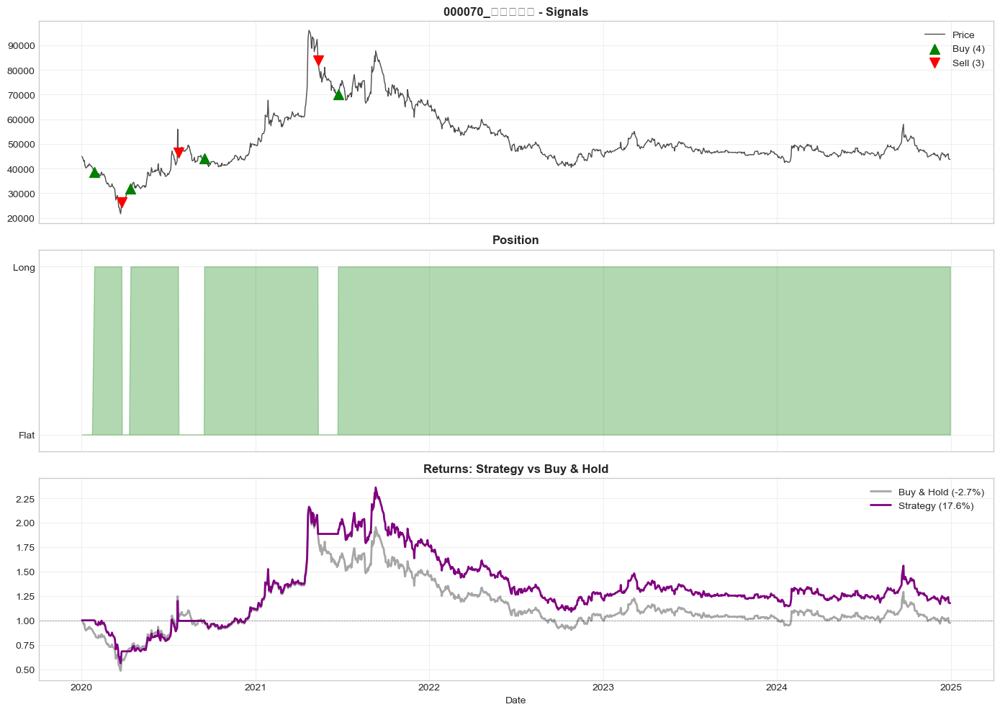


✓ Complete

[3/200] 000080_하이트진로.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 28900.00 → 19520.00

Strategy:  -44.93%  |  Market:  -32.46%  |  Excess:  -12.47%
Sharpe:    -0.280  |  Max DD:  -62.63%  |  Win:  44.2%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-02-10: SELL
  2020-02-19: BUY
  2020-03-09: SELL
  2020-04-23: BUY


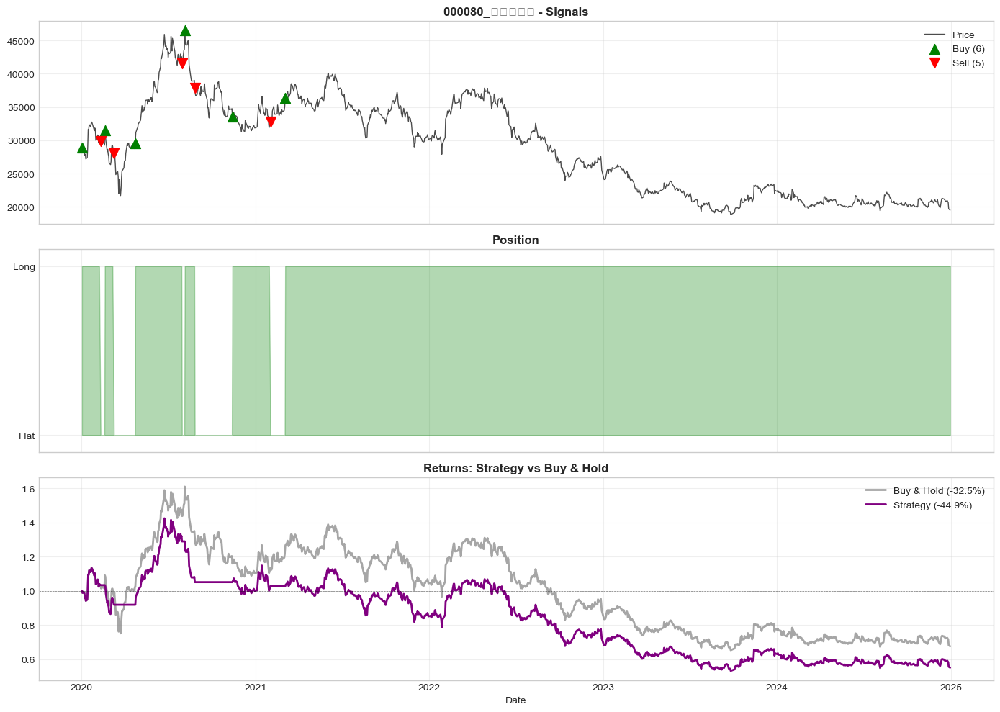


✓ Complete

[4/200] 000100_유한양행.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 38819.00 → 119500.00

Strategy:  199.74%  |  Market:  207.84%  |  Excess:   -8.10%
Sharpe:     0.923  |  Max DD:  -30.90%  |  Win:  44.6%  |  Trades:  12

First 5 trades:
  2020-01-02: BUY
  2020-06-29: SELL
  2020-07-14: BUY
  2020-09-01: SELL
  2020-09-03: BUY


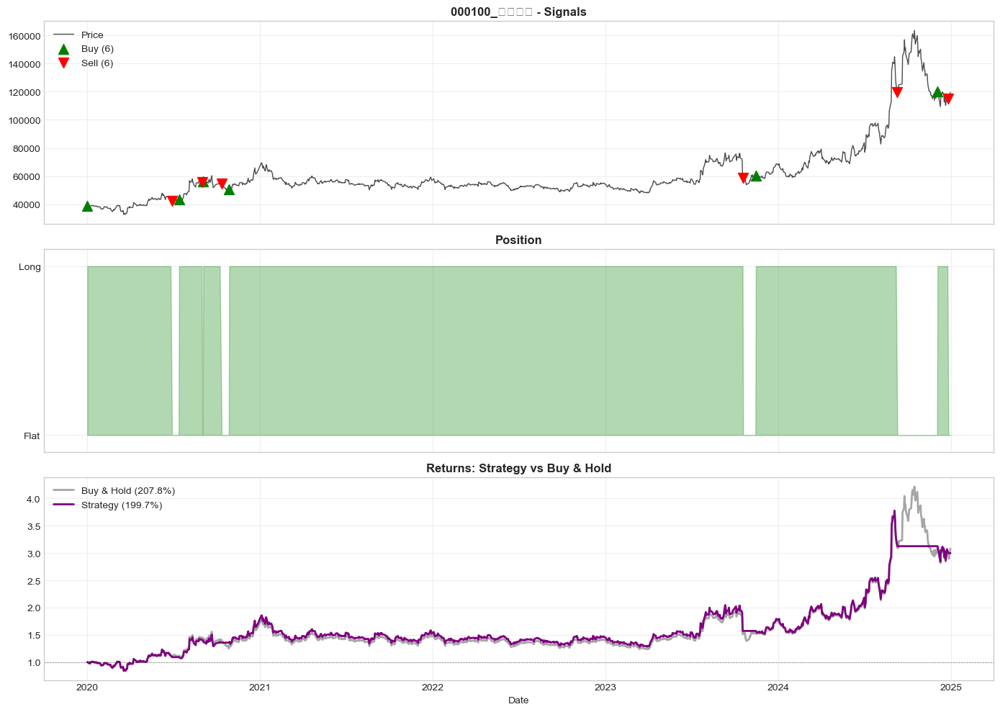


✓ Complete

[5/200] 000120_CJ대한통운.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 152500.00 → 84400.00

Strategy:  -42.66%  |  Market:  -44.66%  |  Excess:    2.00%
Sharpe:    -0.351  |  Max DD:  -64.49%  |  Win:  42.9%  |  Trades:  35

First 5 trades:
  2020-01-29: BUY
  2020-02-20: SELL
  2020-06-03: BUY
  2020-06-22: SELL
  2020-08-12: BUY


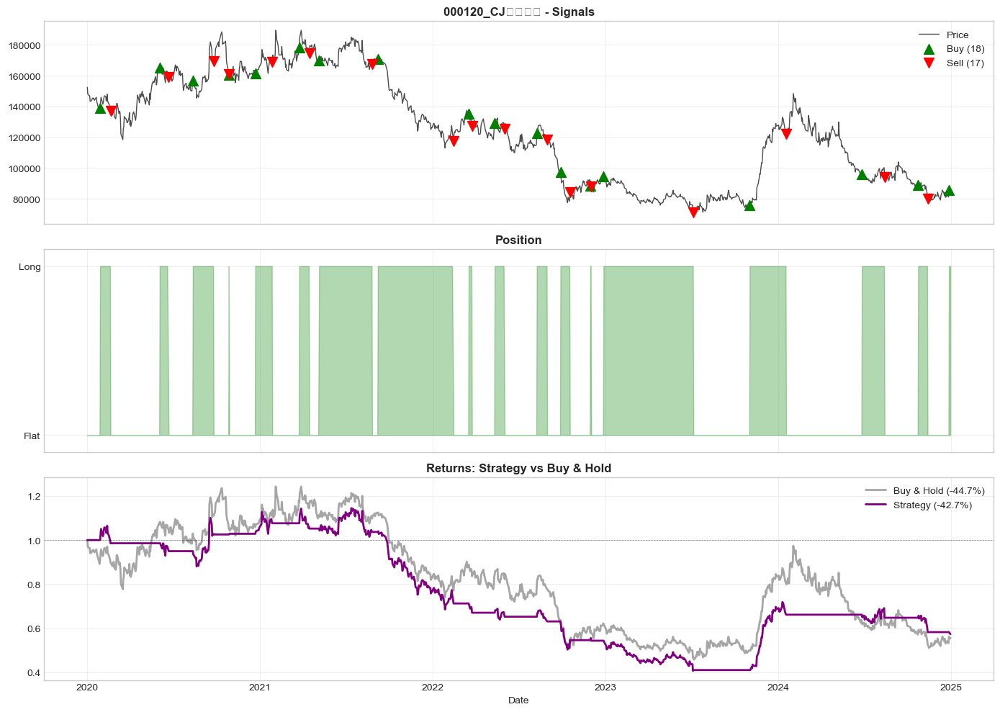


✓ Complete

[6/200] 000140_하이트진로홀딩스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 13200.00 → 9100.00

Strategy:   -6.65%  |  Market:  -31.06%  |  Excess:   24.41%
Sharpe:     0.030  |  Max DD:  -56.69%  |  Win:  43.5%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-10: SELL
  2020-04-21: BUY
  2020-07-08: SELL
  2020-11-13: BUY


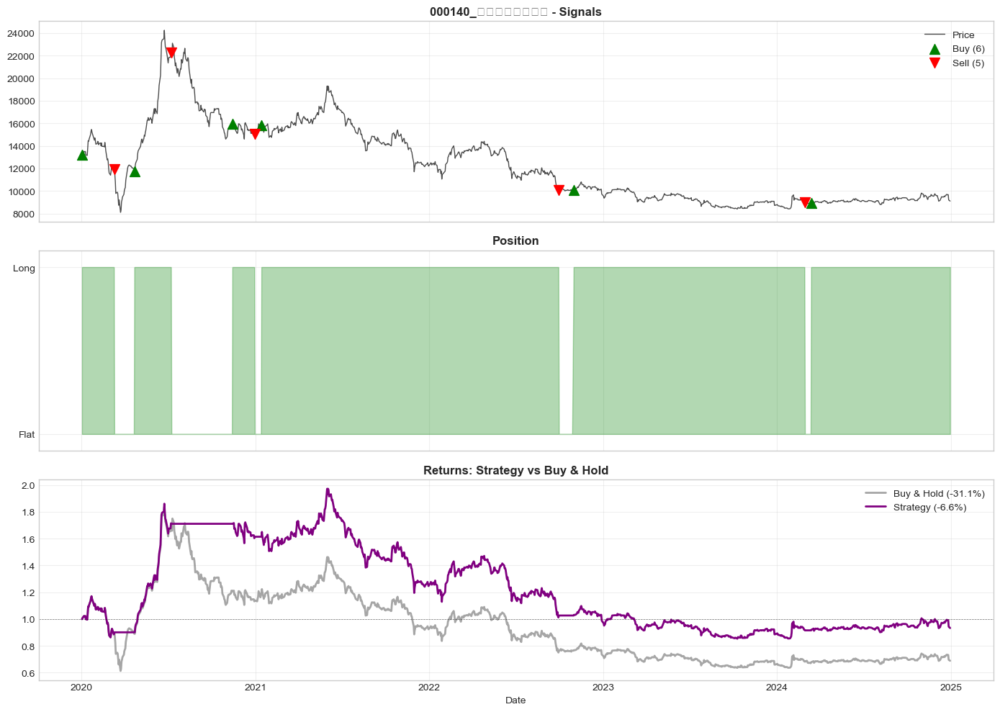


✓ Complete

[7/200] 000150_두산.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 68900.00 → 255000.00

Strategy:  133.09%  |  Market:  270.10%  |  Excess: -137.01%
Sharpe:     0.945  |  Max DD:  -67.03%  |  Win:  45.8%  |  Trades:  29

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-05-11: BUY
  2020-06-19: SELL
  2020-07-14: BUY


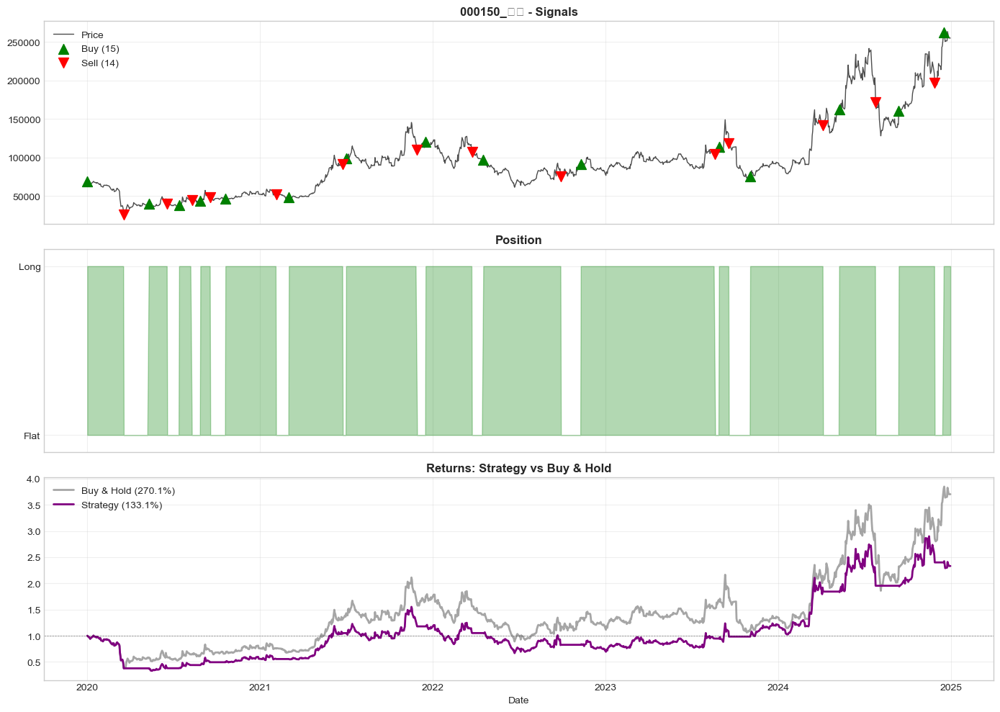


✓ Complete

[8/200] 000210_대림산업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 79337.00 → 31600.00

Strategy:  -70.31%  |  Market:  -60.17%  |  Excess:  -10.14%
Sharpe:    -0.439  |  Max DD:  -71.16%  |  Win:  42.4%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-22: BUY
  2020-09-21: SELL
  2020-10-08: BUY


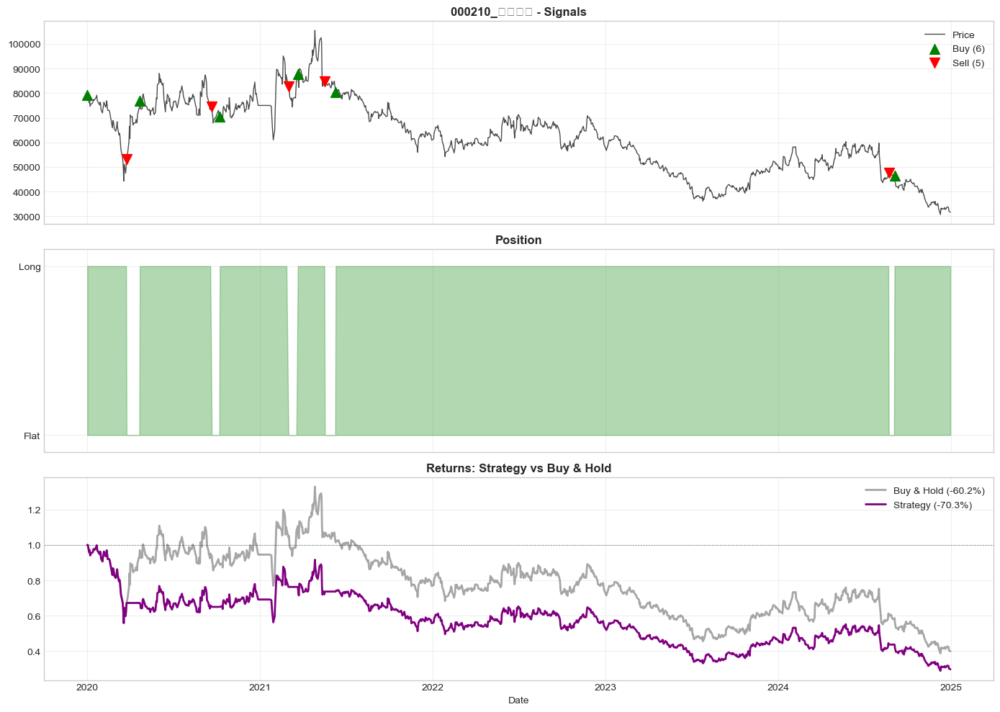


✓ Complete

[9/200] 000240_한국타이어월드와이드.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 14000.00 → 16920.00

Strategy:  -39.09%  |  Market:   20.86%  |  Excess:  -59.95%
Sharpe:     0.105  |  Max DD:  -62.70%  |  Win:  45.4%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-04-02: SELL
  2020-04-10: BUY
  2020-07-21: SELL
  2020-09-22: BUY


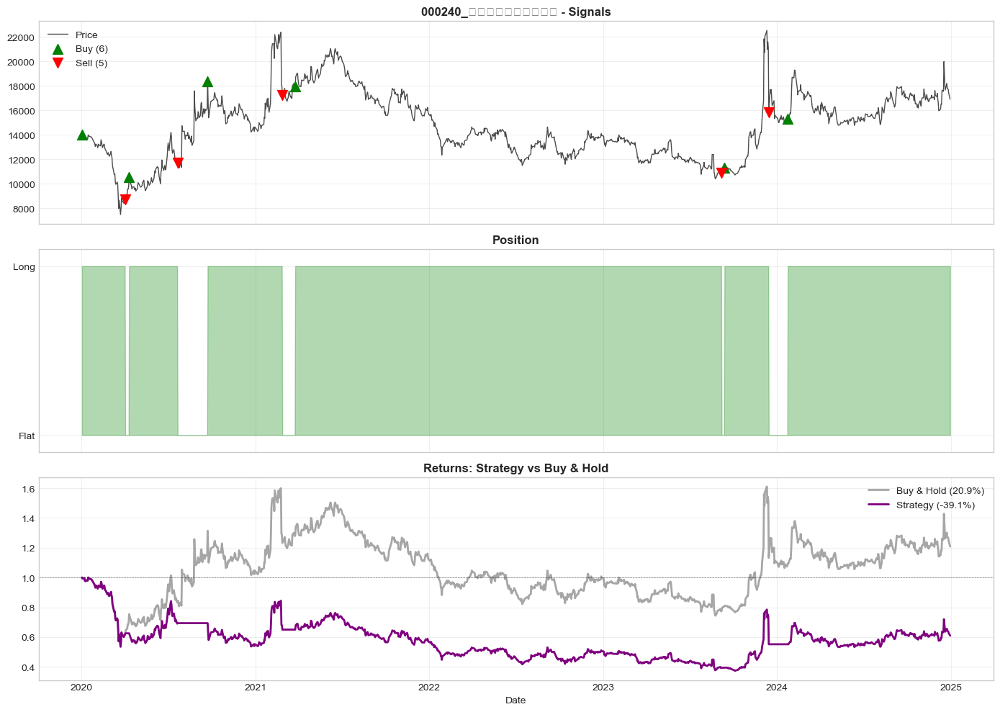


✓ Complete

[10/200] 000270_기아차.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 42500.00 → 100700.00

Strategy:   56.35%  |  Market:  136.94%  |  Excess:  -80.59%
Sharpe:     0.570  |  Max DD:  -50.46%  |  Win:  48.3%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-26: SELL
  2020-05-19: BUY
  2020-06-22: SELL
  2020-07-15: BUY


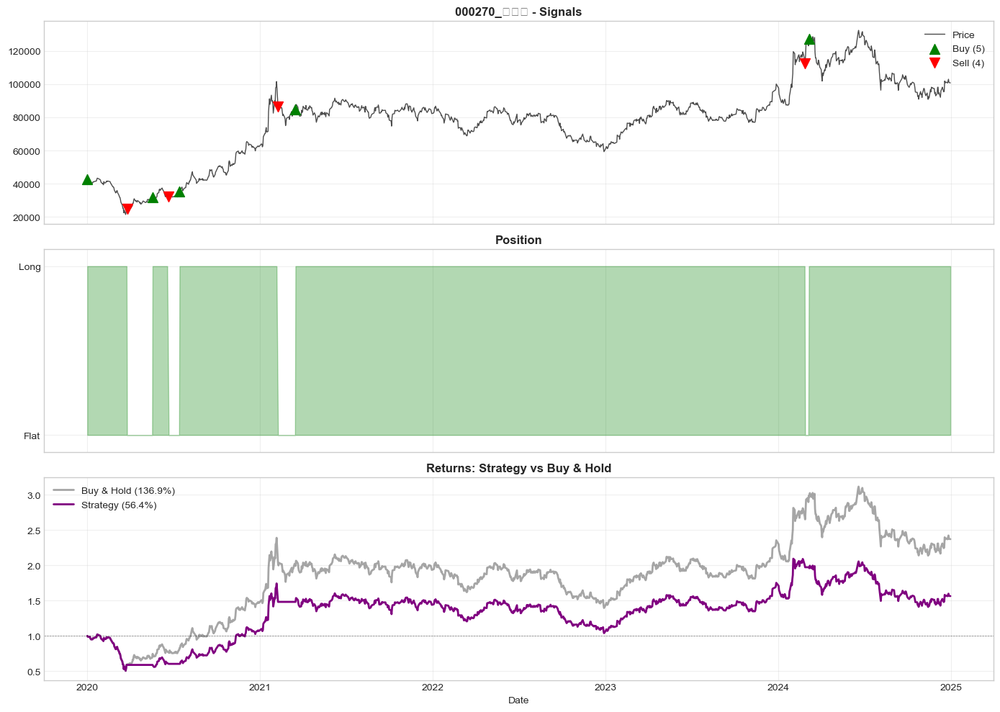


✓ Complete

[11/200] 000430_대원강업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 3410.00 → 3890.00

Strategy:   18.35%  |  Market:   14.08%  |  Excess:    4.27%
Sharpe:     0.414  |  Max DD:  -48.04%  |  Win:  47.0%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-04-01: SELL
  2020-04-10: BUY
  2023-06-05: SELL
  2023-06-26: BUY


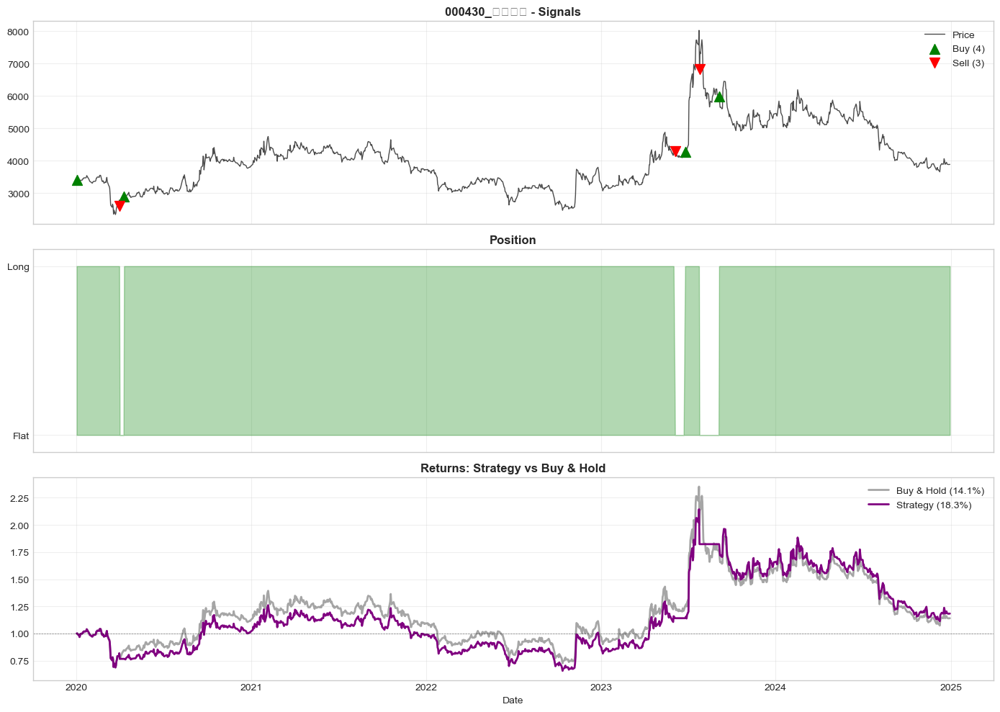


✓ Complete

[12/200] 000480_조선내화.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 8900.00 → 5700.00

Strategy:   72.30%  |  Market:  -35.96%  |  Excess:  108.26%
Sharpe:     0.642  |  Max DD:  -45.05%  |  Win:  44.0%  |  Trades:   9

First 5 trades:
  2020-01-31: BUY
  2023-04-25: SELL
  2023-06-05: BUY
  2023-07-18: SELL
  2023-07-26: BUY


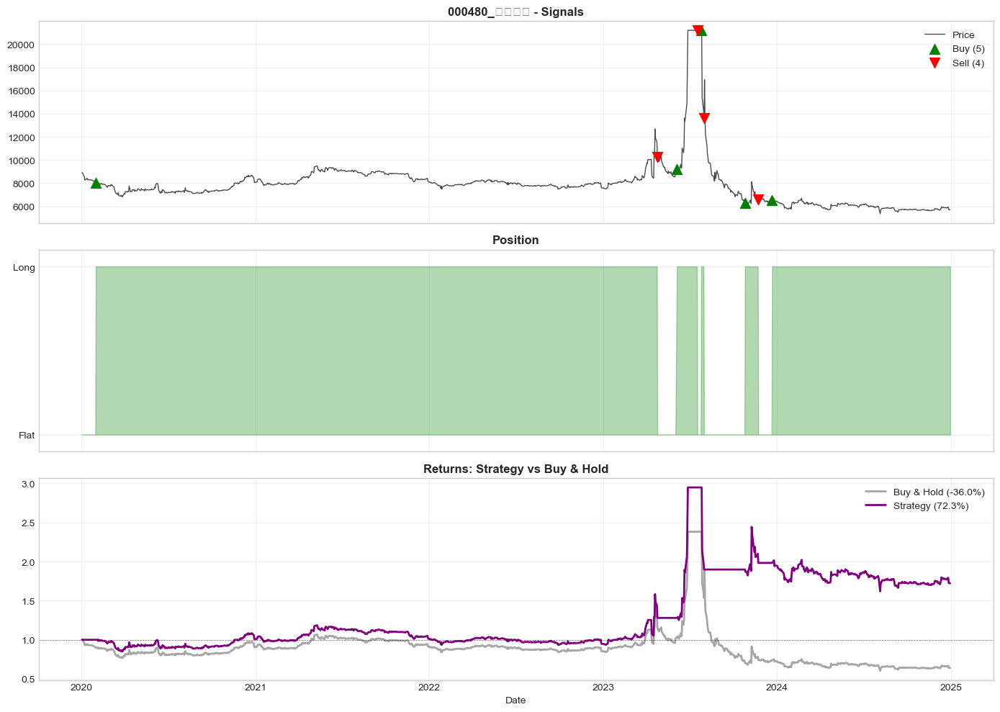


✓ Complete

[13/200] 000640_동아쏘시오홀딩스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 100542.00 → 106662.00

Strategy:  -23.78%  |  Market:    6.09%  |  Excess:  -29.87%
Sharpe:    -0.085  |  Max DD:  -42.40%  |  Win:  44.2%  |  Trades:  21

First 5 trades:
  2020-01-02: BUY
  2020-03-30: SELL
  2020-04-10: BUY
  2020-06-01: SELL
  2020-07-20: BUY


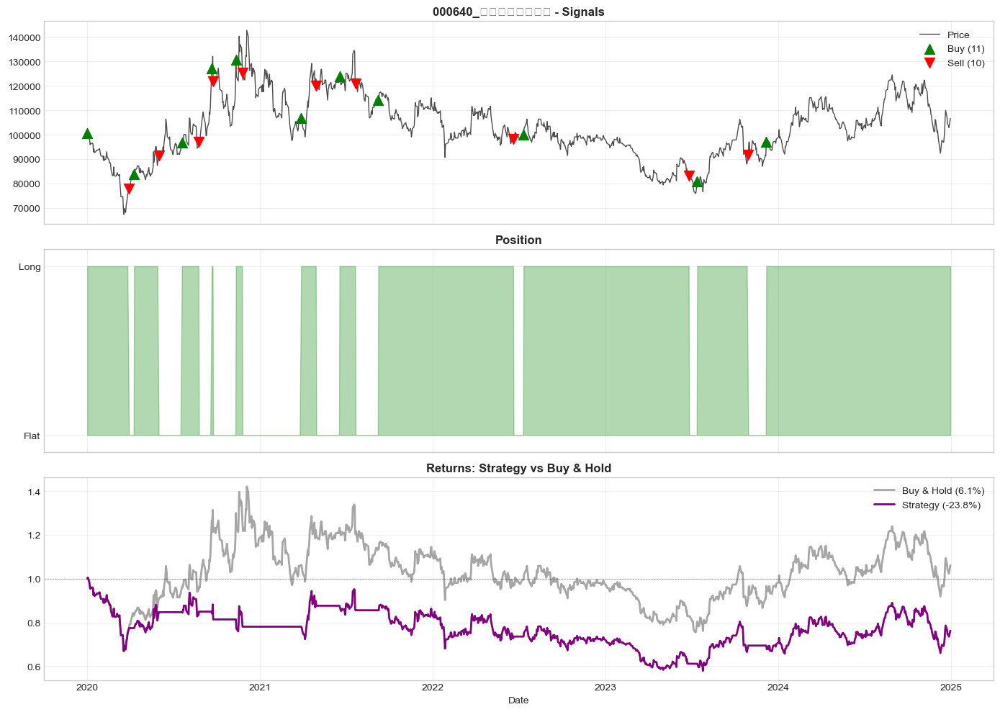


✓ Complete

[14/200] 000660_SK하이닉스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 94700.00 → 173900.00

Strategy:   18.51%  |  Market:   83.63%  |  Excess:  -65.12%
Sharpe:     0.302  |  Max DD:  -51.79%  |  Win:  45.9%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-05-08: BUY
  2021-03-15: SELL
  2021-04-06: BUY


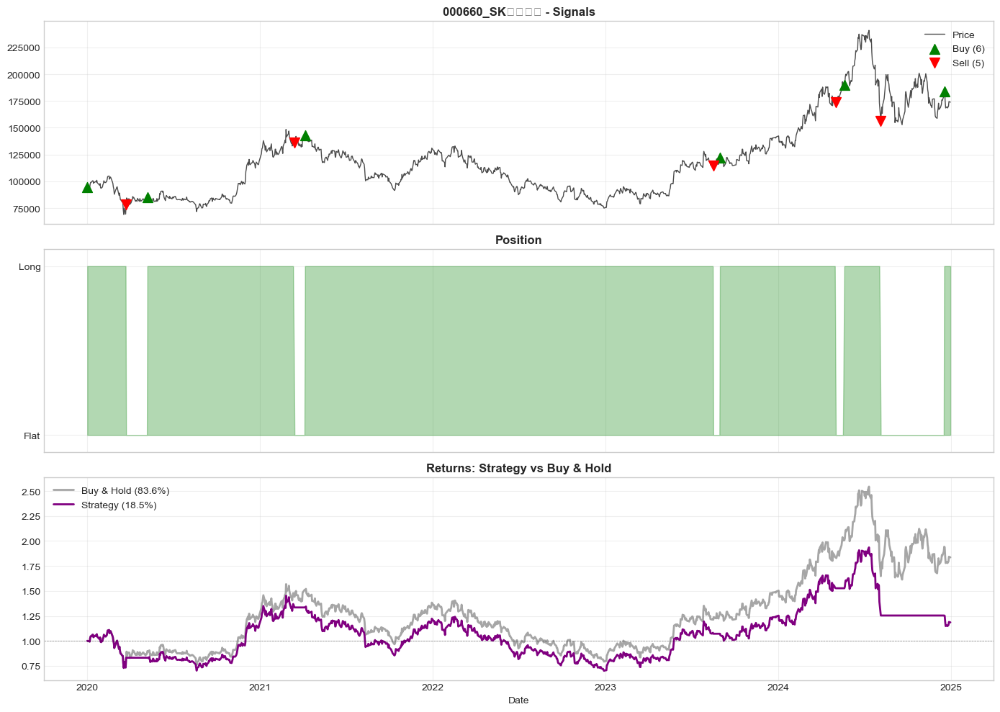


✓ Complete

[15/200] 000670_영풍.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 62571.00 → 38450.00

Strategy:  -44.68%  |  Market:  -38.55%  |  Excess:   -6.13%
Sharpe:    -0.015  |  Max DD:  -62.04%  |  Win:  45.1%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2022-12-06: SELL
  2022-12-26: BUY
  2024-09-24: SELL
  2024-11-07: BUY


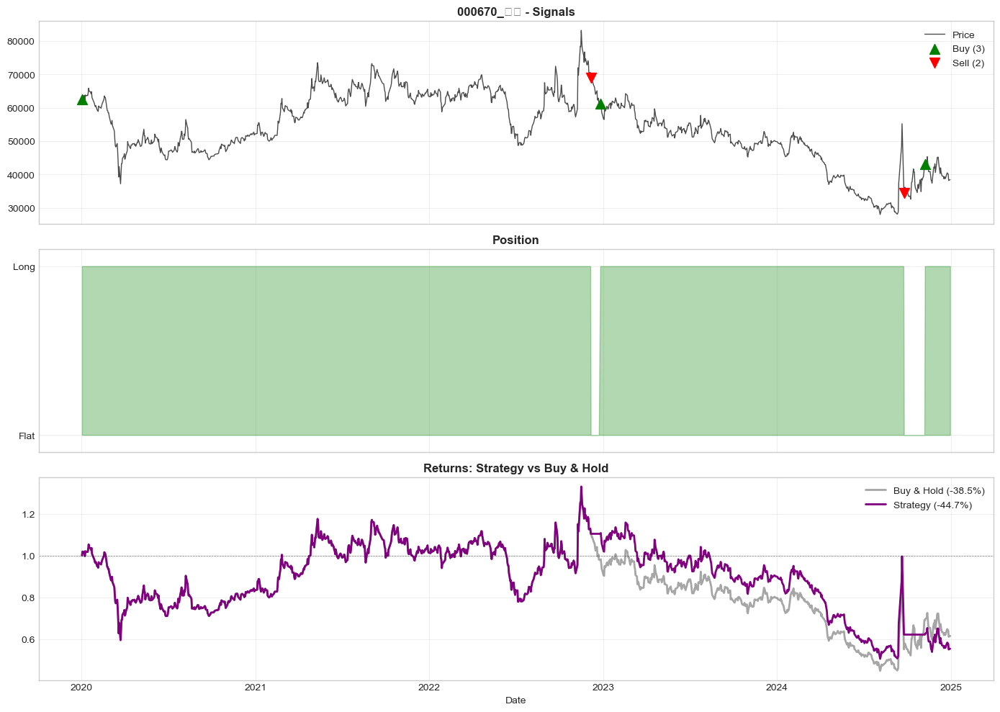


✓ Complete

[16/200] 000720_현대건설.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 40086.00 → 25400.00

Strategy:  -59.48%  |  Market:  -36.64%  |  Excess:  -22.84%
Sharpe:    -0.411  |  Max DD:  -62.33%  |  Win:  45.3%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-17: BUY


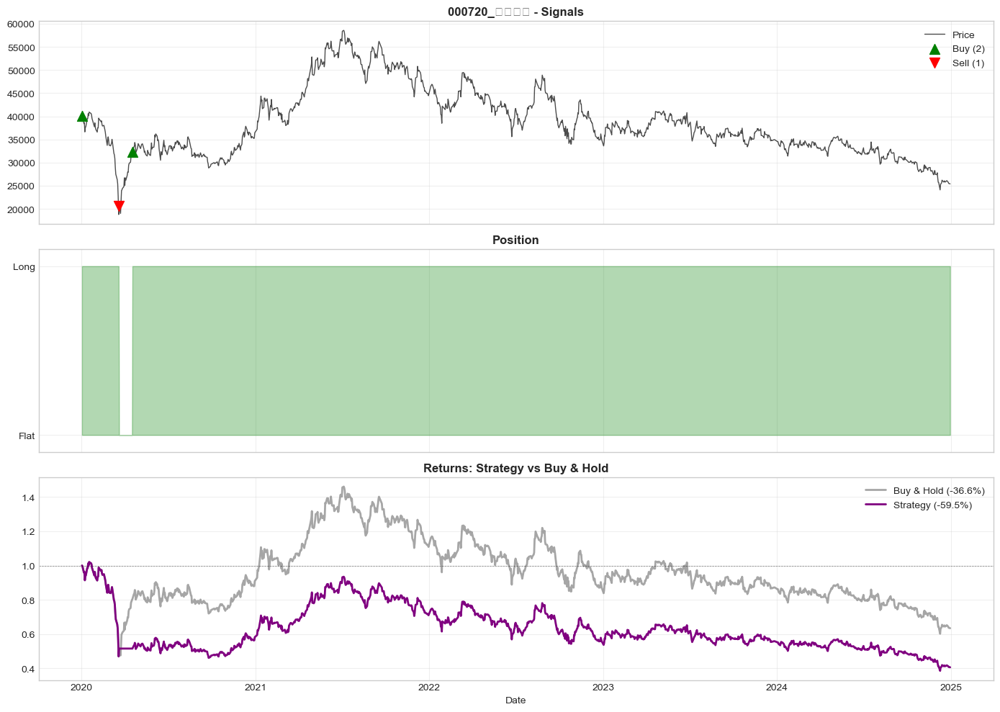


✓ Complete

[17/200] 000810_삼성화재.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 238500.00 → 358500.00

Strategy:   -2.47%  |  Market:   50.31%  |  Excess:  -52.78%
Sharpe:     0.168  |  Max DD:  -47.17%  |  Win:  47.3%  |  Trades:  14

First 5 trades:
  2020-01-02: BUY
  2020-03-27: SELL
  2020-05-14: BUY
  2020-06-22: SELL
  2020-07-15: BUY


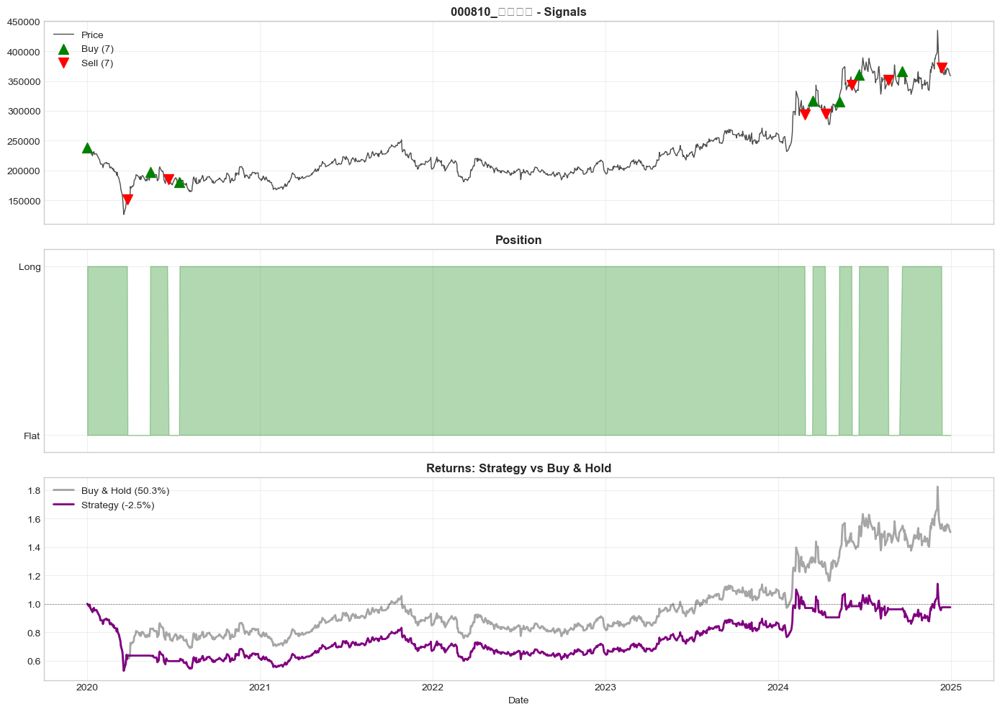


✓ Complete

[18/200] 000830_삼성물산.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[19/200] 000880_한화.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 24350.00 → 26900.00

Strategy:  -28.72%  |  Market:   10.47%  |  Excess:  -39.19%
Sharpe:     0.135  |  Max DD:  -48.79%  |  Win:  45.0%  |  Trades:  11

First 5 trades:
  2020-01-30: BUY
  2020-03-23: SELL
  2020-04-21: BUY
  2020-06-15: SELL
  2020-07-15: BUY


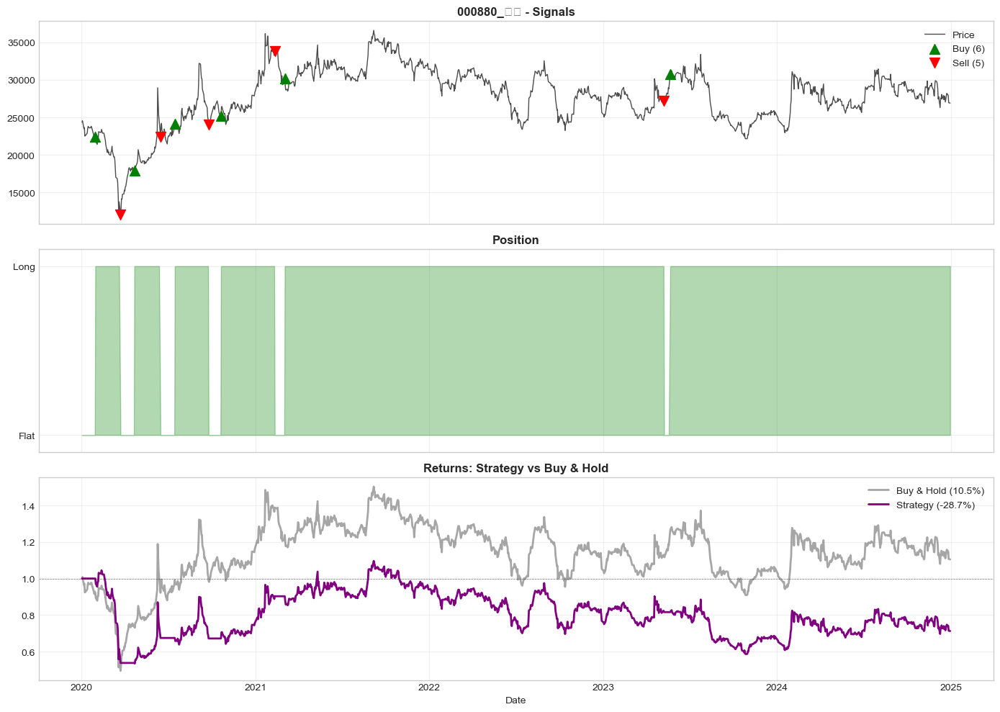


✓ Complete

[20/200] 000990_동부하이텍.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 27900.00 → 33150.00

Strategy:   -2.45%  |  Market:   18.82%  |  Excess:  -21.26%
Sharpe:     0.388  |  Max DD:  -75.24%  |  Win:  45.6%  |  Trades:  17

First 5 trades:
  2020-04-22: BUY
  2020-06-09: SELL
  2020-07-03: BUY
  2020-09-04: SELL
  2020-09-16: BUY


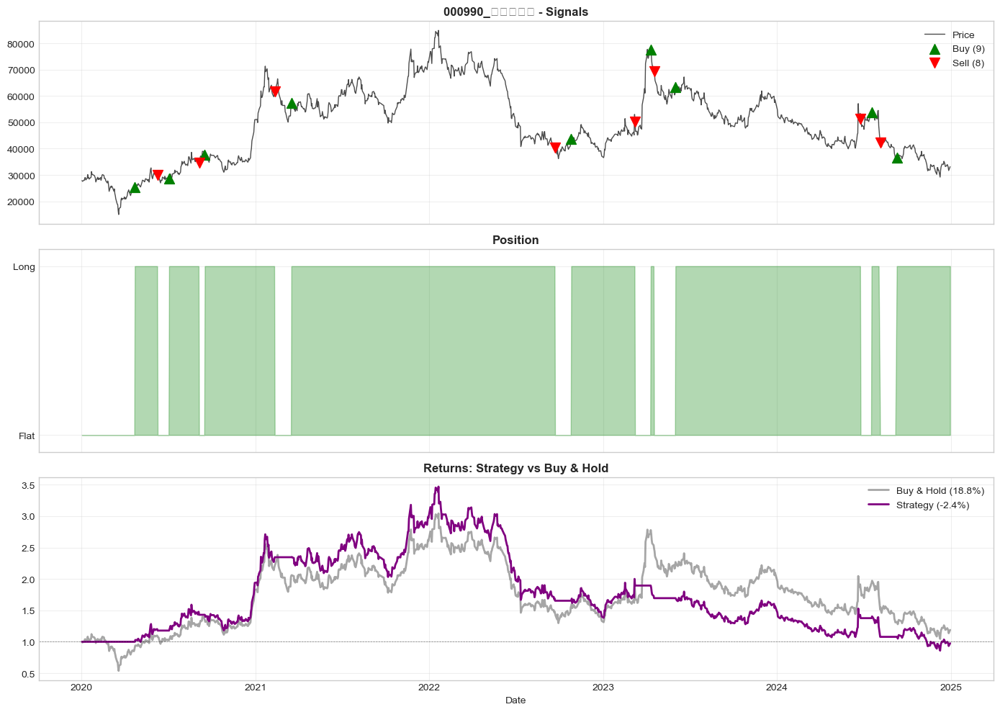


✓ Complete

[21/200] 001040_CJ.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 93800.00 → 99100.00

Strategy:  -46.21%  |  Market:    5.65%  |  Excess:  -51.86%
Sharpe:    -0.180  |  Max DD:  -47.53%  |  Win:  44.3%  |  Trades:  19

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-22: BUY
  2020-09-02: SELL
  2020-09-16: BUY


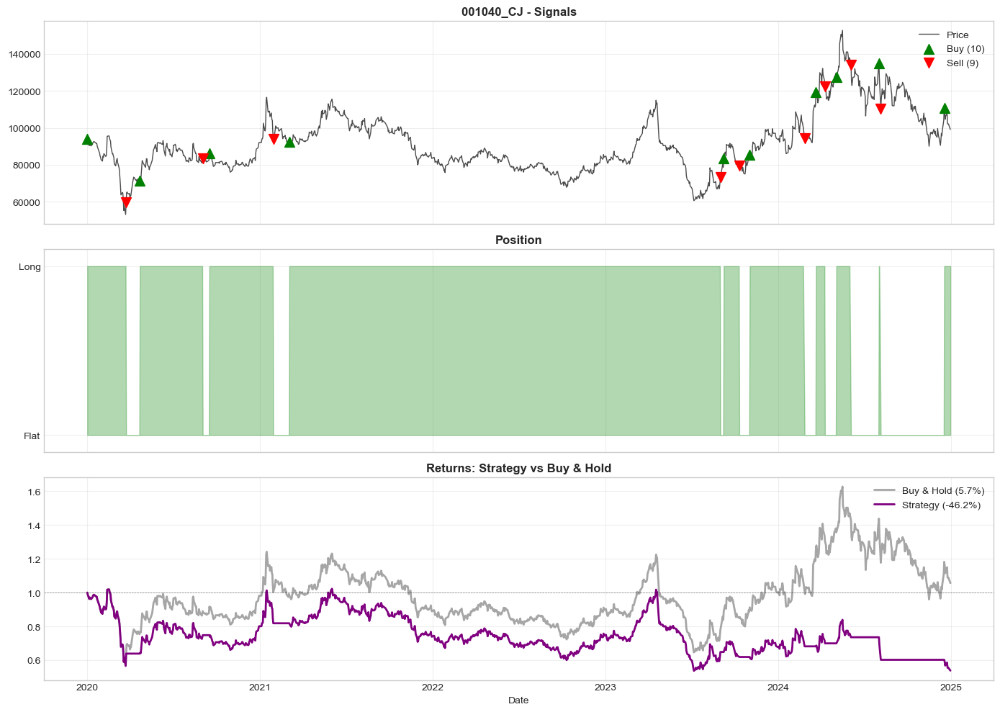


✓ Complete

[22/200] 001120_LG상사.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 15000.00 → 27050.00

Strategy:   52.97%  |  Market:   80.33%  |  Excess:  -27.36%
Sharpe:     0.487  |  Max DD:  -50.37%  |  Win:  48.0%  |  Trades:  11

First 5 trades:
  2020-01-30: BUY
  2020-03-27: SELL
  2020-05-08: BUY
  2020-07-08: SELL
  2020-07-17: BUY


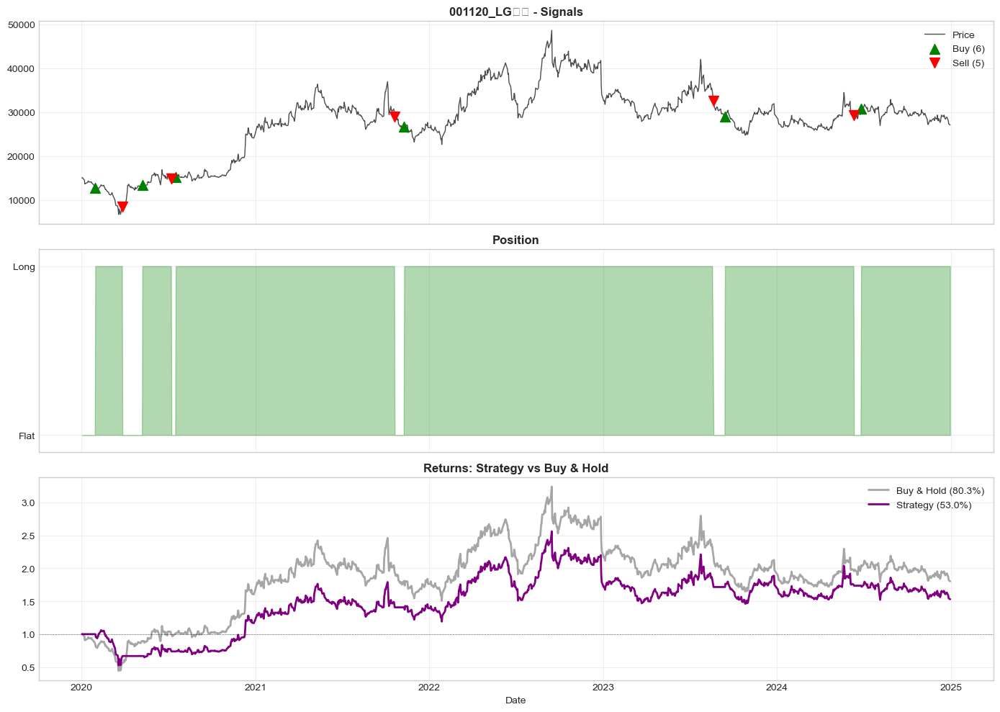


✓ Complete

[23/200] 001230_동국제강.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4978.00 → 7370.00

Strategy:  104.01%  |  Market:   48.05%  |  Excess:   55.96%
Sharpe:     0.565  |  Max DD:  -60.45%  |  Win:  45.9%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2020-03-30: SELL
  2020-04-20: BUY
  2020-06-23: SELL
  2020-07-15: BUY


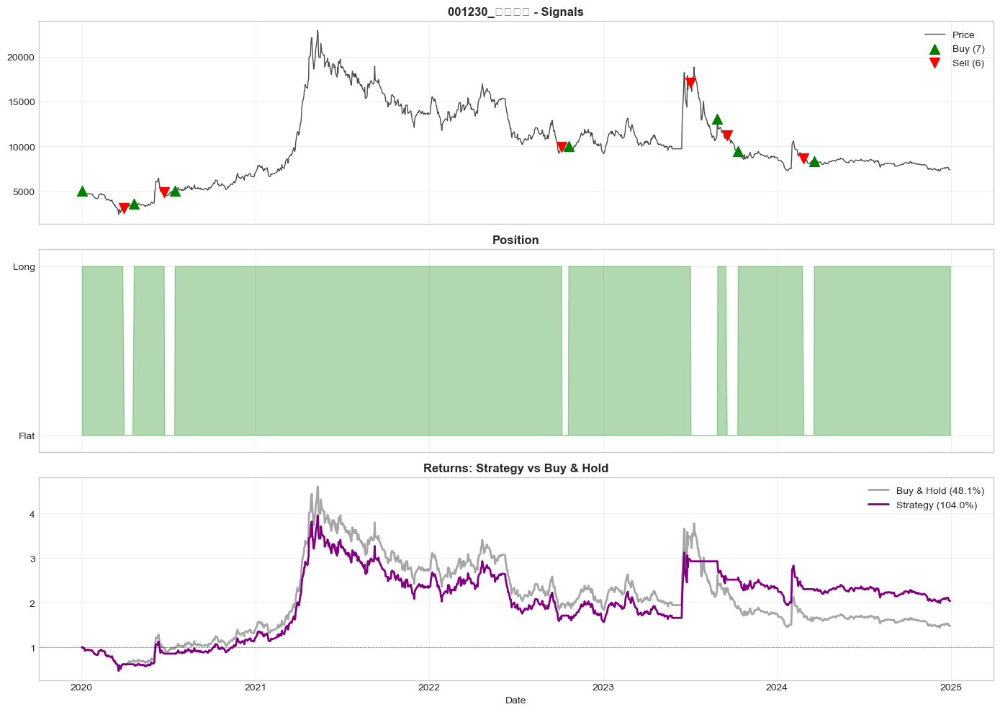


✓ Complete

[24/200] 001430_세아베스틸.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 15000.00 → 19760.00

Strategy:   -1.43%  |  Market:   31.73%  |  Excess:  -33.16%
Sharpe:     0.306  |  Max DD:  -64.27%  |  Win:  46.1%  |  Trades:  16

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-17: BUY
  2020-06-04: SELL
  2020-07-15: BUY


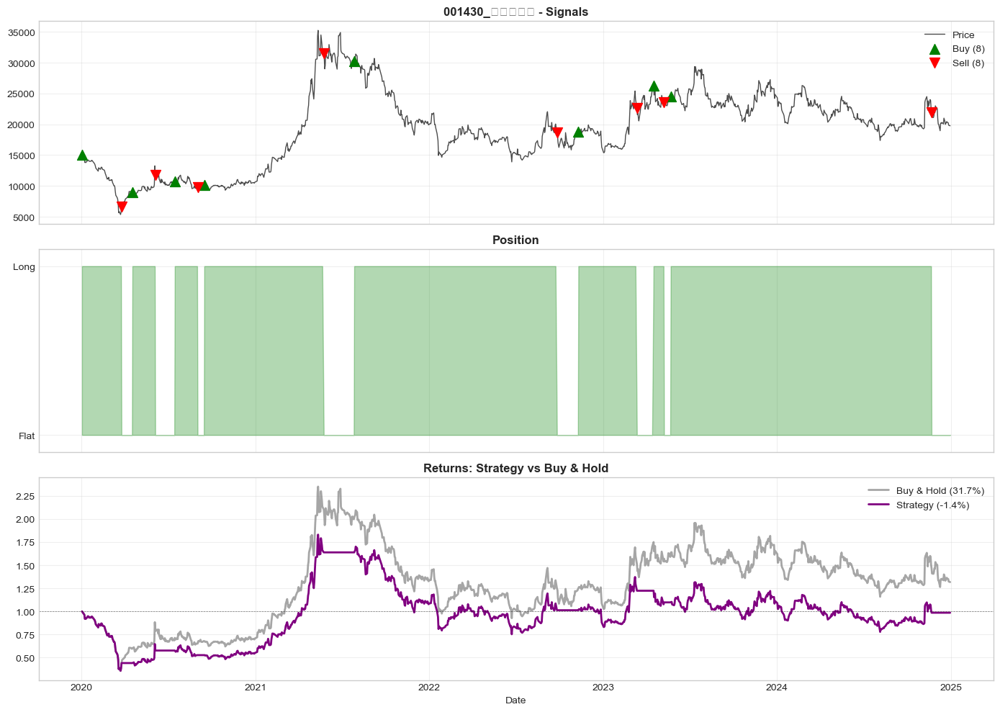


✓ Complete

[25/200] 001440_대한전선.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 5495.00 → 11150.00

Strategy:  154.70%  |  Market:  102.91%  |  Excess:   51.79%
Sharpe:     0.672  |  Max DD:  -71.77%  |  Win:  43.5%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-08-07: SELL
  2020-08-31: BUY
  2021-06-23: SELL
  2021-07-22: BUY


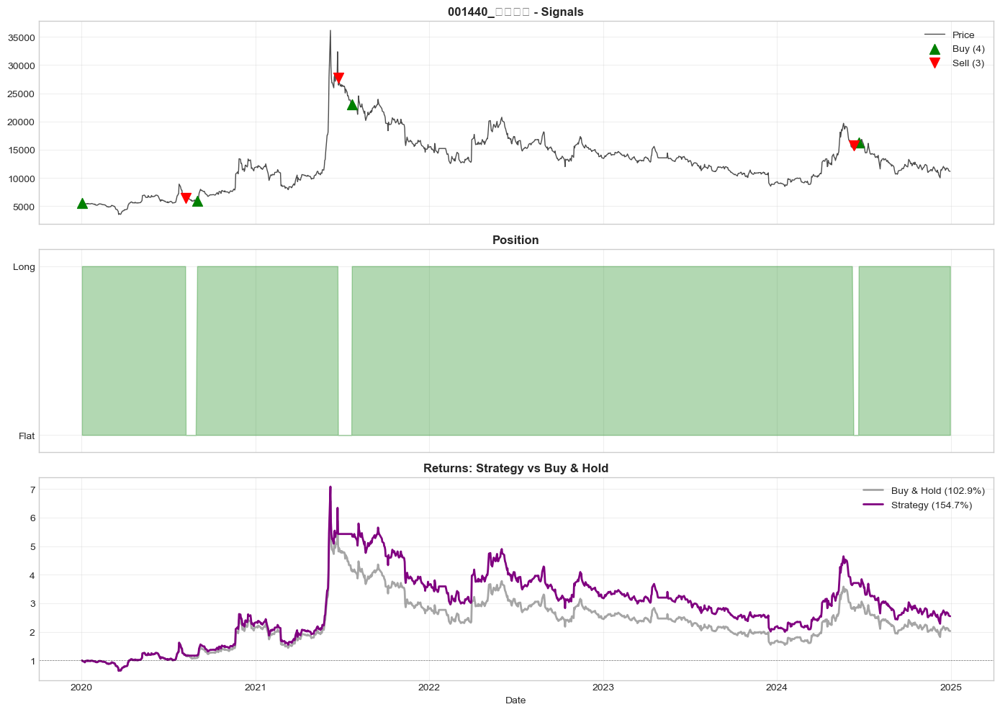


✓ Complete

[26/200] 001680_대상.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 22900.00 → 19190.00

Strategy:  -21.19%  |  Market:  -16.20%  |  Excess:   -4.99%
Sharpe:    -0.063  |  Max DD:  -47.61%  |  Win:  43.8%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-17: BUY
  2020-06-04: SELL
  2020-06-15: BUY


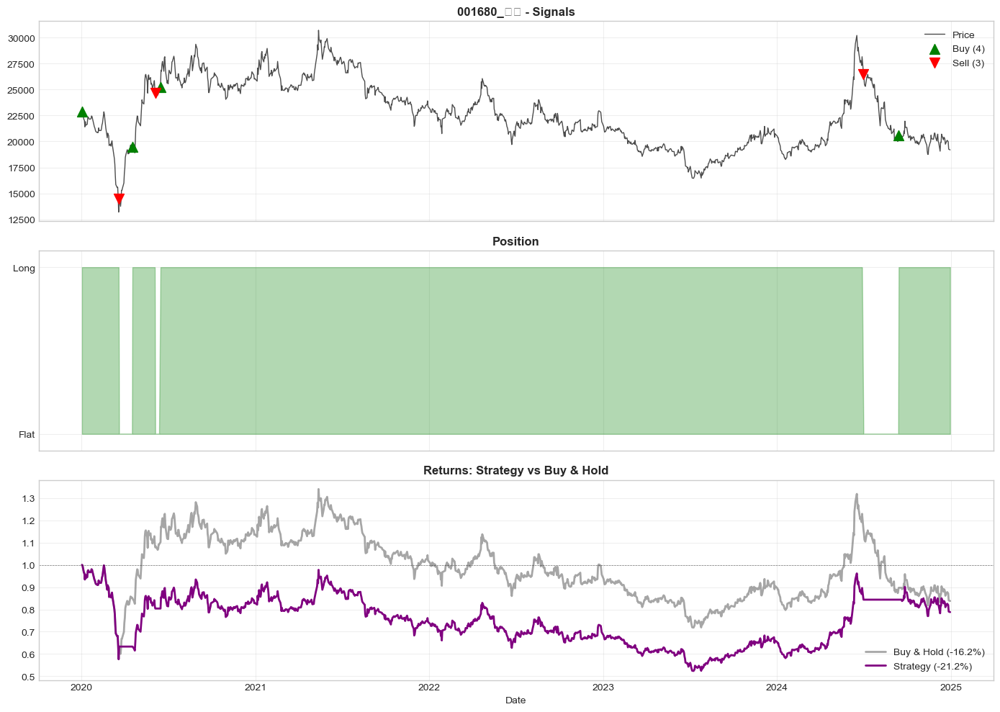


✓ Complete

[27/200] 001740_SK네트웍스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 5900.00 → 4150.00

Strategy:   -9.87%  |  Market:  -29.66%  |  Excess:   19.79%
Sharpe:     0.123  |  Max DD:  -36.74%  |  Win:  45.2%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2020-03-16: SELL
  2020-04-20: BUY
  2021-01-28: SELL
  2021-02-22: BUY


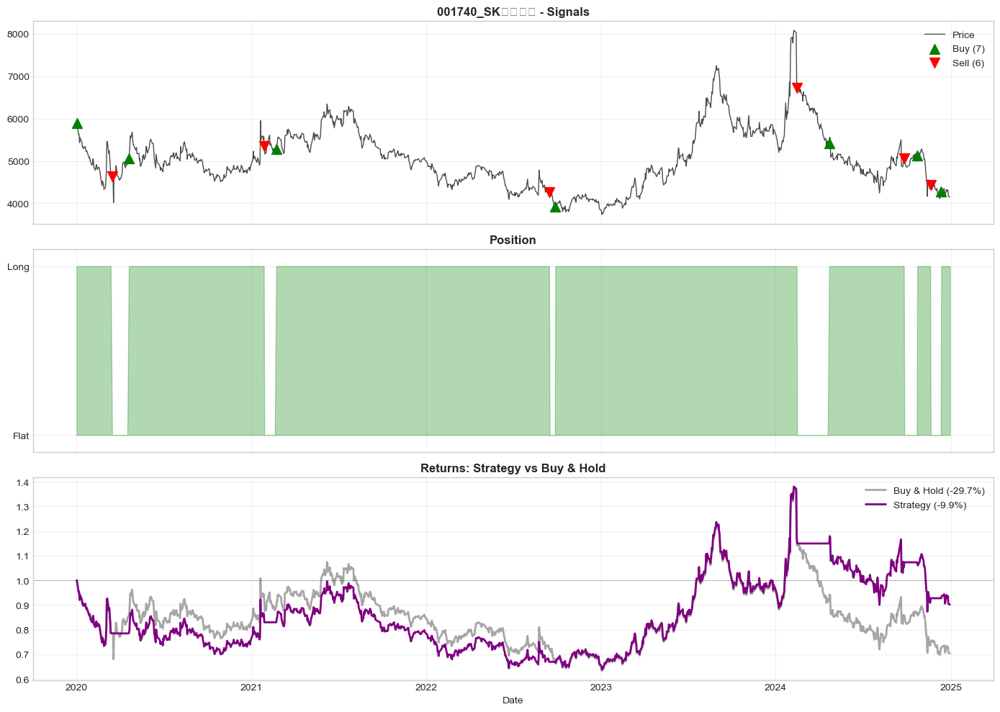


✓ Complete

[28/200] 001800_오리온.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 17550.00 → 15060.00

Strategy:  -14.57%  |  Market:  -14.19%  |  Excess:   -0.38%
Sharpe:    -0.126  |  Max DD:  -32.21%  |  Win:  44.4%  |  Trades:   3

First 5 trades:
  2020-02-25: BUY
  2020-03-25: SELL
  2020-05-15: BUY


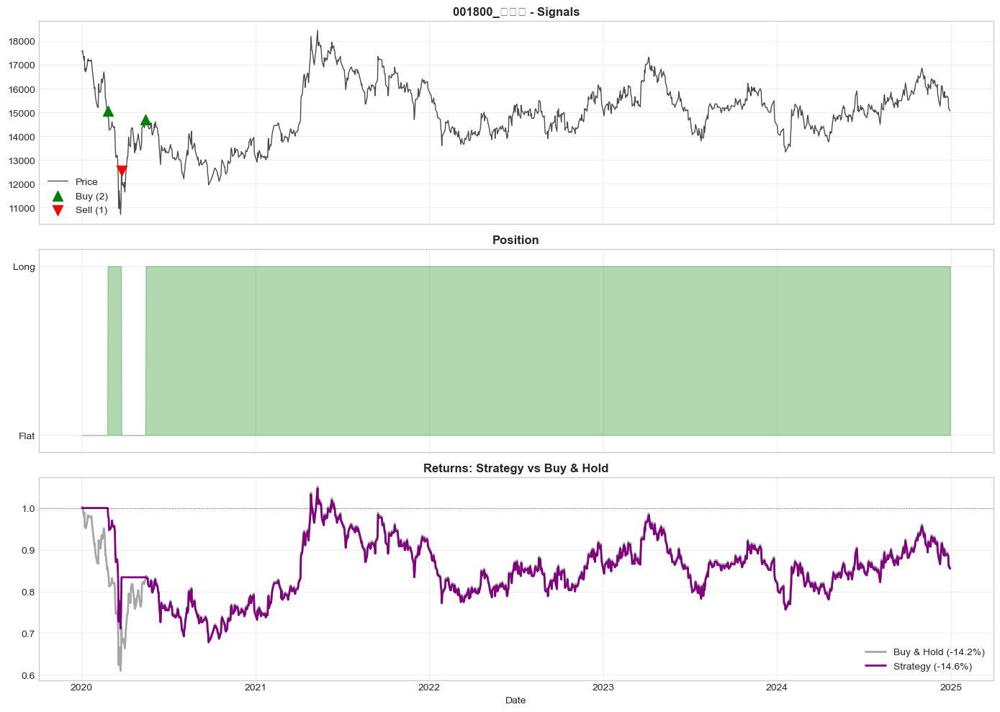


✓ Complete

[29/200] 002020_코오롱.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 17850.00 → 14030.00

Strategy:  -26.13%  |  Market:  -21.40%  |  Excess:   -4.73%
Sharpe:     0.119  |  Max DD:  -72.82%  |  Win:  44.2%  |  Trades:   9

First 5 trades:
  2020-02-17: BUY
  2020-03-26: SELL
  2020-04-10: BUY
  2020-04-20: SELL
  2020-06-03: BUY


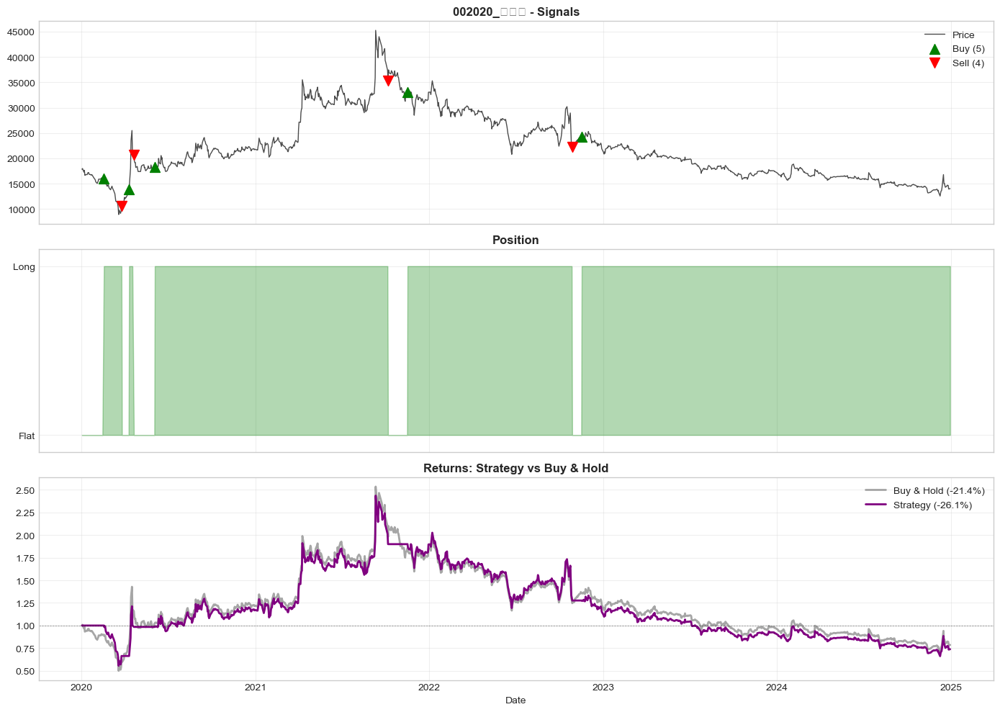


✓ Complete

[30/200] 002240_고려제강.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 15240.00 → 17850.00

Strategy:   48.40%  |  Market:   17.13%  |  Excess:   31.28%
Sharpe:     0.447  |  Max DD:  -45.46%  |  Win:  44.4%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-06-18: SELL
  2020-07-13: BUY
  2022-05-19: SELL
  2022-06-17: BUY


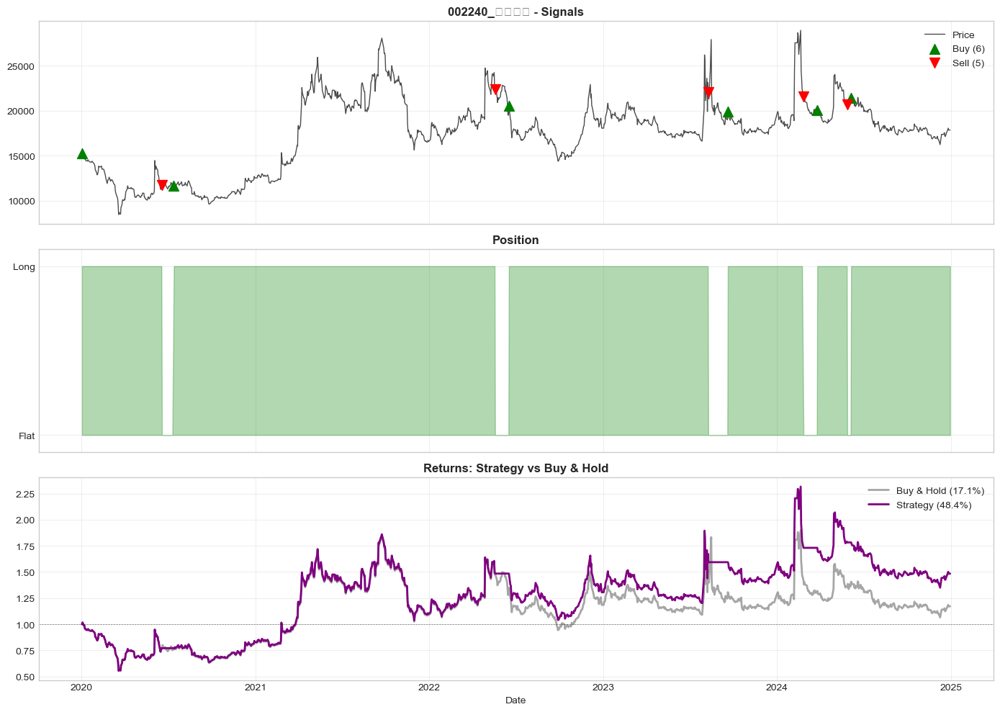


✓ Complete

[31/200] 002270_롯데푸드.parquet
Data: 630 days (2020-01-02 to 2022-07-19)
Price: 405000.00 → 311000.00

Strategy:  -41.11%  |  Market:  -23.21%  |  Excess:  -17.90%
Sharpe:    -0.865  |  Max DD:  -47.70%  |  Win:  41.4%  |  Trades:   5

First 5 trades:
  2020-02-04: BUY
  2020-03-25: SELL
  2020-05-11: BUY
  2021-03-10: SELL
  2021-03-29: BUY


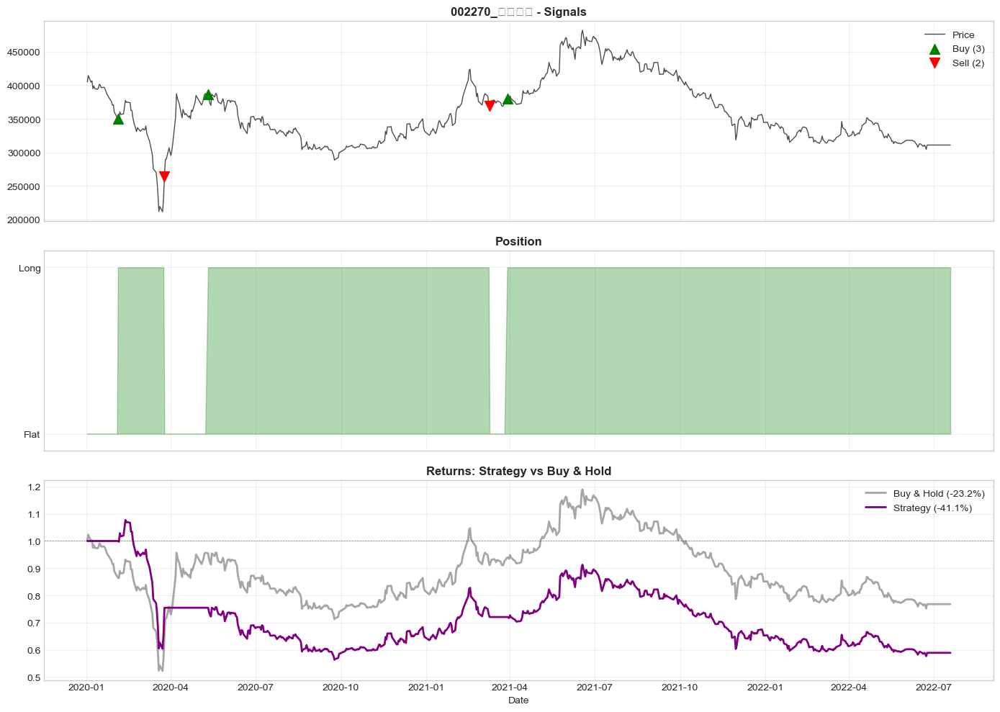


✓ Complete

[32/200] 002350_넥센타이어.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 8900.00 → 6010.00

Strategy:  -56.22%  |  Market:  -32.47%  |  Excess:  -23.74%
Sharpe:    -0.145  |  Max DD:  -63.25%  |  Win:  45.0%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-04-20: BUY
  2021-07-19: SELL
  2021-08-04: BUY


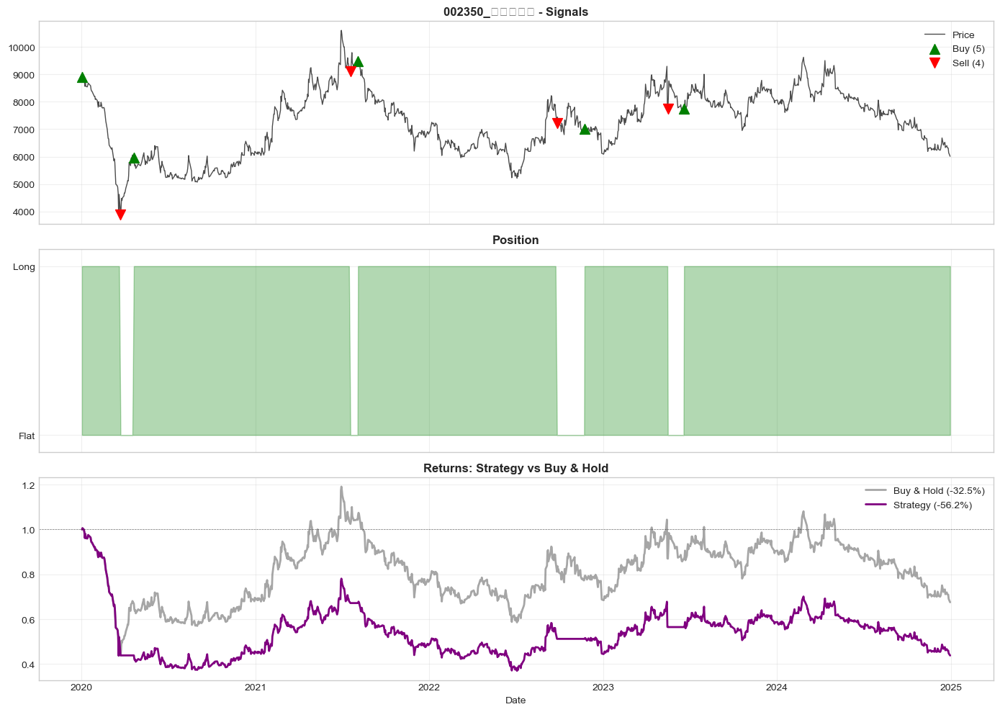


✓ Complete

[33/200] 002380_KCC.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 205000.00 → 235500.00

Strategy:   71.84%  |  Market:   14.88%  |  Excess:   56.97%
Sharpe:     0.751  |  Max DD:  -54.28%  |  Win:  45.9%  |  Trades:  22

First 5 trades:
  2020-01-02: BUY
  2020-02-18: SELL
  2020-05-29: BUY
  2020-06-15: SELL
  2020-07-03: BUY


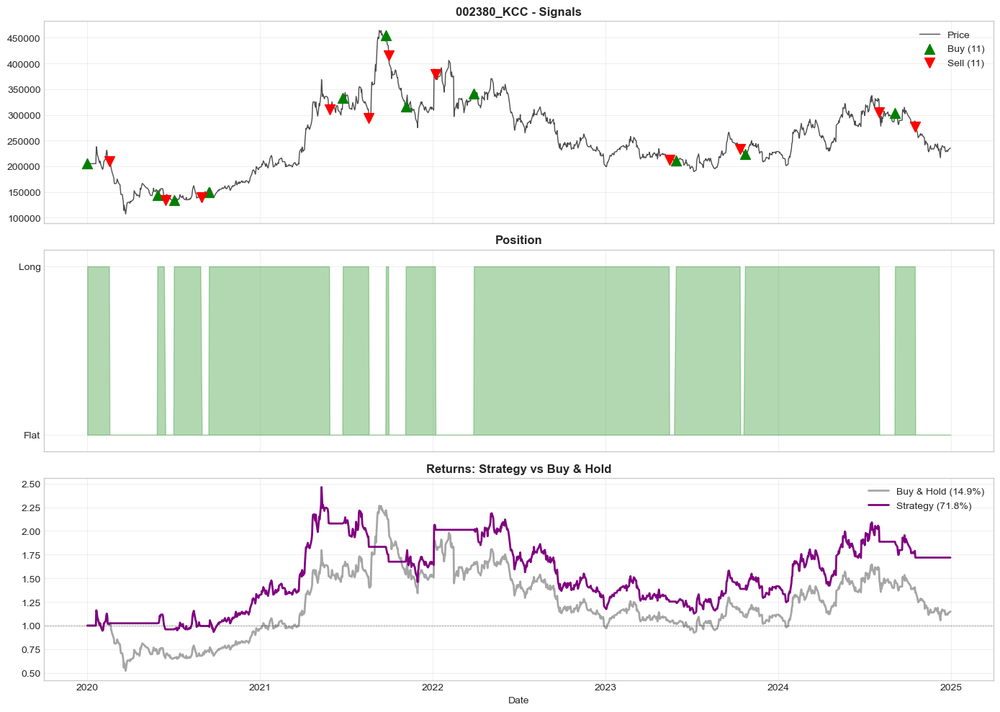


✓ Complete

[34/200] 002790_아모레G.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 83200.00 → 20800.00

Strategy:  -73.49%  |  Market:  -75.00%  |  Excess:    1.51%
Sharpe:    -0.527  |  Max DD:  -73.87%  |  Win:  45.8%  |  Trades:  19

First 5 trades:
  2020-03-05: BUY
  2020-03-24: SELL
  2020-05-19: BUY
  2022-05-19: SELL
  2022-05-31: BUY


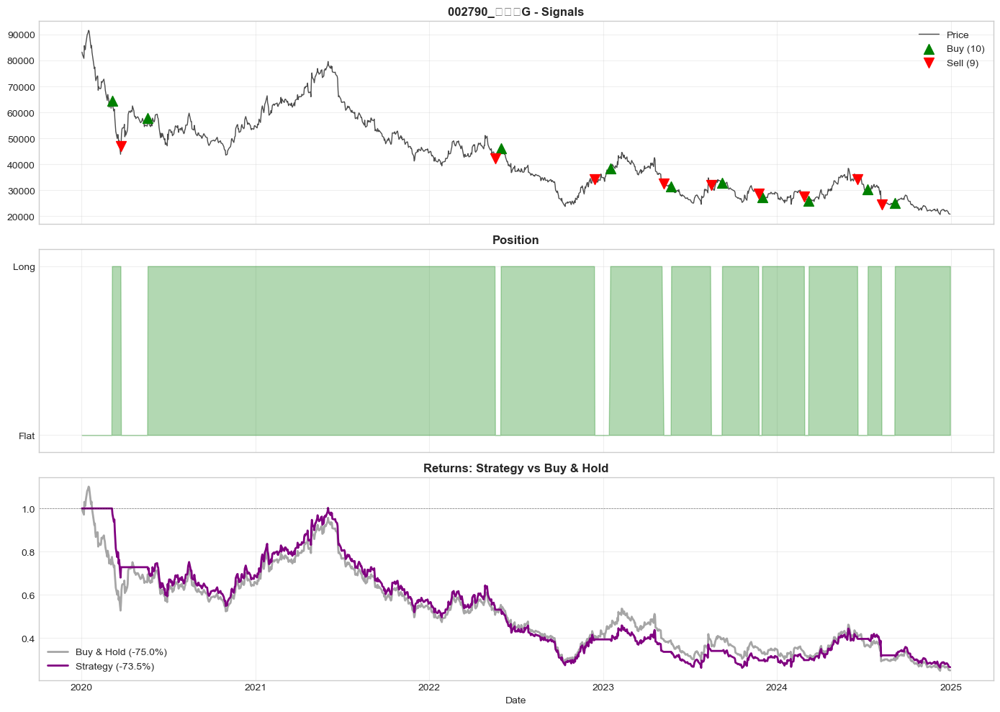


✓ Complete

[35/200] 002960_한국쉘석유.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 320000.00 → 318500.00

Strategy:   -0.53%  |  Market:   -0.47%  |  Excess:   -0.06%
Sharpe:    -0.028  |  Max DD:  -36.90%  |  Win:  43.4%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-17: SELL
  2020-04-29: BUY
  2021-01-13: SELL
  2021-02-02: BUY


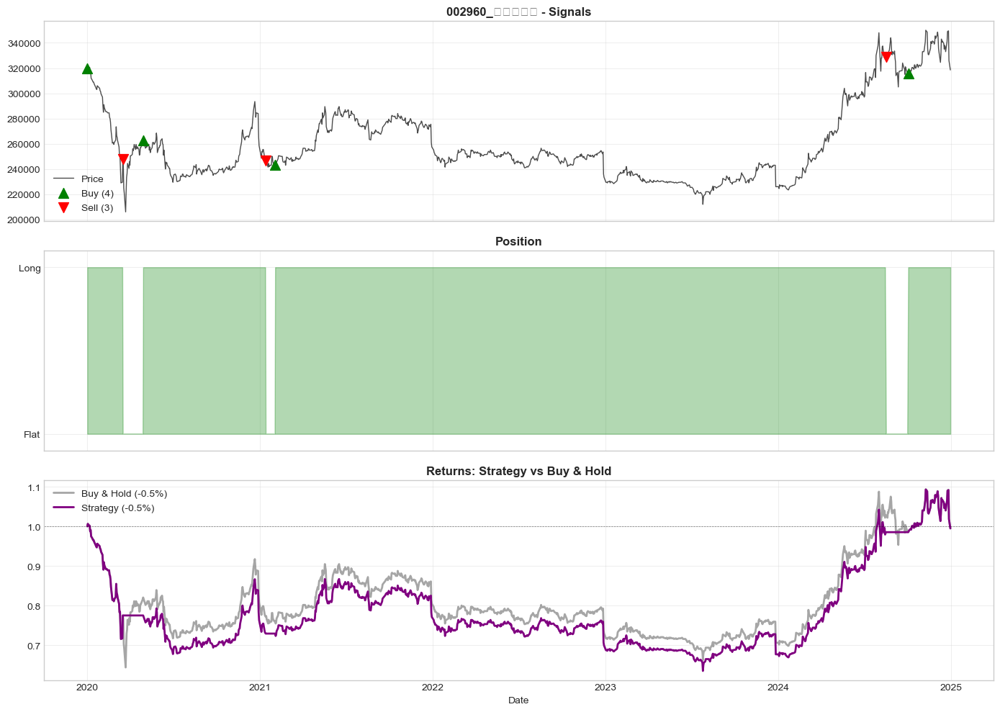


✓ Complete

[36/200] 003000_부광약품.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 11735.00 → 4195.00

Strategy:  -82.27%  |  Market:  -64.25%  |  Excess:  -18.01%
Sharpe:    -0.420  |  Max DD:  -90.27%  |  Win:  42.3%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-06-08: BUY
  2020-06-29: SELL
  2020-07-14: BUY


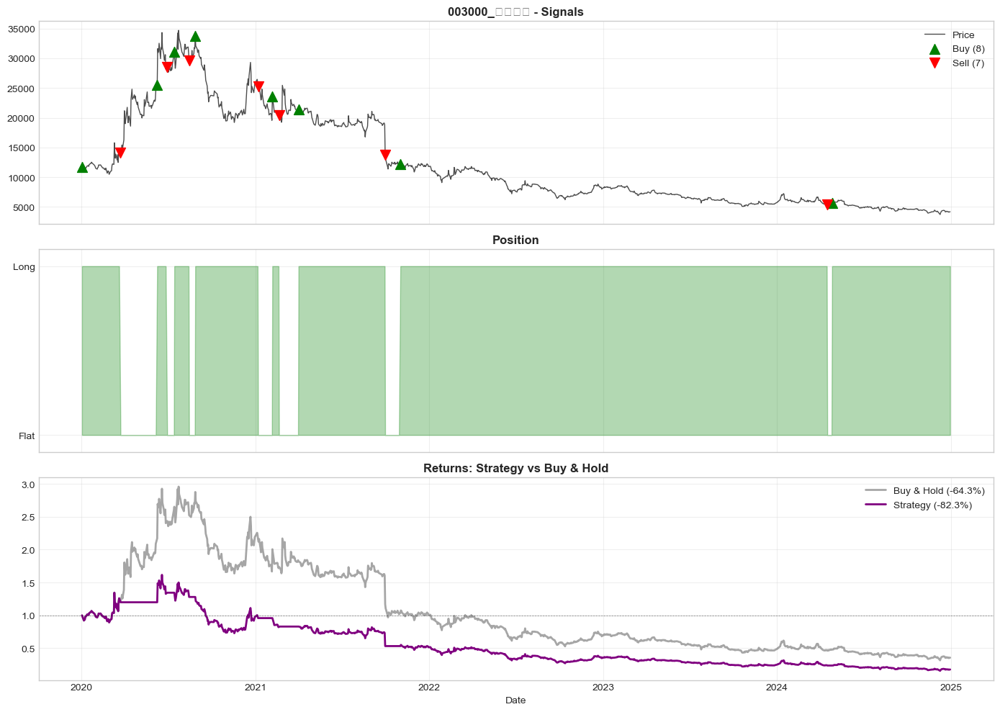


✓ Complete

[37/200] 003030_세아제강.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 47300.00 → 180500.00

Strategy:  153.54%  |  Market:  281.61%  |  Excess: -128.07%
Sharpe:     0.839  |  Max DD:  -58.77%  |  Win:  47.2%  |  Trades:  22

First 5 trades:
  2020-01-02: BUY
  2020-03-26: SELL
  2020-04-17: BUY
  2021-05-18: SELL
  2021-06-14: BUY


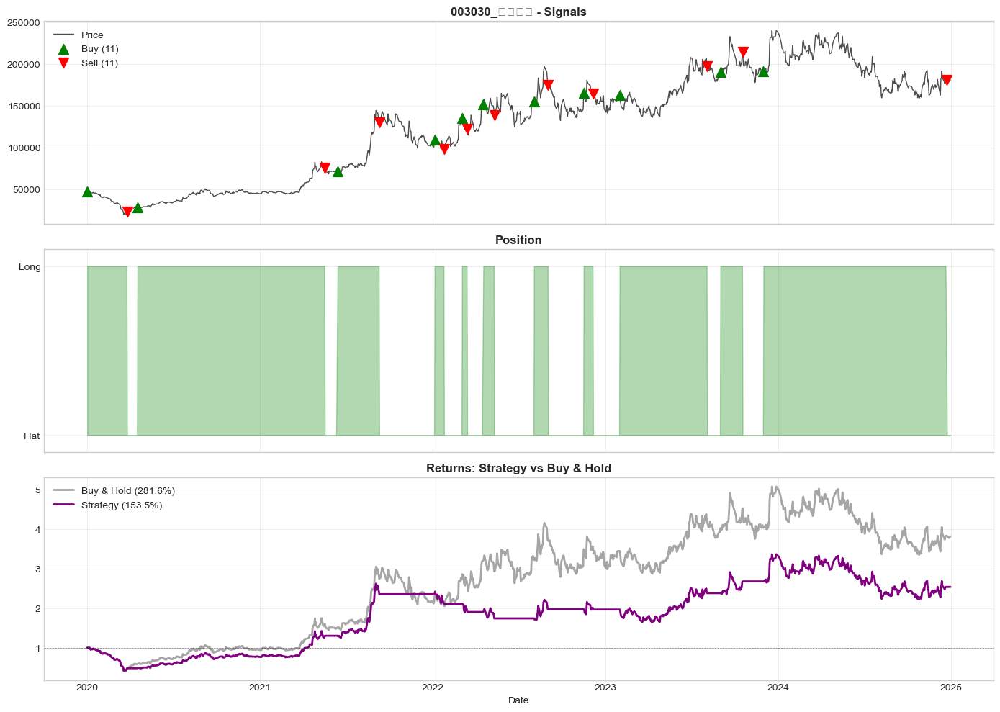


✓ Complete

[38/200] 003240_태광산업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 1065000.00 → 607000.00

Strategy:  -39.44%  |  Market:  -43.00%  |  Excess:    3.56%
Sharpe:    -0.275  |  Max DD:  -56.92%  |  Win:  42.4%  |  Trades:   9

First 5 trades:
  2020-01-30: BUY
  2020-03-25: SELL
  2020-04-20: BUY
  2020-06-26: SELL
  2020-07-15: BUY


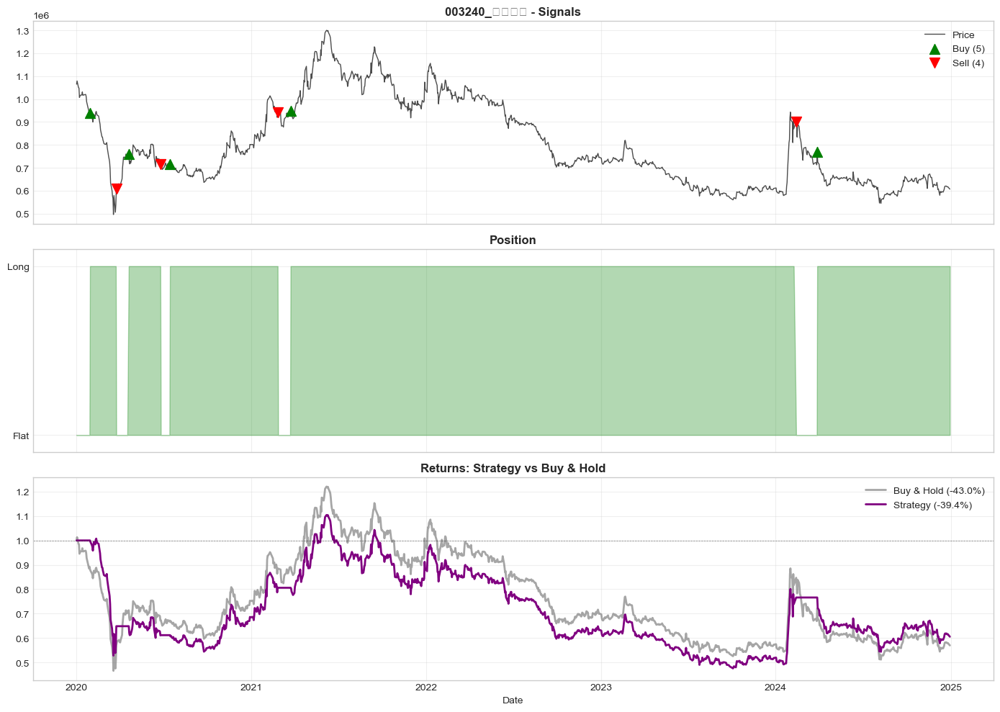


✓ Complete

[39/200] 003300_한일시멘트.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 8008.00 → 14000.00

Strategy:   90.79%  |  Market:   74.83%  |  Excess:   15.97%
Sharpe:     0.937  |  Max DD:  -20.47%  |  Win:  47.8%  |  Trades:  23

First 5 trades:
  2020-03-06: BUY
  2020-03-13: SELL
  2020-04-10: BUY
  2020-06-15: SELL
  2020-07-13: BUY


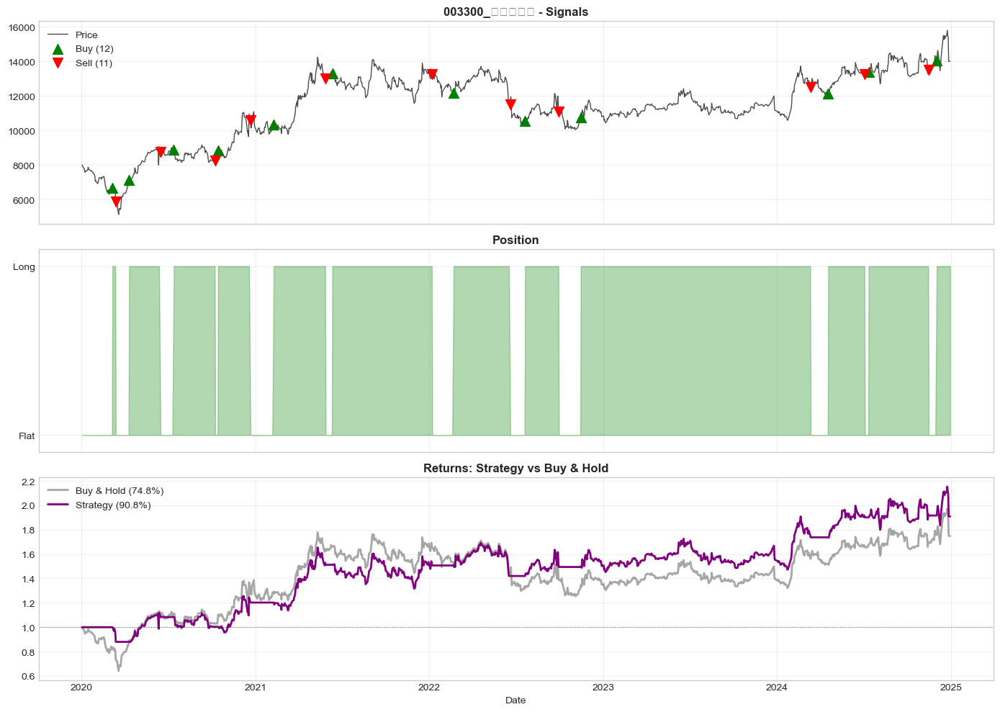


✓ Complete

[40/200] 003410_쌍용양회.parquet
Data: 1114 days (2020-01-02 to 2024-07-08)
Price: 6080.00 → 7000.00

Strategy:   19.79%  |  Market:   15.13%  |  Excess:    4.66%
Sharpe:     0.400  |  Max DD:  -43.95%  |  Win:  43.1%  |  Trades:   9

First 5 trades:
  2020-01-29: BUY
  2020-03-18: SELL
  2020-04-20: BUY
  2020-05-15: SELL
  2020-05-26: BUY


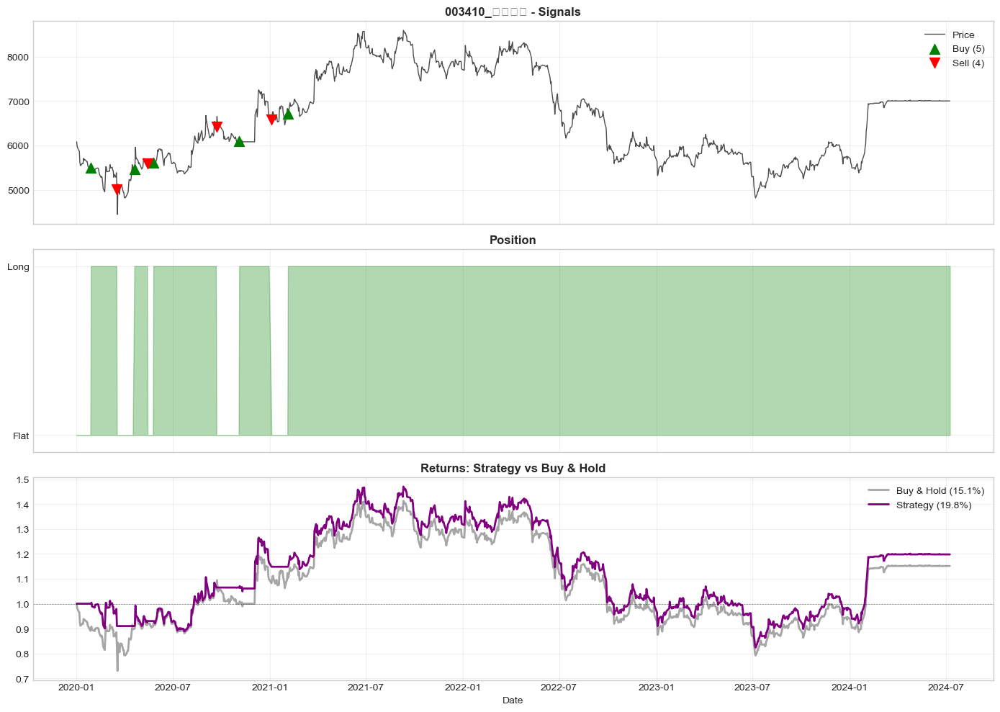


✓ Complete

[41/200] 003450_현대증권.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[42/200] 003490_대한항공.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 18058.00 → 22600.00

Strategy:  -18.75%  |  Market:   25.15%  |  Excess:  -43.90%
Sharpe:     0.212  |  Max DD:  -53.59%  |  Win:  45.1%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-05-27: BUY


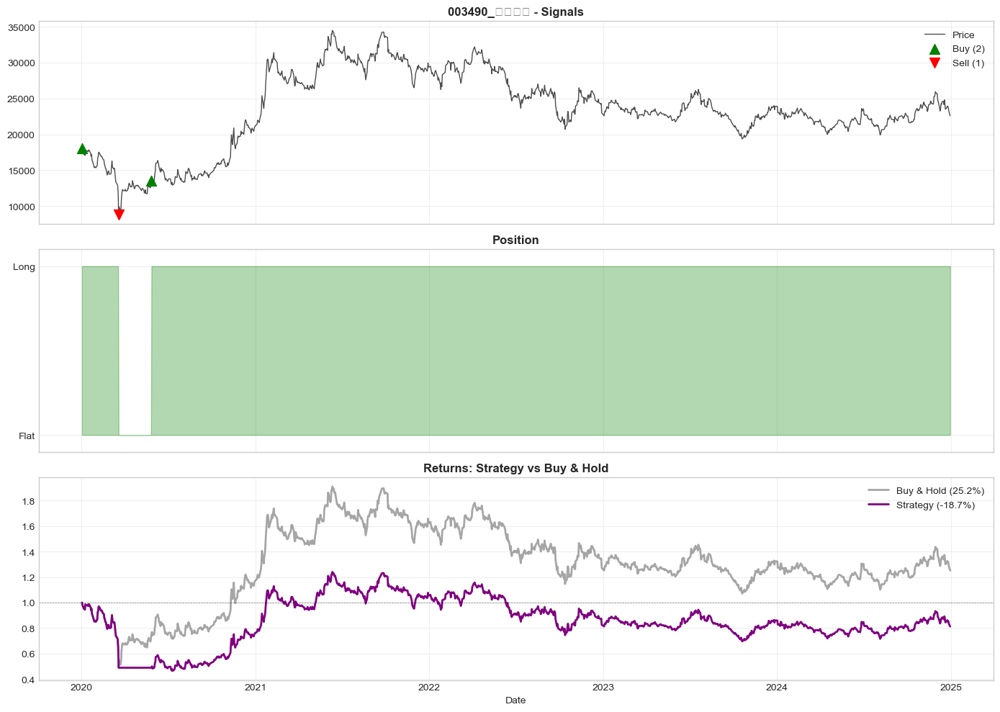


✓ Complete

[43/200] 003520_영진약품.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 6460.00 → 1988.00

Strategy:  -75.54%  |  Market:  -69.23%  |  Excess:   -6.32%
Sharpe:    -0.394  |  Max DD:  -81.95%  |  Win:  41.5%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-17: BUY
  2020-07-07: SELL
  2020-07-21: BUY


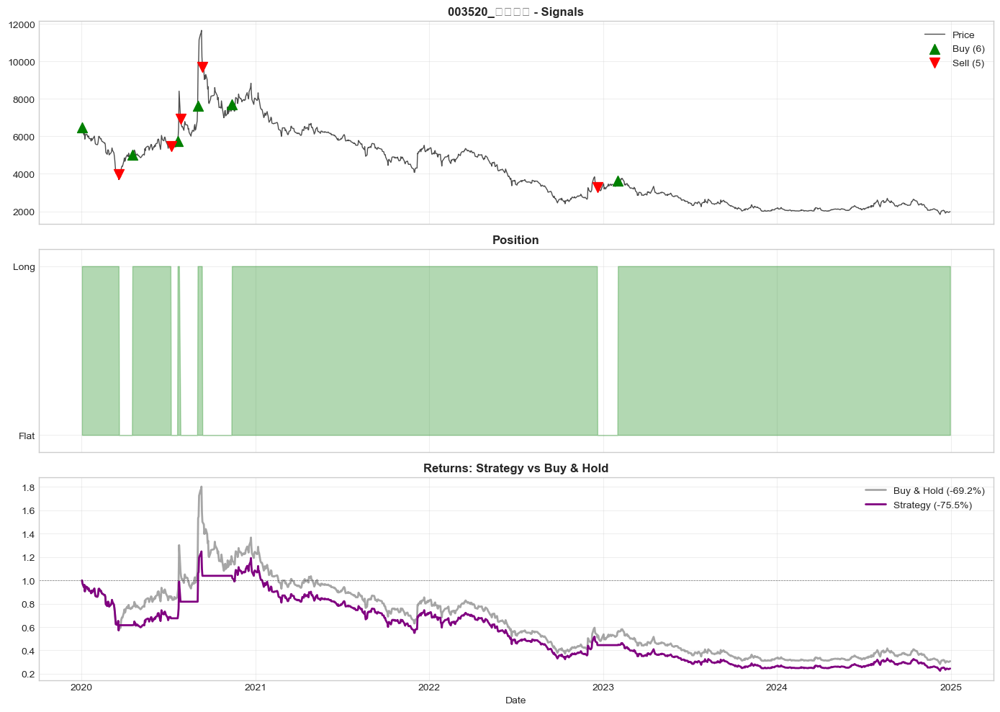


✓ Complete

[44/200] 003550_LG.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 67166.00 → 72000.00

Strategy:   28.83%  |  Market:    7.20%  |  Excess:   21.64%
Sharpe:     0.305  |  Max DD:  -42.26%  |  Win:  47.3%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-19: BUY
  2020-06-30: SELL
  2020-07-27: BUY


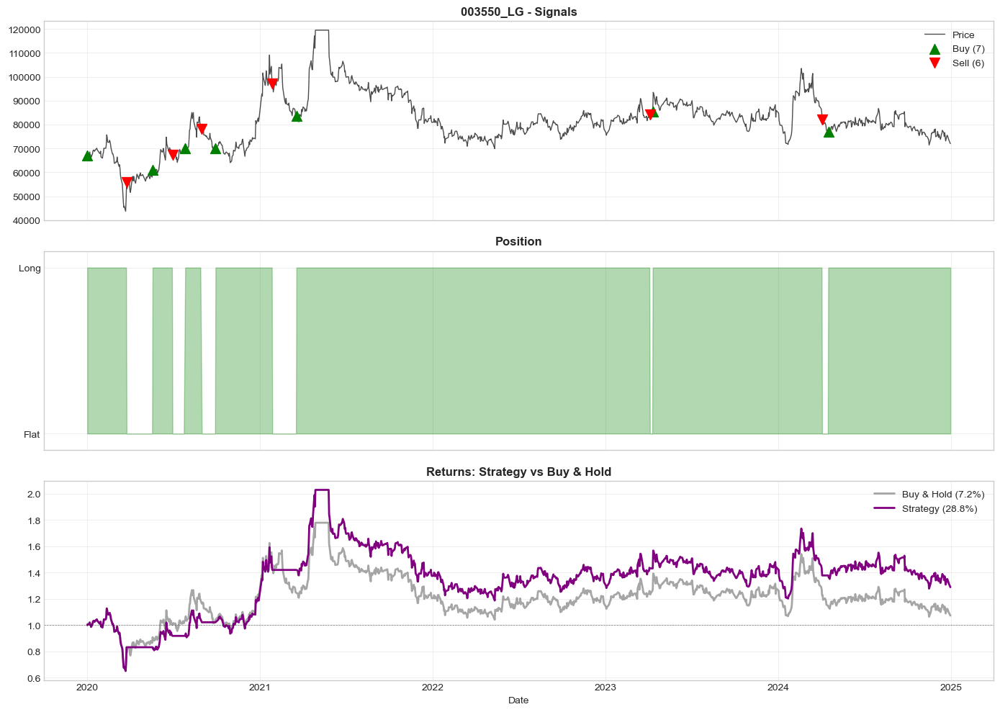


✓ Complete

[45/200] 003570_S&T중공업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 6670.00 → 18710.00

Strategy:  141.51%  |  Market:  180.51%  |  Excess:  -39.00%
Sharpe:     1.068  |  Max DD:  -30.08%  |  Win:  49.3%  |  Trades:  32

First 5 trades:
  2020-02-07: BUY
  2020-03-16: SELL
  2020-04-20: BUY
  2020-06-29: SELL
  2020-07-20: BUY


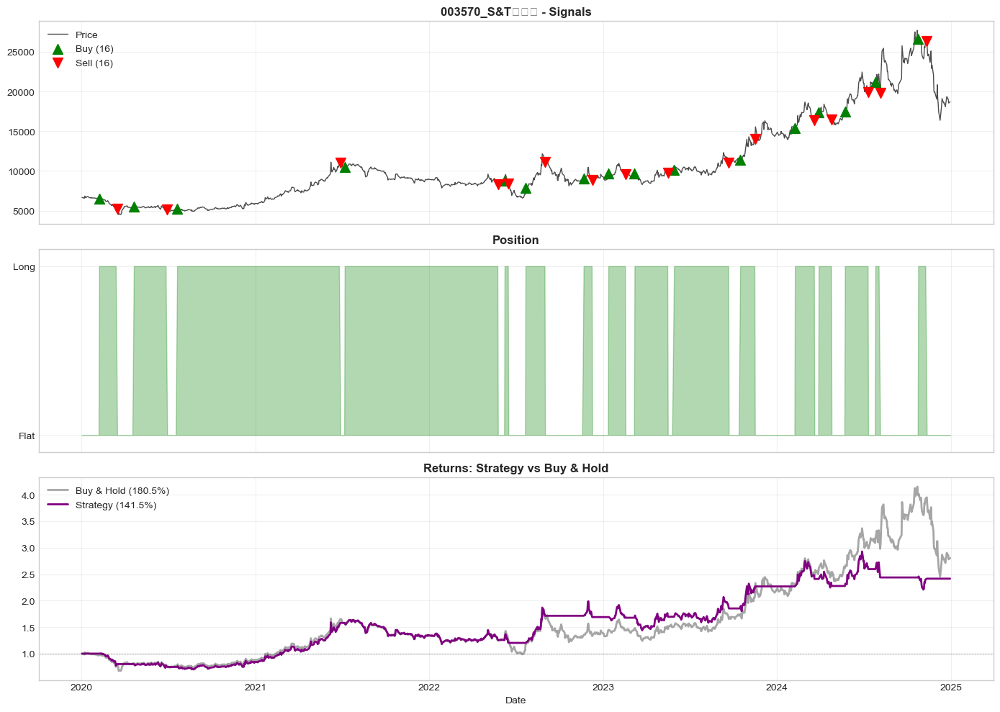


✓ Complete

[46/200] 003600_SK.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[47/200] 003620_쌍용차.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 10560.00 → 4035.00

Strategy:  -72.75%  |  Market:  -61.79%  |  Excess:  -10.96%
Sharpe:    -0.220  |  Max DD:  -88.96%  |  Win:  20.9%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-06-24: SELL
  2020-07-22: BUY
  2020-10-05: SELL
  2020-10-16: BUY


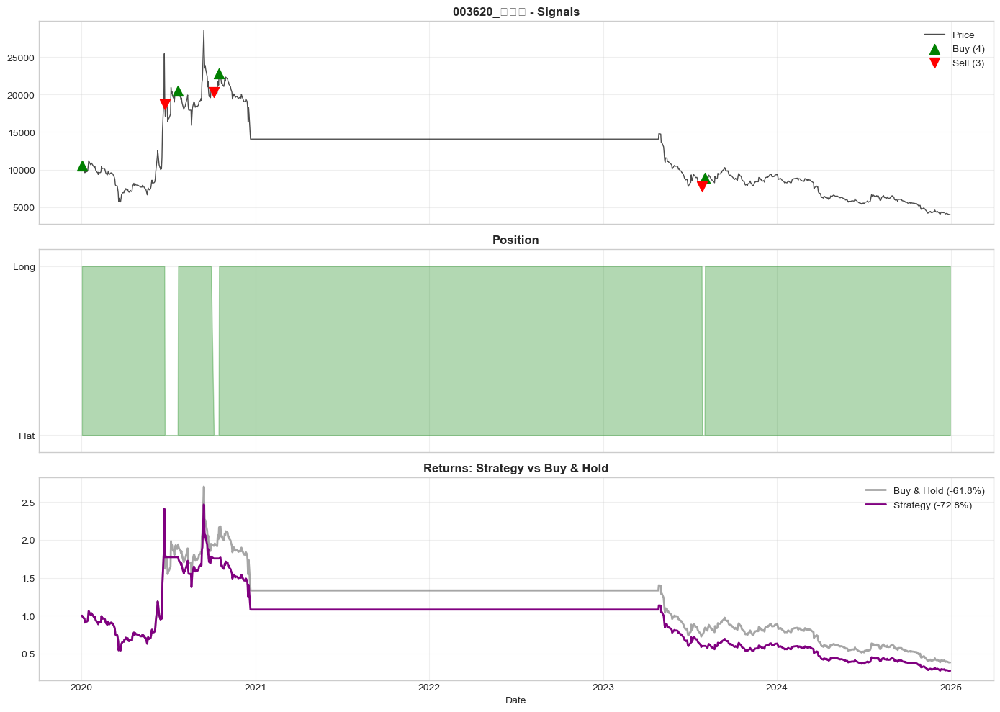


✓ Complete

[48/200] 003920_남양유업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 43494.00 → 58700.00

Strategy:   51.91%  |  Market:   34.96%  |  Excess:   16.95%
Sharpe:     0.510  |  Max DD:  -43.25%  |  Win:  46.3%  |  Trades:  19

First 5 trades:
  2020-01-02: BUY
  2020-08-24: SELL
  2020-09-17: BUY
  2021-06-07: SELL
  2021-06-25: BUY


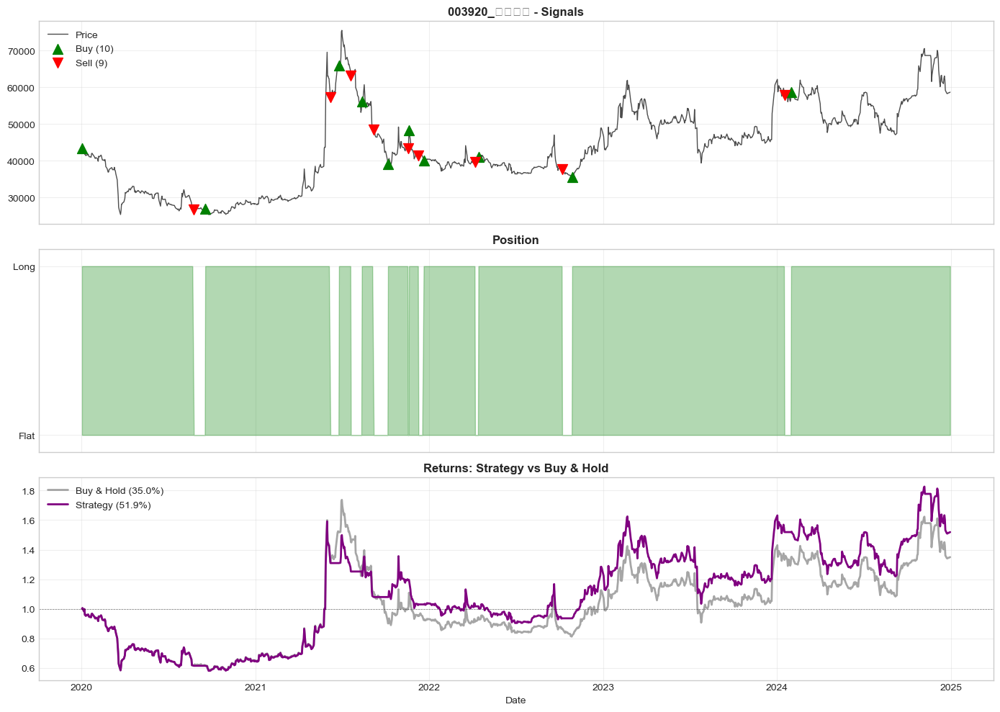


✓ Complete

[49/200] 004000_삼성정밀화학.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 44100.00 → 39350.00

Strategy:  -36.79%  |  Market:  -10.77%  |  Excess:  -26.02%
Sharpe:    -0.101  |  Max DD:  -60.27%  |  Win:  45.0%  |  Trades:  19

First 5 trades:
  2020-02-11: BUY
  2020-03-20: SELL
  2020-04-22: BUY
  2020-05-22: SELL
  2020-06-01: BUY


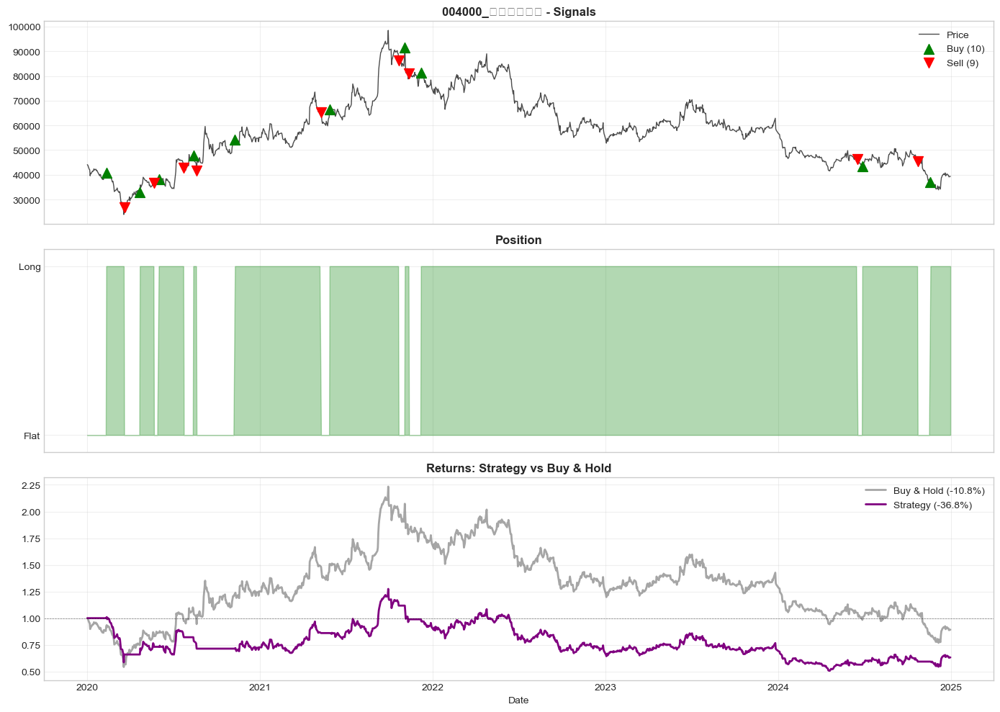


✓ Complete

[50/200] 004020_현대제철.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 31200.00 → 21050.00

Strategy:  -48.30%  |  Market:  -32.53%  |  Excess:  -15.76%
Sharpe:    -0.222  |  Max DD:  -67.85%  |  Win:  46.6%  |  Trades:   6

First 5 trades:
  2020-01-30: BUY
  2020-03-24: SELL
  2020-04-29: BUY
  2020-06-22: SELL
  2020-07-15: BUY


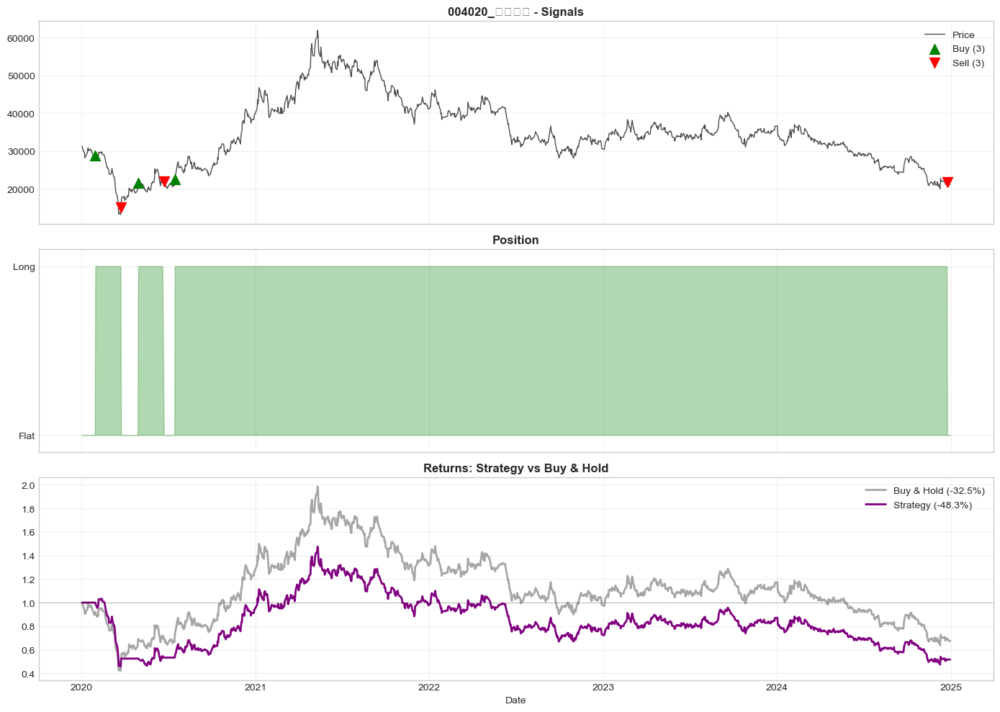


✓ Complete

[51/200] 004130_대덕GDS.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[52/200] 004150_한솔제지.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4133.00 → 2350.00

Strategy:  -54.96%  |  Market:  -43.14%  |  Excess:  -11.82%
Sharpe:    -0.540  |  Max DD:  -61.25%  |  Win:  42.5%  |  Trades:   3

First 5 trades:
  2020-02-04: BUY
  2020-03-19: SELL
  2020-05-06: BUY


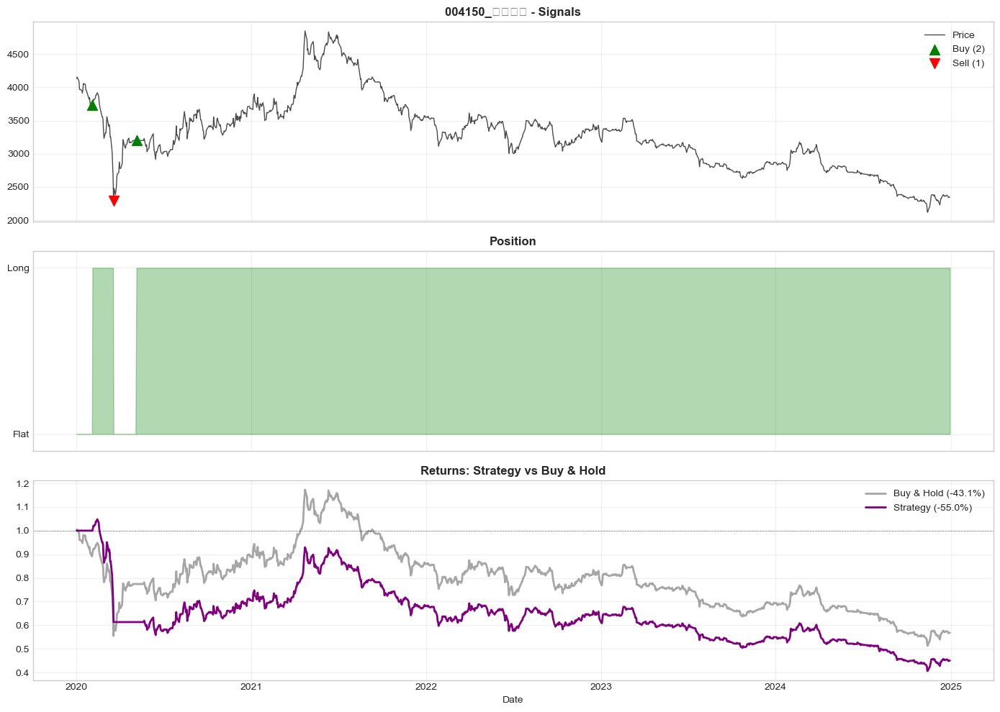


✓ Complete

[53/200] 004170_신세계.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 292500.00 → 133000.00

Strategy:  -49.42%  |  Market:  -54.53%  |  Excess:    5.11%
Sharpe:    -0.323  |  Max DD:  -60.90%  |  Win:  44.7%  |  Trades:   3

First 5 trades:
  2020-04-22: BUY
  2020-09-04: SELL
  2020-09-15: BUY


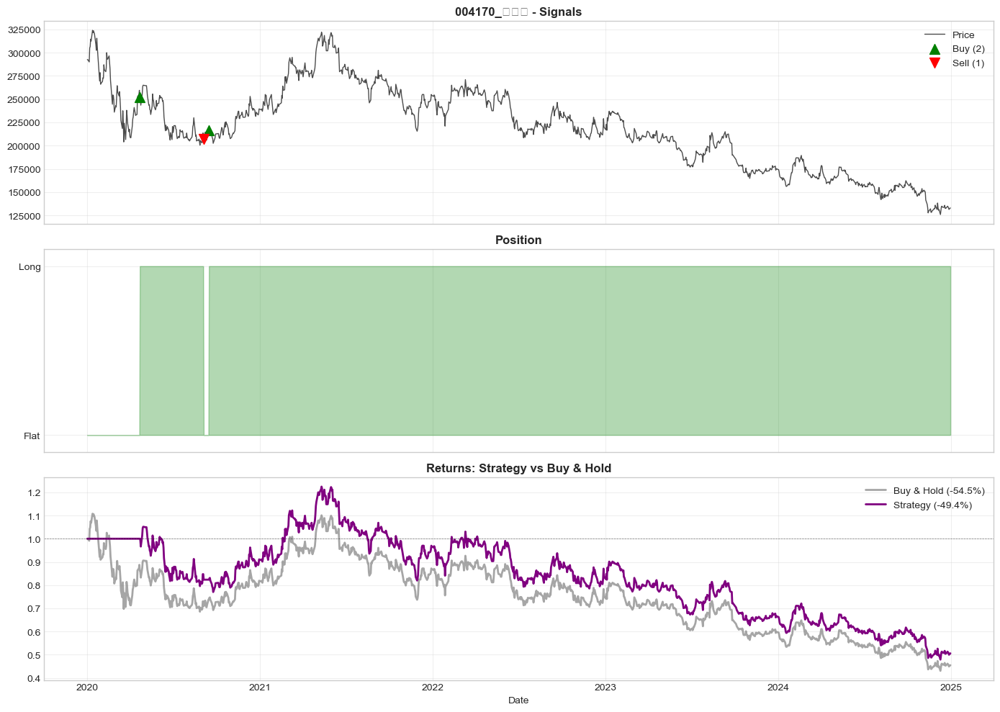


✓ Complete

[54/200] 004370_농심.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 237000.00 → 374000.00

Strategy:   48.01%  |  Market:   57.81%  |  Excess:   -9.79%
Sharpe:     0.512  |  Max DD:  -30.48%  |  Win:  45.0%  |  Trades:  21

First 5 trades:
  2020-01-02: BUY
  2020-03-12: SELL
  2020-04-08: BUY
  2021-08-05: SELL
  2021-08-12: BUY


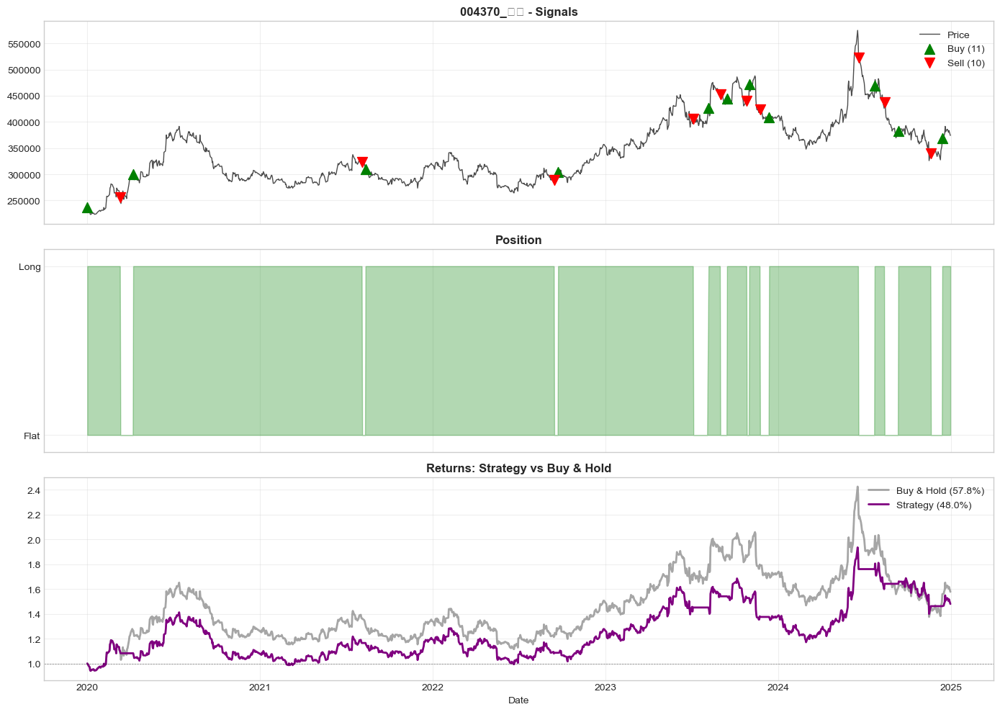


✓ Complete

[55/200] 004430_송원산업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 15550.00 → 11190.00

Strategy:  -54.45%  |  Market:  -28.04%  |  Excess:  -26.42%
Sharpe:    -0.140  |  Max DD:  -63.71%  |  Win:  43.4%  |  Trades:  21

First 5 trades:
  2020-01-30: BUY
  2020-03-19: SELL
  2020-04-17: BUY
  2020-06-15: SELL
  2020-07-13: BUY


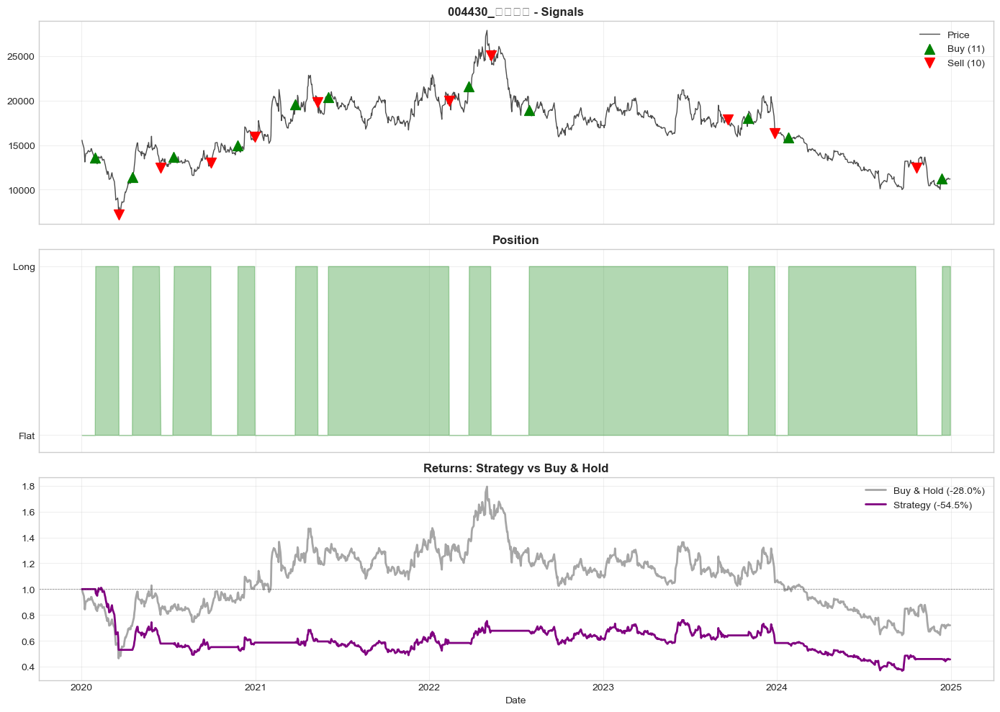


✓ Complete

[56/200] 004490_세방전지.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 36650.00 → 71900.00

Strategy:  102.04%  |  Market:   96.18%  |  Excess:    5.86%
Sharpe:     0.574  |  Max DD:  -67.16%  |  Win:  46.4%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2021-01-18: SELL
  2021-01-25: BUY
  2021-02-03: SELL
  2021-03-29: BUY


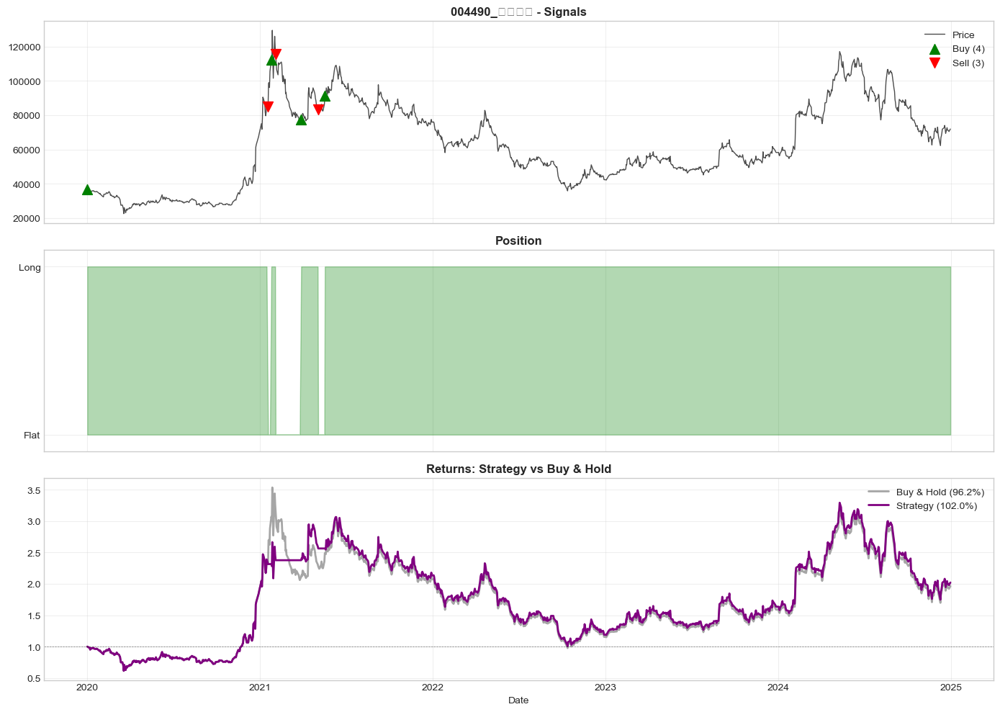


✓ Complete

[57/200] 004710_한솔테크닉스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 9612.00 → 4054.00

Strategy:  -74.39%  |  Market:  -57.82%  |  Excess:  -16.57%
Sharpe:    -0.648  |  Max DD:  -77.68%  |  Win:  45.1%  |  Trades:   5

First 5 trades:
  2020-02-12: BUY
  2020-03-20: SELL
  2020-05-06: BUY
  2020-09-25: SELL
  2020-10-08: BUY


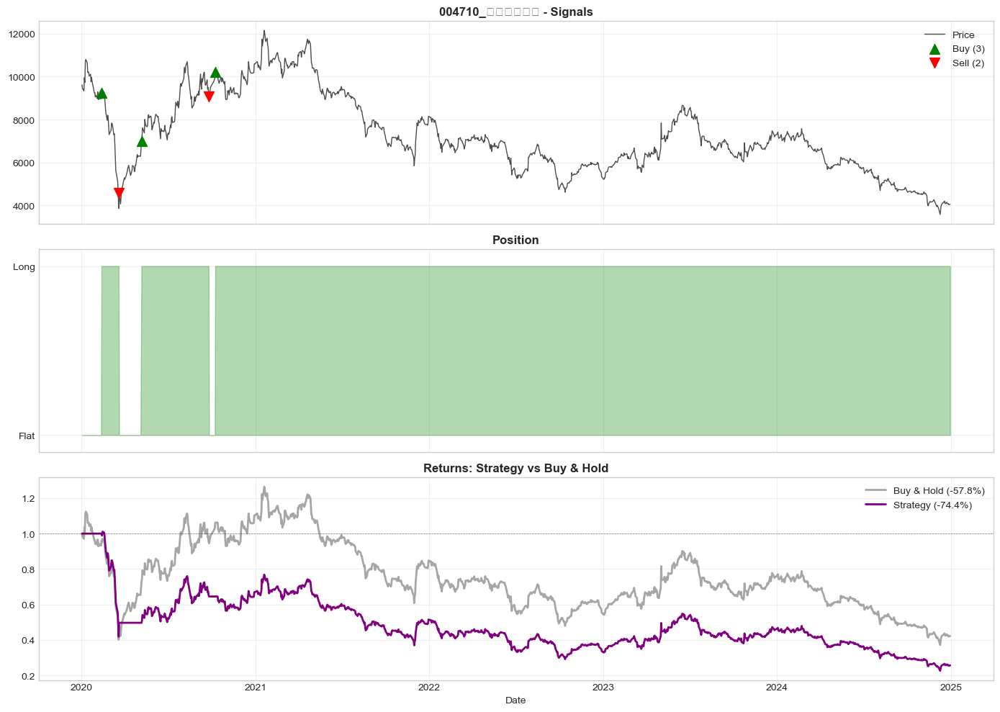


✓ Complete

[58/200] 004800_효성.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 58776.00 → 46900.00

Strategy:  -57.28%  |  Market:  -20.21%  |  Excess:  -37.08%
Sharpe:    -0.416  |  Max DD:  -62.94%  |  Win:  44.4%  |  Trades:  16

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-04-23: BUY
  2020-09-01: SELL
  2020-10-14: BUY


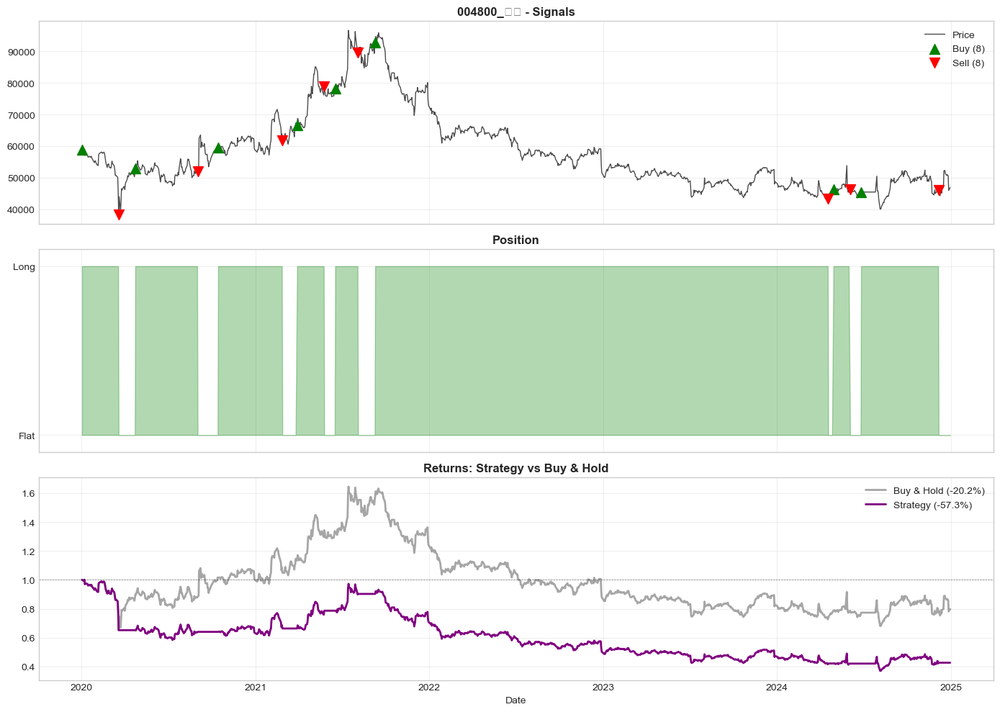


✓ Complete

[59/200] 004990_롯데제과.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 37700.00 → 21800.00

Strategy:  -35.39%  |  Market:  -42.18%  |  Excess:    6.79%
Sharpe:    -0.044  |  Max DD:  -48.98%  |  Win:  43.4%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-02-14: SELL
  2020-02-28: BUY
  2020-03-30: SELL
  2020-04-17: BUY


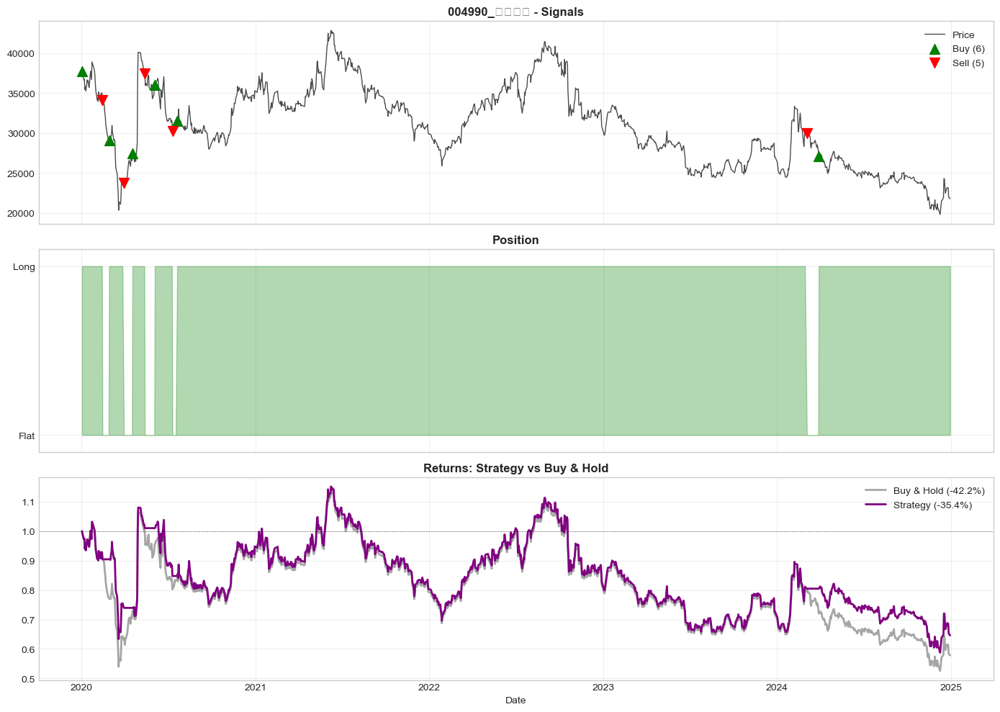


✓ Complete

[60/200] 005090_삼광글라스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 30350.00 → 24700.00

Strategy:  -35.57%  |  Market:  -18.62%  |  Excess:  -16.95%
Sharpe:     0.159  |  Max DD:  -63.27%  |  Win:  43.8%  |  Trades:  31

First 5 trades:
  2020-01-02: BUY
  2020-03-11: SELL
  2020-03-19: BUY
  2020-03-20: SELL
  2020-04-27: BUY


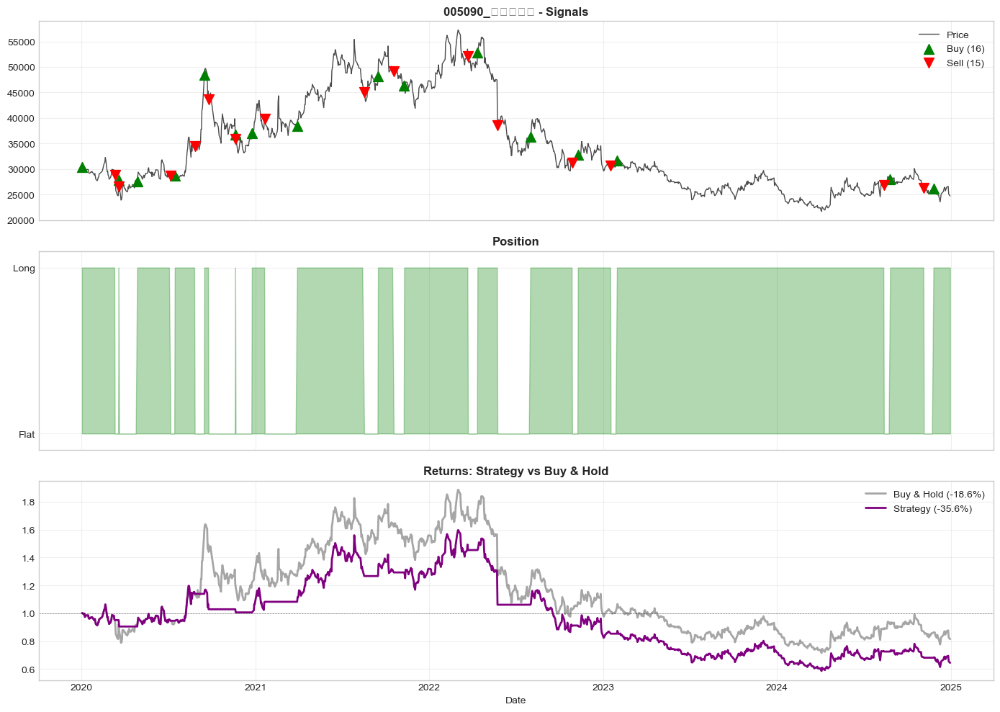


✓ Complete

[61/200] 005180_빙그레.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 56300.00 → 81400.00

Strategy:   62.33%  |  Market:   44.58%  |  Excess:   17.74%
Sharpe:     0.330  |  Max DD:  -46.04%  |  Win:  45.0%  |  Trades:   5

First 5 trades:
  2020-01-30: BUY
  2020-04-01: SELL
  2020-05-04: BUY
  2024-06-27: SELL
  2024-07-22: BUY


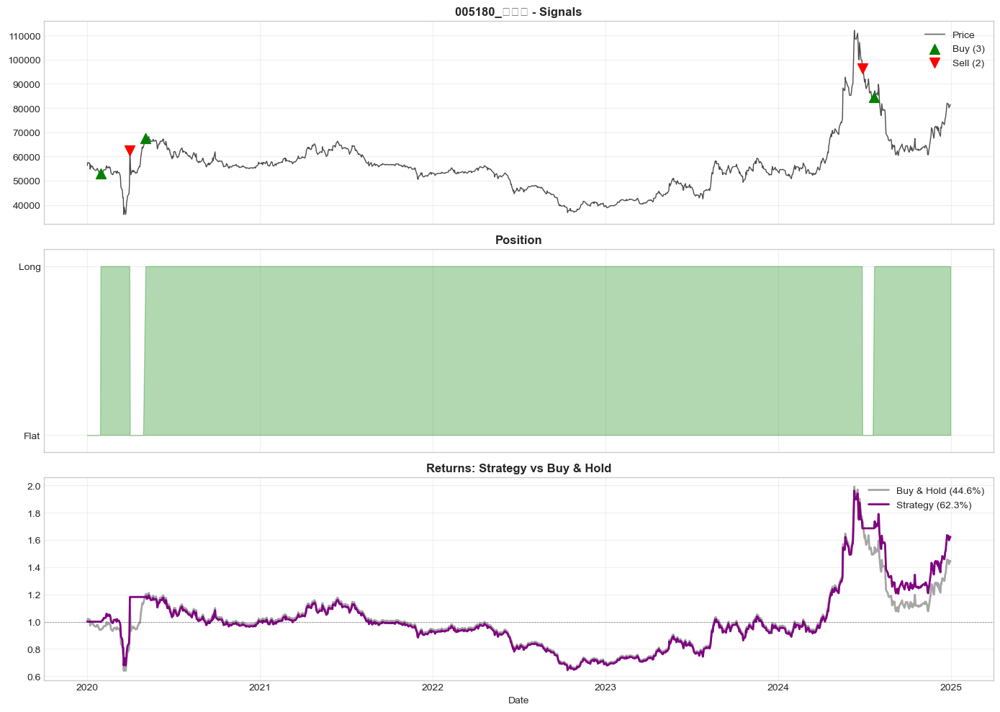


✓ Complete

[62/200] 005300_롯데칠성.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 136500.00 → 112000.00

Strategy:  -34.43%  |  Market:  -17.95%  |  Excess:  -16.48%
Sharpe:    -0.217  |  Max DD:  -46.31%  |  Win:  42.6%  |  Trades:  19

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2020-06-23: SELL
  2020-07-20: BUY


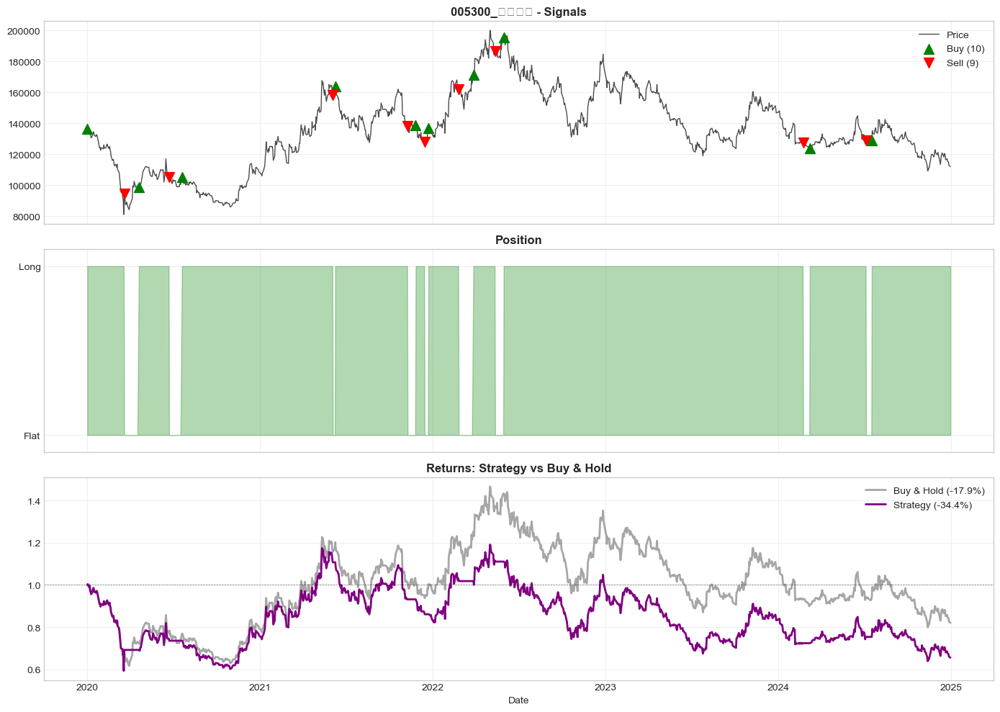


✓ Complete

[63/200] 005380_현대차.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 118000.00 → 212000.00

Strategy:   59.41%  |  Market:   79.66%  |  Excess:  -20.25%
Sharpe:     0.448  |  Max DD:  -51.54%  |  Win:  44.9%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-19: BUY
  2020-06-25: SELL
  2020-07-13: BUY


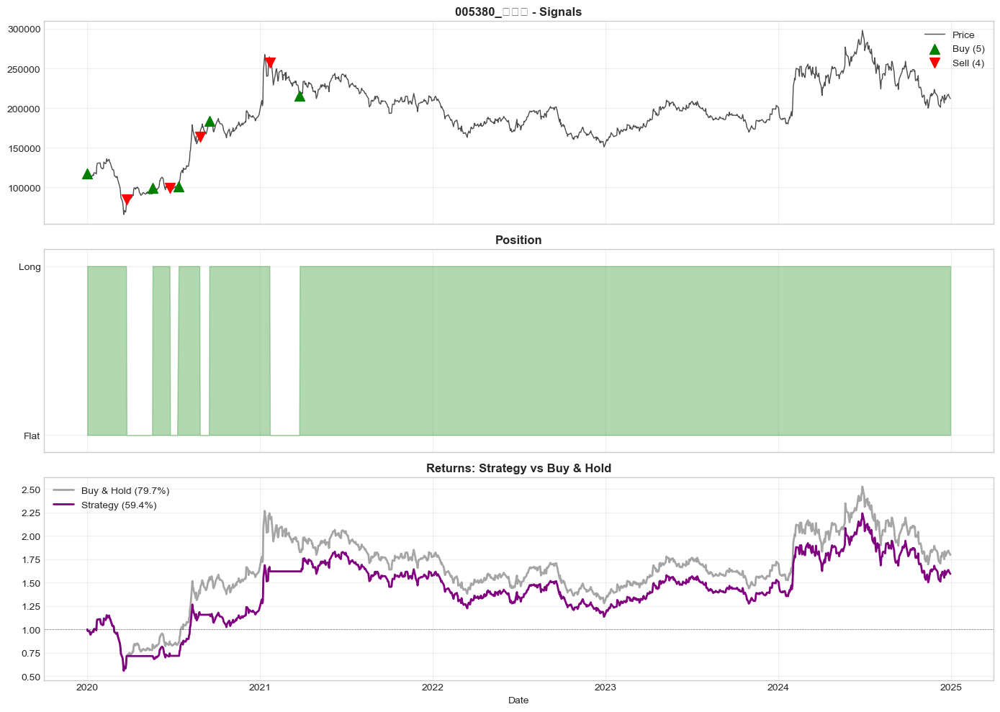


✓ Complete

[64/200] 005490_POSCO.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 236000.00 → 253500.00

Strategy:    7.35%  |  Market:    7.42%  |  Excess:   -0.06%
Sharpe:     0.327  |  Max DD:  -58.97%  |  Win:  46.2%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2020-03-31: SELL
  2020-04-23: BUY
  2020-06-23: SELL
  2020-07-08: BUY


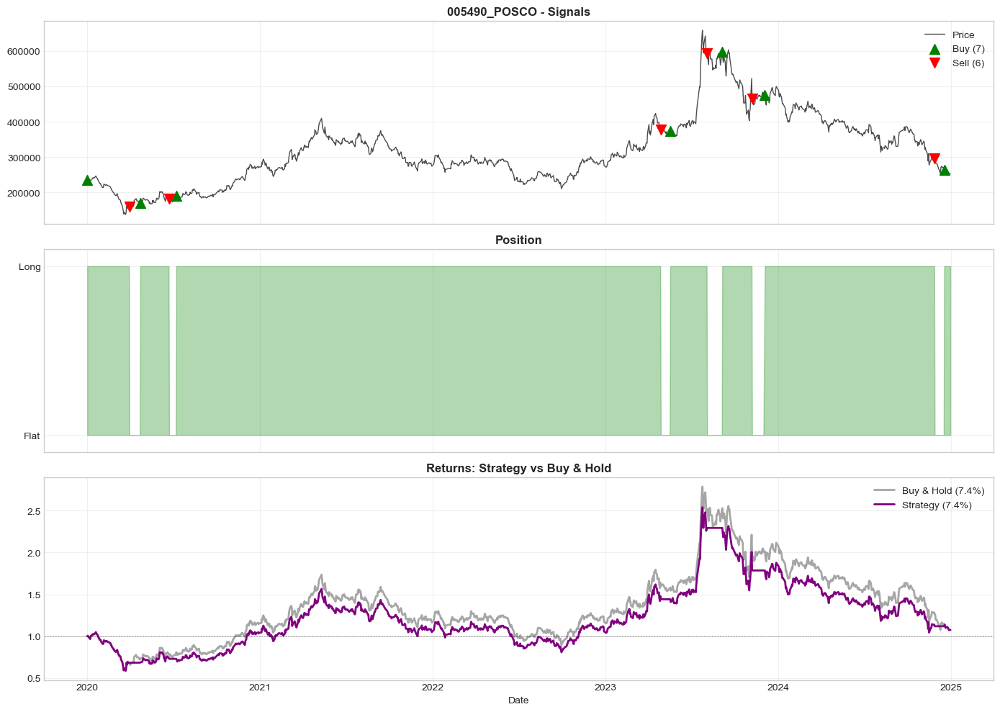


✓ Complete

[65/200] 005610_삼립식품.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 86200.00 → 50300.00

Strategy:  -64.58%  |  Market:  -41.65%  |  Excess:  -22.94%
Sharpe:    -0.533  |  Max DD:  -68.88%  |  Win:  41.7%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-04-17: BUY
  2024-07-04: SELL
  2024-07-23: BUY


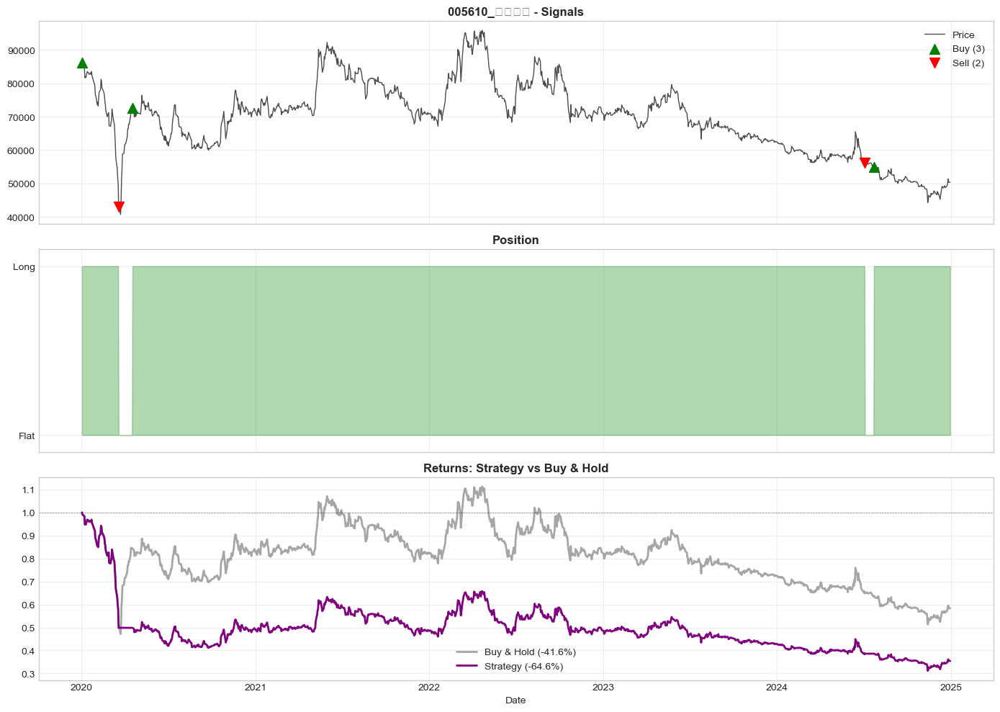


✓ Complete

[66/200] 005740_크라운제과.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 10350.00 → 5500.00

Strategy:  -49.61%  |  Market:  -46.86%  |  Excess:   -2.75%
Sharpe:    -0.124  |  Max DD:  -61.42%  |  Win:  44.0%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-13: SELL
  2020-04-17: BUY
  2022-01-19: SELL
  2022-02-21: BUY


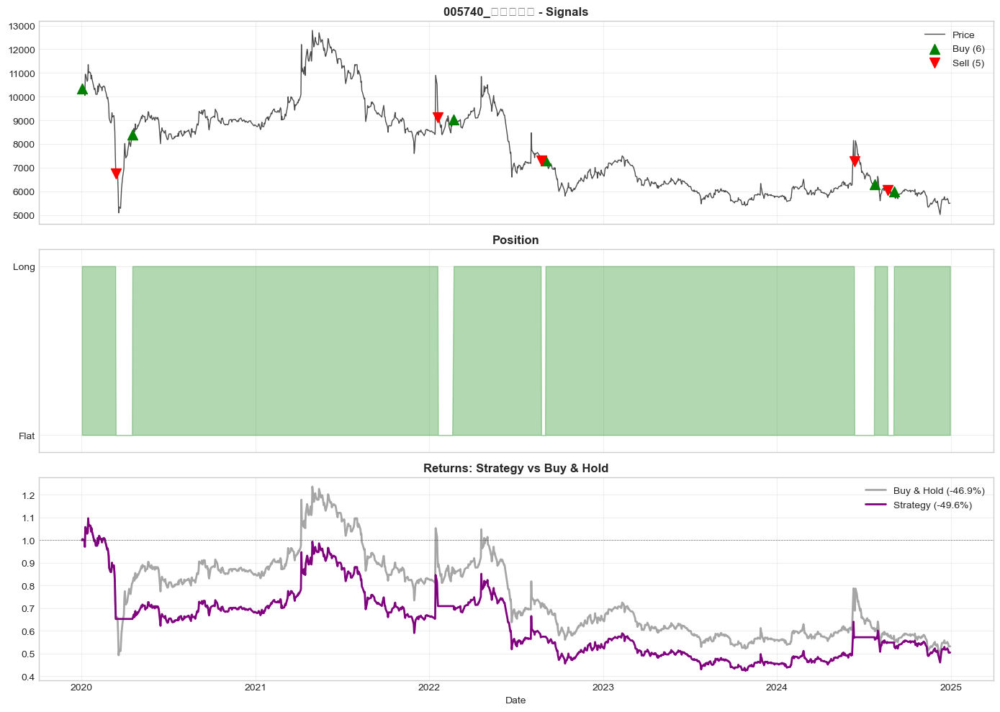


✓ Complete

[67/200] 005830_동부화재.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 50100.00 → 102800.00

Strategy:   54.17%  |  Market:  105.19%  |  Excess:  -51.02%
Sharpe:     0.433  |  Max DD:  -53.15%  |  Win:  49.1%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-04-20: BUY


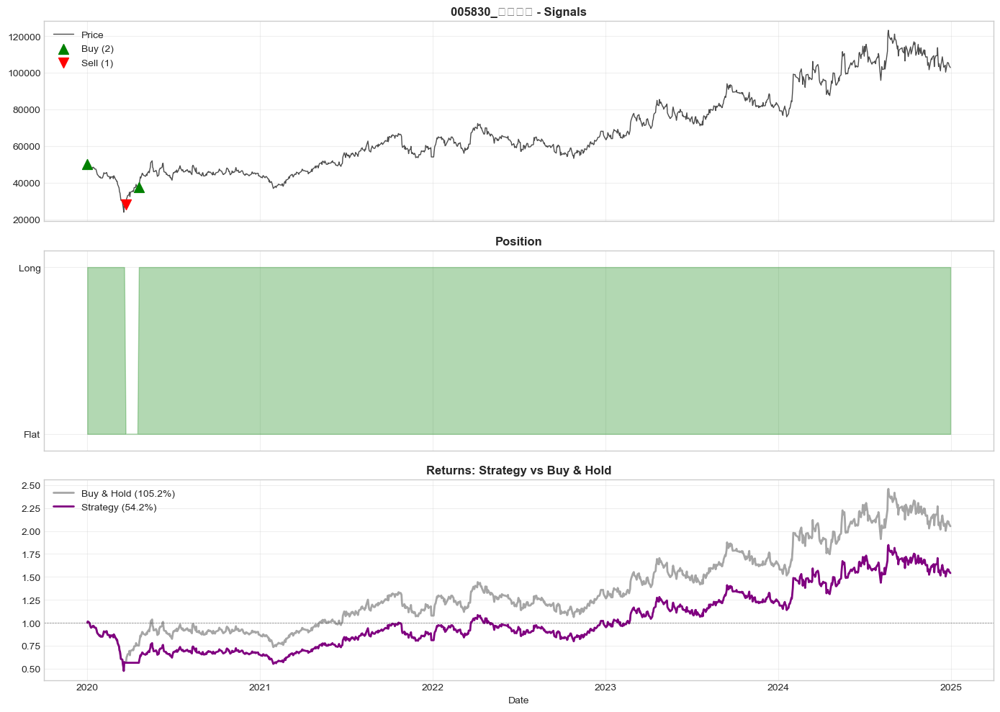


✓ Complete

[68/200] 005850_에스엘.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 14308.00 → 30150.00

Strategy:  120.02%  |  Market:  110.72%  |  Excess:    9.30%
Sharpe:     0.645  |  Max DD:  -44.74%  |  Win:  44.7%  |  Trades:   7

First 5 trades:
  2020-03-04: BUY
  2021-01-29: SELL
  2021-04-12: BUY
  2021-12-15: SELL
  2022-01-05: BUY


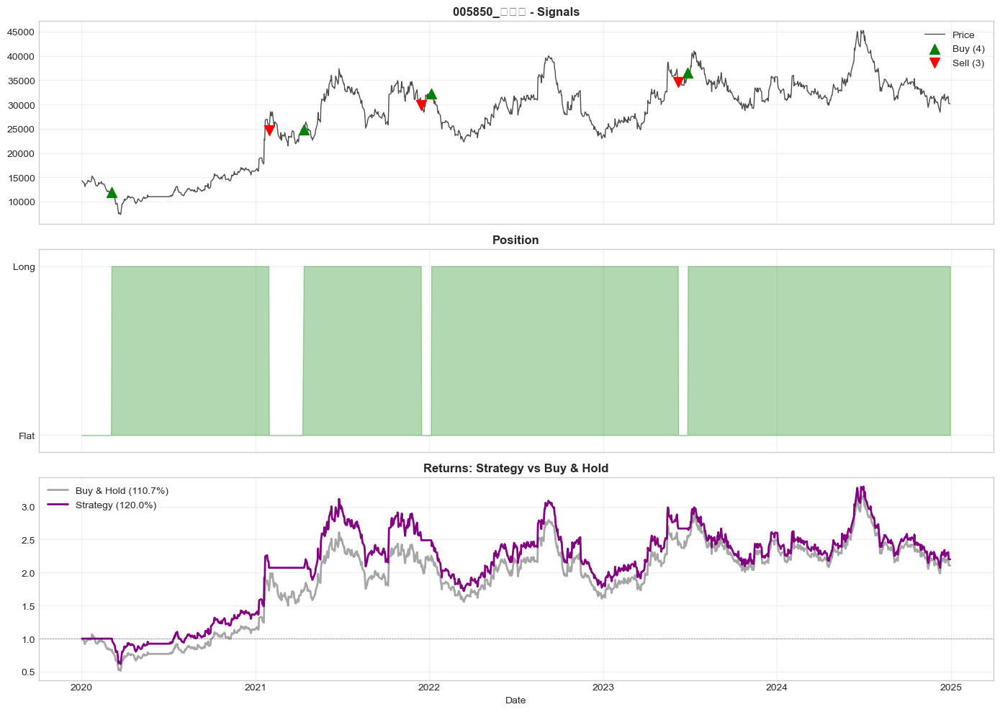


✓ Complete

[69/200] 005930_삼성전자.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 55200.00 → 53200.00

Strategy:    0.39%  |  Market:   -3.62%  |  Excess:    4.01%
Sharpe:     0.022  |  Max DD:  -40.21%  |  Win:  46.4%  |  Trades:  10

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-05-19: BUY
  2020-06-23: SELL
  2020-07-14: BUY


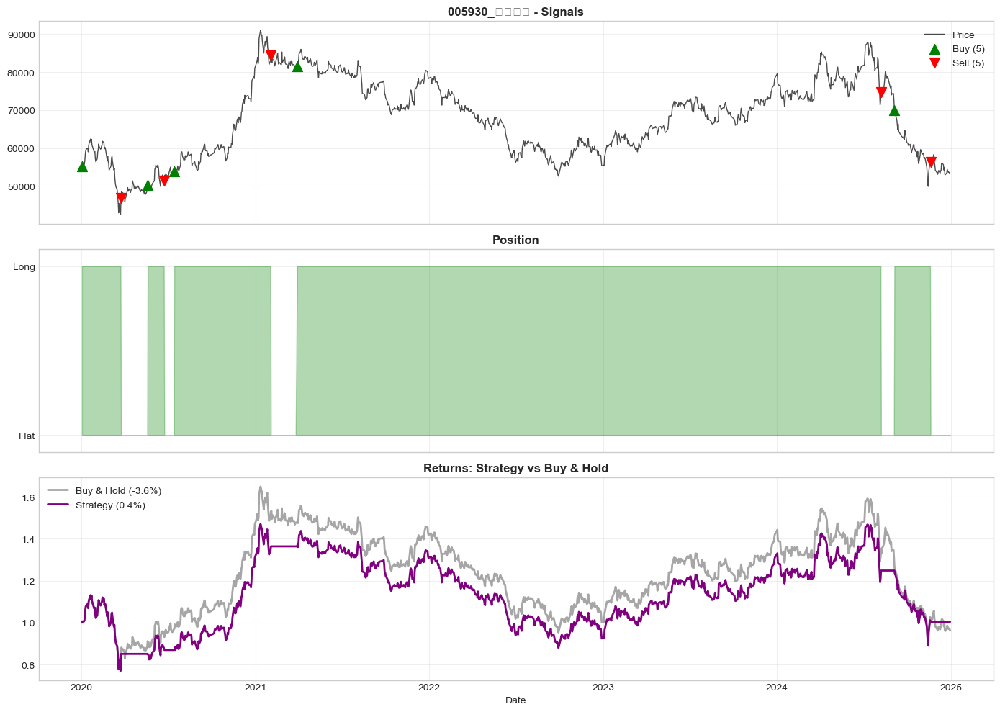


✓ Complete

[70/200] 005940_우리투자증권.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 12500.00 → 13950.00

Strategy:   -5.10%  |  Market:   11.60%  |  Excess:  -16.70%
Sharpe:    -0.029  |  Max DD:  -49.52%  |  Win:  46.1%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-29: BUY


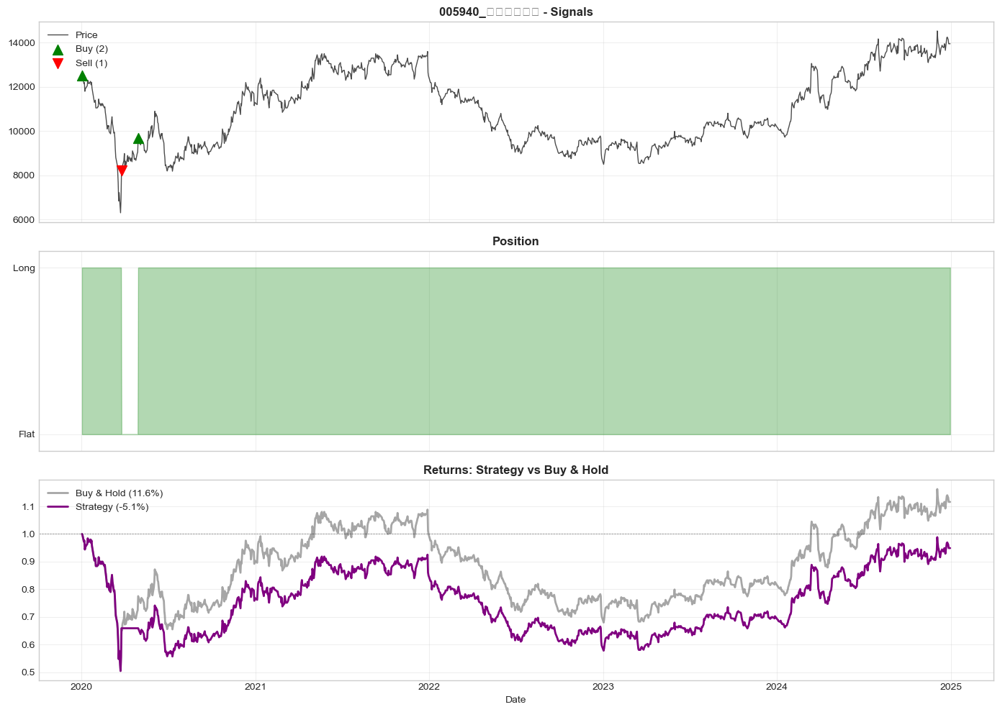


✓ Complete

[71/200] 005950_이수화학.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4689.00 → 6100.00

Strategy:  212.98%  |  Market:   30.09%  |  Excess:  182.89%
Sharpe:     1.211  |  Max DD:  -65.28%  |  Win:  42.8%  |  Trades:  32

First 5 trades:
  2020-02-11: BUY
  2020-02-25: SELL
  2020-04-10: BUY
  2020-05-25: SELL
  2020-07-03: BUY


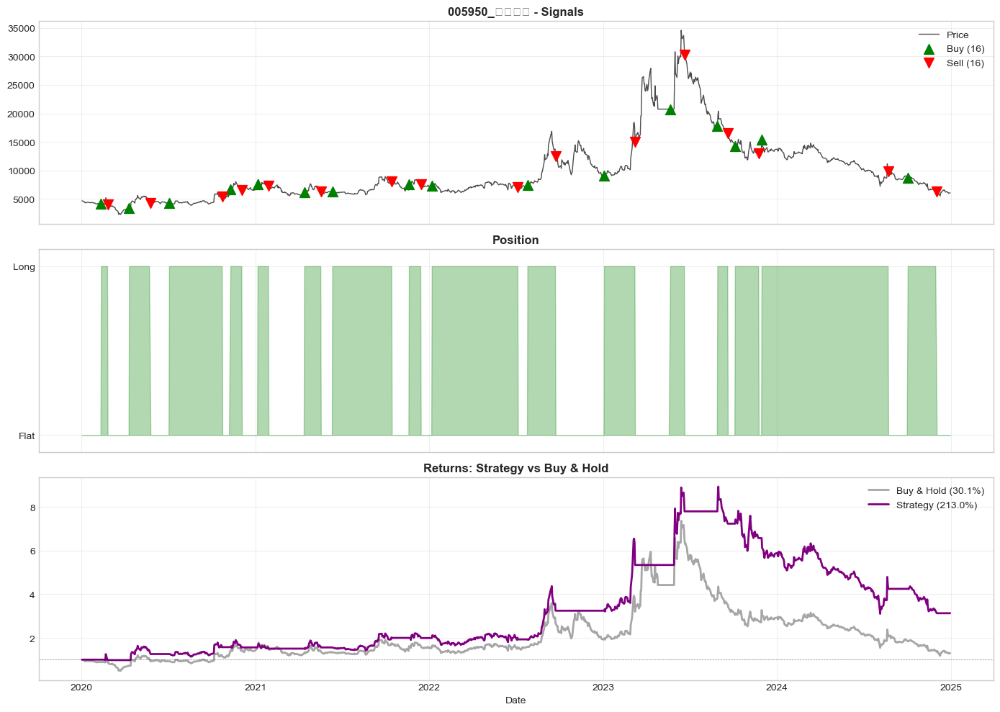


✓ Complete

[72/200] 006120_SK케미칼.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 26400.00 → 38800.00

Strategy:  -28.82%  |  Market:   46.97%  |  Excess:  -75.79%
Sharpe:     0.007  |  Max DD:  -68.42%  |  Win:  47.0%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-04-28: SELL
  2020-05-12: BUY
  2020-07-10: SELL
  2020-11-04: BUY


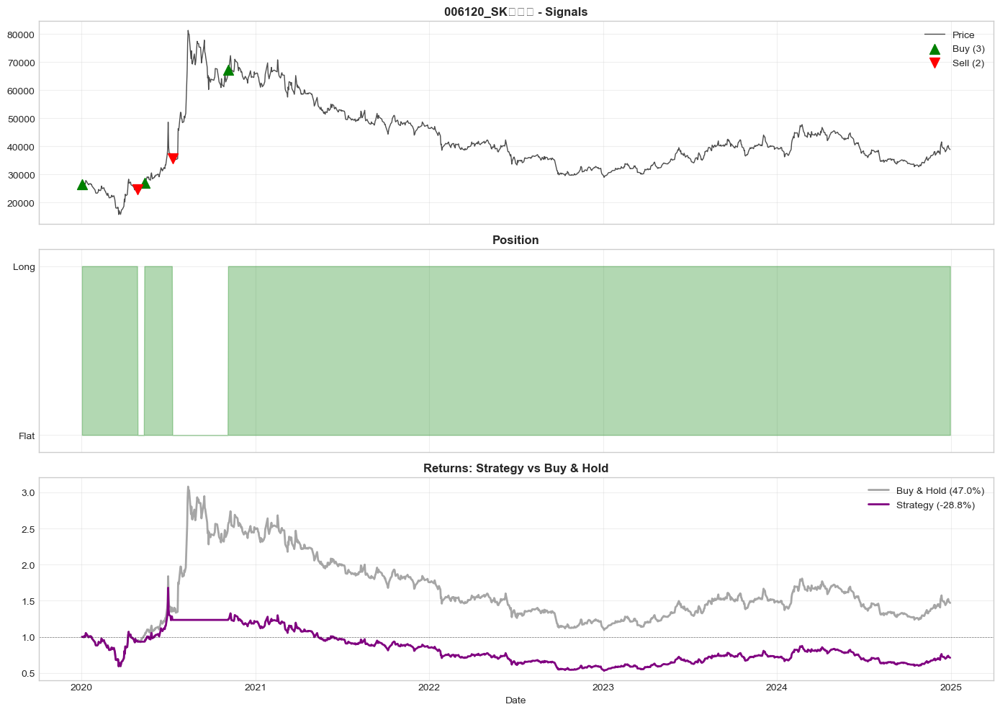


✓ Complete

[73/200] 006260_LS.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 46900.00 → 94300.00

Strategy:   51.87%  |  Market:  101.07%  |  Excess:  -49.19%
Sharpe:     0.509  |  Max DD:  -51.53%  |  Win:  45.7%  |  Trades:  14

First 5 trades:
  2020-01-02: BUY
  2020-03-30: SELL
  2020-04-10: BUY
  2020-09-22: SELL
  2020-10-21: BUY


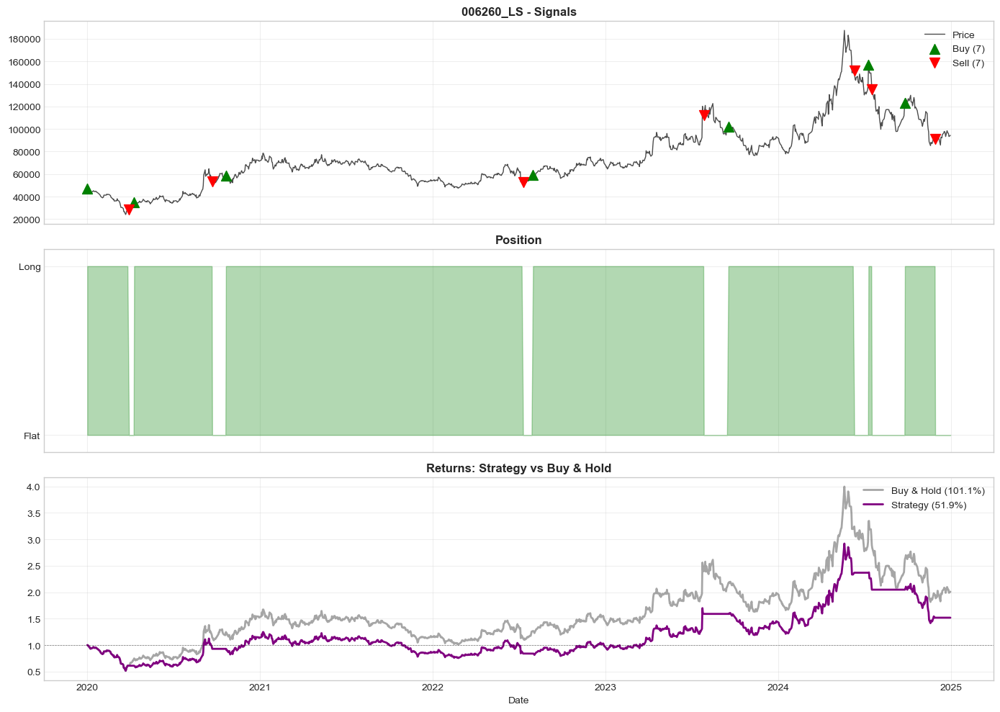


✓ Complete

[74/200] 006280_녹십자.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 131000.00 → 179500.00

Strategy:    6.61%  |  Market:   37.02%  |  Excess:  -30.42%
Sharpe:     0.321  |  Max DD:  -80.27%  |  Win:  44.2%  |  Trades:  15

First 5 trades:
  2020-01-28: BUY
  2020-02-17: SELL
  2020-02-25: BUY
  2020-03-20: SELL
  2020-04-06: BUY


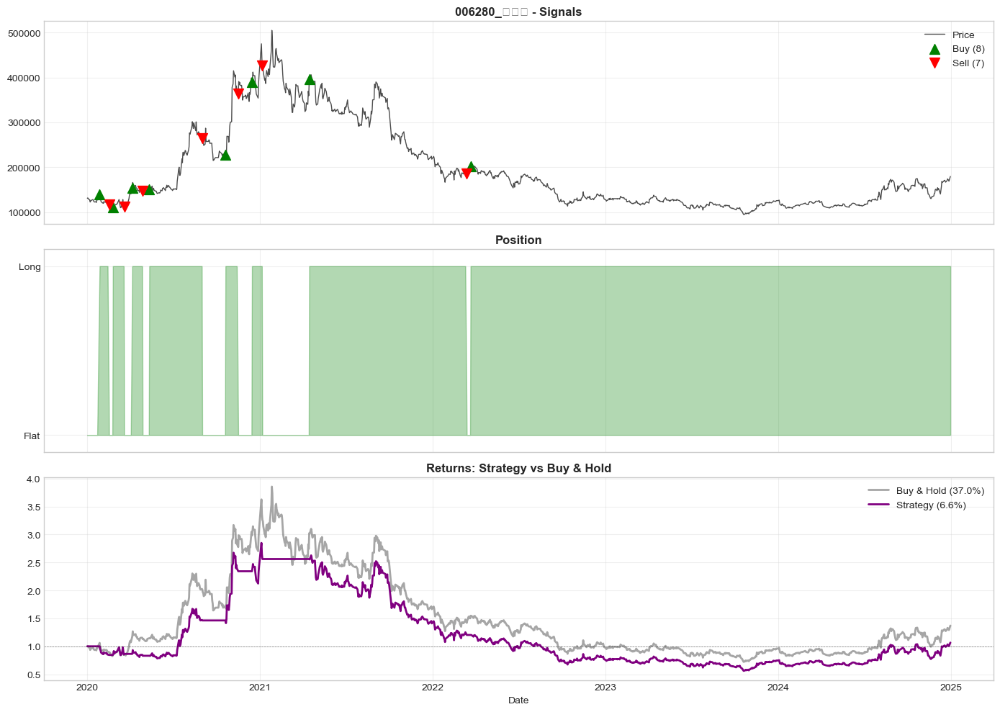


✓ Complete

[75/200] 006380_카프로.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 15675.00 → 3660.00

Strategy:  -76.90%  |  Market:  -76.65%  |  Excess:   -0.25%
Sharpe:    -0.283  |  Max DD:  -87.91%  |  Win:  35.6%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2021-01-27: SELL
  2021-02-04: BUY
  2022-01-14: SELL
  2022-03-02: BUY


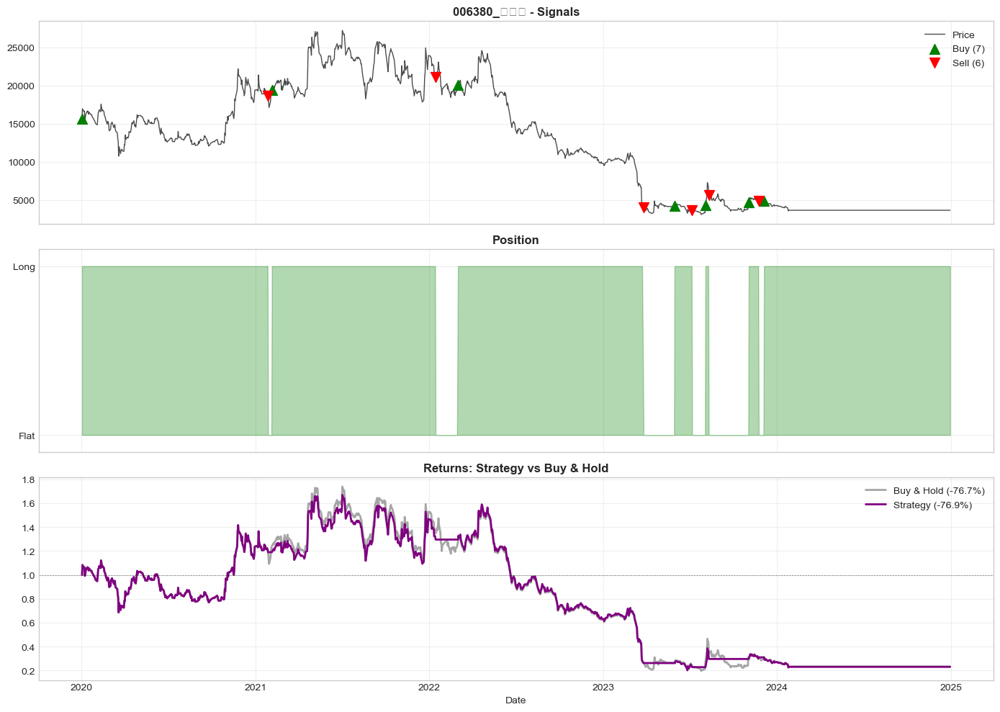


✓ Complete

[76/200] 006400_삼성SDI.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 227135.00 → 242310.00

Strategy:  -24.01%  |  Market:    6.68%  |  Excess:  -30.69%
Sharpe:     0.003  |  Max DD:  -72.70%  |  Win:  47.4%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-21: BUY
  2023-11-09: SELL
  2023-11-30: BUY


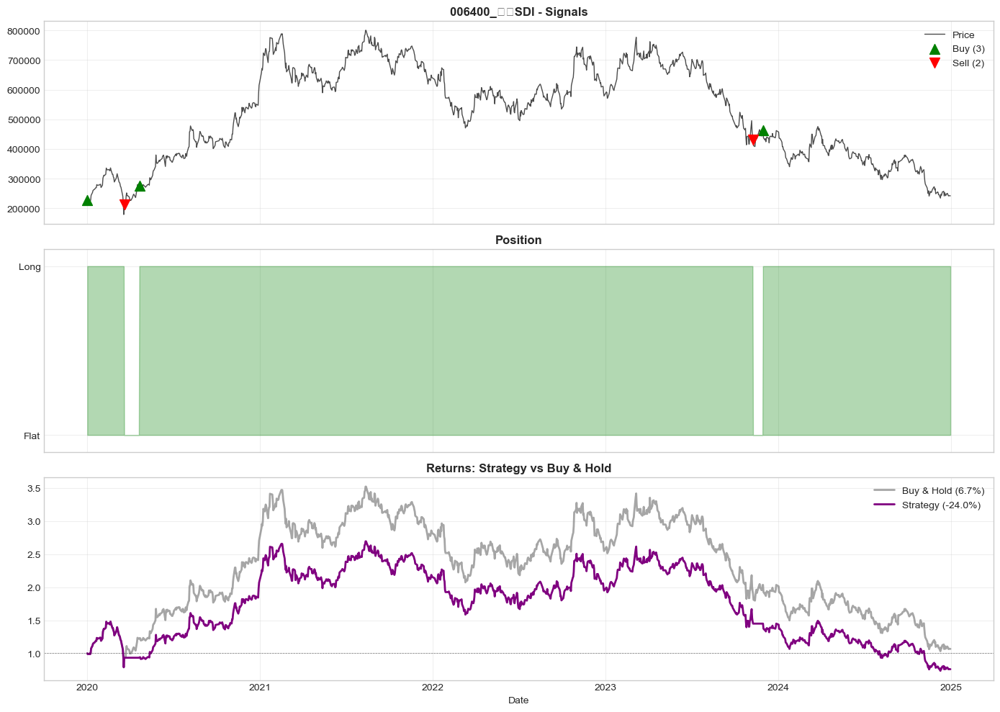


✓ Complete

[77/200] 006650_대한유화.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 116000.00 → 77700.00

Strategy:  -46.59%  |  Market:  -33.02%  |  Excess:  -13.58%
Sharpe:    -0.006  |  Max DD:  -70.44%  |  Win:  43.6%  |  Trades:  26

First 5 trades:
  2020-01-30: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2020-05-11: SELL
  2020-06-05: BUY


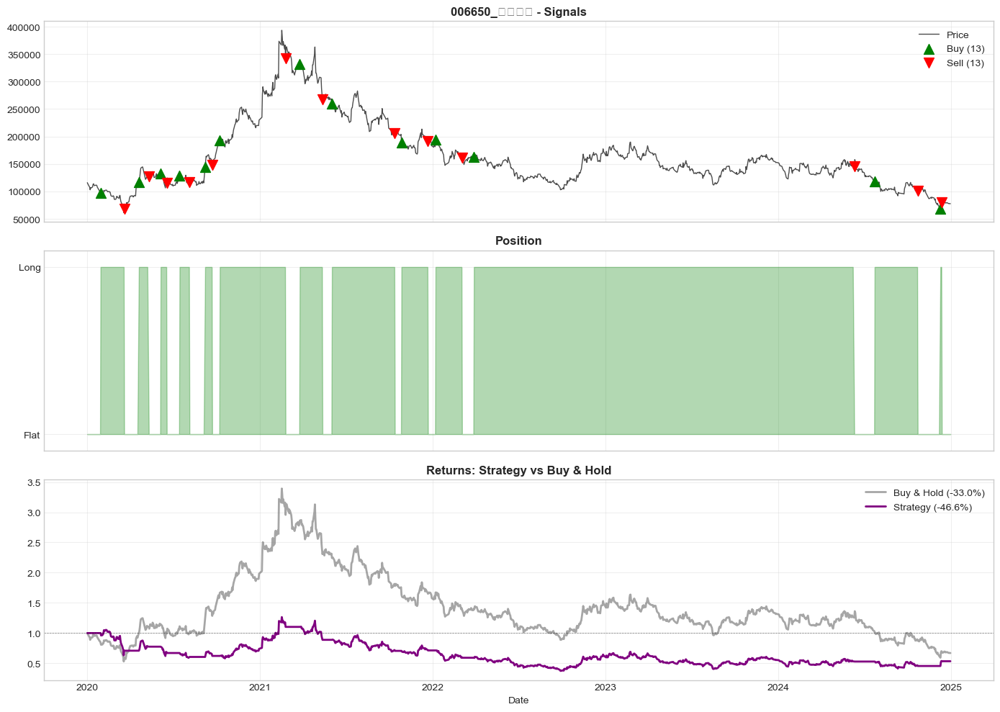


✓ Complete

[78/200] 006800_대우증권.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 7450.00 → 8030.00

Strategy:   -4.13%  |  Market:    7.79%  |  Excess:  -11.91%
Sharpe:     0.046  |  Max DD:  -53.61%  |  Win:  45.7%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-29: BUY


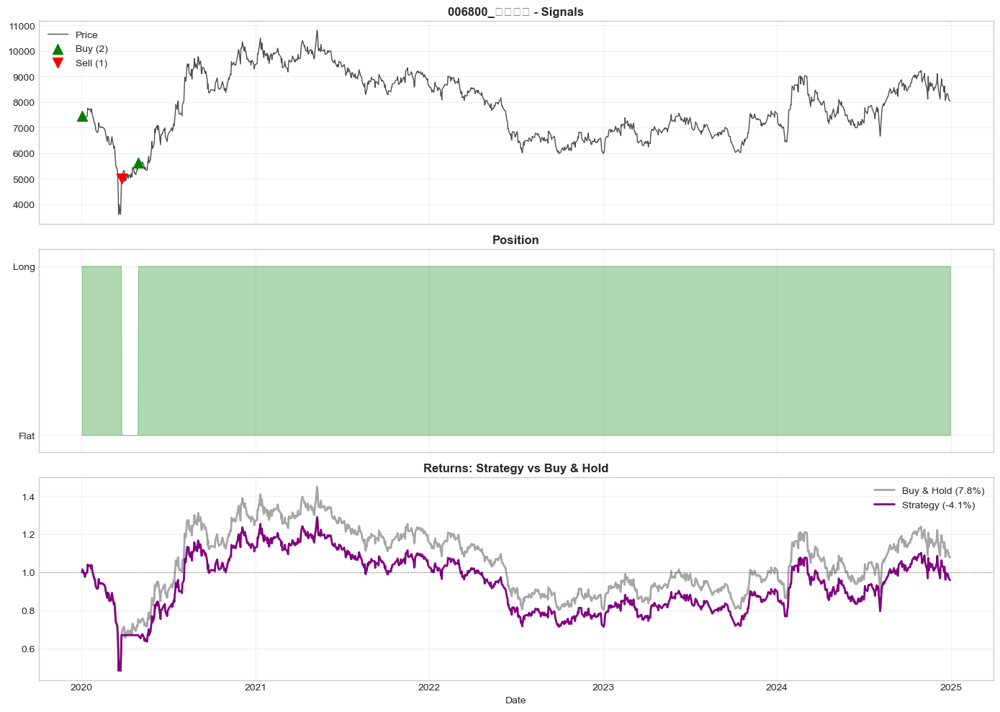


✓ Complete

[79/200] 007070_GS리테일.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 33270.00 → 16500.00

Strategy:  -76.57%  |  Market:  -50.41%  |  Excess:  -26.17%
Sharpe:    -0.929  |  Max DD:  -78.65%  |  Win:  41.3%  |  Trades:  17

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-05-28: BUY
  2020-08-27: SELL
  2020-10-12: BUY


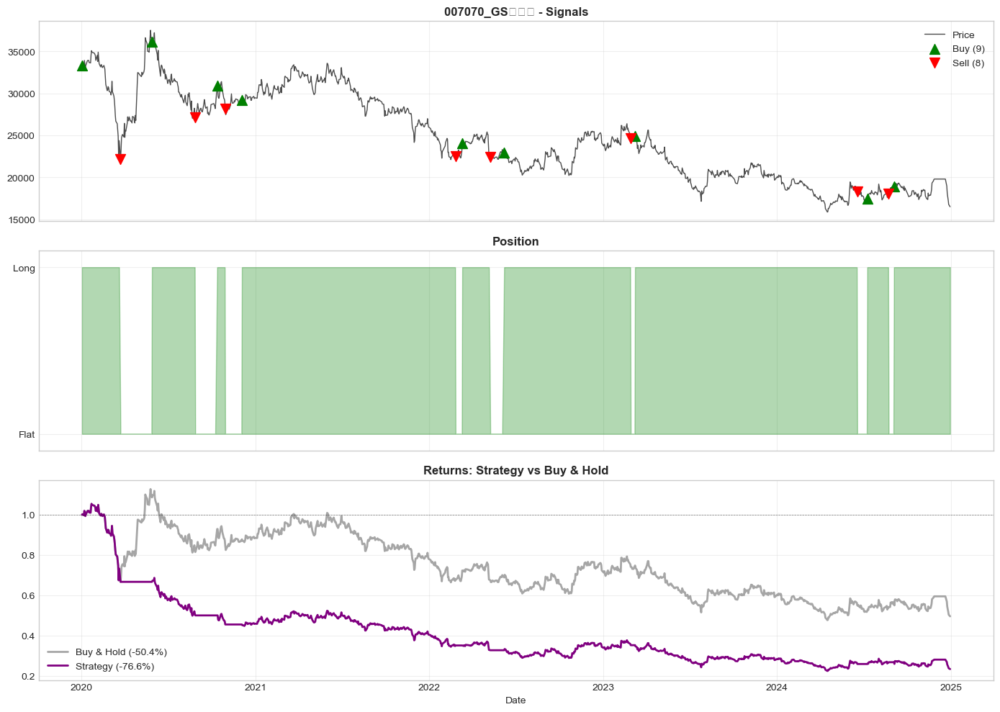


✓ Complete

[80/200] 007310_오뚜기.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 549000.00 → 395500.00

Strategy:  -23.91%  |  Market:  -27.96%  |  Excess:    4.05%
Sharpe:    -0.122  |  Max DD:  -42.35%  |  Win:  43.8%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-02-26: SELL
  2020-05-08: BUY
  2020-05-20: SELL
  2020-06-12: BUY


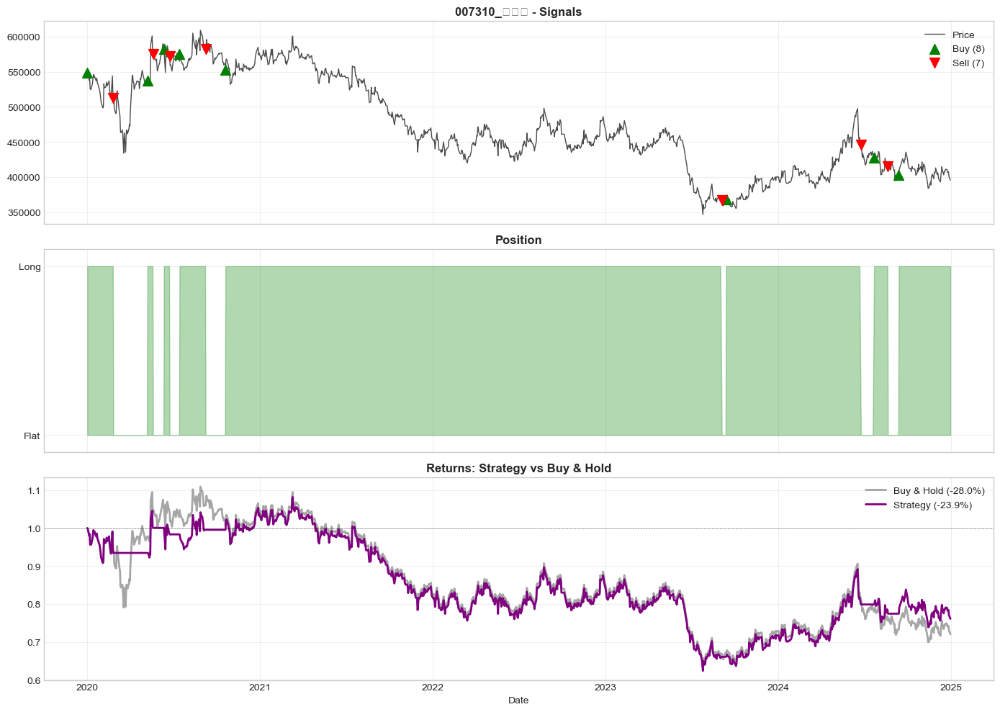


✓ Complete

[81/200] 007340_동아타이어.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 5878.00 → 18330.00

Strategy:  320.80%  |  Market:  211.84%  |  Excess:  108.96%
Sharpe:     1.533  |  Max DD:  -24.87%  |  Win:  48.4%  |  Trades:  27

First 5 trades:
  2020-01-30: BUY
  2020-03-25: SELL
  2020-04-24: BUY
  2020-06-25: SELL
  2020-07-15: BUY


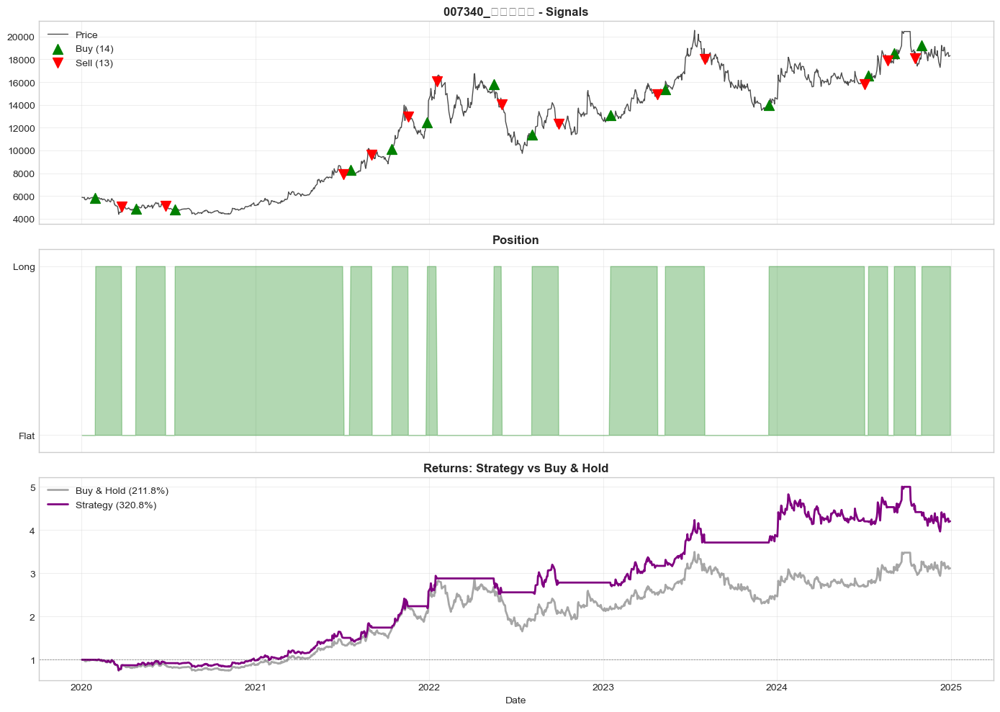


✓ Complete

[82/200] 007570_일양약품.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 22850.00 → 11410.00

Strategy:  -49.67%  |  Market:  -50.07%  |  Excess:    0.40%
Sharpe:     0.144  |  Max DD:  -82.85%  |  Win:  42.6%  |  Trades:  15

First 5 trades:
  2020-01-23: BUY
  2020-02-17: SELL
  2020-03-05: BUY
  2020-03-19: SELL
  2020-05-14: BUY


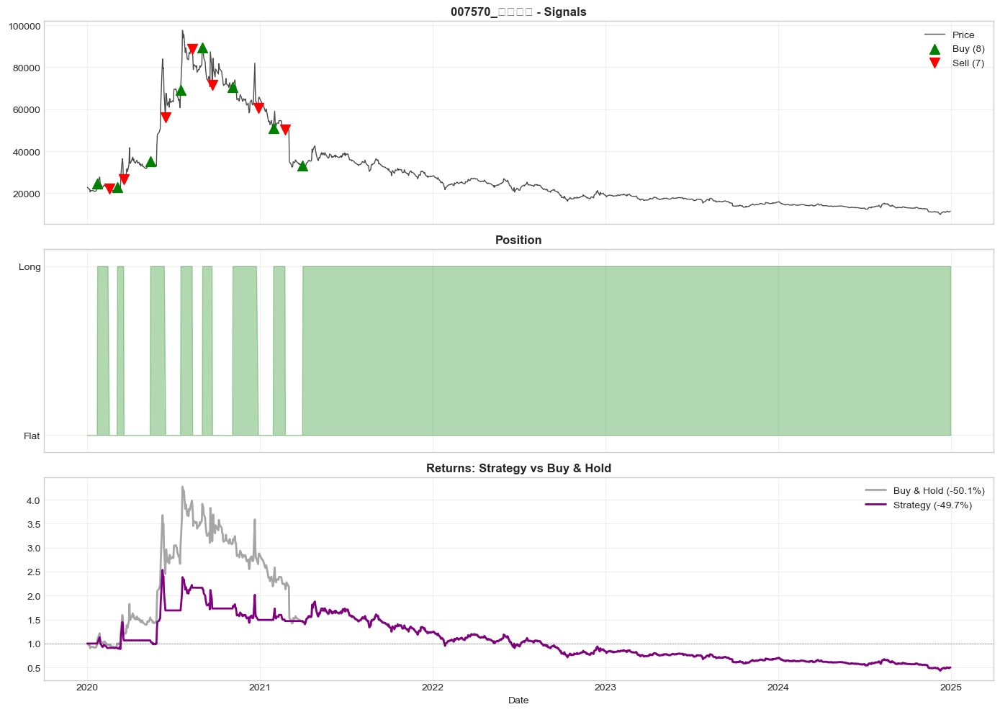


✓ Complete

[83/200] 007690_국도화학.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 36372.00 → 31600.00

Strategy:   26.00%  |  Market:  -13.12%  |  Excess:   39.12%
Sharpe:     0.511  |  Max DD:  -47.15%  |  Win:  43.9%  |  Trades:  25

First 5 trades:
  2020-01-02: BUY
  2020-03-31: SELL
  2020-04-10: BUY
  2020-05-11: SELL
  2020-05-29: BUY


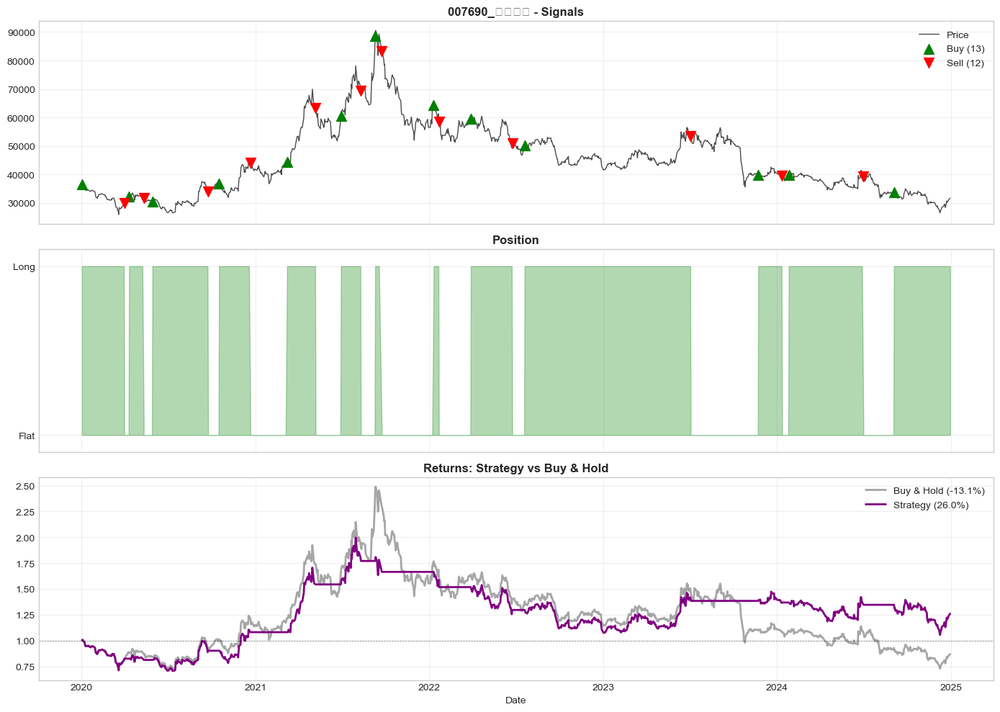


✓ Complete

[84/200] 007810_코리아써키트.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 12000.00 → 9120.00

Strategy:   -7.56%  |  Market:  -24.00%  |  Excess:   16.44%
Sharpe:     0.247  |  Max DD:  -73.51%  |  Win:  43.5%  |  Trades:  13

First 5 trades:
  2020-04-23: BUY
  2020-08-13: SELL
  2020-09-07: BUY
  2021-02-01: SELL
  2021-02-19: BUY


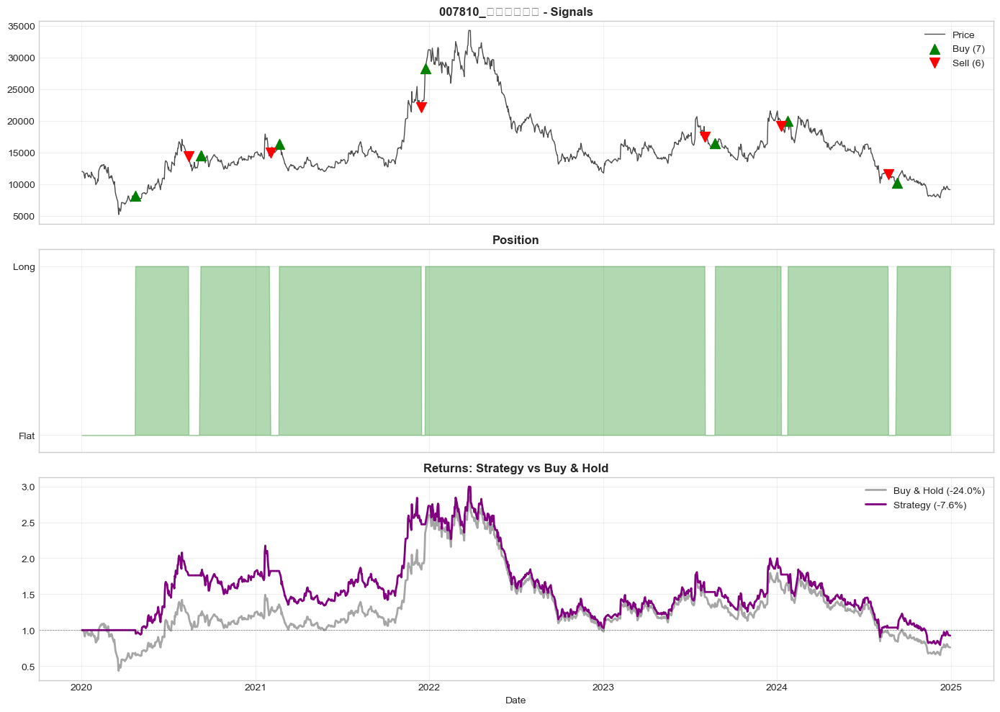


✓ Complete

[85/200] 007860_서연.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 3250.00 → 6750.00

Strategy:   95.77%  |  Market:  107.69%  |  Excess:  -11.92%
Sharpe:     0.659  |  Max DD:  -81.20%  |  Win:  46.5%  |  Trades:  21

First 5 trades:
  2020-05-19: BUY
  2020-08-25: SELL
  2020-10-19: BUY
  2020-11-04: SELL
  2021-01-06: BUY


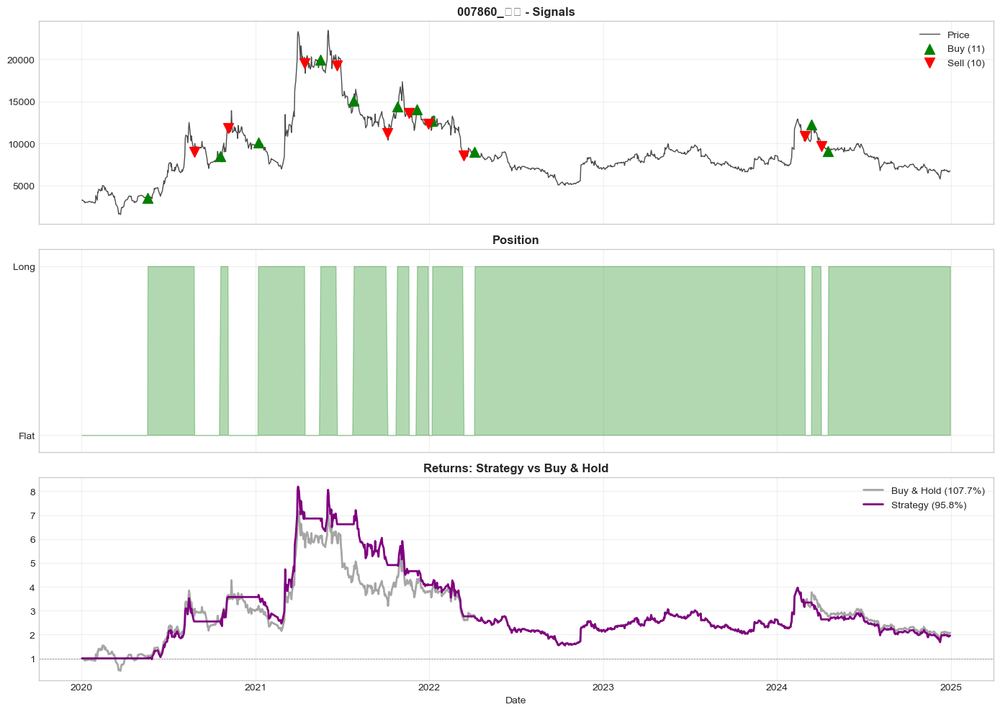


✓ Complete

[86/200] 008000_도레이케미칼.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[87/200] 008060_대덕전자.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 10350.00 → 6600.00

Strategy:  -21.83%  |  Market:  -36.23%  |  Excess:   14.40%
Sharpe:    -0.053  |  Max DD:  -43.41%  |  Win:  44.3%  |  Trades:   7

First 5 trades:
  2020-02-04: BUY
  2020-03-06: SELL
  2020-05-04: BUY
  2020-06-24: SELL
  2020-07-15: BUY


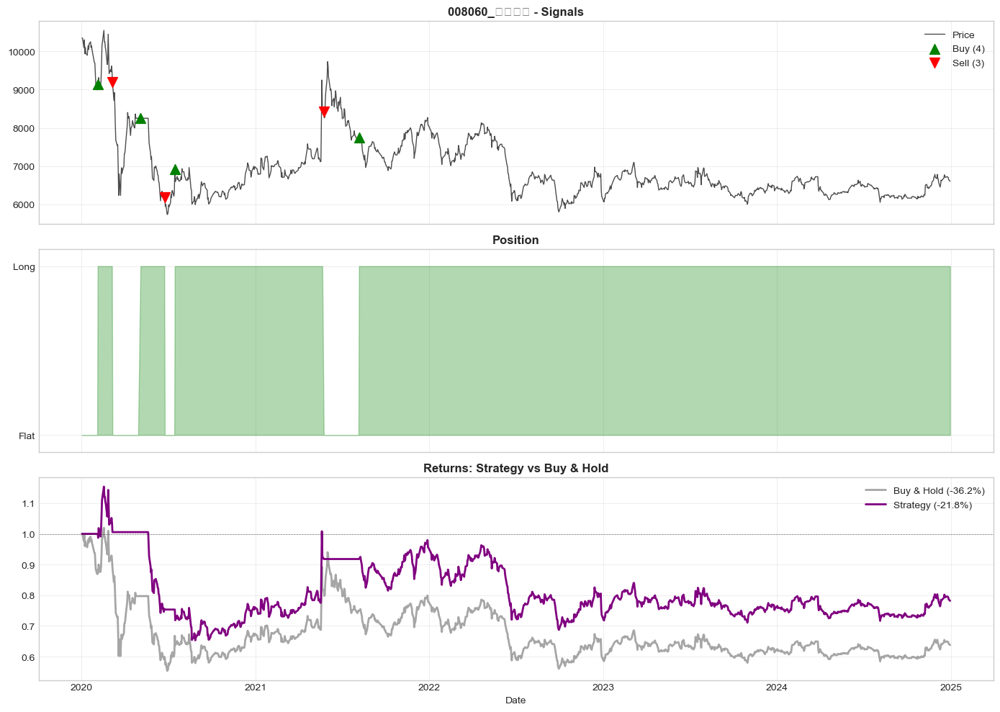


✓ Complete

[88/200] 008490_서흥.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 35400.00 → 12690.00

Strategy:  -70.61%  |  Market:  -64.15%  |  Excess:   -6.45%
Sharpe:    -0.928  |  Max DD:  -80.59%  |  Win:  42.7%  |  Trades:  18

First 5 trades:
  2020-01-02: BUY
  2020-03-06: SELL
  2020-04-21: BUY
  2020-06-04: SELL
  2020-07-20: BUY


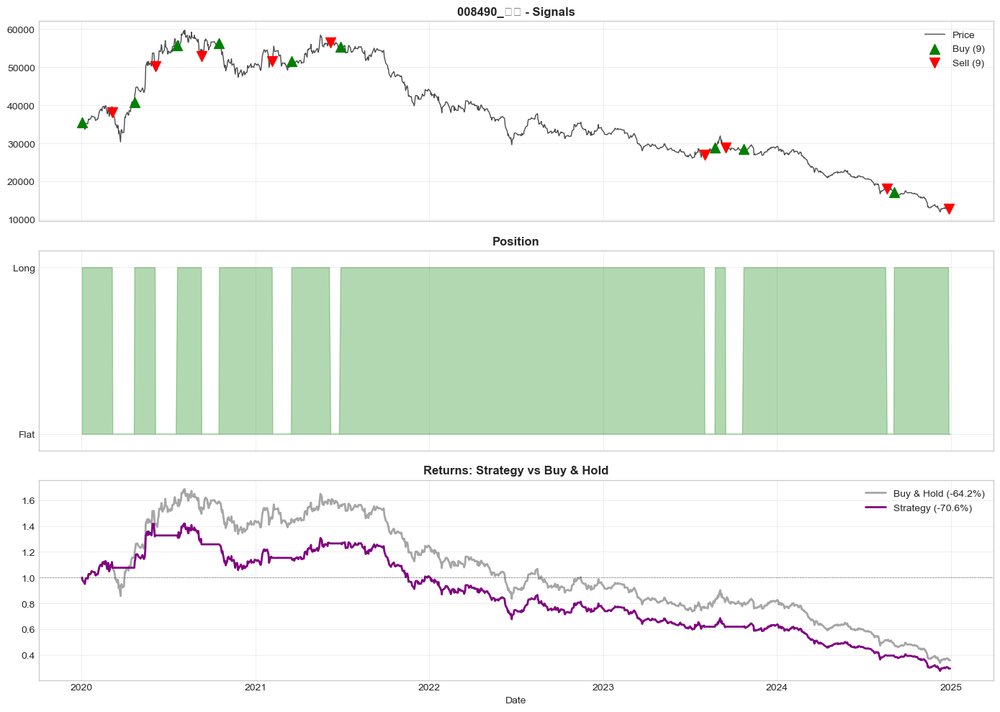


✓ Complete

[89/200] 008770_호텔신라.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 94000.00 → 36900.00

Strategy:  -59.83%  |  Market:  -60.74%  |  Excess:    0.92%
Sharpe:    -0.563  |  Max DD:  -68.05%  |  Win:  43.2%  |  Trades:  11

First 5 trades:
  2020-04-23: BUY
  2020-08-28: SELL
  2020-09-15: BUY
  2022-11-01: SELL
  2022-12-02: BUY


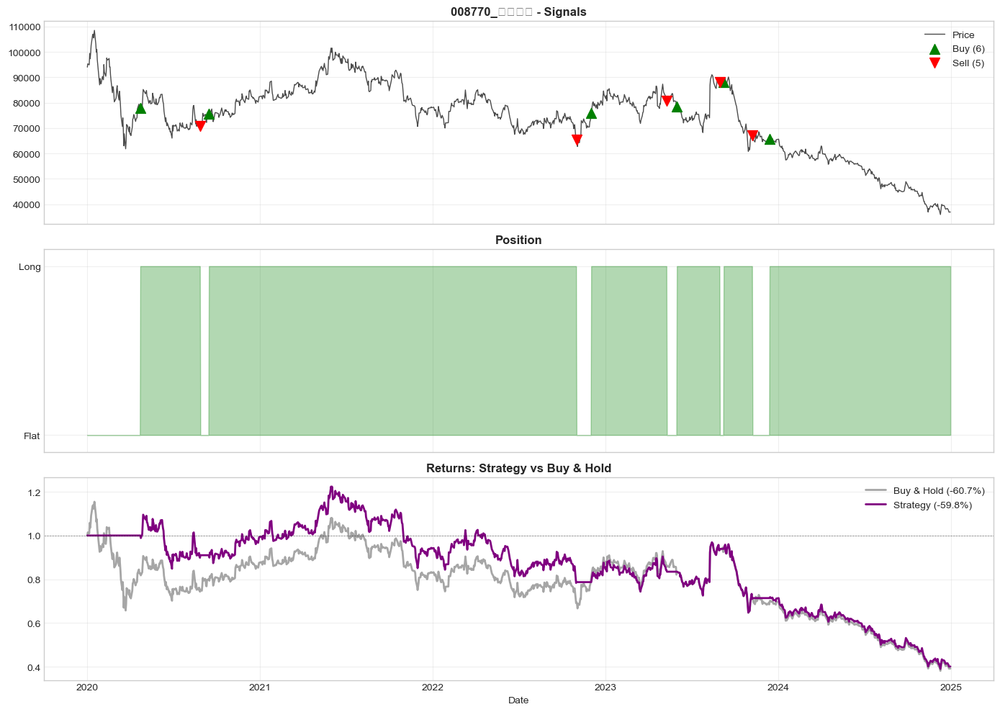


✓ Complete

[90/200] 009150_삼성전기.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 126500.00 → 123800.00

Strategy:  -20.03%  |  Market:   -2.13%  |  Excess:  -17.90%
Sharpe:     0.031  |  Max DD:  -53.80%  |  Win:  45.4%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-22: BUY
  2023-11-07: SELL
  2023-11-23: BUY


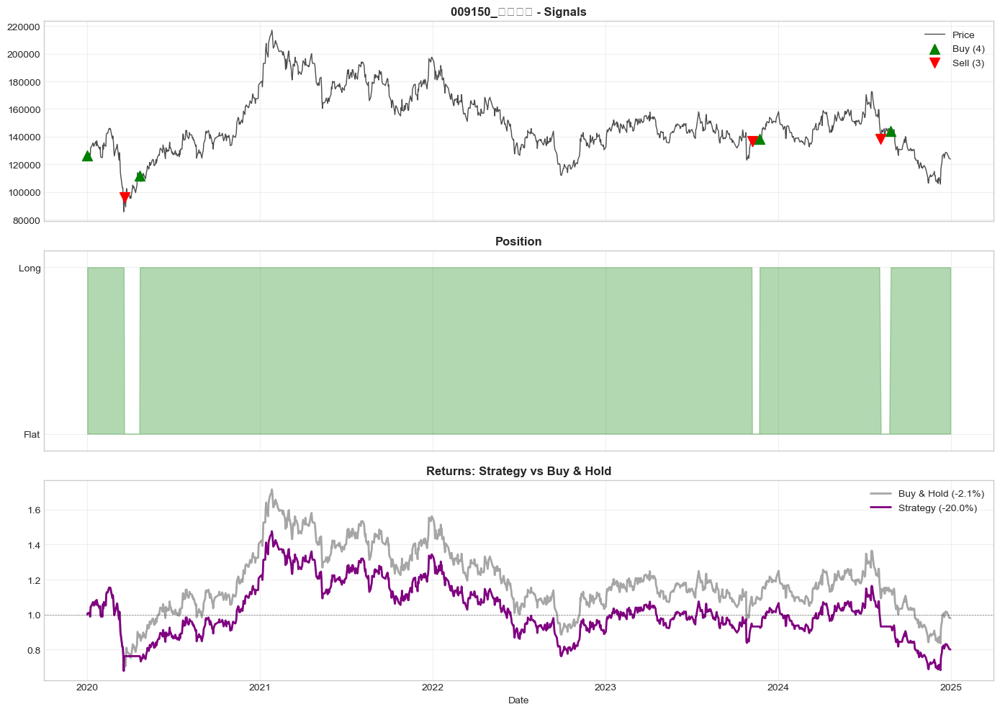


✓ Complete

[91/200] 009290_광동제약.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 6660.00 → 5440.00

Strategy:  -58.19%  |  Market:  -18.32%  |  Excess:  -39.87%
Sharpe:    -0.282  |  Max DD:  -62.14%  |  Win:  42.4%  |  Trades:  11

First 5 trades:
  2020-01-22: BUY
  2020-03-19: SELL
  2020-04-17: BUY
  2020-07-31: SELL
  2020-10-13: BUY


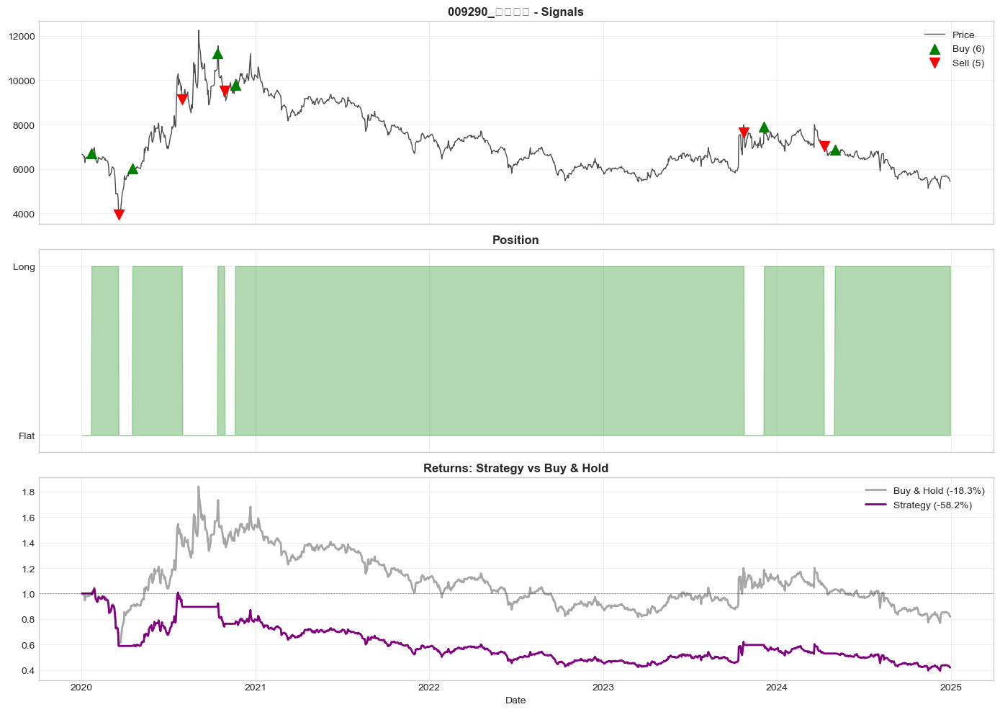


✓ Complete

[92/200] 009540_현대중공업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 125500.00 → 228000.00

Strategy:   87.06%  |  Market:   81.67%  |  Excess:    5.38%
Sharpe:     0.499  |  Max DD:  -56.82%  |  Win:  46.2%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-02-26: SELL
  2020-03-05: BUY
  2020-03-20: SELL
  2020-05-19: BUY


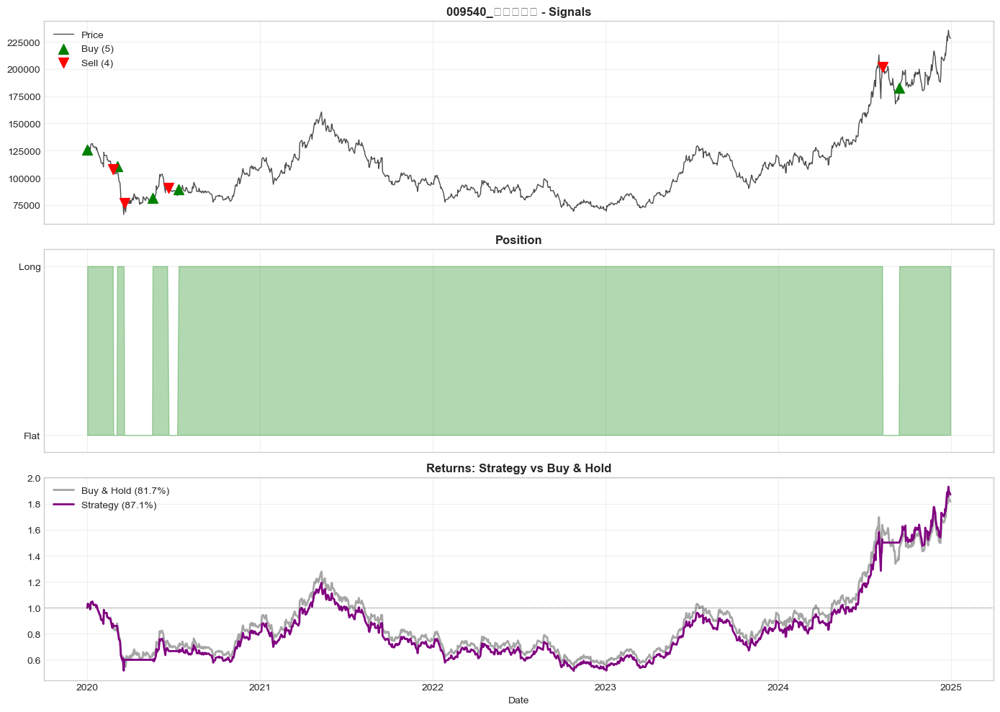


✓ Complete

[93/200] 009580_무림P&P.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4275.00 → 2835.00

Strategy:  -20.43%  |  Market:  -33.68%  |  Excess:   13.25%
Sharpe:     0.078  |  Max DD:  -54.44%  |  Win:  43.8%  |  Trades:  21

First 5 trades:
  2020-02-19: BUY
  2020-03-02: SELL
  2020-05-08: BUY
  2020-06-25: SELL
  2020-07-13: BUY


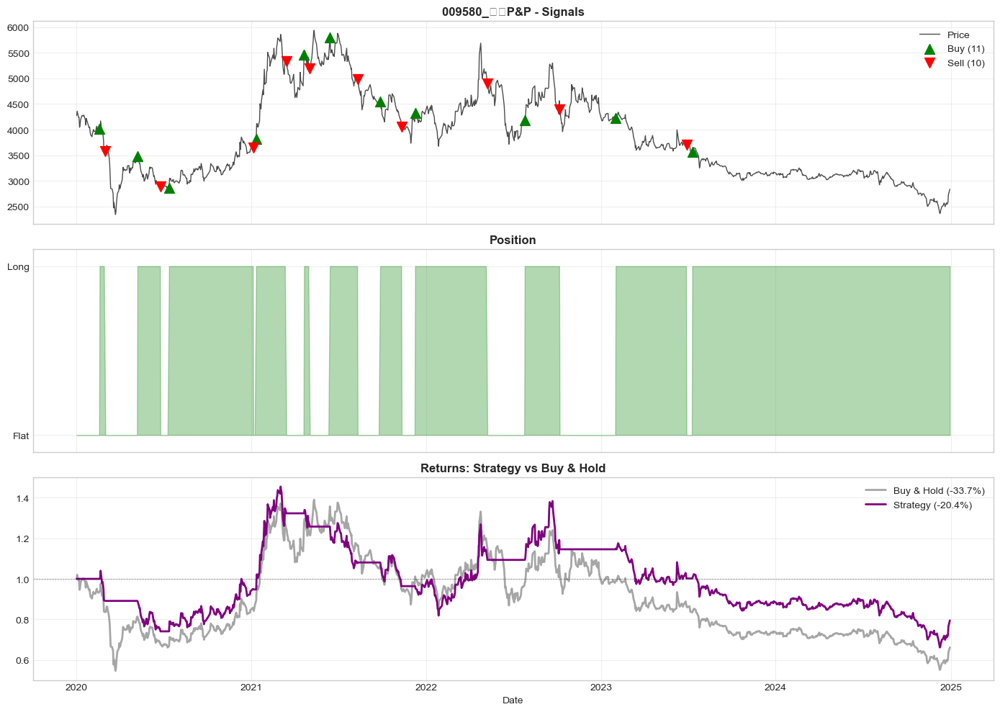


✓ Complete

[94/200] 009680_모토닉.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 8890.00 → 8440.00

Strategy:   -4.68%  |  Market:   -5.06%  |  Excess:    0.38%
Sharpe:     0.181  |  Max DD:  -52.48%  |  Win:  45.0%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-09-21: SELL
  2020-10-15: BUY


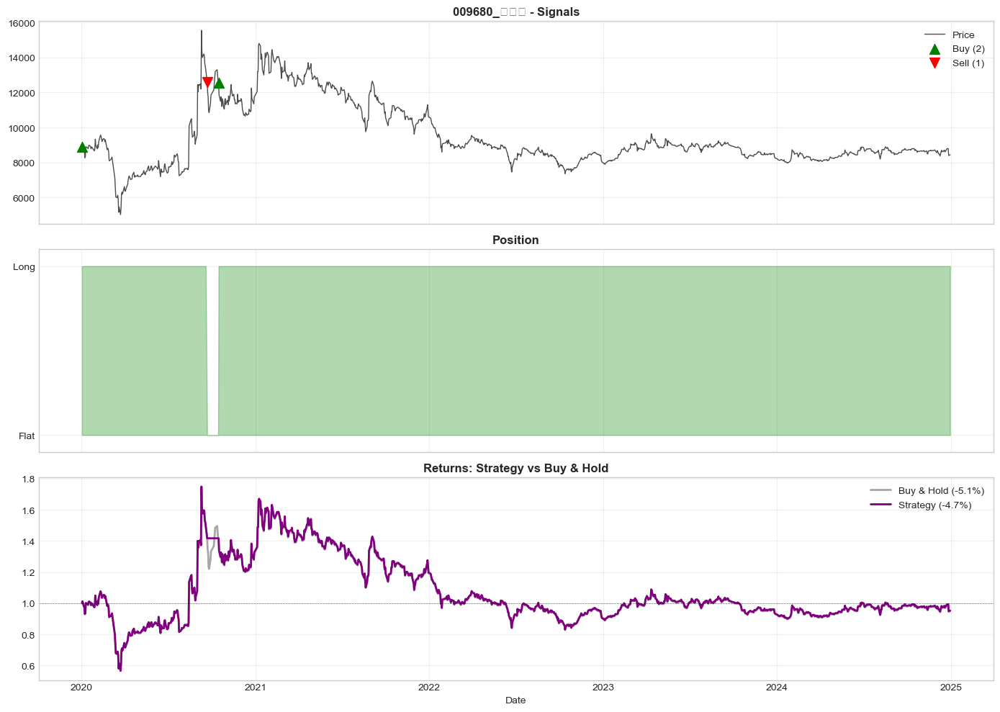


✓ Complete

[95/200] 009830_한화케미칼.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 22372.00 → 16120.00

Strategy:   16.46%  |  Market:  -27.95%  |  Excess:   44.40%
Sharpe:     0.405  |  Max DD:  -71.62%  |  Win:  43.0%  |  Trades:  16

First 5 trades:
  2020-01-02: BUY
  2020-03-09: SELL
  2020-04-27: BUY
  2020-09-18: SELL
  2021-01-05: BUY


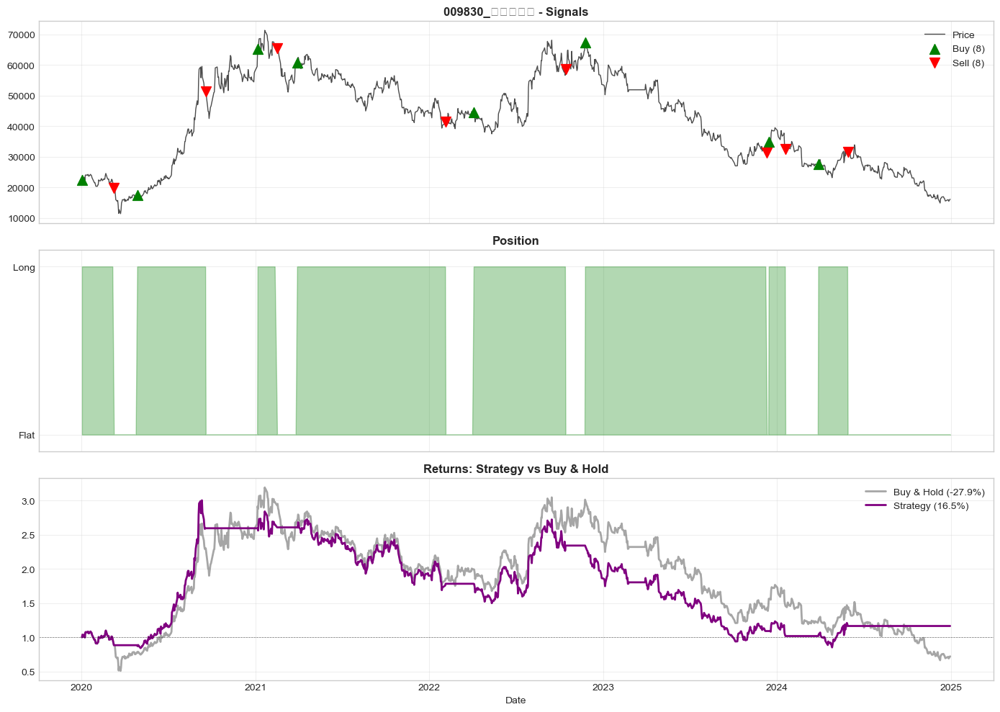


✓ Complete

[96/200] 010060_OCI.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 49905.00 → 58800.00

Strategy:    0.25%  |  Market:   17.82%  |  Excess:  -17.57%
Sharpe:     0.382  |  Max DD:  -52.00%  |  Win:  44.3%  |  Trades:  21

First 5 trades:
  2020-01-02: BUY
  2020-03-02: SELL
  2020-04-23: BUY
  2020-06-15: SELL
  2020-07-09: BUY


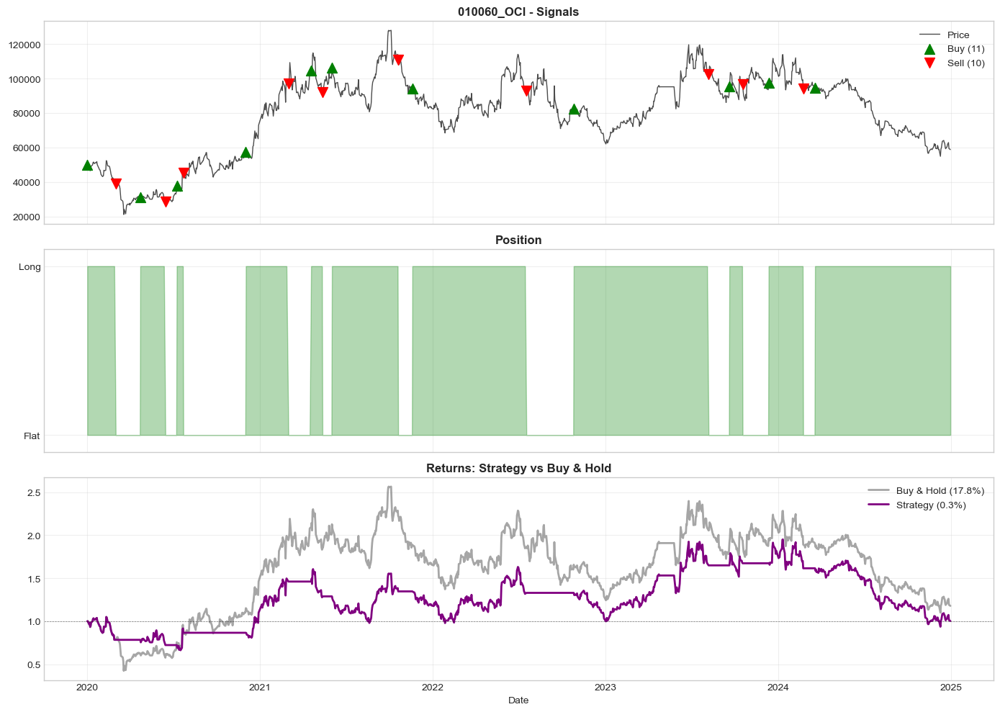


✓ Complete

[97/200] 010120_LS산전.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 52600.00 → 160800.00

Strategy:  103.01%  |  Market:  205.70%  |  Excess: -102.69%
Sharpe:     0.640  |  Max DD:  -52.37%  |  Win:  47.6%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-27: SELL
  2020-04-20: BUY
  2020-09-21: SELL
  2020-10-20: BUY


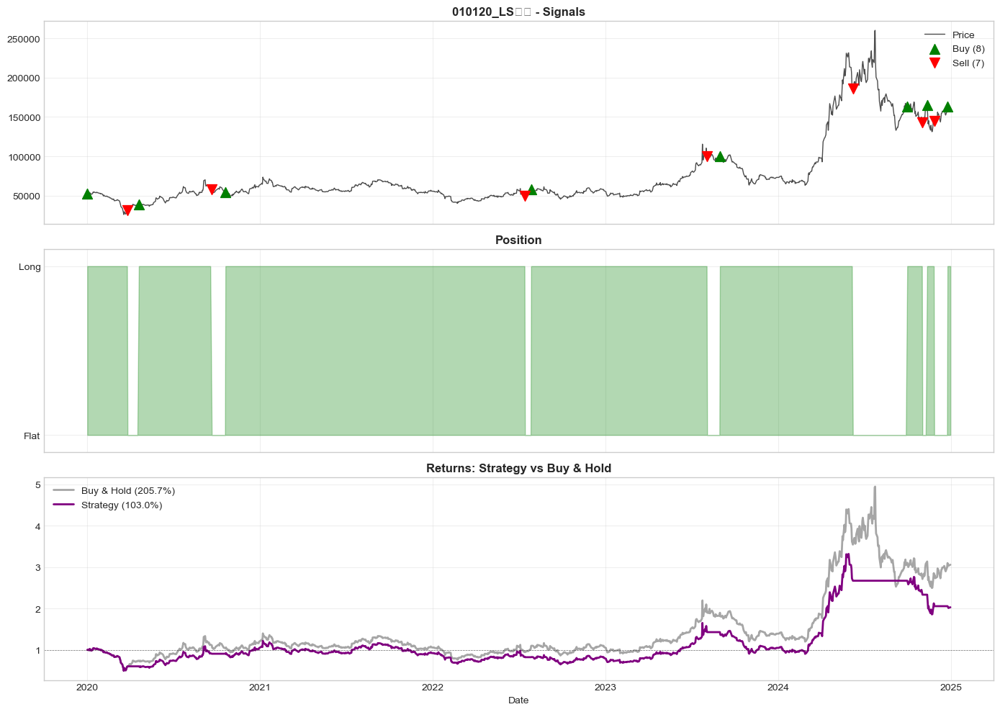


✓ Complete

[98/200] 010130_고려아연.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 424000.00 → 1006000.00

Strategy:   92.79%  |  Market:  137.26%  |  Excess:  -44.48%
Sharpe:     0.736  |  Max DD:  -47.02%  |  Win:  46.1%  |  Trades:   4

First 5 trades:
  2020-01-02: BUY
  2024-10-30: SELL
  2024-12-03: BUY
  2024-12-16: SELL


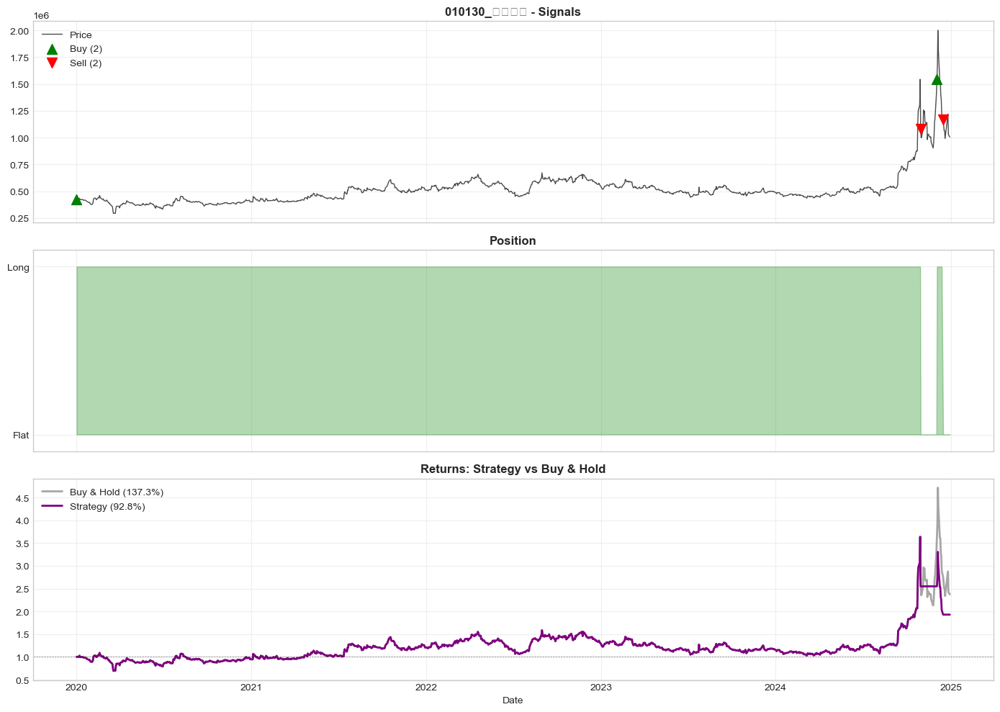


✓ Complete

[99/200] 010140_삼성중공업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 6815.00 → 11300.00

Strategy:   90.37%  |  Market:   65.81%  |  Excess:   24.56%
Sharpe:     0.662  |  Max DD:  -42.30%  |  Win:  46.1%  |  Trades:  13

First 5 trades:
  2020-01-30: BUY
  2020-03-16: SELL
  2020-05-21: BUY
  2020-06-15: SELL
  2020-07-15: BUY


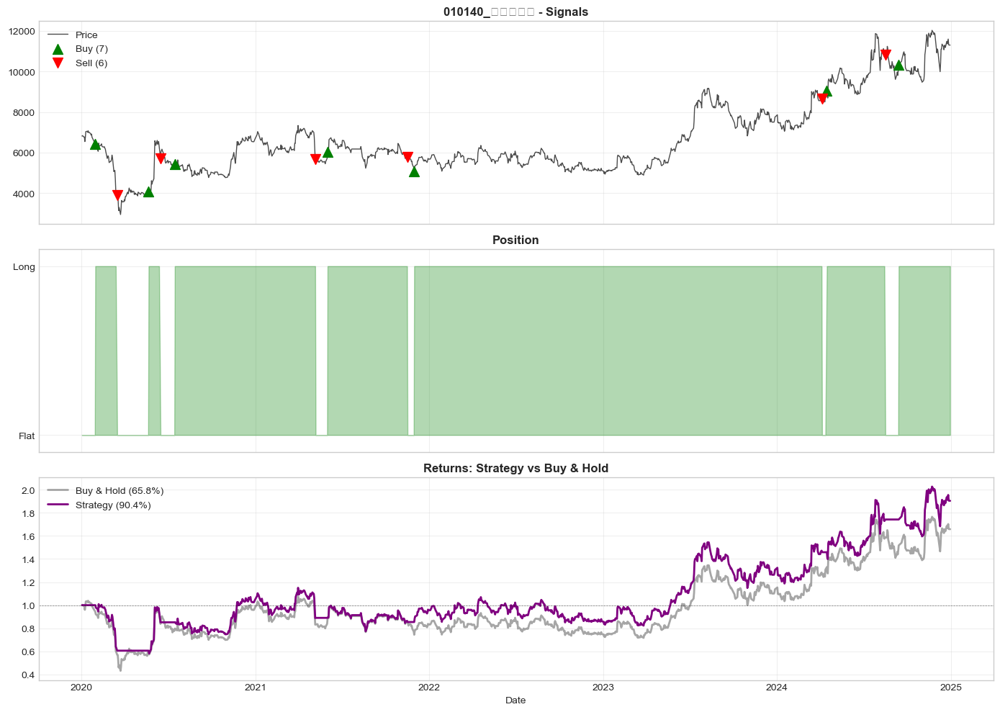


✓ Complete

[100/200] 010520_현대하이스코.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[101/200] 010620_현대미포조선.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 44900.00 → 134200.00

Strategy:  204.59%  |  Market:  198.89%  |  Excess:    5.70%
Sharpe:     0.743  |  Max DD:  -48.94%  |  Win:  47.3%  |  Trades:  11

First 5 trades:
  2020-02-20: BUY
  2020-03-20: SELL
  2020-04-23: BUY
  2020-06-22: SELL
  2020-07-13: BUY


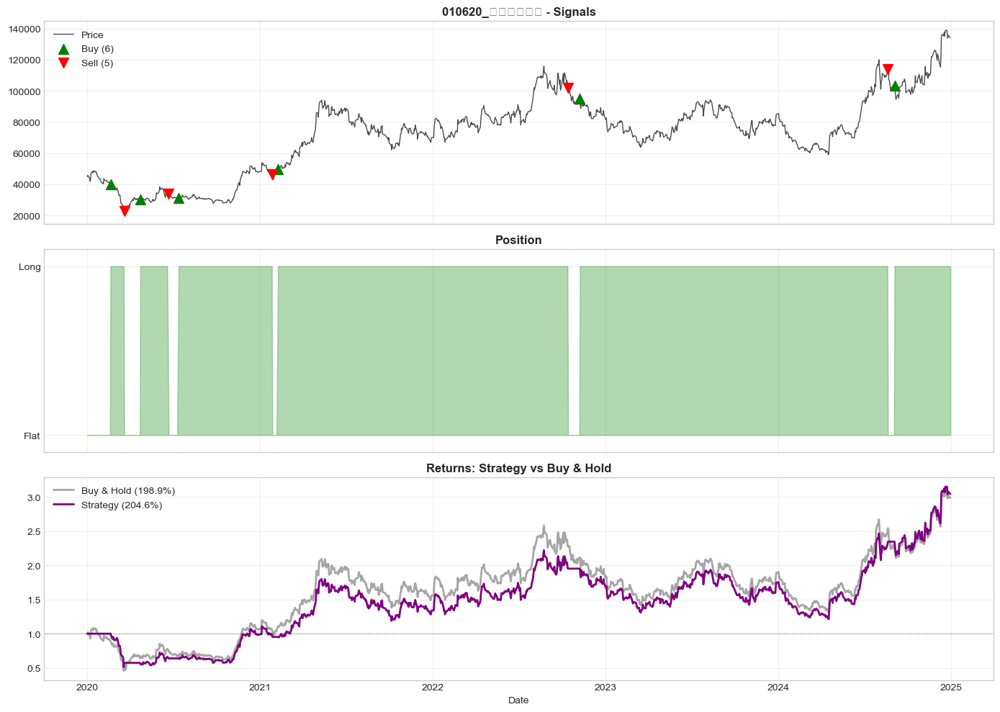


✓ Complete

[102/200] 010690_화신.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 3365.00 → 6830.00

Strategy:   57.96%  |  Market:  102.97%  |  Excess:  -45.01%
Sharpe:     0.588  |  Max DD:  -61.71%  |  Win:  45.4%  |  Trades:  23

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-21: BUY
  2020-08-27: SELL
  2020-09-15: BUY


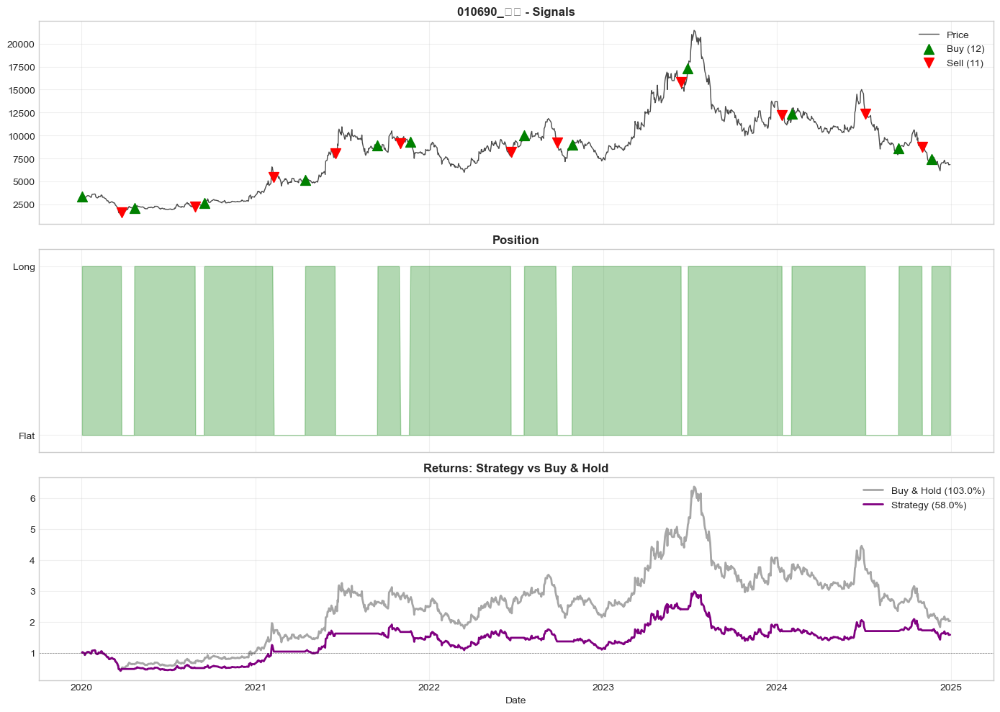


✓ Complete

[103/200] 010780_아이에스동서.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 32800.00 → 20900.00

Strategy:  -48.67%  |  Market:  -36.28%  |  Excess:  -12.39%
Sharpe:    -0.206  |  Max DD:  -72.84%  |  Win:  44.8%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-05-07: BUY
  2023-03-10: SELL
  2023-04-03: BUY


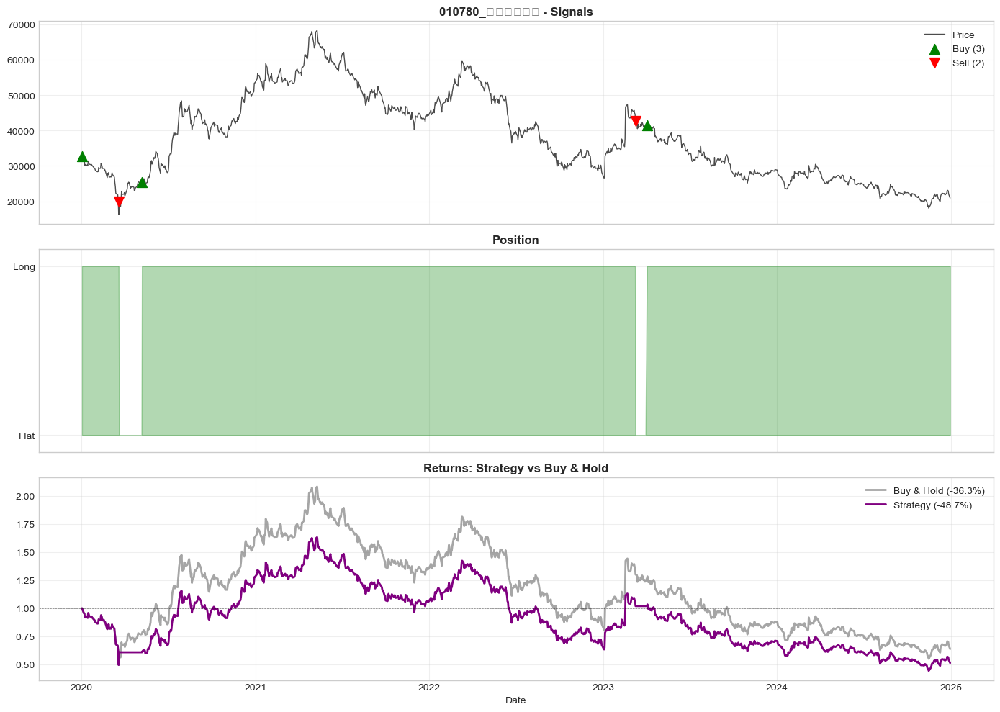


✓ Complete

[104/200] 010950_S-Oil.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 91900.00 → 54800.00

Strategy:  -52.07%  |  Market:  -40.37%  |  Excess:  -11.70%
Sharpe:    -0.350  |  Max DD:  -56.75%  |  Win:  46.1%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-19: BUY


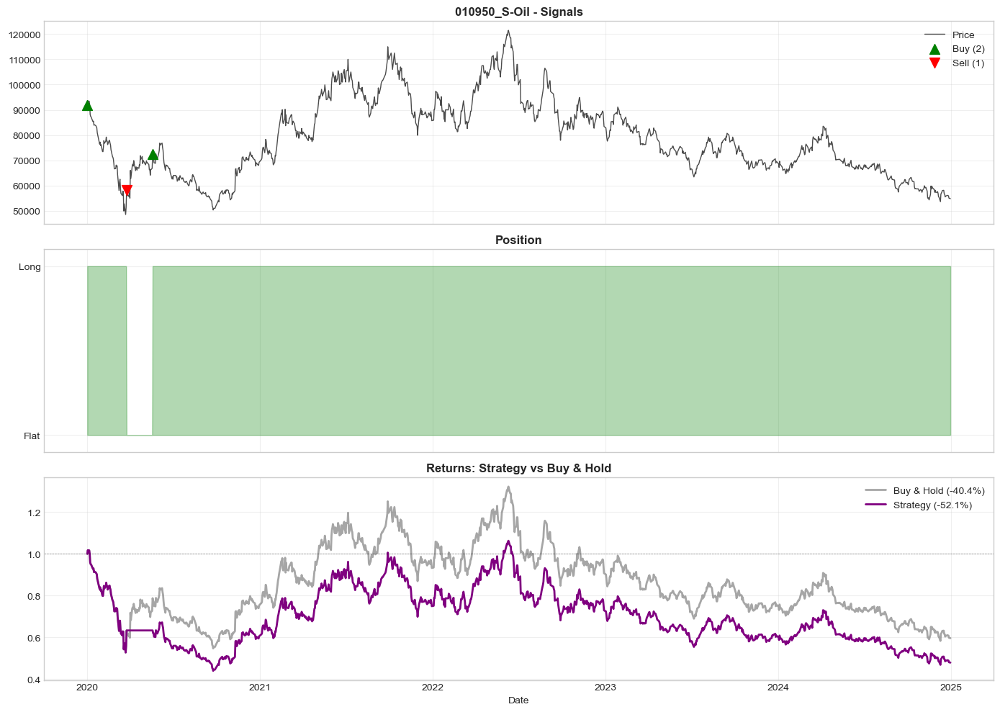


✓ Complete

[105/200] 011070_LG이노텍.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 139000.00 → 162000.00

Strategy:  -16.00%  |  Market:   16.55%  |  Excess:  -32.55%
Sharpe:     0.005  |  Max DD:  -62.89%  |  Win:  46.5%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-05-08: BUY


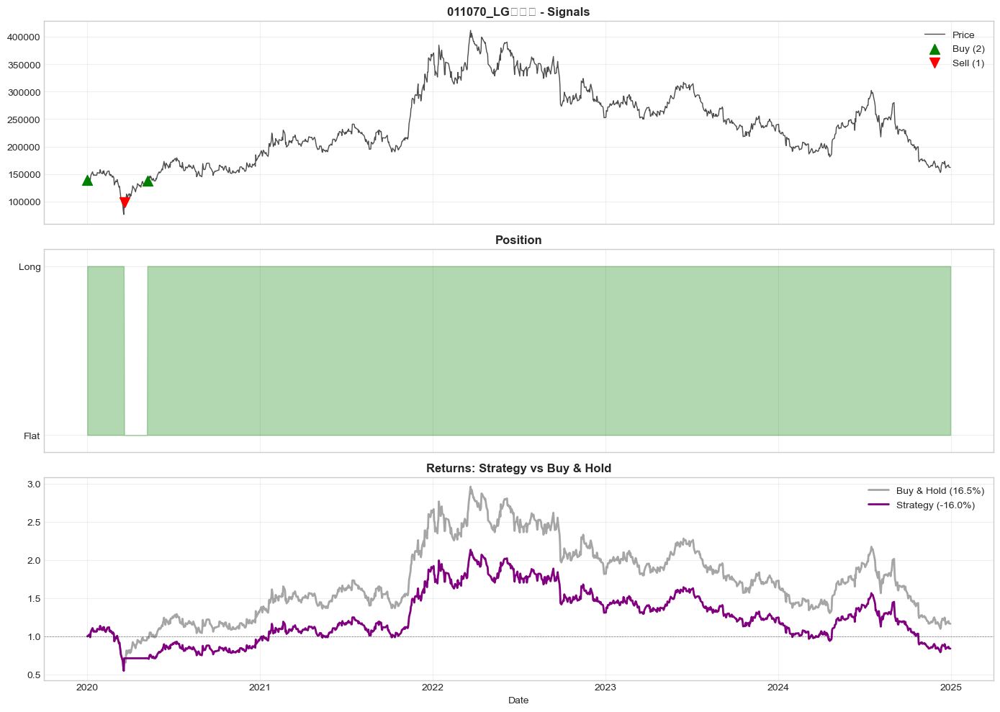


✓ Complete

[106/200] 011170_롯데케미칼.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 208123.00 → 59800.00

Strategy:  -76.31%  |  Market:  -71.27%  |  Excess:   -5.05%
Sharpe:    -0.608  |  Max DD:  -81.95%  |  Win:  42.7%  |  Trades:   3

First 5 trades:
  2020-01-30: BUY
  2020-03-20: SELL
  2020-04-20: BUY


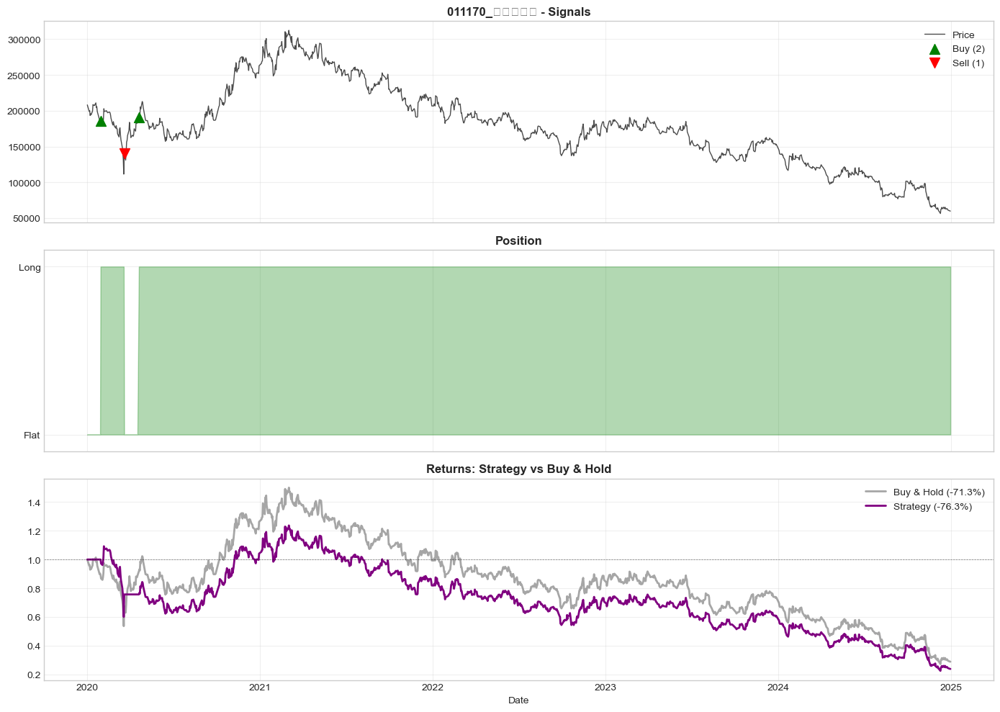


✓ Complete

[107/200] 011200_현대상선.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 3750.00 → 17660.00

Strategy:  147.82%  |  Market:  370.93%  |  Excess: -223.11%
Sharpe:     0.762  |  Max DD:  -65.51%  |  Win:  48.8%  |  Trades:  21

First 5 trades:
  2020-01-22: BUY
  2020-03-19: SELL
  2020-04-17: BUY
  2020-06-19: SELL
  2020-07-14: BUY


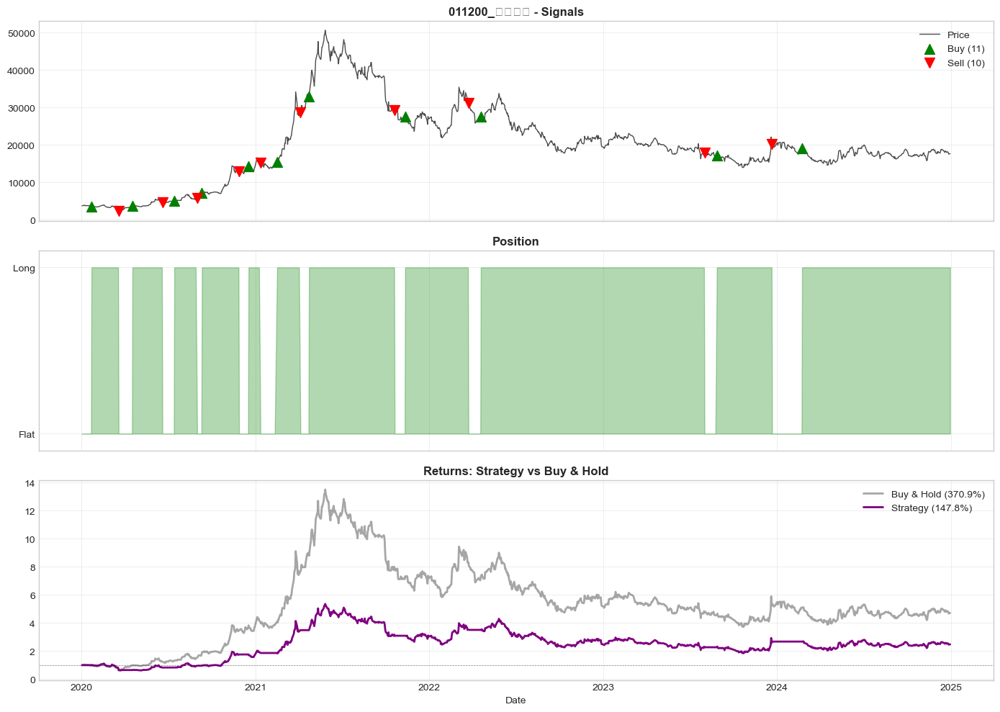


✓ Complete

[108/200] 011210_현대위아.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 48950.00 → 37800.00

Strategy:  -44.00%  |  Market:  -22.78%  |  Excess:  -21.22%
Sharpe:    -0.087  |  Max DD:  -67.27%  |  Win:  43.6%  |  Trades:   9

First 5 trades:
  2020-01-28: BUY
  2020-03-25: SELL
  2020-04-21: BUY
  2020-05-04: SELL
  2020-05-19: BUY


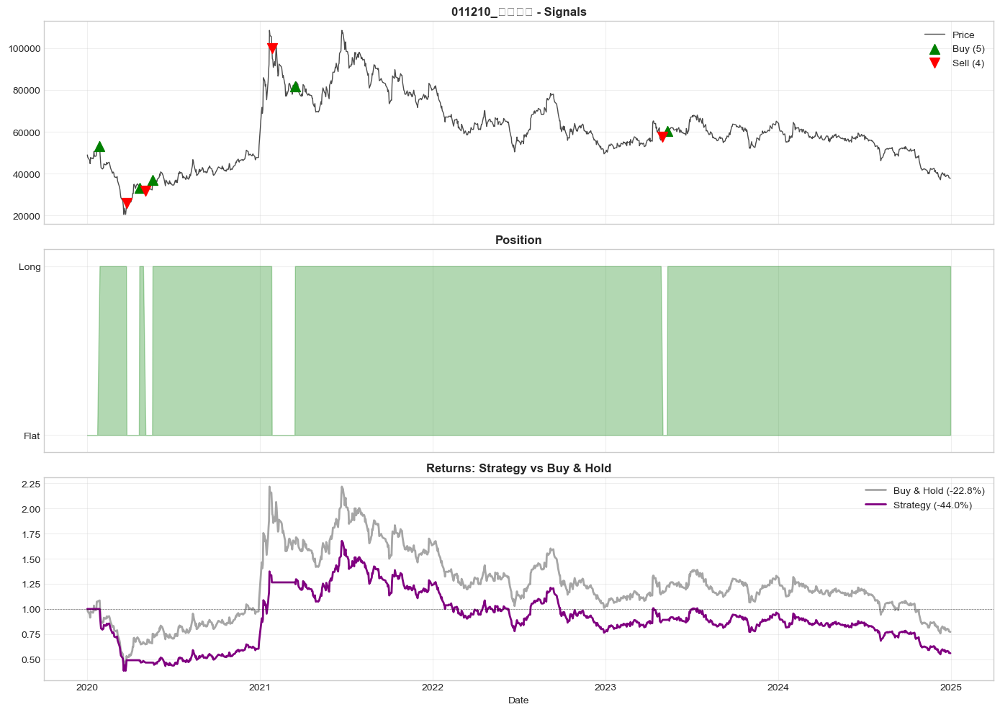


✓ Complete

[109/200] 011780_금호석유.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 76000.00 → 90600.00

Strategy:    7.70%  |  Market:   19.21%  |  Excess:  -11.51%
Sharpe:     0.157  |  Max DD:  -67.03%  |  Win:  44.5%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2020-11-25: SELL
  2020-12-11: BUY


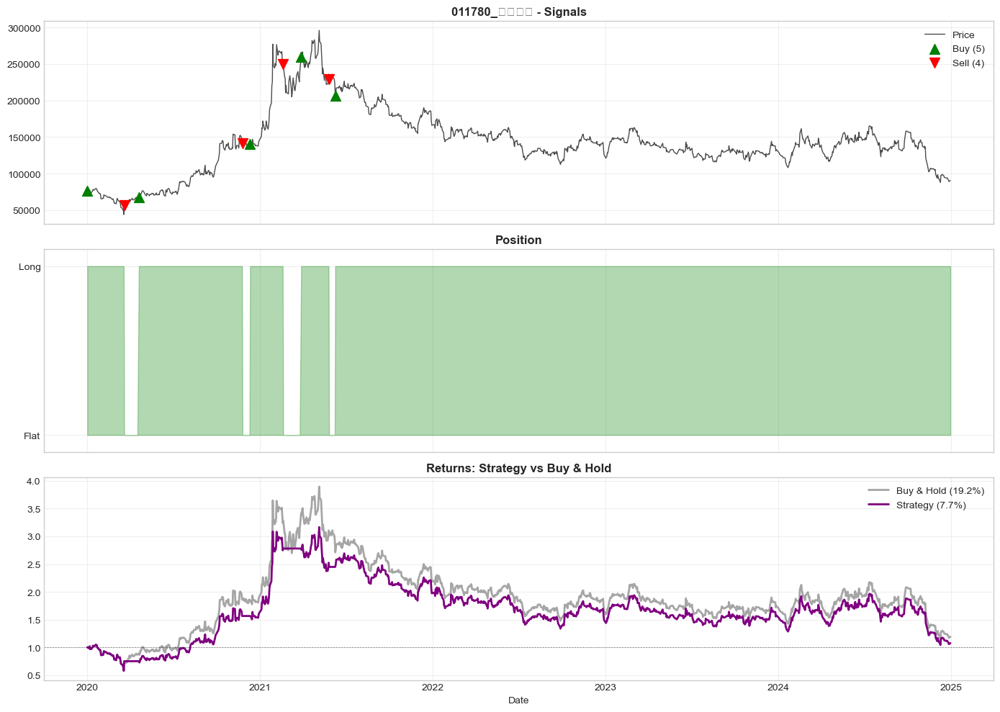


✓ Complete

[110/200] 011790_SKC.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 50600.00 → 105100.00

Strategy:   42.65%  |  Market:  107.71%  |  Excess:  -65.06%
Sharpe:     0.375  |  Max DD:  -68.34%  |  Win:  46.9%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2021-10-07: SELL
  2021-11-01: BUY


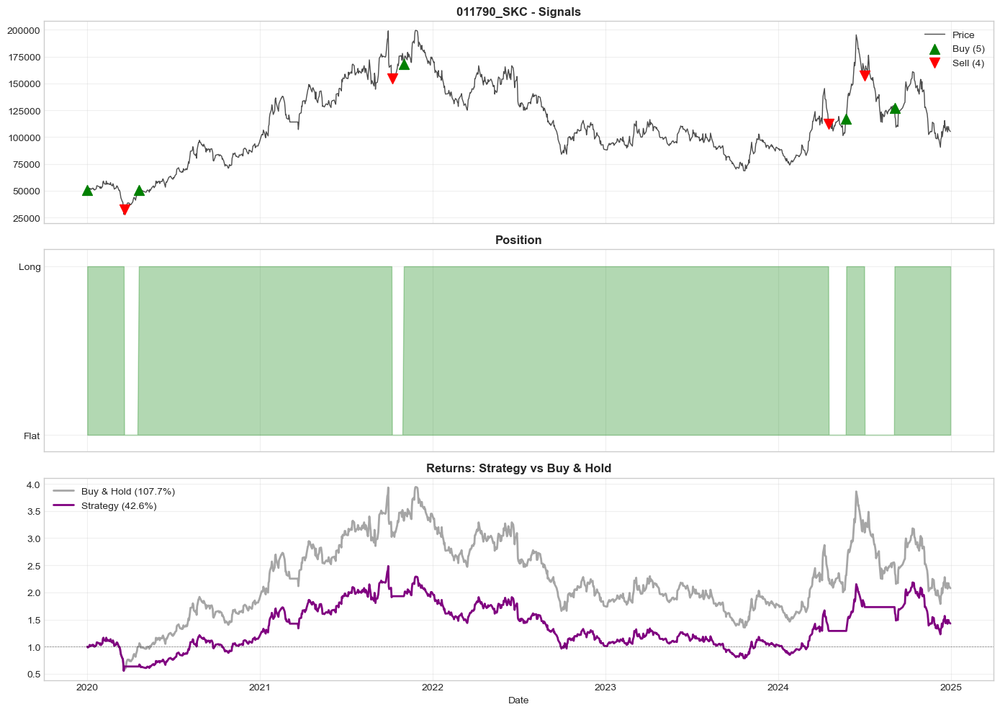


✓ Complete

[111/200] 012330_현대모비스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 247500.00 → 236500.00

Strategy:   -5.29%  |  Market:   -4.44%  |  Excess:   -0.85%
Sharpe:     0.086  |  Max DD:  -48.91%  |  Win:  44.3%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-23: BUY
  2020-06-25: SELL
  2020-07-15: BUY


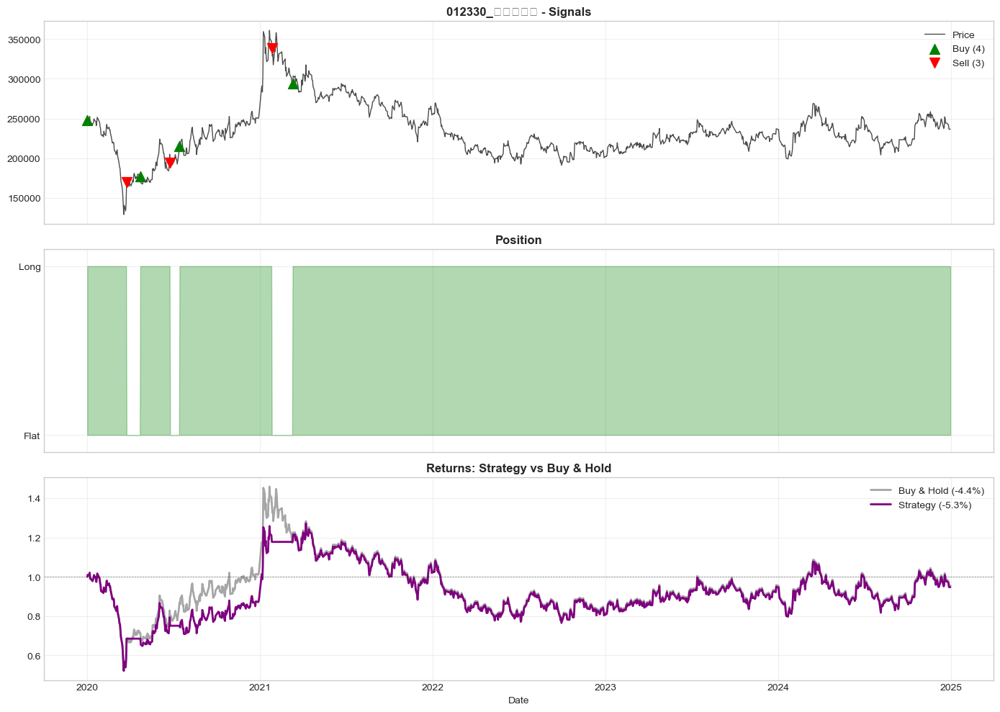


✓ Complete

[112/200] 012450_삼성테크윈.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 35347.00 → 321506.00

Strategy:  257.36%  |  Market:  809.57%  |  Excess: -552.21%
Sharpe:     0.933  |  Max DD:  -59.48%  |  Win:  48.6%  |  Trades:  32

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-21: BUY
  2020-05-19: SELL
  2020-06-03: BUY


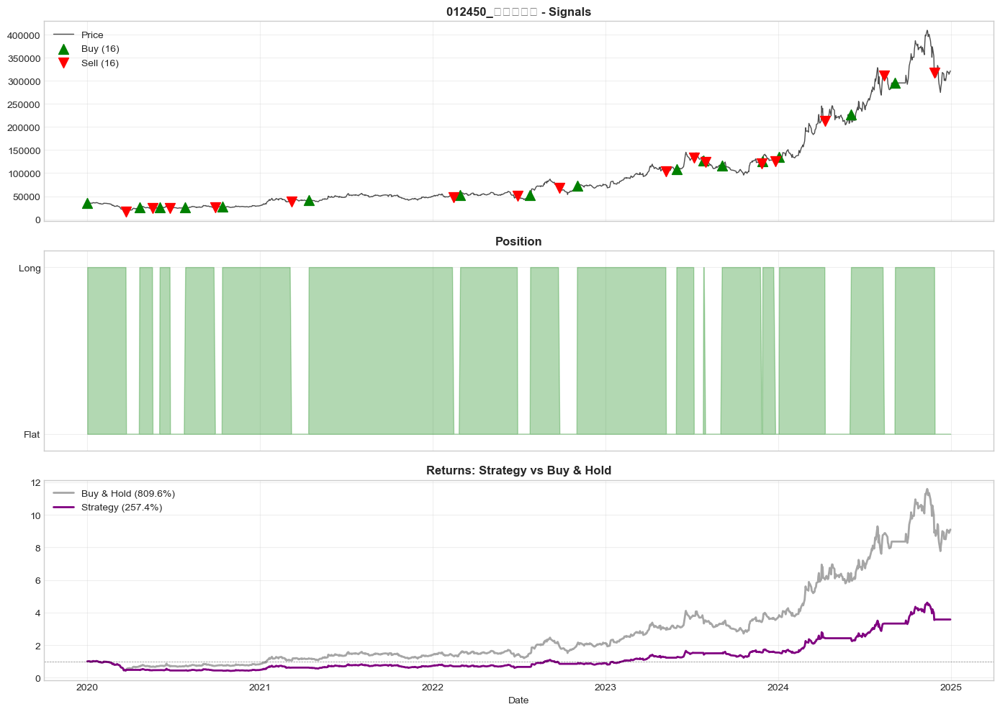


✓ Complete

[113/200] 012630_현대산업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 10900.00 → 11910.00

Strategy:   45.20%  |  Market:    9.27%  |  Excess:   35.93%
Sharpe:     0.599  |  Max DD:  -63.90%  |  Win:  45.3%  |  Trades:  15

First 5 trades:
  2020-04-20: BUY
  2020-08-20: SELL
  2020-11-03: BUY
  2021-02-16: SELL
  2021-03-08: BUY


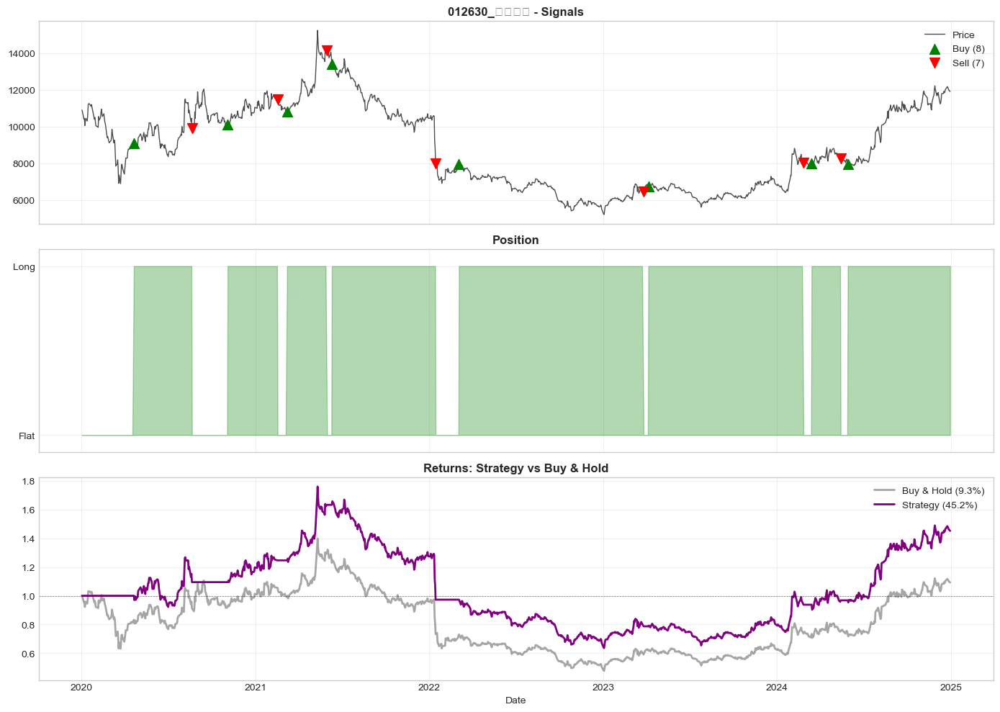


✓ Complete

[114/200] 012750_에스원.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 92500.00 → 59200.00

Strategy:  -43.70%  |  Market:  -36.00%  |  Excess:   -7.70%
Sharpe:    -0.329  |  Max DD:  -51.89%  |  Win:  43.0%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-05-08: BUY
  2020-06-16: SELL
  2020-08-11: BUY


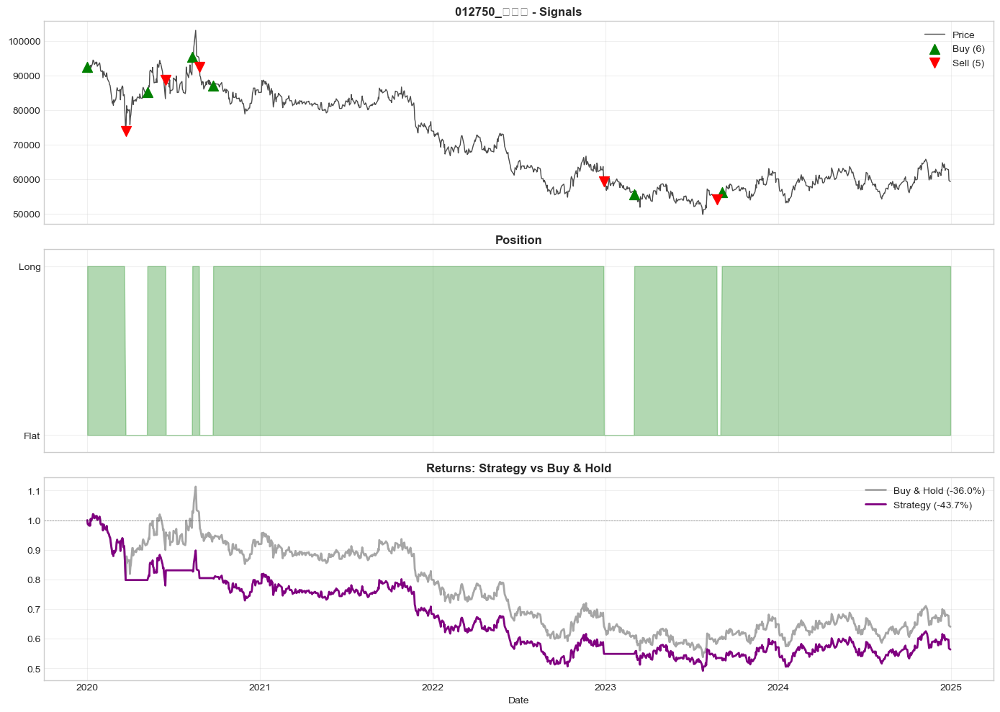


✓ Complete

[115/200] 013570_동양기전.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 5700.00 → 3875.00

Strategy:  -36.34%  |  Market:  -32.02%  |  Excess:   -4.32%
Sharpe:     0.346  |  Max DD:  -65.58%  |  Win:  42.9%  |  Trades:  19

First 5 trades:
  2020-02-20: BUY
  2020-03-13: SELL
  2020-05-04: BUY
  2021-11-30: SELL
  2021-12-28: BUY


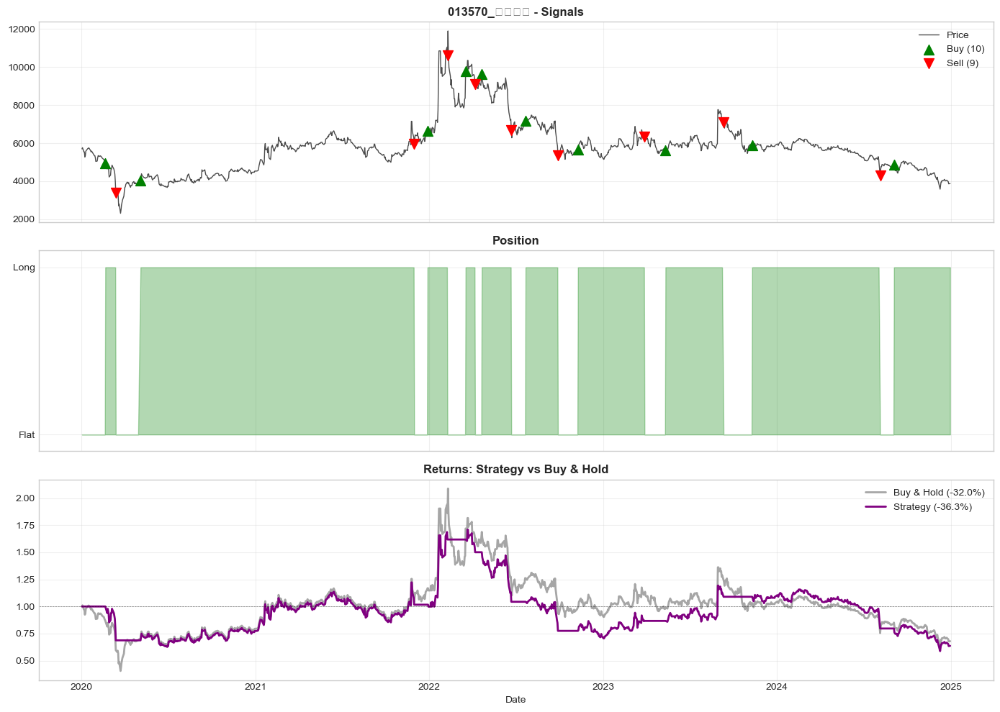


✓ Complete

[116/200] 014830_유니드.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 53805.00 → 72300.00

Strategy:   53.47%  |  Market:   34.37%  |  Excess:   19.09%
Sharpe:     0.419  |  Max DD:  -46.44%  |  Win:  43.0%  |  Trades:  21

First 5 trades:
  2020-01-02: BUY
  2021-05-14: SELL
  2021-06-16: BUY
  2021-08-05: SELL
  2022-01-05: BUY


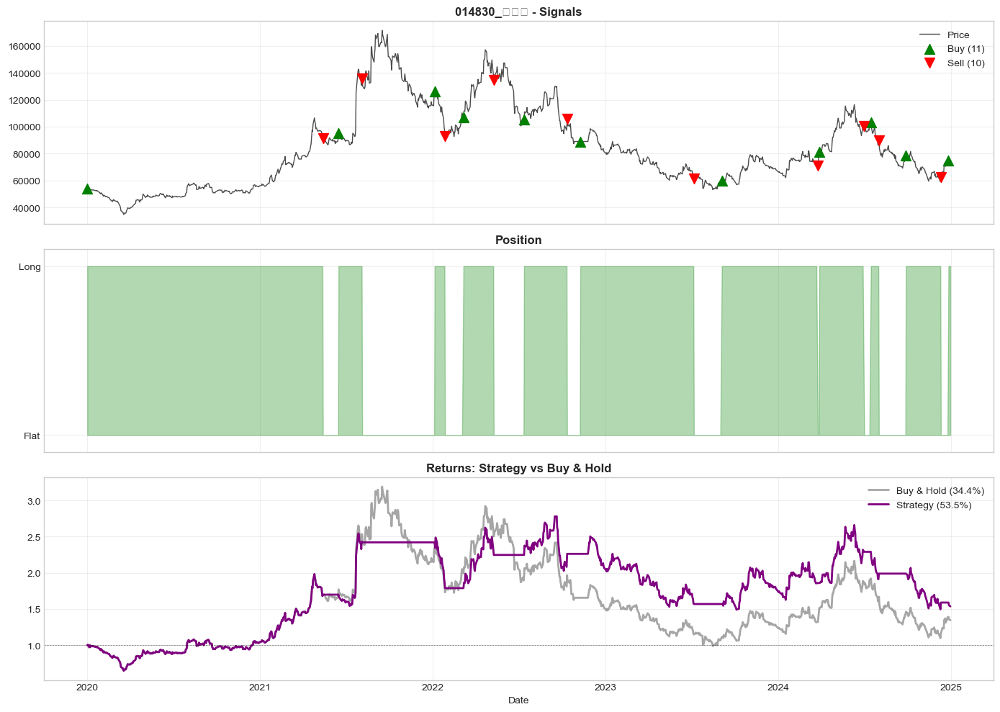


✓ Complete

[117/200] 015760_한국전력.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 28500.00 → 20050.00

Strategy:  -20.04%  |  Market:  -29.65%  |  Excess:    9.61%
Sharpe:     0.116  |  Max DD:  -42.44%  |  Win:  43.8%  |  Trades:  22

First 5 trades:
  2020-01-02: BUY
  2020-03-11: SELL
  2020-04-21: BUY
  2020-05-15: SELL
  2020-06-09: BUY


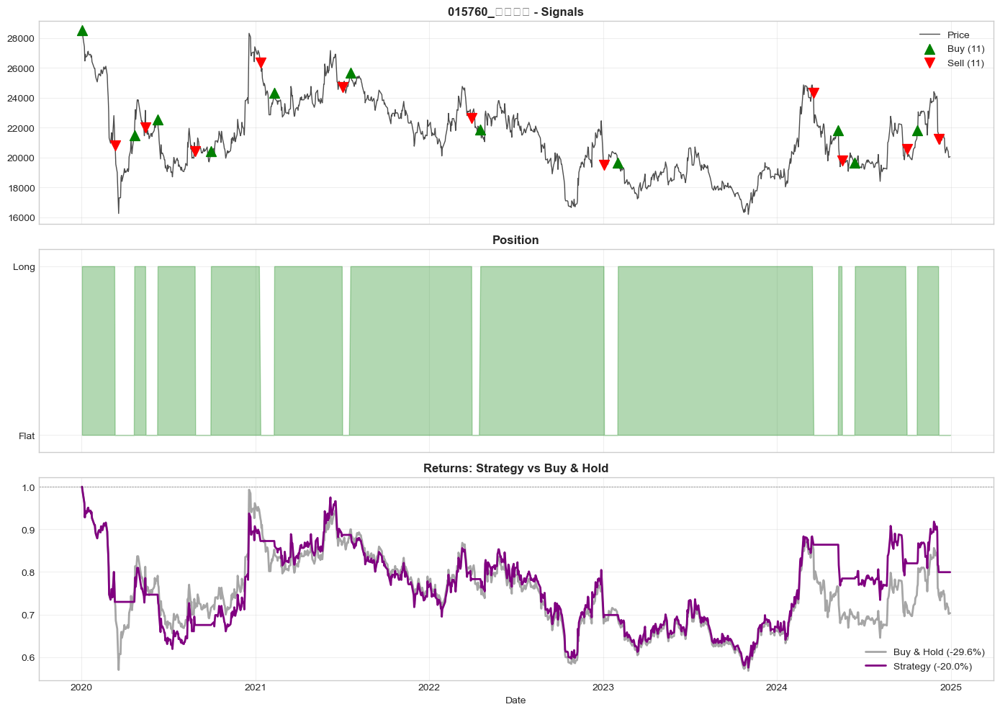


✓ Complete

[118/200] 016360_삼성증권.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 37850.00 → 43500.00

Strategy:  -19.05%  |  Market:   14.93%  |  Excess:  -33.97%
Sharpe:     0.104  |  Max DD:  -48.33%  |  Win:  48.8%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-05-28: BUY
  2020-06-23: SELL
  2020-07-15: BUY


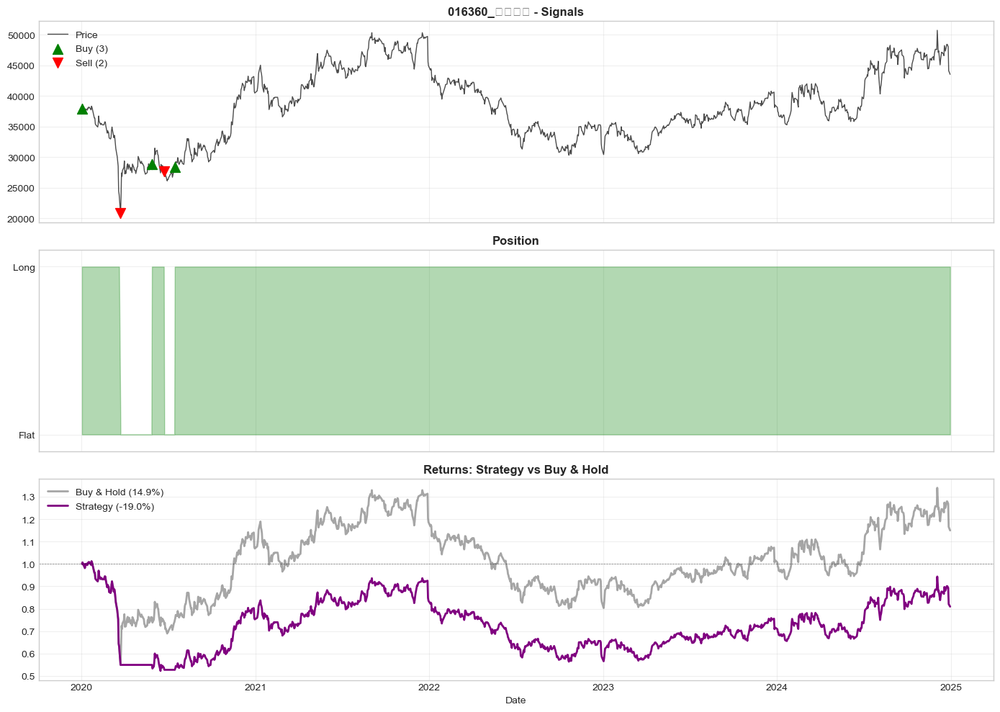


✓ Complete

[119/200] 016800_퍼시스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 29450.00 → 40800.00

Strategy:   59.15%  |  Market:   38.54%  |  Excess:   20.61%
Sharpe:     0.456  |  Max DD:  -45.35%  |  Win:  47.4%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2021-04-28: SELL
  2021-06-30: BUY


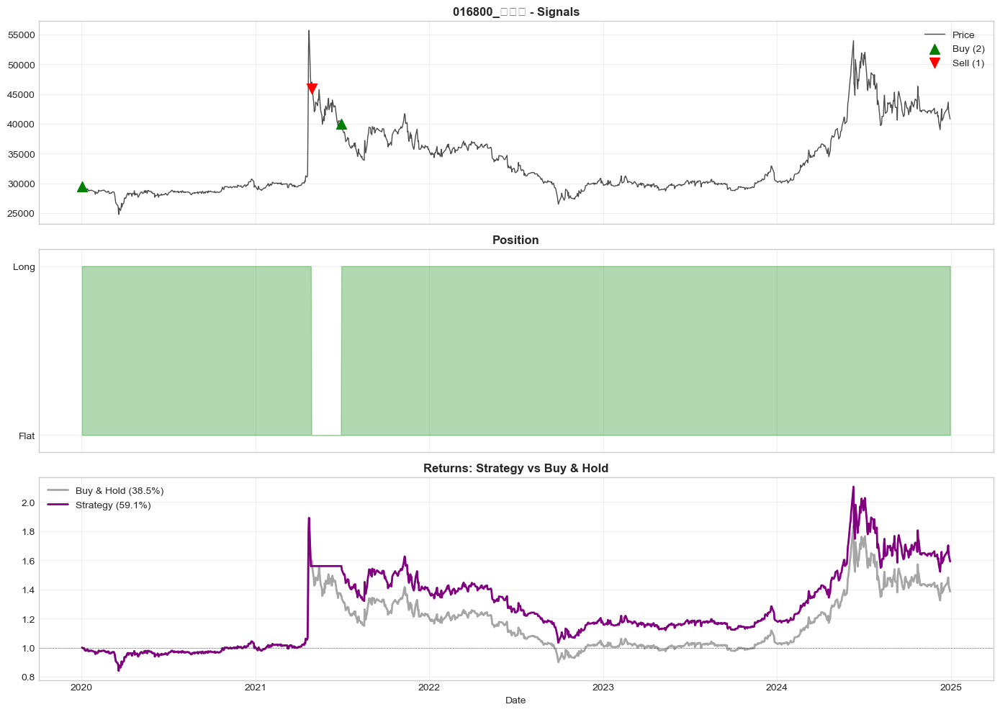


✓ Complete

[120/200] 017670_SK텔레콤.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 40374.00 → 55200.00

Strategy:  -11.85%  |  Market:   36.72%  |  Excess:  -48.57%
Sharpe:     0.213  |  Max DD:  -25.05%  |  Win:  45.5%  |  Trades:  22

First 5 trades:
  2020-04-23: BUY
  2020-05-13: SELL
  2020-06-03: BUY
  2020-06-15: SELL
  2020-11-30: BUY


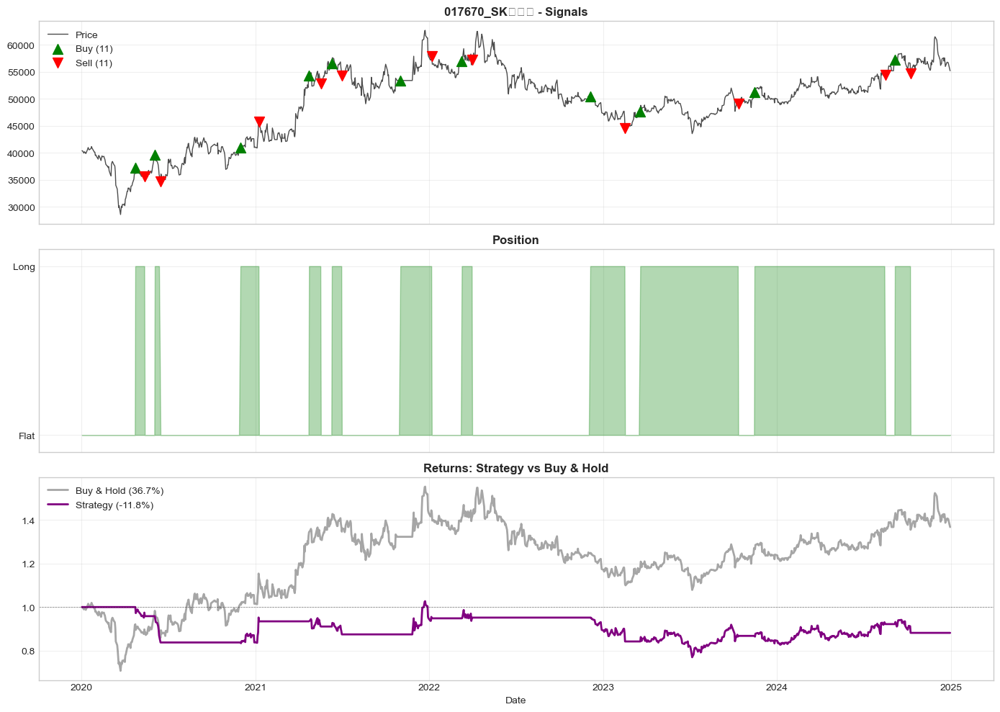


✓ Complete

[121/200] 017800_현대엘리베이.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 45083.00 → 52400.00

Strategy:  -44.49%  |  Market:   16.23%  |  Excess:  -60.72%
Sharpe:     0.035  |  Max DD:  -71.32%  |  Win:  47.9%  |  Trades:  11

First 5 trades:
  2020-02-18: BUY
  2020-03-19: SELL
  2020-04-17: BUY
  2020-06-19: SELL
  2020-07-16: BUY


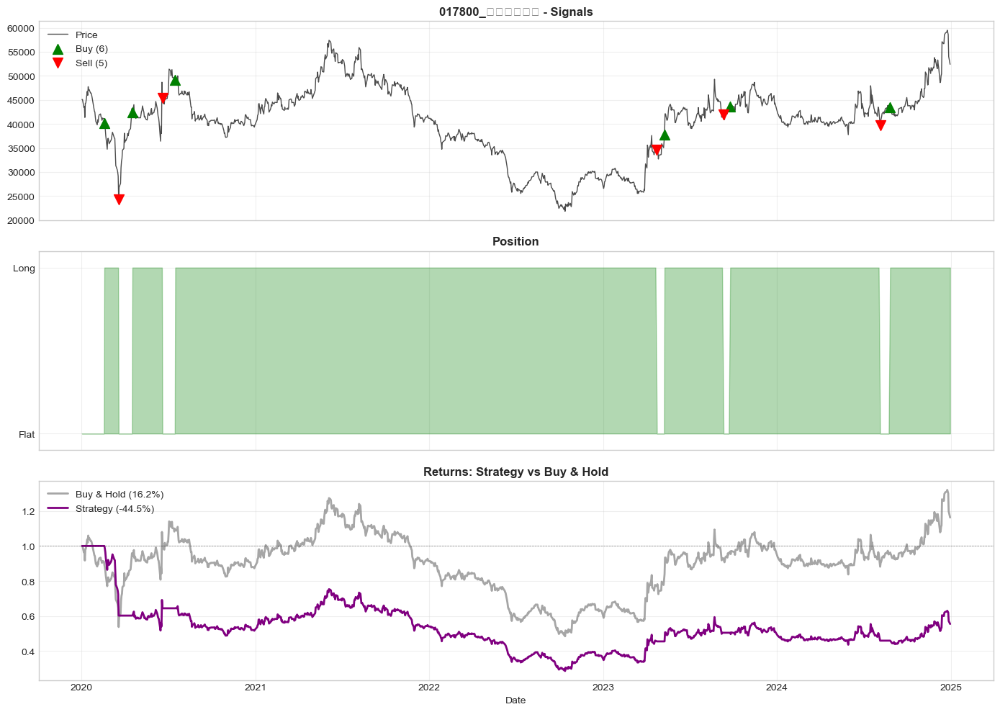


✓ Complete

[122/200] 018880_한라비스테온공조.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 10039.00 → 3727.00

Strategy:  -42.93%  |  Market:  -62.87%  |  Excess:   19.94%
Sharpe:     0.137  |  Max DD:  -68.10%  |  Win:  44.7%  |  Trades:  28

First 5 trades:
  2020-01-02: BUY
  2020-03-18: SELL
  2020-05-21: BUY
  2020-06-18: SELL
  2020-07-17: BUY


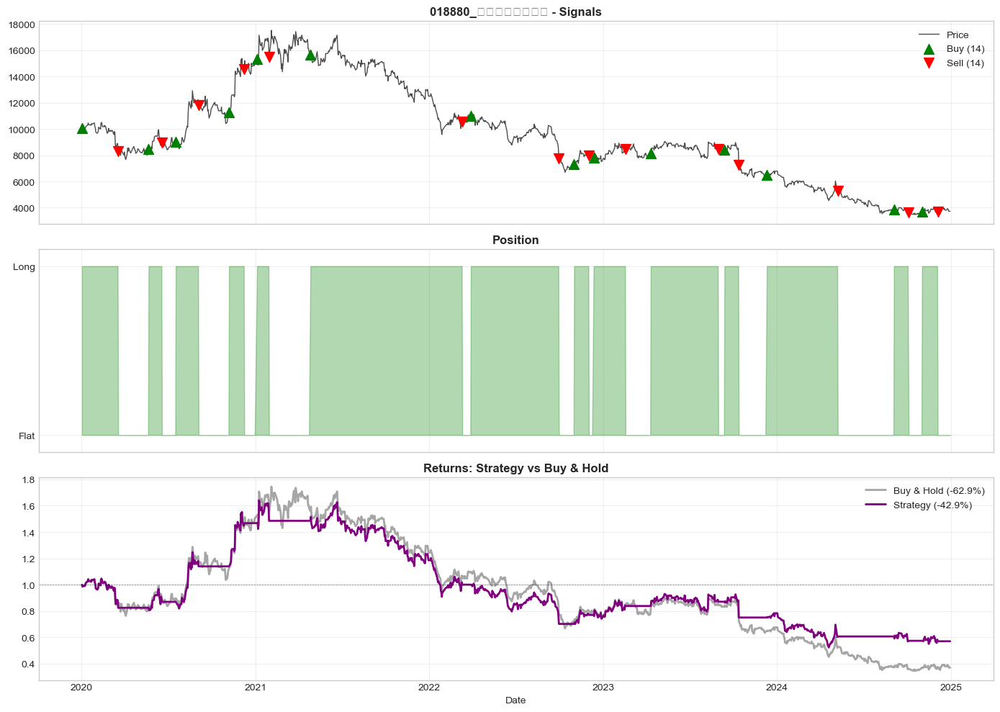


✓ Complete

[123/200] 019680_대교.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 6050.00 → 2520.00

Strategy:  -62.51%  |  Market:  -58.35%  |  Excess:   -4.17%
Sharpe:    -0.503  |  Max DD:  -70.69%  |  Win:  44.1%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-12: SELL
  2020-05-07: BUY


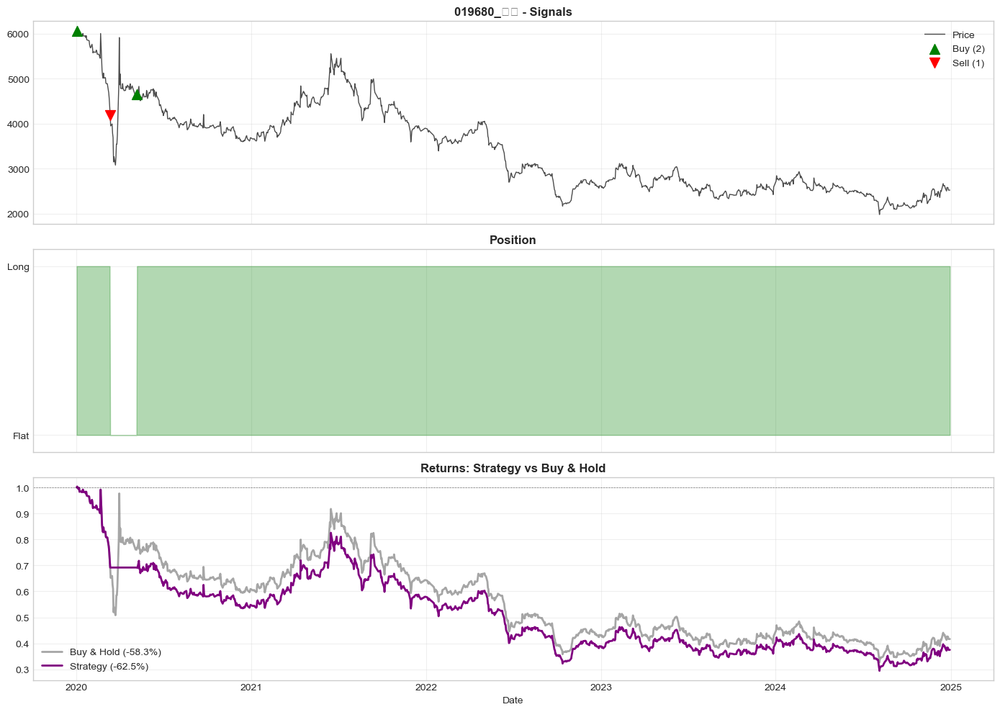


✓ Complete

[124/200] 020000_한섬.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 31300.00 → 14710.00

Strategy:  -49.19%  |  Market:  -53.00%  |  Excess:    3.82%
Sharpe:    -0.397  |  Max DD:  -71.05%  |  Win:  44.0%  |  Trades:   5

First 5 trades:
  2020-02-04: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2021-06-01: SELL
  2021-06-10: BUY


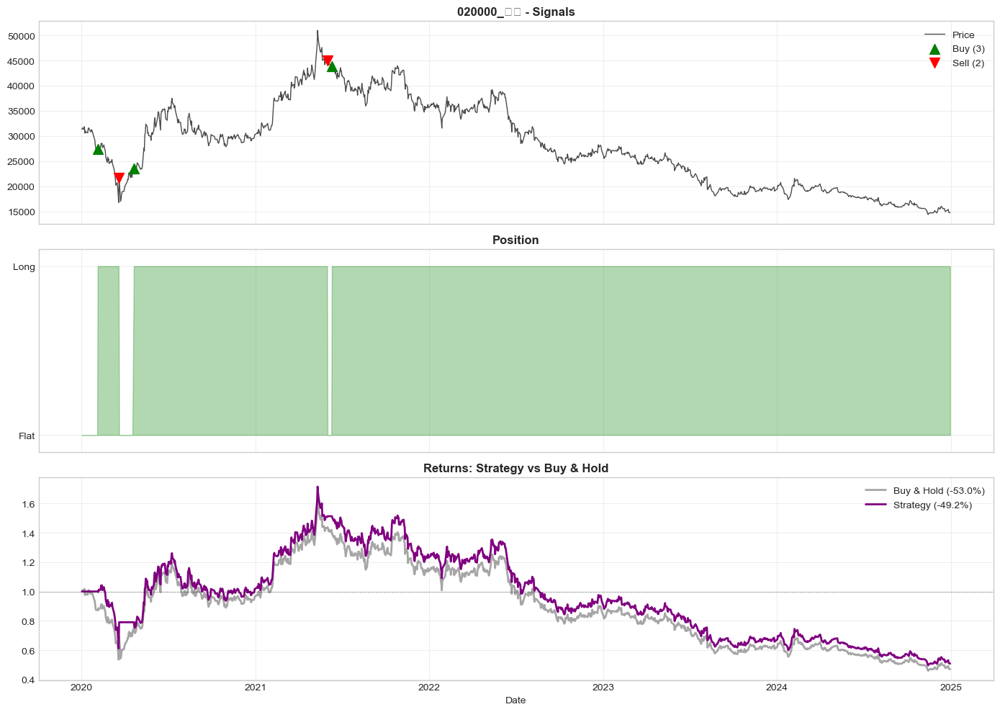


✓ Complete

[125/200] 020150_일진머티리얼즈.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 43000.00 → 23600.00

Strategy:  -72.25%  |  Market:  -45.12%  |  Excess:  -27.14%
Sharpe:    -0.284  |  Max DD:  -87.10%  |  Win:  46.1%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-04-21: BUY
  2021-12-13: SELL
  2021-12-30: BUY


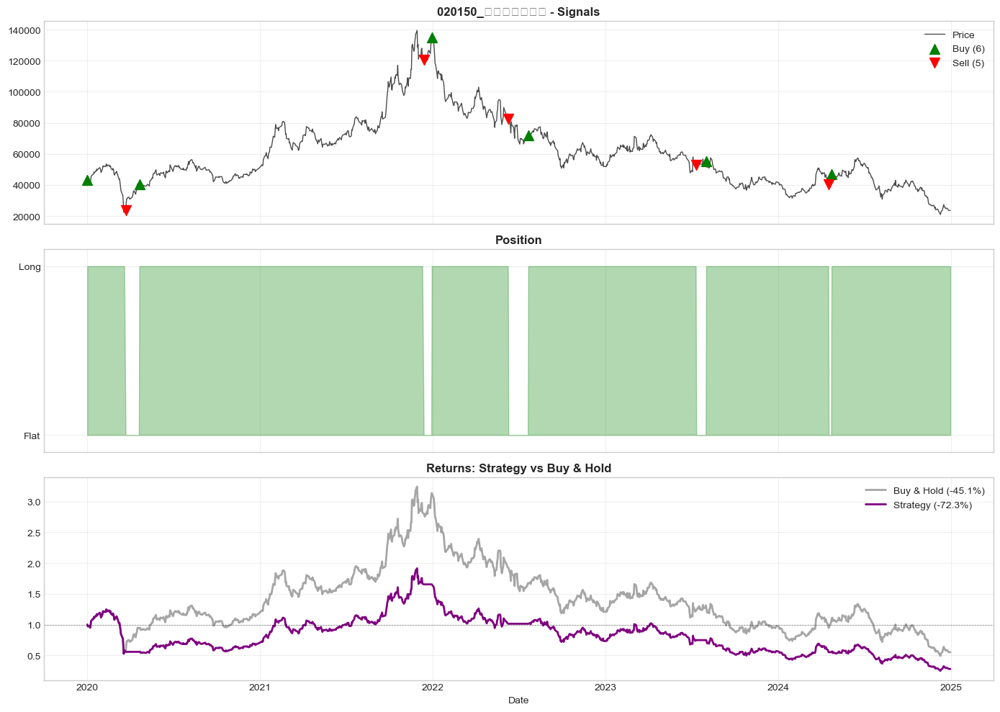


✓ Complete

[126/200] 020760_일진디스플.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 2881.00 → 830.00

Strategy:  -58.52%  |  Market:  -71.19%  |  Excess:   12.67%
Sharpe:    -0.033  |  Max DD:  -83.13%  |  Win:  40.7%  |  Trades:  29

First 5 trades:
  2020-01-02: BUY
  2020-02-17: SELL
  2020-05-08: BUY
  2020-06-25: SELL
  2020-07-15: BUY


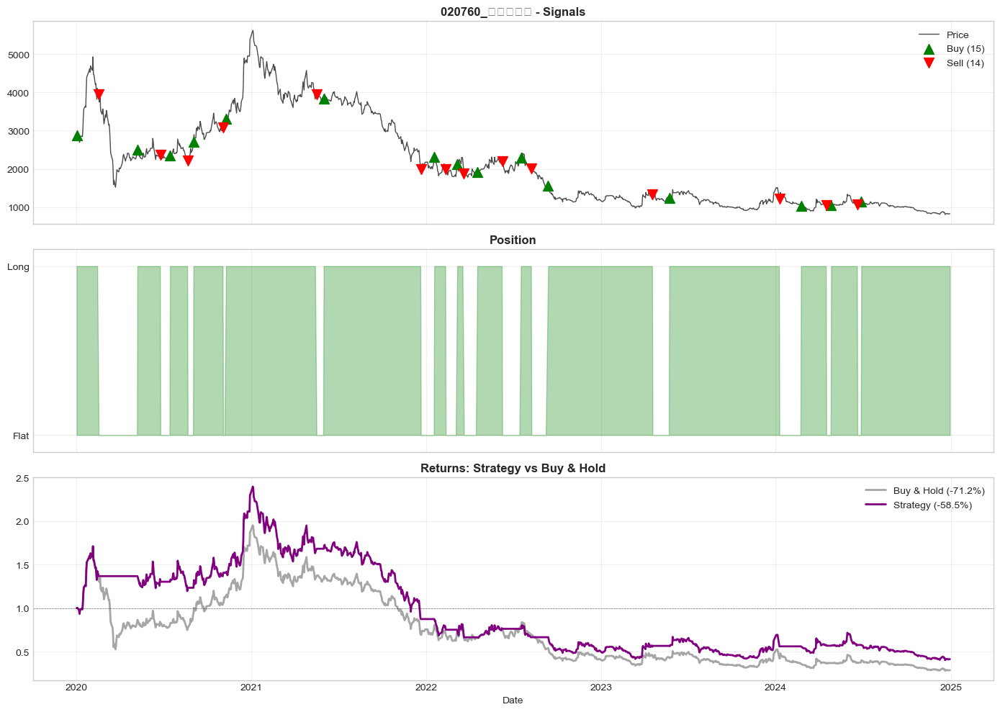


✓ Complete

[127/200] 021240_코웨이.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 90000.00 → 66900.00

Strategy:  -32.01%  |  Market:  -25.67%  |  Excess:   -6.34%
Sharpe:     0.117  |  Max DD:  -54.77%  |  Win:  47.4%  |  Trades:  14

First 5 trades:
  2020-01-02: BUY
  2020-02-17: SELL
  2020-05-11: BUY
  2020-06-22: SELL
  2020-07-17: BUY


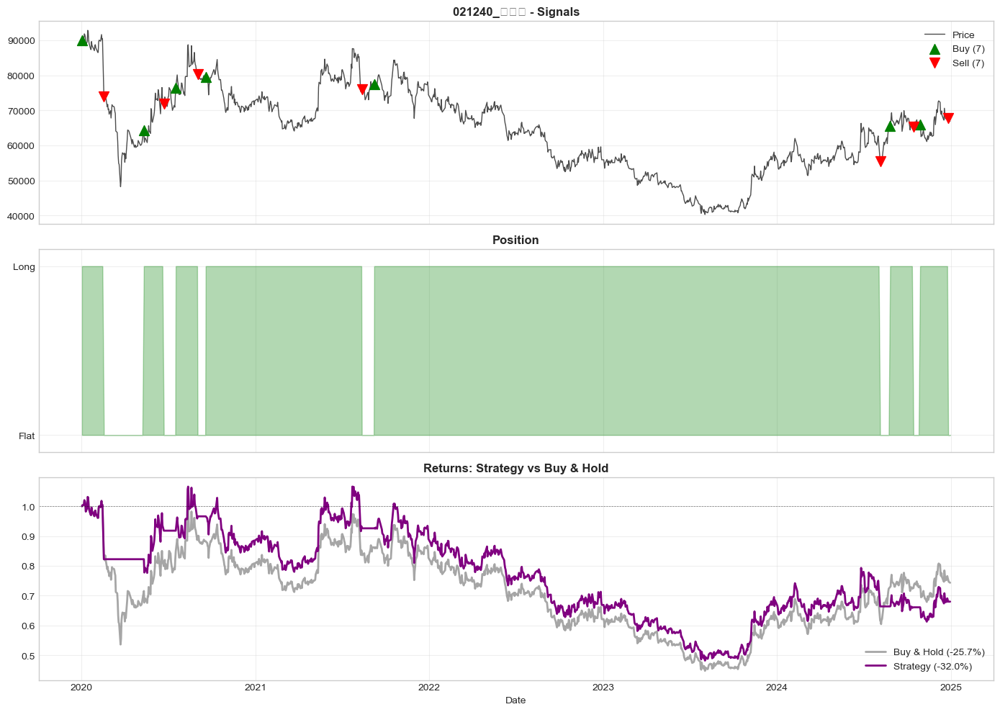


✓ Complete

[128/200] 023530_롯데쇼핑.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 135500.00 → 54100.00

Strategy:  -44.06%  |  Market:  -60.07%  |  Excess:   16.02%
Sharpe:    -0.310  |  Max DD:  -53.82%  |  Win:  42.9%  |  Trades:   9

First 5 trades:
  2020-06-02: BUY
  2020-11-06: SELL
  2020-11-12: BUY
  2021-02-01: SELL
  2021-02-09: BUY


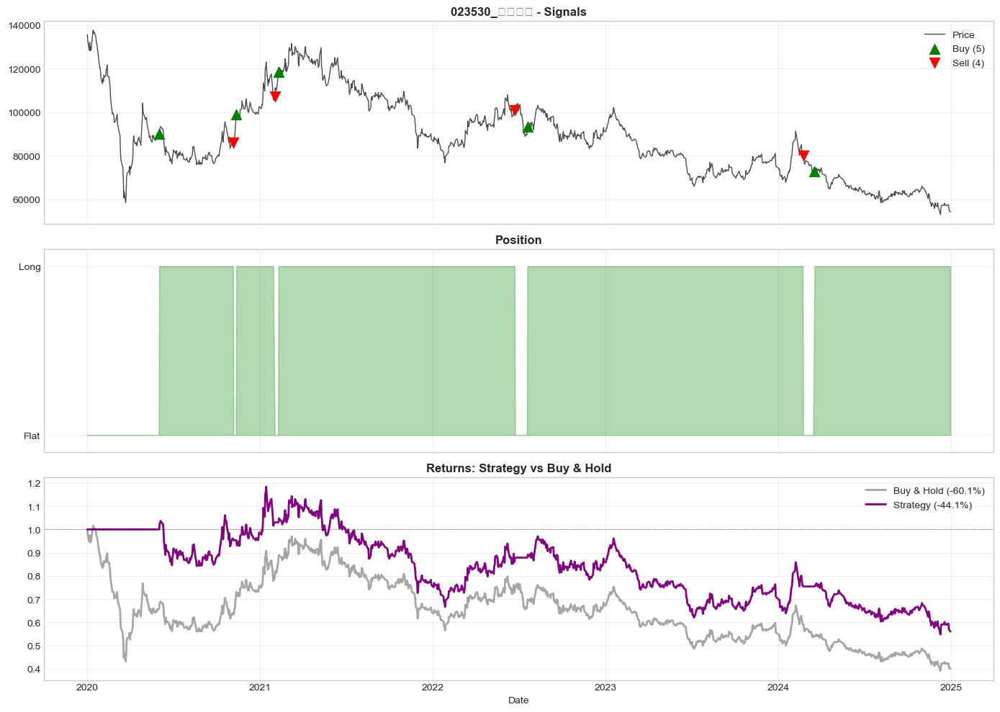


✓ Complete

[129/200] 024110_기업은행.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 11550.00 → 14330.00

Strategy:    9.76%  |  Market:   24.07%  |  Excess:  -14.31%
Sharpe:     0.160  |  Max DD:  -46.15%  |  Win:  48.7%  |  Trades:   7

First 5 trades:
  2020-01-30: BUY
  2020-03-24: SELL
  2020-05-27: BUY
  2020-06-22: SELL
  2020-07-15: BUY


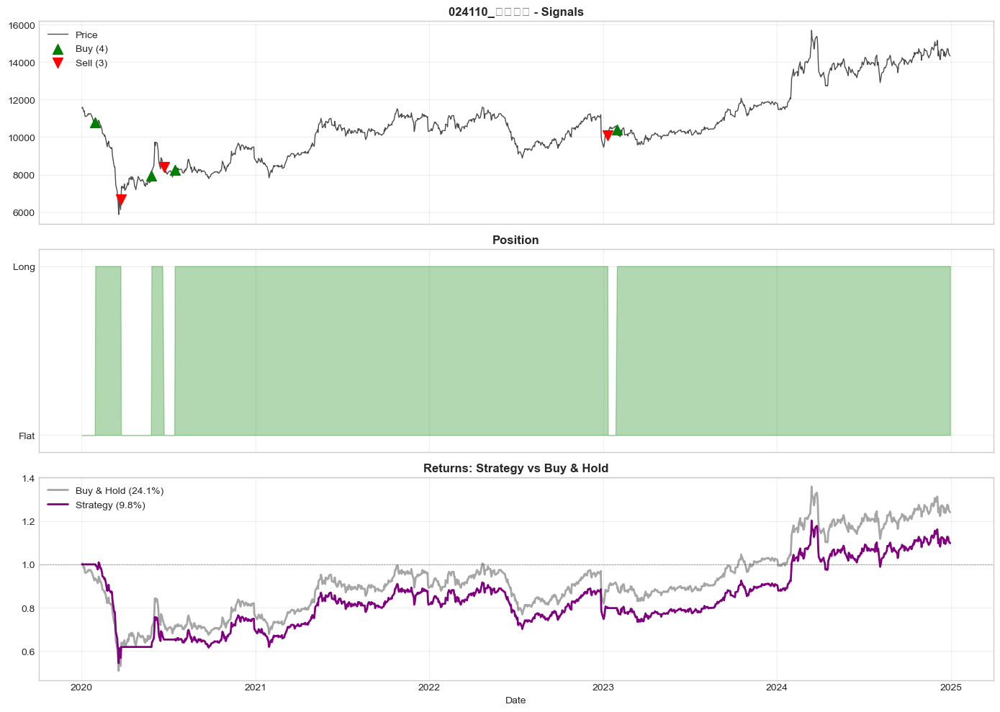


✓ Complete

[130/200] 025540_한국단자.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 42200.00 → 66900.00

Strategy:  101.36%  |  Market:   58.53%  |  Excess:   42.82%
Sharpe:     0.661  |  Max DD:  -34.71%  |  Win:  43.6%  |  Trades:  21

First 5 trades:
  2020-03-05: BUY
  2020-03-20: SELL
  2020-04-21: BUY
  2020-05-19: SELL
  2020-07-13: BUY


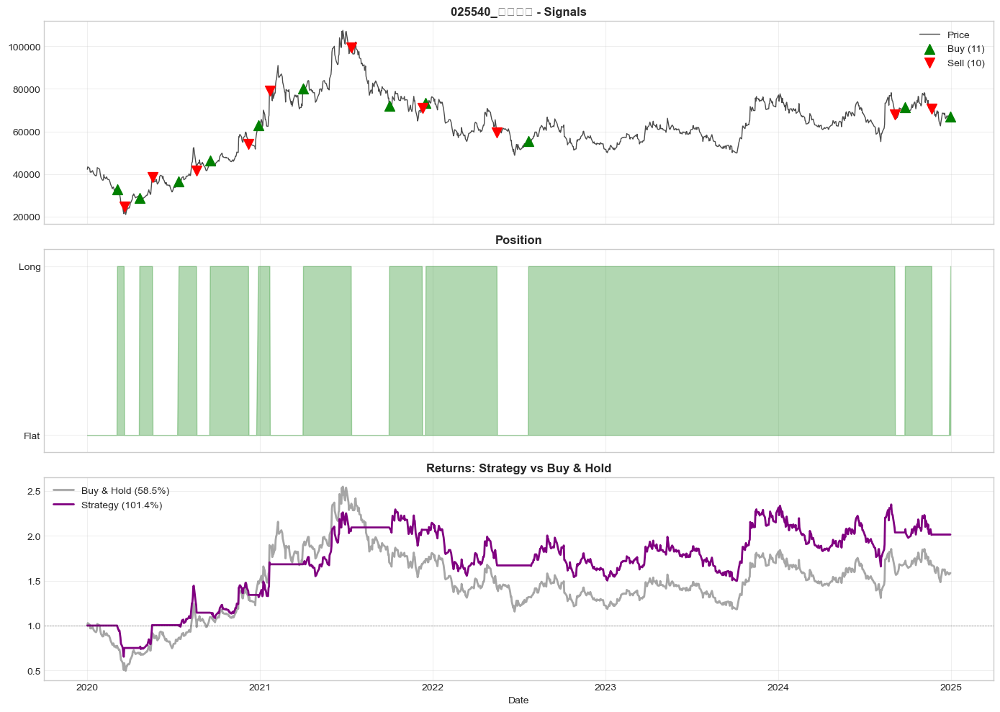


✓ Complete

[131/200] 025860_남해화학.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 8120.00 → 6130.00

Strategy:  -34.42%  |  Market:  -24.51%  |  Excess:   -9.91%
Sharpe:     0.173  |  Max DD:  -51.44%  |  Win:  44.5%  |  Trades:  15

First 5 trades:
  2020-01-30: BUY
  2020-03-23: SELL
  2020-04-20: BUY
  2020-08-27: SELL
  2020-09-16: BUY


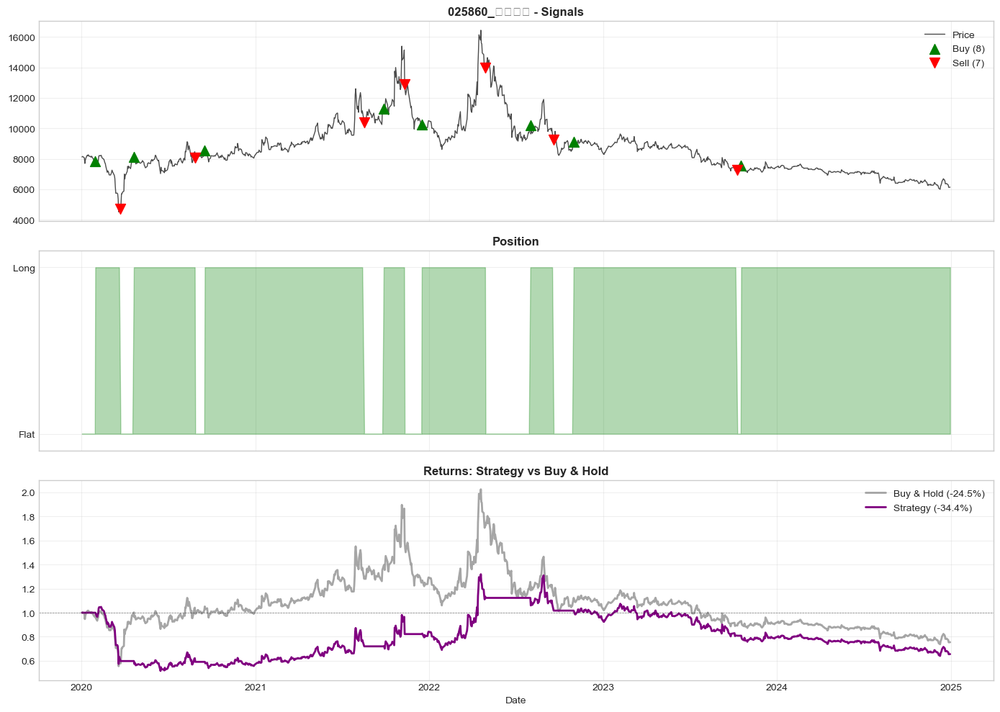


✓ Complete

[132/200] 028050_삼성엔지니어링.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 19300.00 → 16550.00

Strategy:  -42.61%  |  Market:  -14.25%  |  Excess:  -28.37%
Sharpe:    -0.128  |  Max DD:  -64.21%  |  Win:  46.0%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-23: BUY
  2021-07-14: SELL
  2021-07-27: BUY


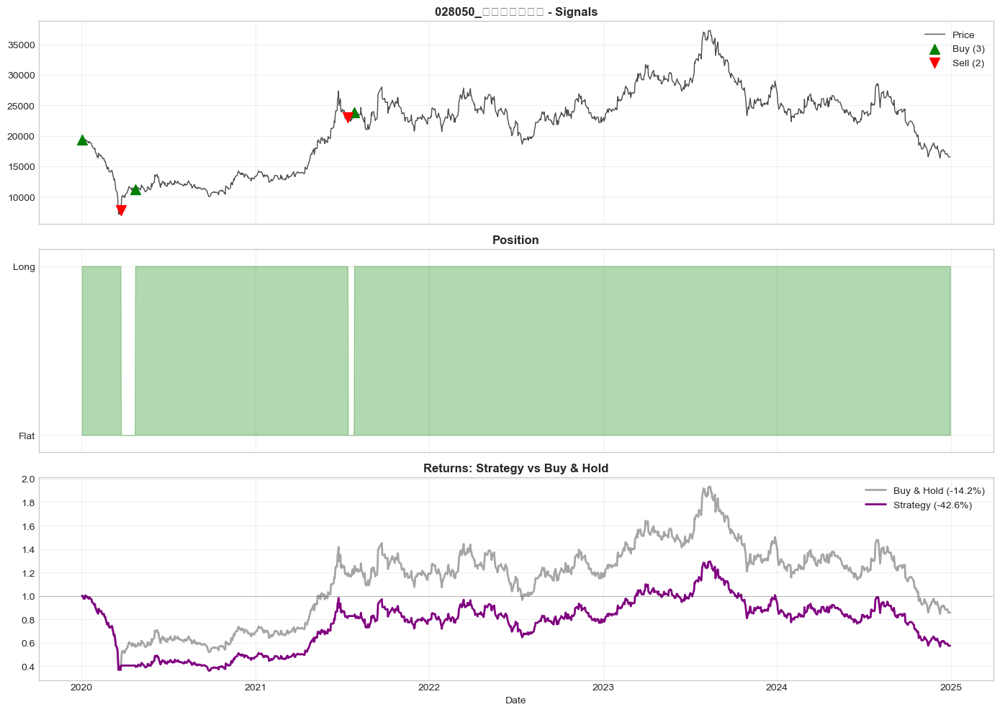


✓ Complete

[133/200] 029530_신도리코.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 36600.00 → 37500.00

Strategy:  -26.50%  |  Market:    2.46%  |  Excess:  -28.96%
Sharpe:    -0.147  |  Max DD:  -52.37%  |  Win:  44.7%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-17: BUY
  2021-02-26: SELL
  2021-03-15: BUY


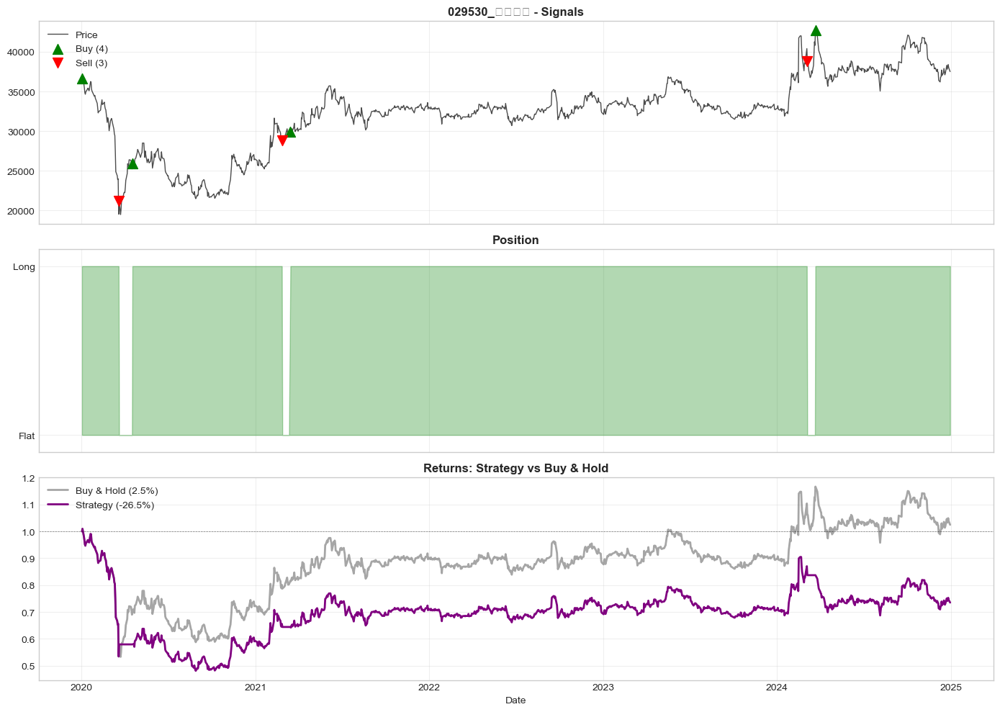


✓ Complete

[134/200] 029780_삼성카드.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 37450.00 → 39450.00

Strategy:  -21.39%  |  Market:    5.34%  |  Excess:  -26.73%
Sharpe:     0.066  |  Max DD:  -45.65%  |  Win:  47.7%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-04-29: BUY
  2024-06-17: SELL
  2024-07-11: BUY


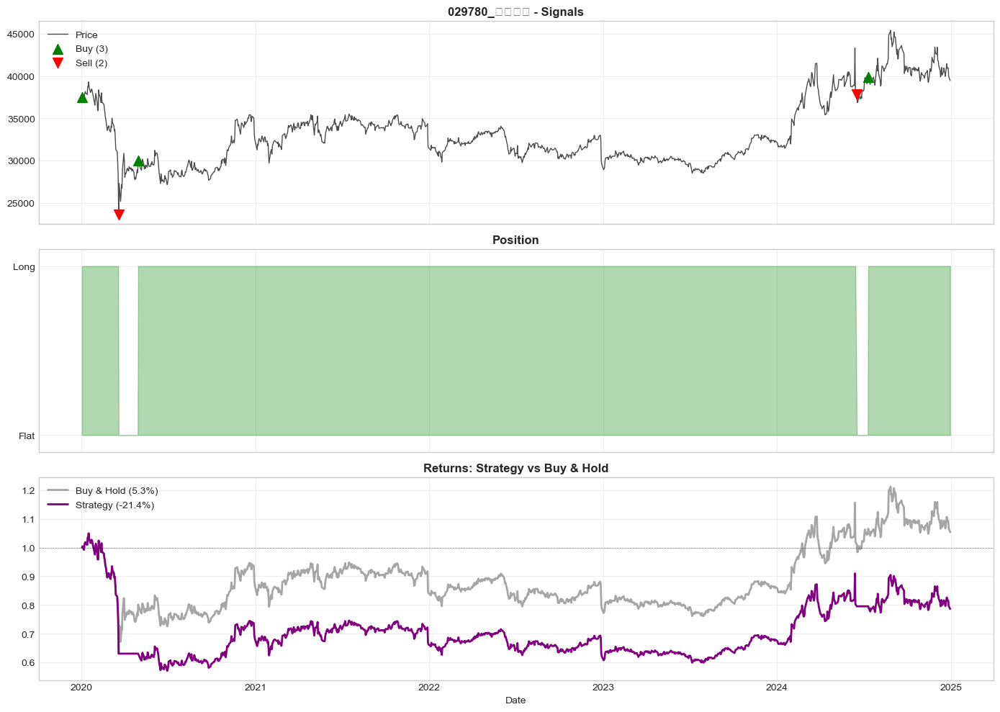


✓ Complete

[135/200] 030000_제일기획.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 23300.00 → 16950.00

Strategy:  -47.81%  |  Market:  -27.25%  |  Excess:  -20.56%
Sharpe:    -0.449  |  Max DD:  -50.31%  |  Win:  45.5%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-08: BUY
  2020-06-22: SELL
  2020-07-03: BUY


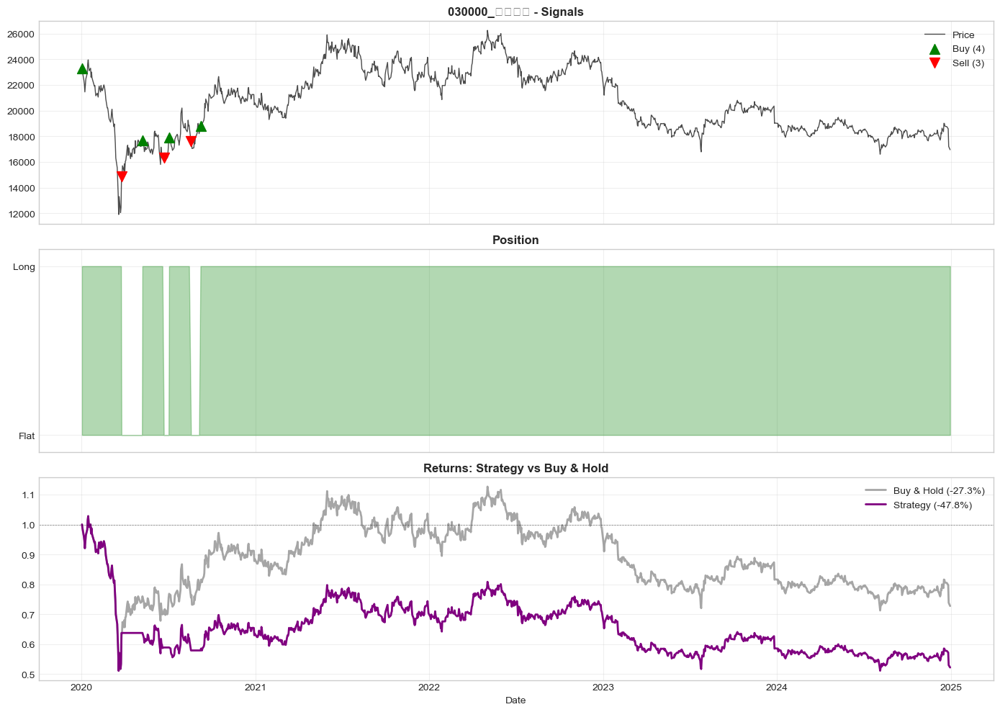


✓ Complete

[136/200] 030200_KT.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 26700.00 → 43850.00

Strategy:   30.81%  |  Market:   64.23%  |  Excess:  -33.42%
Sharpe:     0.483  |  Max DD:  -35.32%  |  Win:  48.1%  |  Trades:  12

First 5 trades:
  2020-01-02: BUY
  2020-03-23: SELL
  2020-04-22: BUY
  2020-09-02: SELL
  2020-09-28: BUY


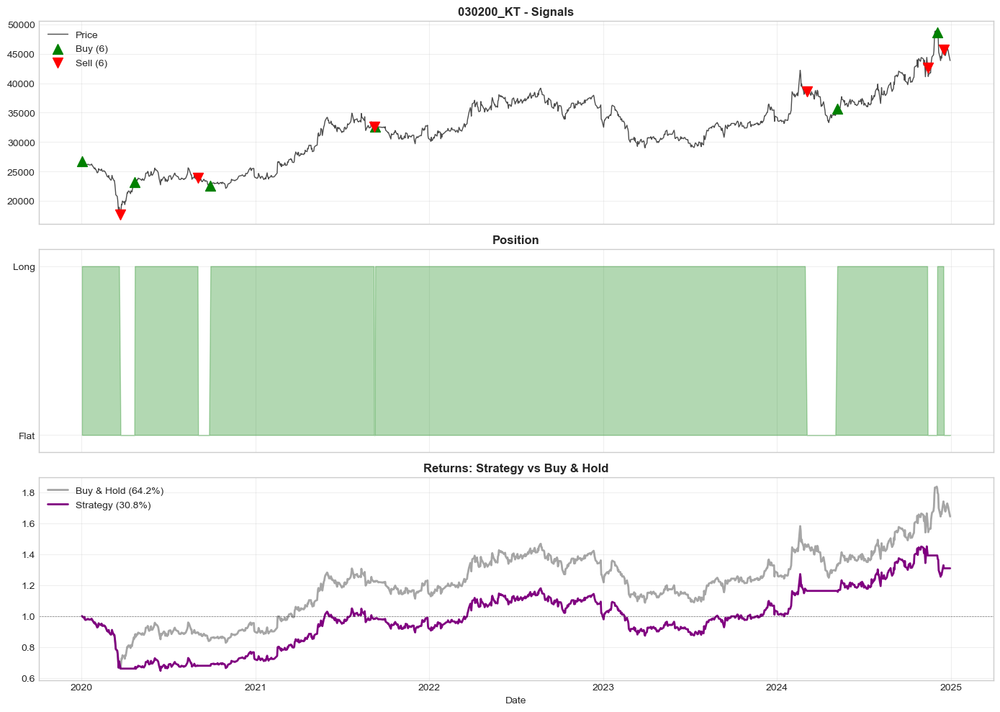


✓ Complete

[137/200] 032640_LG유플러스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 13850.00 → 10330.00

Strategy:  -40.75%  |  Market:  -25.42%  |  Excess:  -15.34%
Sharpe:    -0.391  |  Max DD:  -47.90%  |  Win:  43.4%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-26: SELL
  2020-05-08: BUY
  2020-09-04: SELL
  2020-09-17: BUY


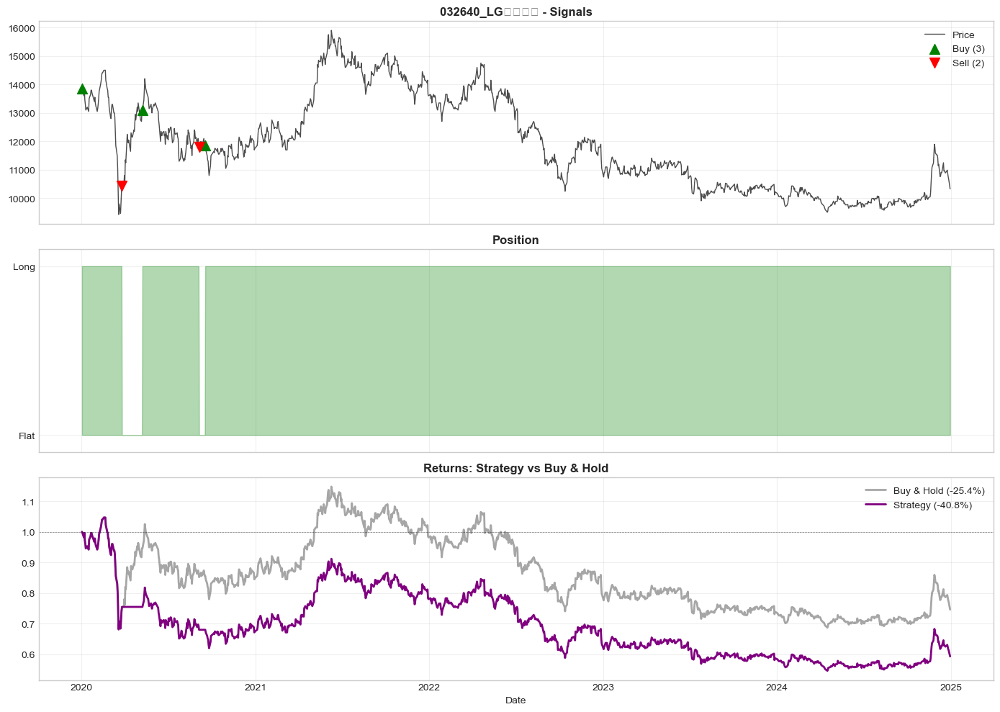


✓ Complete

[138/200] 032830_삼성생명.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 73100.00 → 94800.00

Strategy:   14.60%  |  Market:   29.69%  |  Excess:  -15.08%
Sharpe:     0.184  |  Max DD:  -56.78%  |  Win:  48.0%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-28: BUY
  2020-08-21: SELL
  2020-09-14: BUY


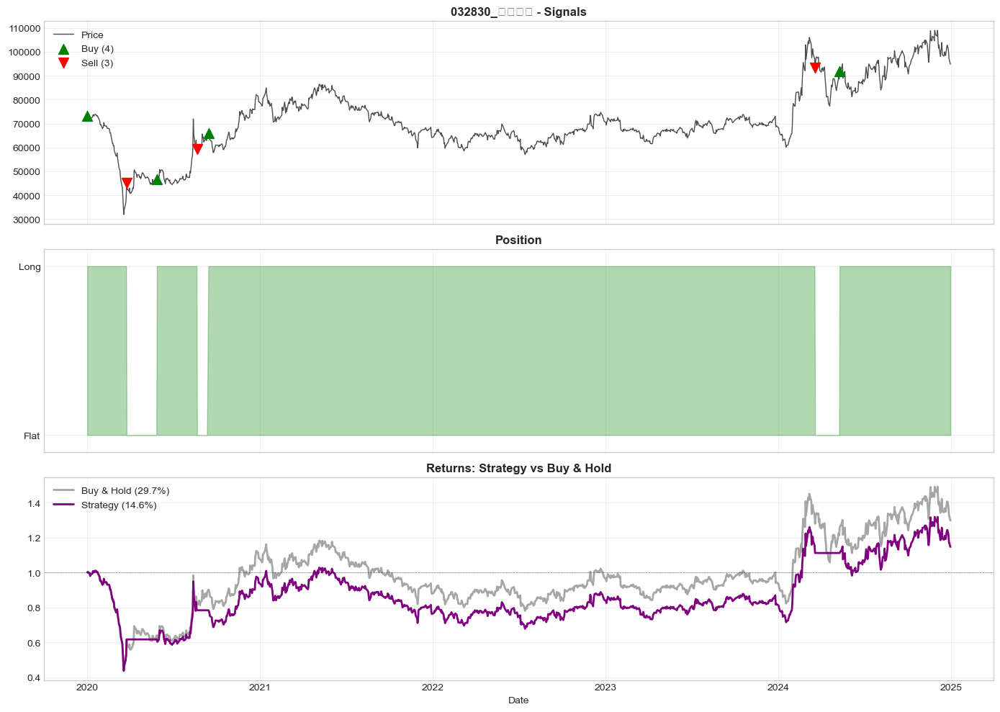


✓ Complete

[139/200] 033240_자화전자.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 11000.00 → 11790.00

Strategy:  -33.55%  |  Market:    7.18%  |  Excess:  -40.73%
Sharpe:     0.258  |  Max DD:  -74.87%  |  Win:  42.6%  |  Trades:  17

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-05-26: BUY
  2020-08-13: SELL
  2020-10-12: BUY


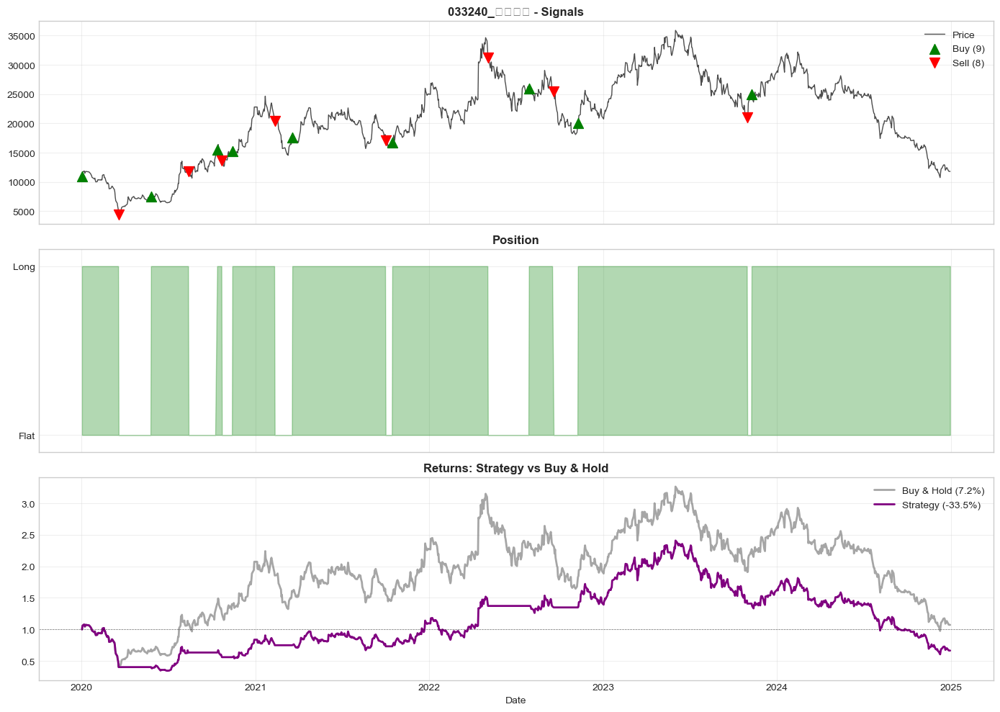


✓ Complete

[140/200] 033530_세종공업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4665.00 → 3950.00

Strategy:  -65.05%  |  Market:  -15.33%  |  Excess:  -49.72%
Sharpe:    -0.314  |  Max DD:  -70.73%  |  Win:  44.0%  |  Trades:  19

First 5 trades:
  2020-02-19: BUY
  2020-03-20: SELL
  2020-04-17: BUY
  2020-06-17: SELL
  2020-07-06: BUY


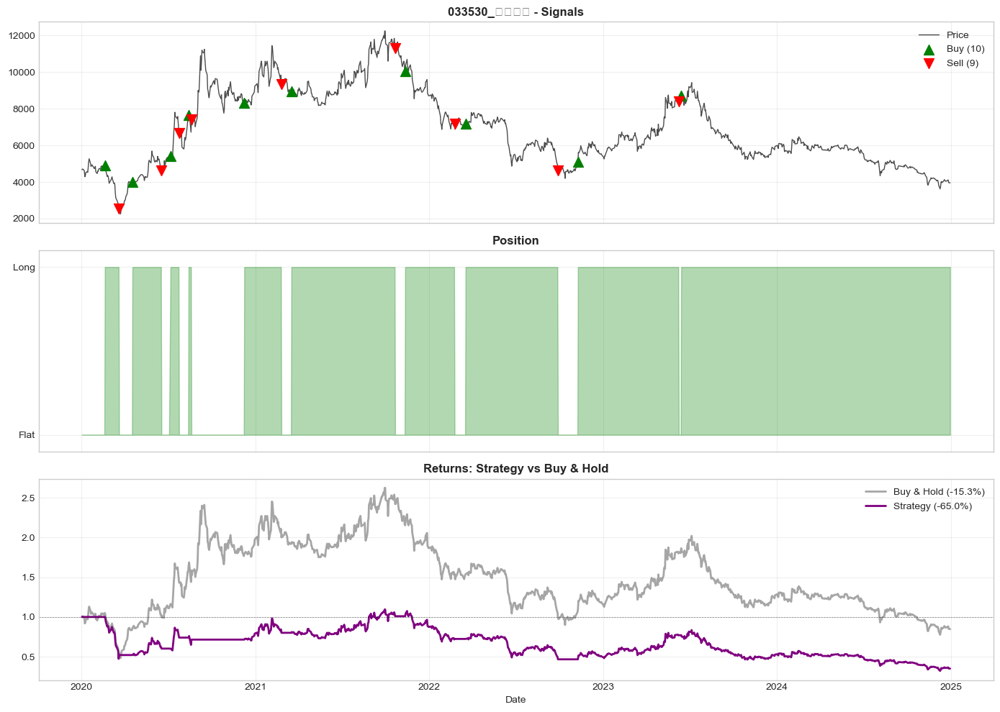


✓ Complete

[141/200] 033780_KT&G.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 92500.00 → 107100.00

Strategy:   -7.84%  |  Market:   15.78%  |  Excess:  -23.62%
Sharpe:     0.076  |  Max DD:  -33.12%  |  Win:  47.2%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-23: BUY
  2020-09-02: SELL
  2020-09-09: BUY


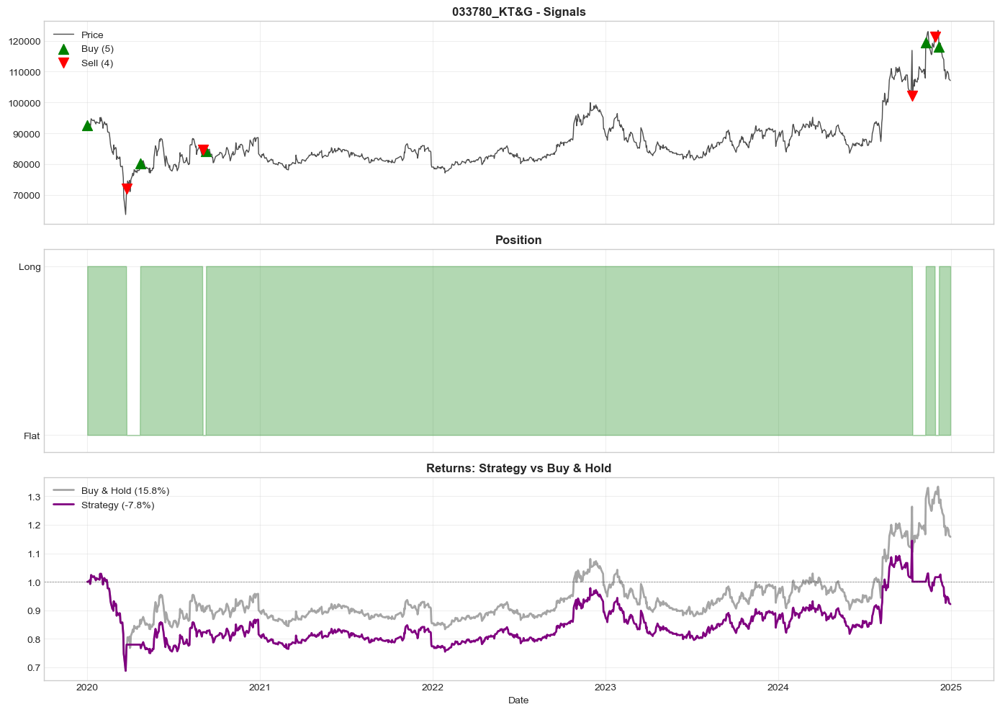


✓ Complete

[142/200] 033920_무학.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 8410.00 → 6320.00

Strategy:  -33.79%  |  Market:  -24.85%  |  Excess:   -8.94%
Sharpe:     0.172  |  Max DD:  -59.34%  |  Win:  45.6%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-04-17: BUY
  2020-05-27: SELL
  2020-06-18: BUY


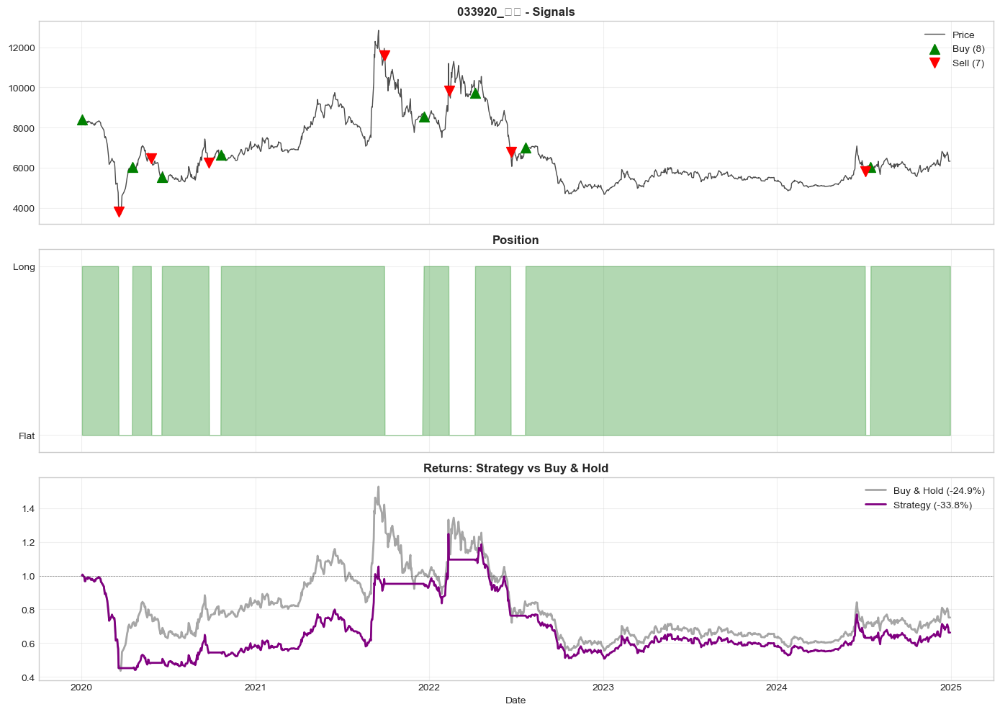


✓ Complete

[143/200] 034020_두산중공업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 5081.00 → 17550.00

Strategy:   96.58%  |  Market:  245.40%  |  Excess: -148.83%
Sharpe:     0.550  |  Max DD:  -62.81%  |  Win:  46.9%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-10: BUY
  2020-08-05: SELL
  2020-08-26: BUY


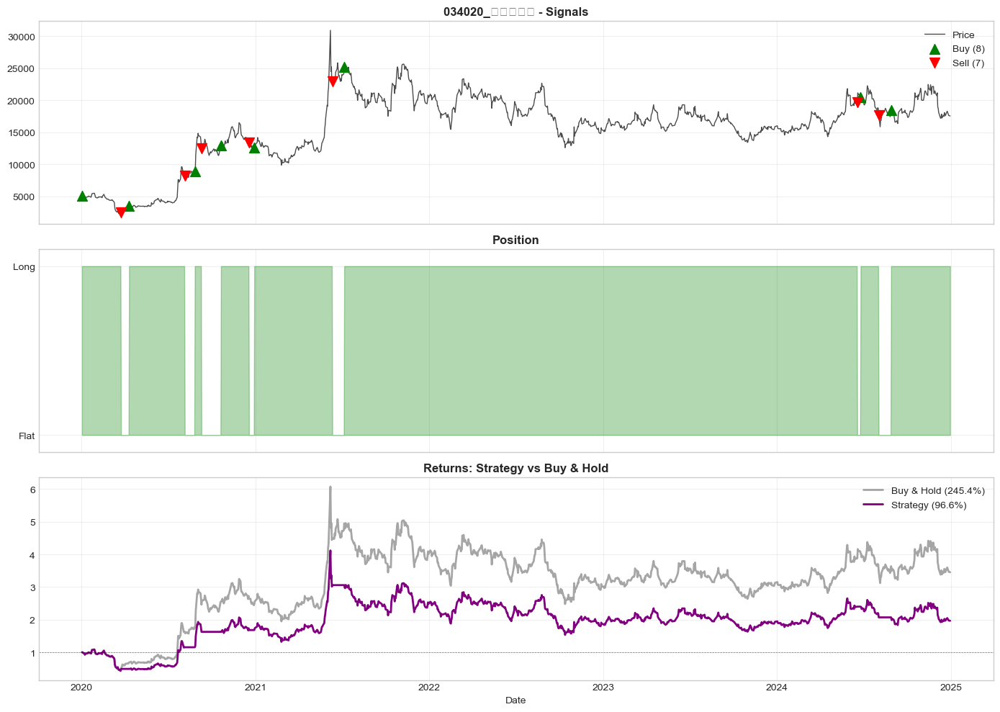


✓ Complete

[144/200] 034120_SBS.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 21400.00 → 22150.00

Strategy:   12.99%  |  Market:    3.50%  |  Excess:    9.48%
Sharpe:     0.407  |  Max DD:  -72.37%  |  Win:  42.7%  |  Trades:  12

First 5 trades:
  2020-01-31: BUY
  2020-05-12: SELL
  2020-05-15: BUY
  2023-03-14: SELL
  2023-04-14: BUY


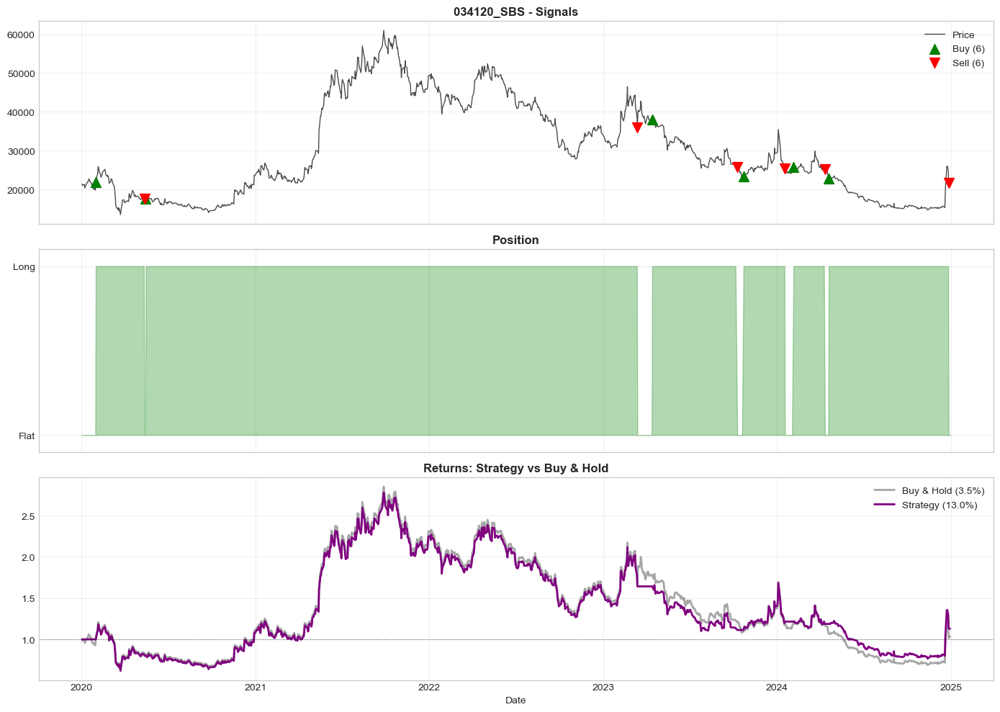


✓ Complete

[145/200] 034220_LG디스플레이.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 15112.00 → 9130.00

Strategy:  -43.47%  |  Market:  -39.58%  |  Excess:   -3.88%
Sharpe:    -0.169  |  Max DD:  -64.87%  |  Win:  43.7%  |  Trades:   9

First 5 trades:
  2020-01-31: BUY
  2020-02-26: SELL
  2020-03-05: BUY
  2020-03-20: SELL
  2020-04-22: BUY


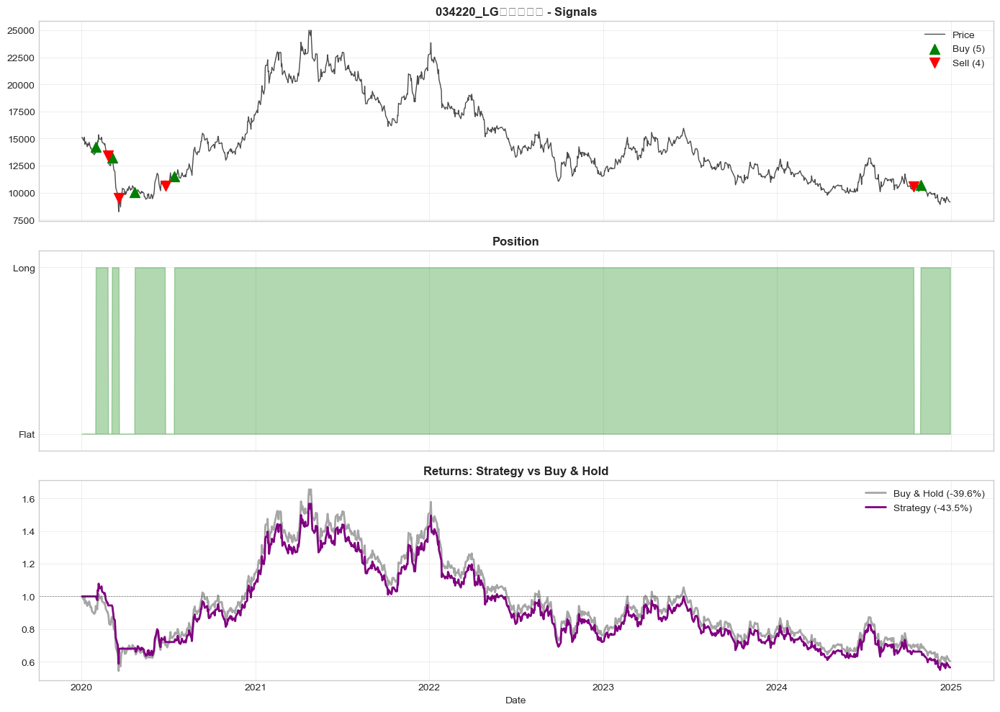


✓ Complete

[146/200] 034730_SK C&C.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 258000.00 → 131500.00

Strategy:  -55.76%  |  Market:  -49.03%  |  Excess:   -6.73%
Sharpe:    -0.385  |  Max DD:  -62.66%  |  Win:  43.7%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-22: BUY
  2020-07-07: SELL
  2020-07-30: BUY


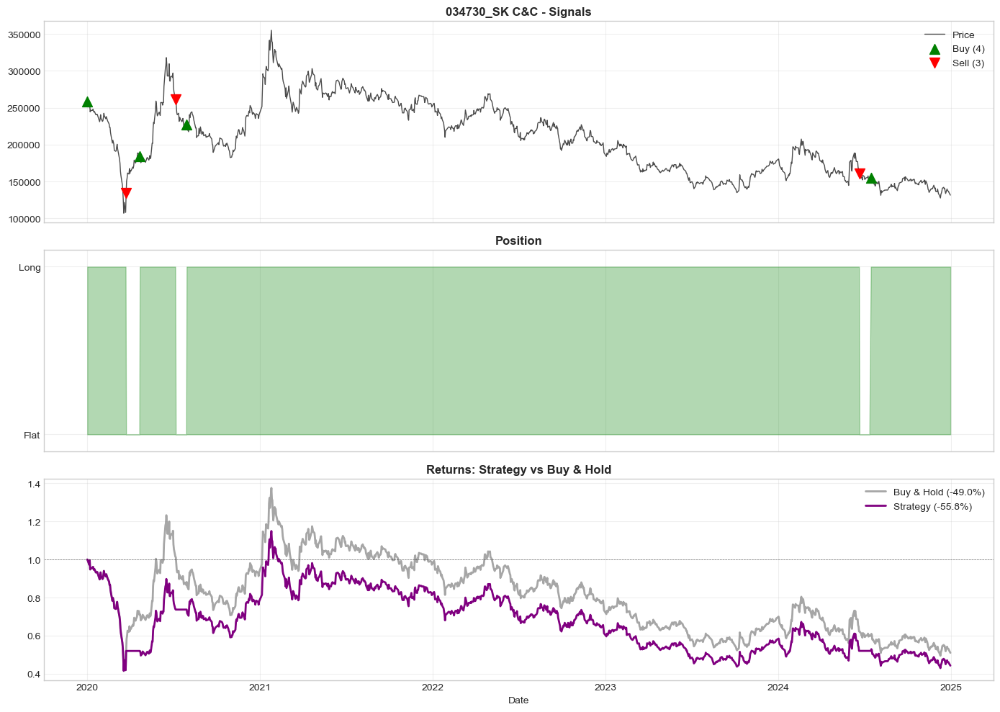


✓ Complete

[147/200] 035250_강원랜드.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 29250.00 → 15970.00

Strategy:  -64.22%  |  Market:  -45.40%  |  Excess:  -18.81%
Sharpe:    -0.739  |  Max DD:  -69.21%  |  Win:  43.9%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-05-27: BUY
  2020-06-15: SELL
  2020-07-13: BUY


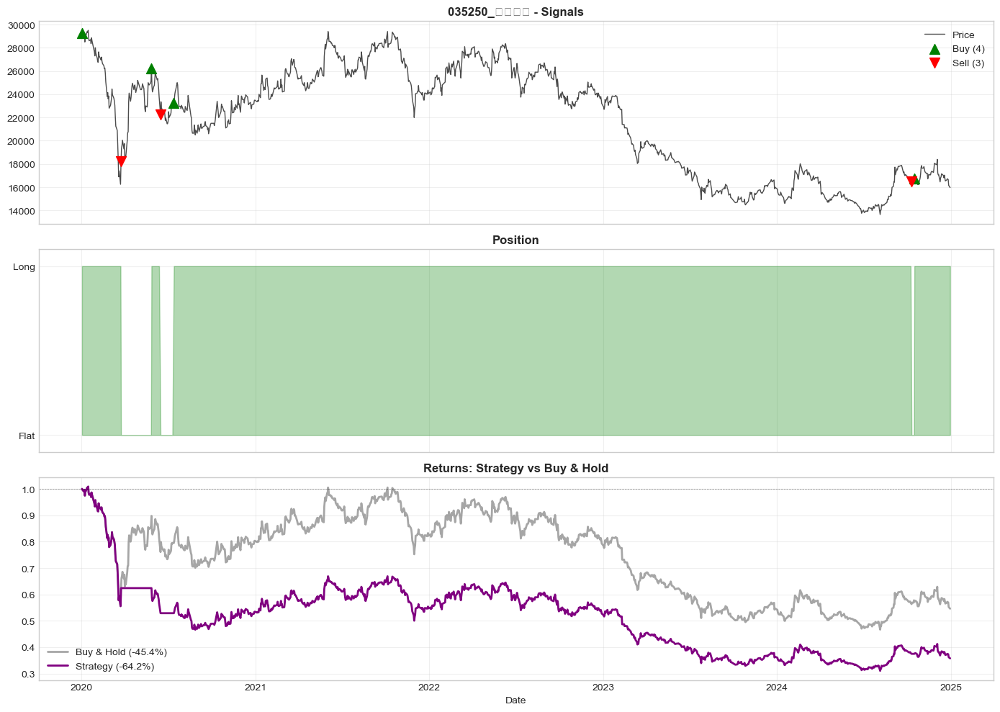


✓ Complete

[148/200] 035420_NAVER.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 182500.00 → 198900.00

Strategy:  -27.69%  |  Market:    8.99%  |  Excess:  -36.68%
Sharpe:    -0.035  |  Max DD:  -66.94%  |  Win:  45.6%  |  Trades:  17

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-27: BUY
  2020-06-15: SELL
  2020-07-03: BUY


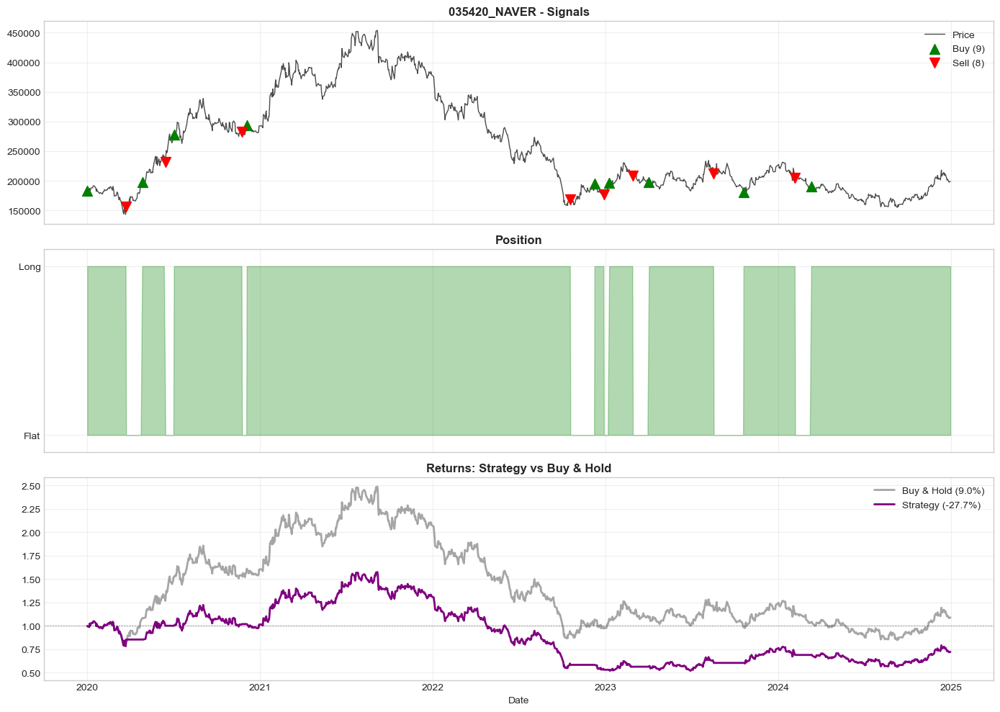


✓ Complete

[149/200] 036460_한국가스공사.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 37350.00 → 34700.00

Strategy:  -45.03%  |  Market:   -7.10%  |  Excess:  -37.93%
Sharpe:     0.014  |  Max DD:  -55.56%  |  Win:  46.3%  |  Trades:  10

First 5 trades:
  2020-01-02: BUY
  2020-03-31: SELL
  2020-04-10: BUY
  2020-11-06: SELL
  2020-11-24: BUY


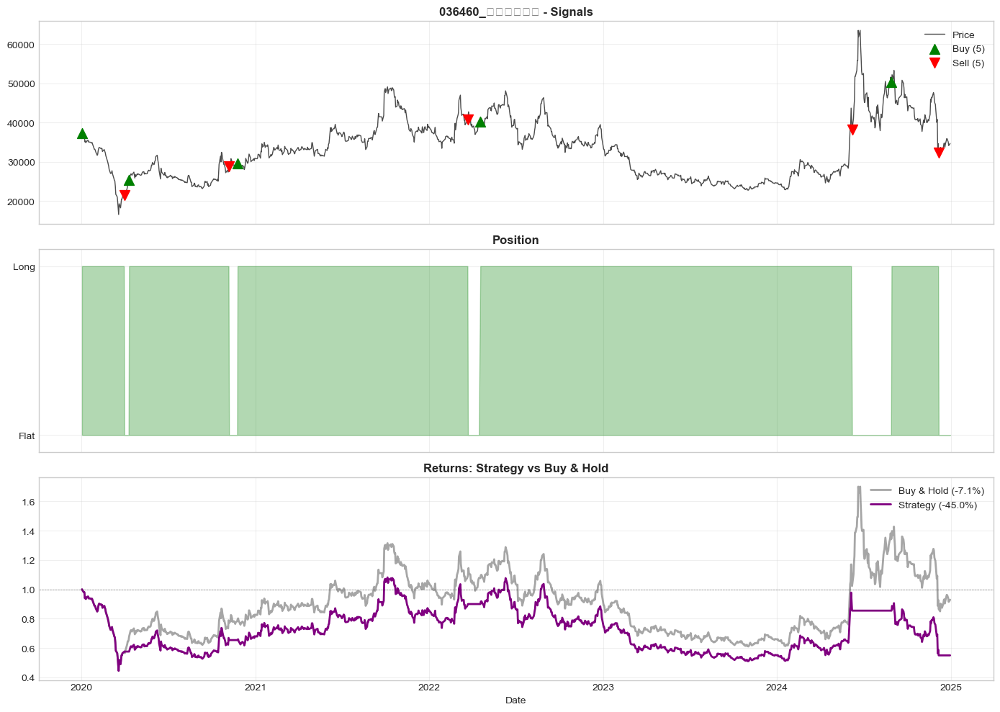


✓ Complete

[150/200] 036570_엔씨소프트.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 541000.00 → 183100.00

Strategy:  -63.30%  |  Market:  -66.16%  |  Excess:    2.85%
Sharpe:    -0.208  |  Max DD:  -83.75%  |  Win:  46.0%  |  Trades:   6

First 5 trades:
  2020-01-02: BUY
  2020-03-27: SELL
  2020-04-22: BUY
  2021-11-12: SELL
  2021-12-16: BUY


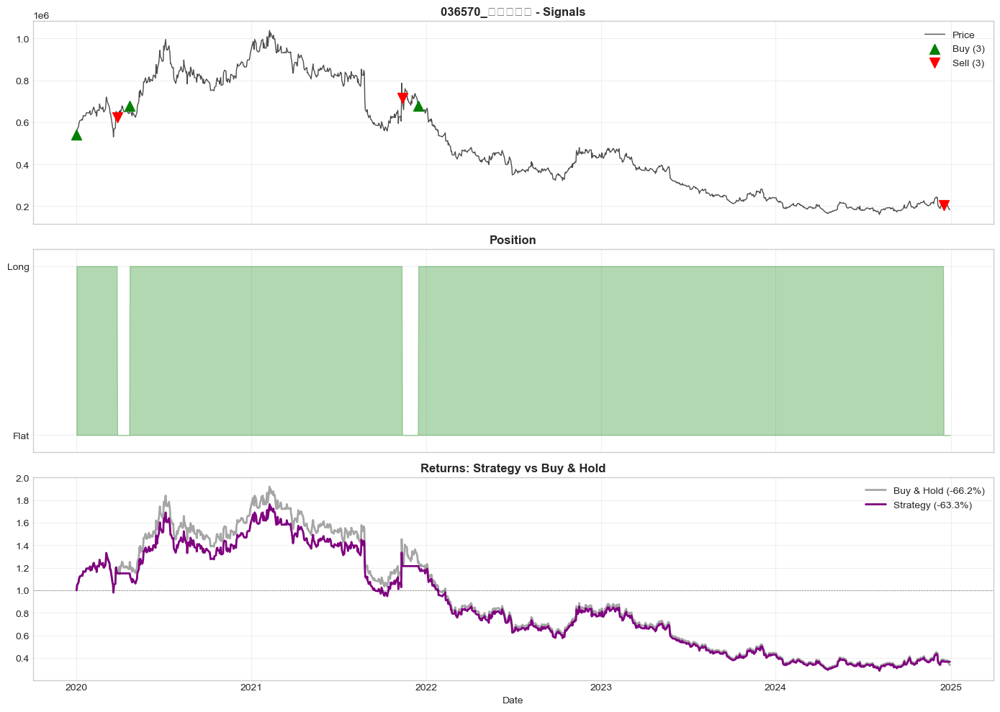


✓ Complete

[151/200] 037620_미래에셋증권.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[152/200] 042660_대우조선해양.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 24298.00 → 37350.00

Strategy:   -4.98%  |  Market:   53.72%  |  Excess:  -58.70%
Sharpe:     0.306  |  Max DD:  -59.27%  |  Win:  43.4%  |  Trades:  27

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-21: BUY
  2020-06-15: SELL
  2020-07-30: BUY


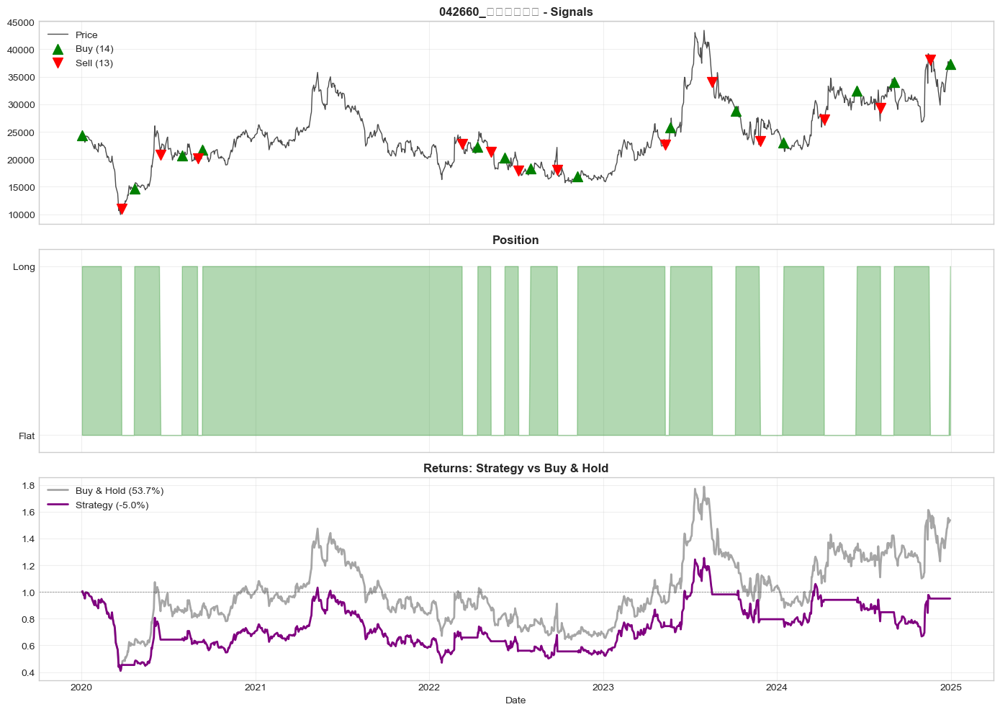


✓ Complete

[153/200] 042670_두산인프라코어.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4655.00 → 6890.00

Strategy:   41.19%  |  Market:   48.01%  |  Excess:   -6.82%
Sharpe:     0.583  |  Max DD:  -59.74%  |  Win:  46.4%  |  Trades:  17

First 5 trades:
  2020-01-29: BUY
  2020-03-30: SELL
  2020-04-10: BUY
  2020-06-18: SELL
  2020-07-21: BUY


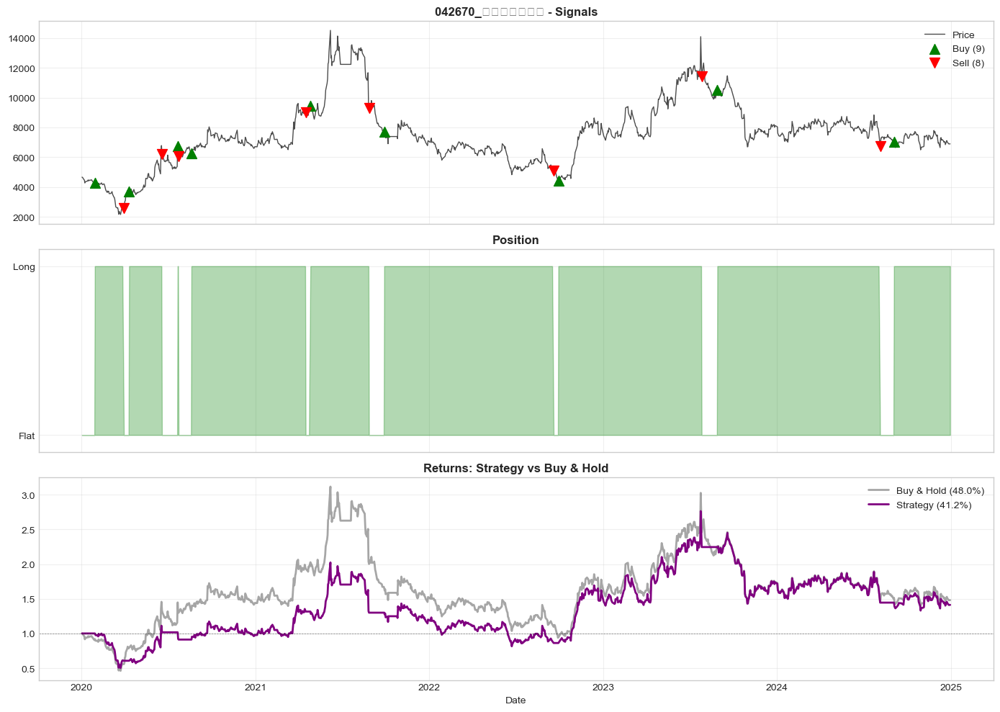


✓ Complete

[154/200] 047040_대우건설.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4660.00 → 3105.00

Strategy:  -45.87%  |  Market:  -33.37%  |  Excess:  -12.50%
Sharpe:    -0.067  |  Max DD:  -64.69%  |  Win:  44.7%  |  Trades:   7

First 5 trades:
  2020-01-29: BUY
  2020-03-19: SELL
  2020-04-22: BUY
  2021-02-09: SELL
  2021-03-09: BUY


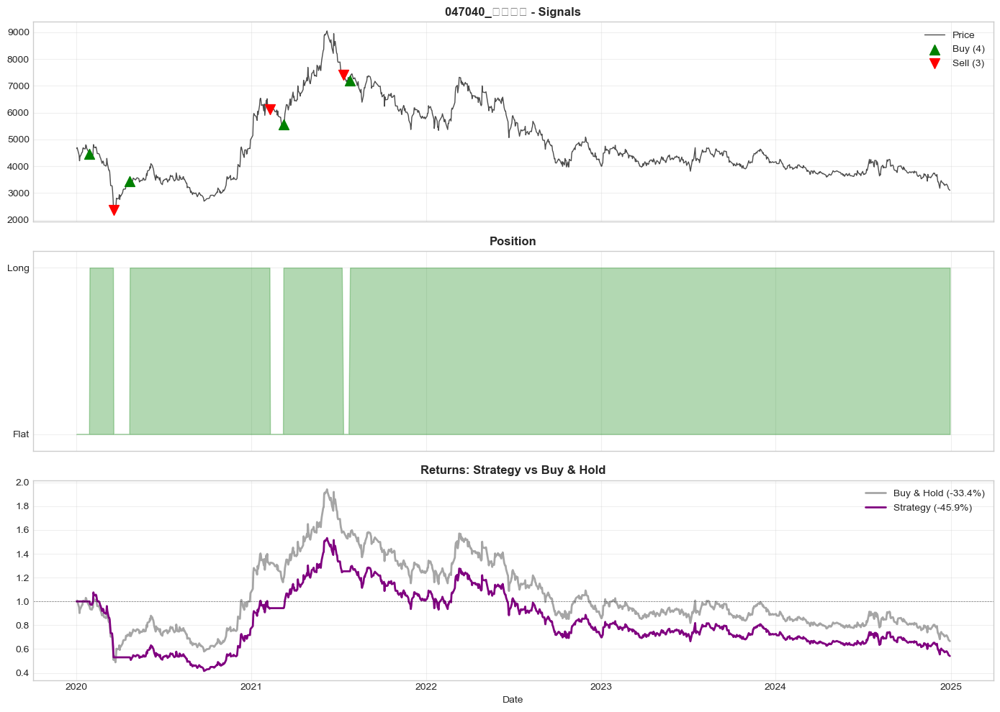


✓ Complete

[155/200] 047050_대우인터내셔널.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 18350.00 → 39650.00

Strategy:  201.62%  |  Market:  116.08%  |  Excess:   85.54%
Sharpe:     0.752  |  Max DD:  -54.69%  |  Win:  44.8%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2021-08-12: SELL
  2021-08-24: BUY
  2023-08-07: SELL
  2023-10-06: BUY


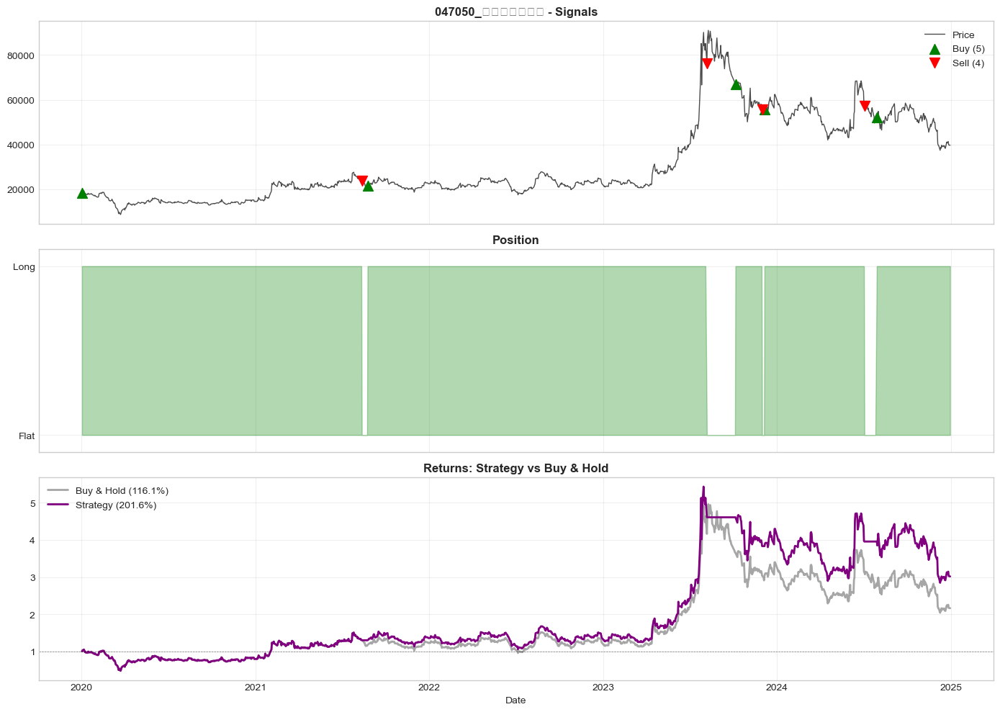


✓ Complete

[156/200] 047810_한국항공우주.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 33800.00 → 54900.00

Strategy:  -19.00%  |  Market:   62.43%  |  Excess:  -81.43%
Sharpe:     0.106  |  Max DD:  -54.10%  |  Win:  47.1%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-21: BUY
  2021-02-26: SELL
  2021-03-22: BUY


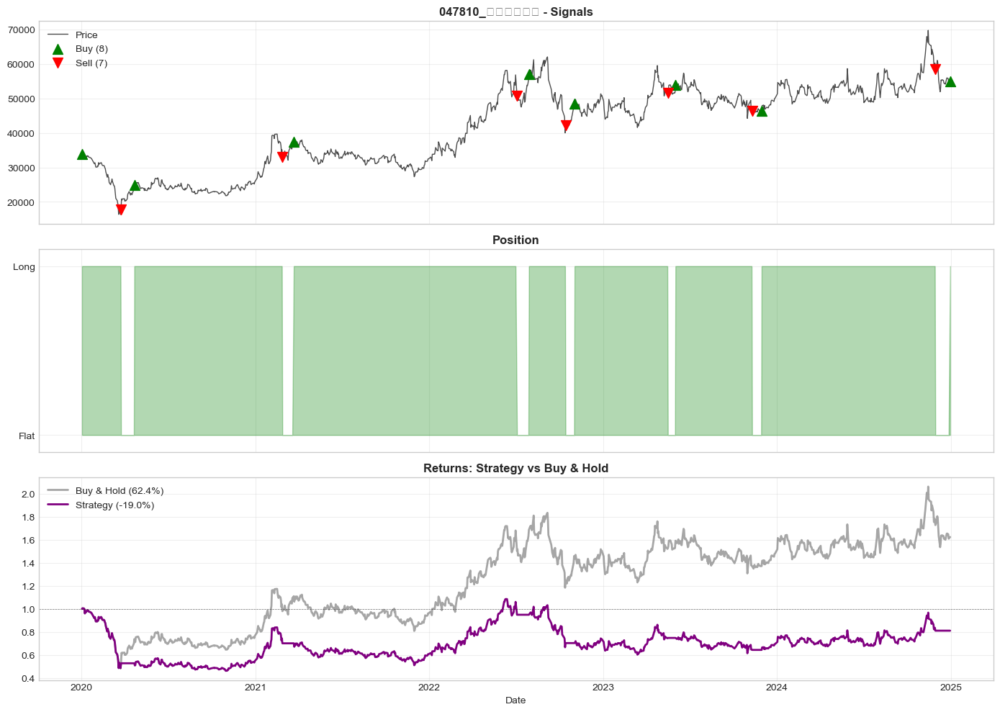


✓ Complete

[157/200] 049770_동원F&B.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 44743.00 → 31050.00

Strategy:   -6.56%  |  Market:  -30.60%  |  Excess:   24.04%
Sharpe:     0.134  |  Max DD:  -47.31%  |  Win:  43.5%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-02: SELL
  2020-04-24: BUY
  2024-07-03: SELL
  2024-09-02: BUY


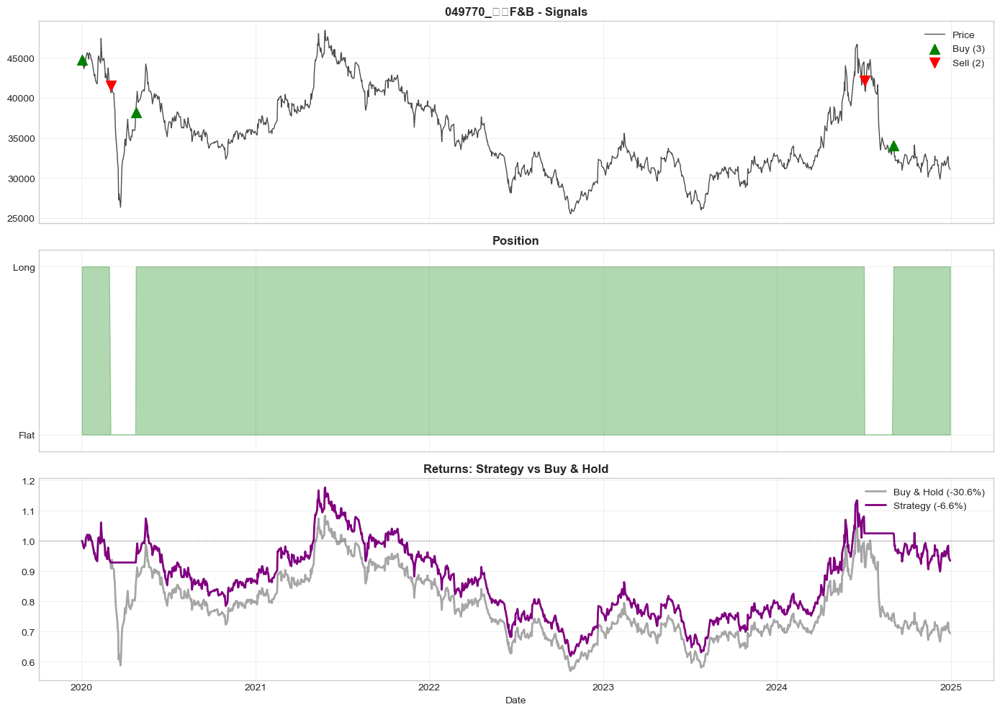


✓ Complete

[158/200] 051310_포스코플랜텍.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[159/200] 051600_한전KPS.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 38550.00 → 44100.00

Strategy:   19.43%  |  Market:   14.40%  |  Excess:    5.04%
Sharpe:     0.521  |  Max DD:  -35.31%  |  Win:  46.9%  |  Trades:  20

First 5 trades:
  2020-06-03: BUY
  2020-06-25: SELL
  2020-07-15: BUY
  2020-09-01: SELL
  2020-09-17: BUY


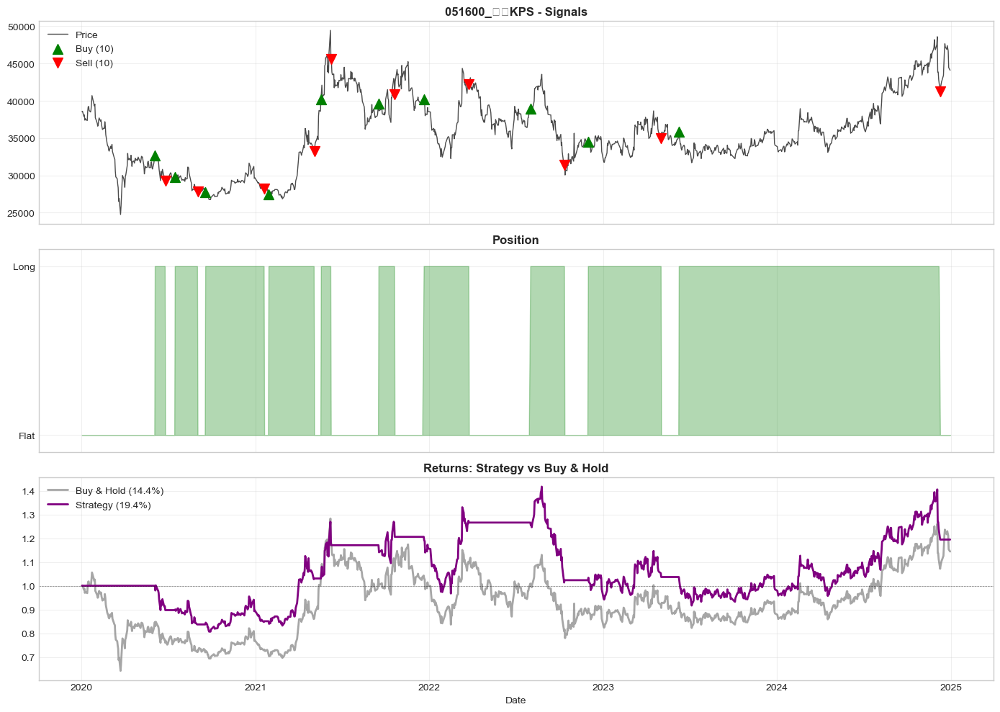


✓ Complete

[160/200] 051900_LG생활건강.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 1266000.00 → 305000.00

Strategy:  -83.64%  |  Market:  -75.91%  |  Excess:   -7.73%
Sharpe:    -0.920  |  Max DD:  -84.48%  |  Win:  44.1%  |  Trades:  17

First 5 trades:
  2020-02-17: BUY
  2020-03-30: SELL
  2020-04-21: BUY
  2020-09-03: SELL
  2020-09-09: BUY


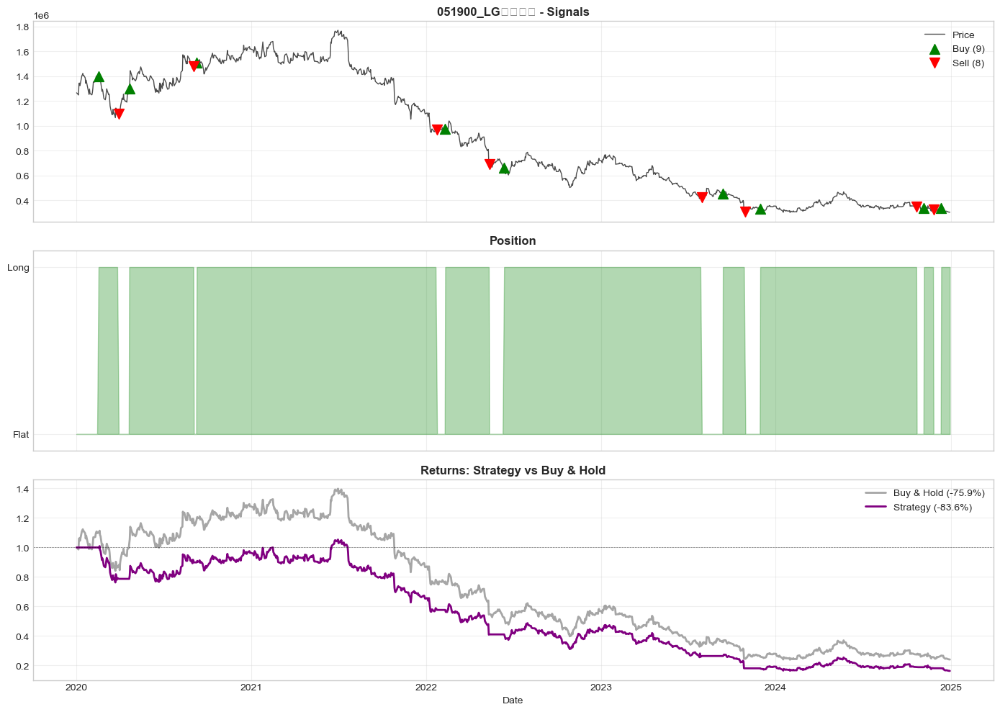


✓ Complete

[161/200] 051910_LG화학.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 314000.00 → 250000.00

Strategy:  -15.71%  |  Market:  -20.38%  |  Excess:    4.67%
Sharpe:     0.058  |  Max DD:  -70.12%  |  Win:  46.1%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2022-02-04: SELL
  2022-03-10: BUY


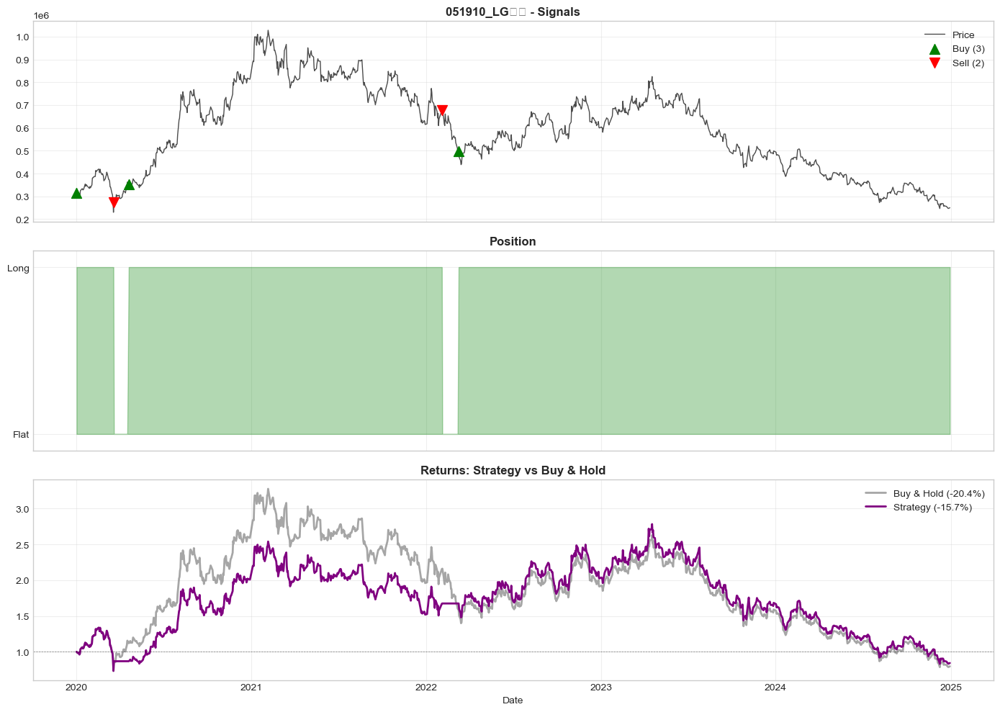


✓ Complete

[162/200] 052690_한전기술.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 20000.00 → 53000.00

Strategy:  121.36%  |  Market:  165.00%  |  Excess:  -43.64%
Sharpe:     0.800  |  Max DD:  -48.91%  |  Win:  47.1%  |  Trades:  20

First 5 trades:
  2020-01-23: BUY
  2021-04-29: SELL
  2021-05-26: BUY
  2021-06-11: SELL
  2021-07-06: BUY


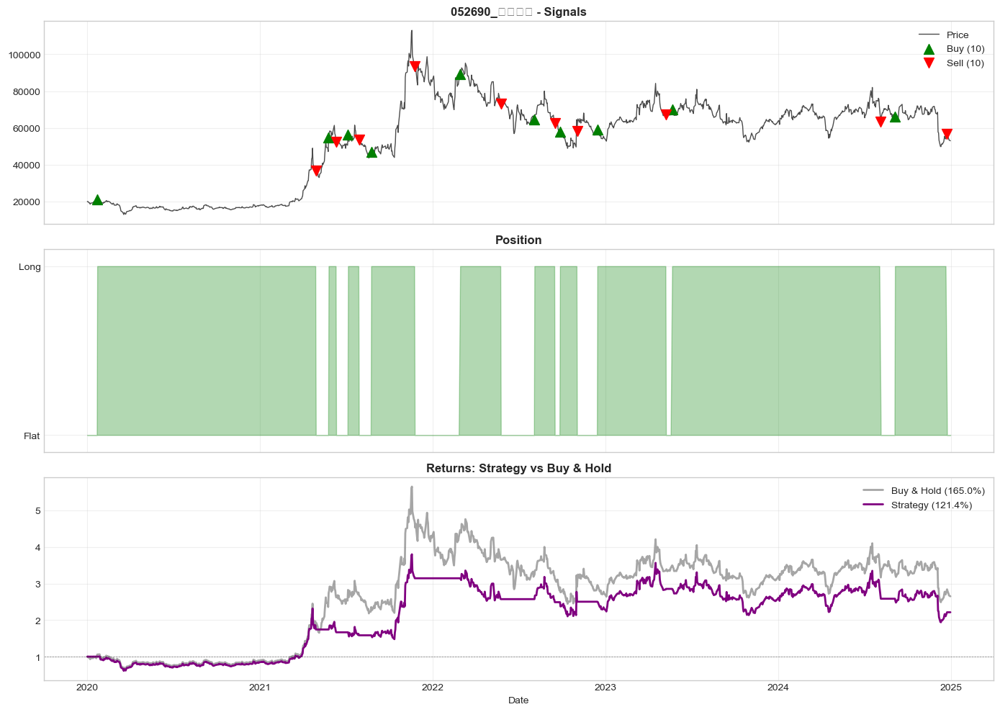


✓ Complete

[163/200] 055550_신한지주.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 42600.00 → 47650.00

Strategy:  -18.03%  |  Market:   11.85%  |  Excess:  -29.88%
Sharpe:    -0.100  |  Max DD:  -48.07%  |  Win:  47.8%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-05-28: BUY
  2020-06-16: SELL
  2020-07-15: BUY


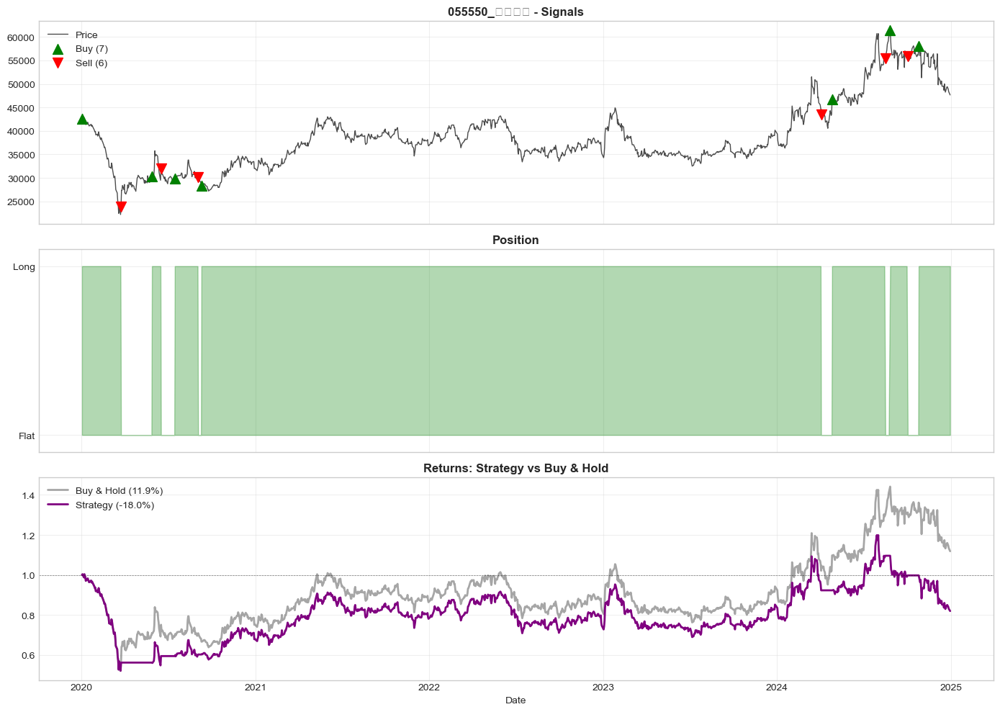


✓ Complete

[164/200] 060980_한라홀딩스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 45600.00 → 34250.00

Strategy:  -19.04%  |  Market:  -24.89%  |  Excess:    5.85%
Sharpe:    -0.026  |  Max DD:  -47.42%  |  Win:  45.4%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-07-15: BUY
  2020-08-27: SELL
  2020-09-17: BUY


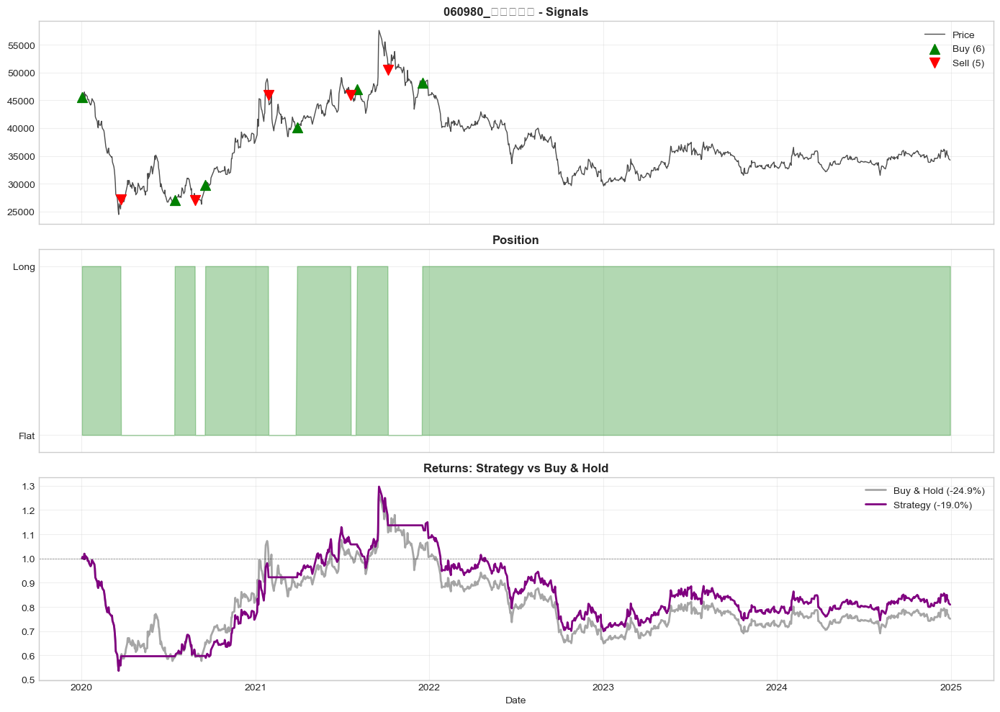


✓ Complete

[165/200] 064960_S&T모티브.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 24022.00 → 22204.00

Strategy:   12.85%  |  Market:   -7.57%  |  Excess:   20.42%
Sharpe:     0.248  |  Max DD:  -48.36%  |  Win:  47.9%  |  Trades:   9

First 5 trades:
  2020-01-30: BUY
  2020-05-06: SELL
  2020-05-11: BUY
  2020-06-23: SELL
  2020-07-15: BUY


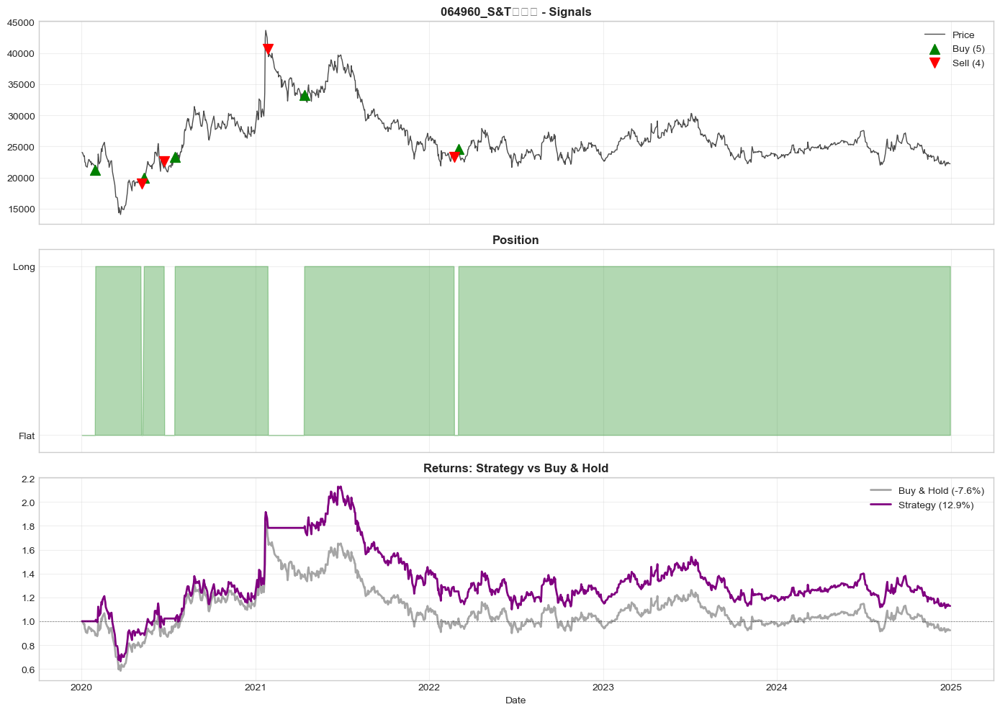


✓ Complete

[166/200] 066570_LG전자.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 71000.00 → 83500.00

Strategy:    5.37%  |  Market:   17.61%  |  Excess:  -12.24%
Sharpe:     0.200  |  Max DD:  -59.71%  |  Win:  45.2%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2021-02-09: SELL
  2021-02-22: BUY
  2024-06-18: SELL
  2024-06-24: BUY


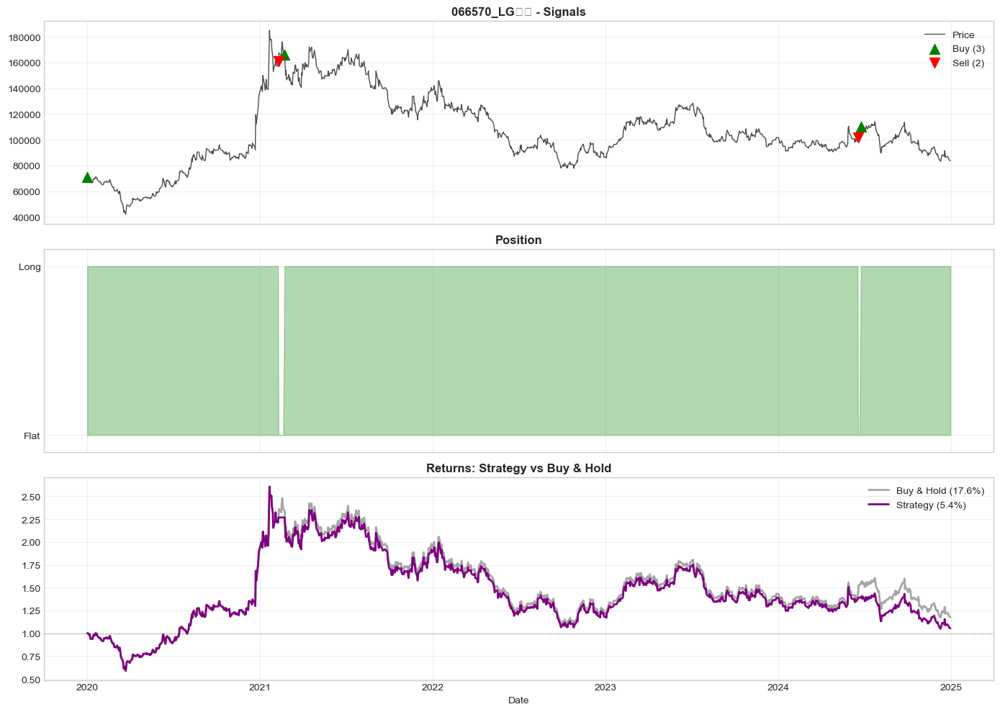


✓ Complete

[167/200] 068870_LG생명과학.parquet

✗ ERROR: Insufficient data: 0 rows (need >= 20)

[168/200] 069260_휴켐스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 20600.00 → 17050.00

Strategy:  -46.59%  |  Market:  -17.23%  |  Excess:  -29.36%
Sharpe:    -0.227  |  Max DD:  -53.90%  |  Win:  43.1%  |  Trades:  11

First 5 trades:
  2020-02-03: BUY
  2020-03-30: SELL
  2020-04-17: BUY
  2020-09-11: SELL
  2020-12-11: BUY


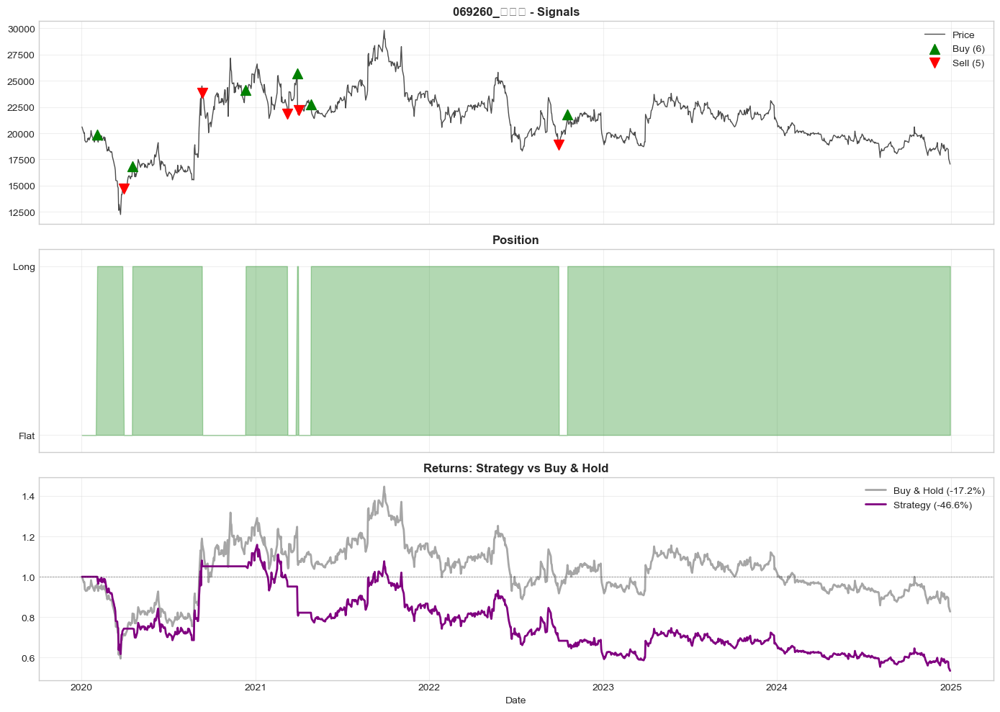


✓ Complete

[169/200] 069620_대웅제약.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 136500.00 → 126400.00

Strategy:   17.48%  |  Market:   -7.40%  |  Excess:   24.88%
Sharpe:     0.485  |  Max DD:  -62.27%  |  Win:  45.3%  |  Trades:   5

First 5 trades:
  2020-01-02: BUY
  2020-07-01: SELL
  2020-07-30: BUY
  2020-12-23: SELL
  2021-02-15: BUY


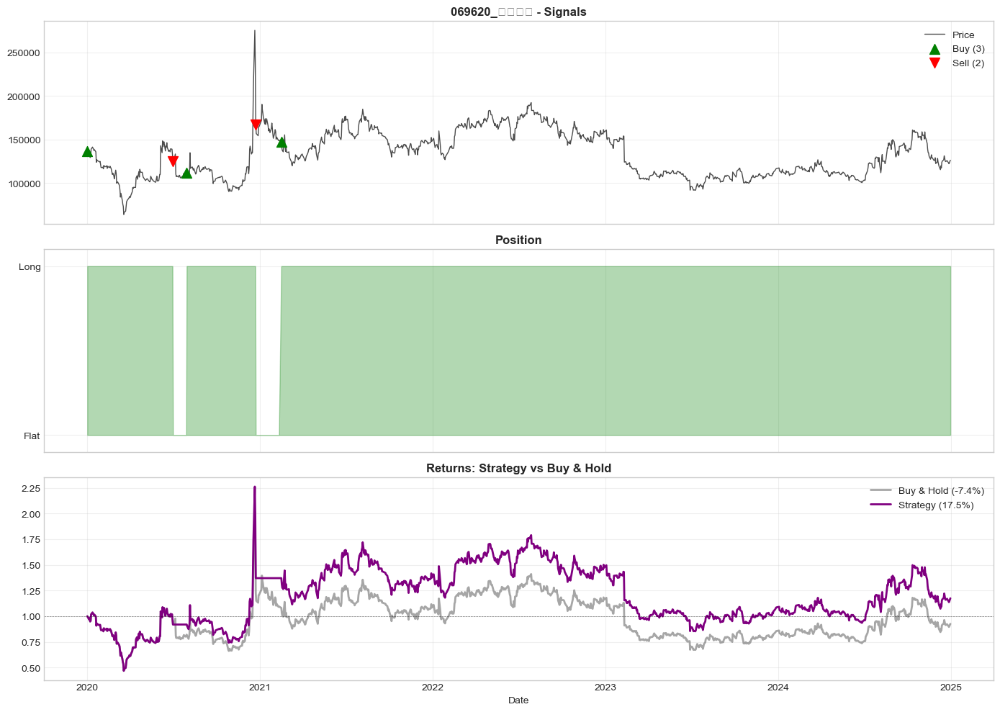


✓ Complete

[170/200] 069960_현대백화점.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 85900.00 → 47250.00

Strategy:  -34.95%  |  Market:  -44.99%  |  Excess:   10.05%
Sharpe:    -0.152  |  Max DD:  -56.71%  |  Win:  45.4%  |  Trades:  11

First 5 trades:
  2020-04-21: BUY
  2020-05-21: SELL
  2020-05-29: BUY
  2020-09-04: SELL
  2020-09-16: BUY


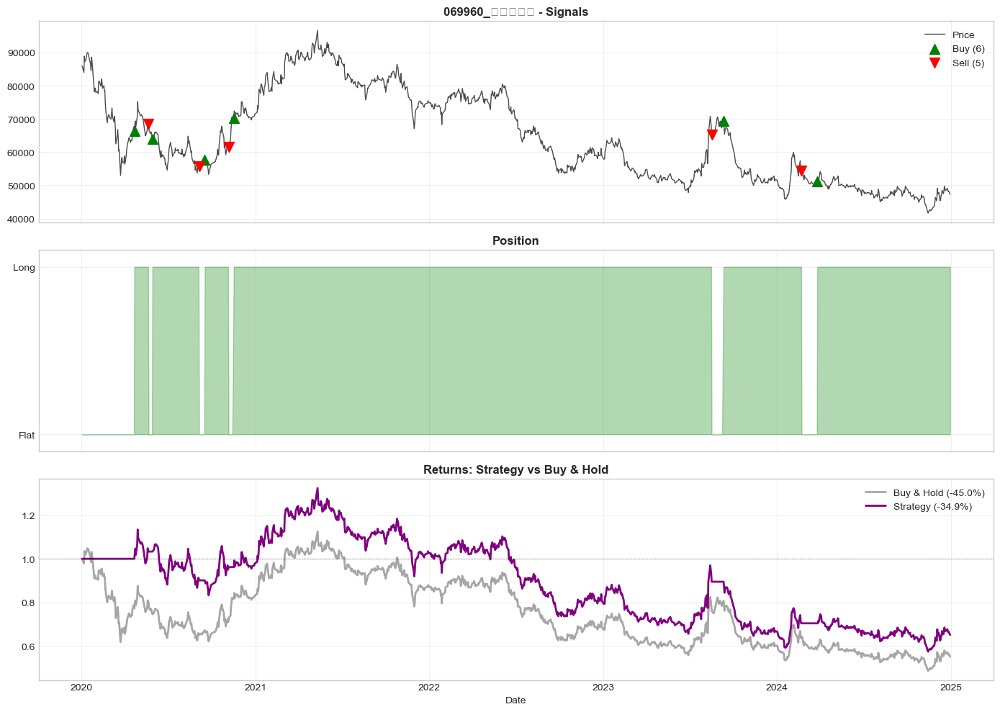


✓ Complete

[171/200] 071050_한국금융지주.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 70900.00 → 71300.00

Strategy:    2.35%  |  Market:    0.56%  |  Excess:    1.79%
Sharpe:     0.100  |  Max DD:  -59.87%  |  Win:  46.6%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-29: BUY
  2020-09-25: SELL
  2020-10-19: BUY


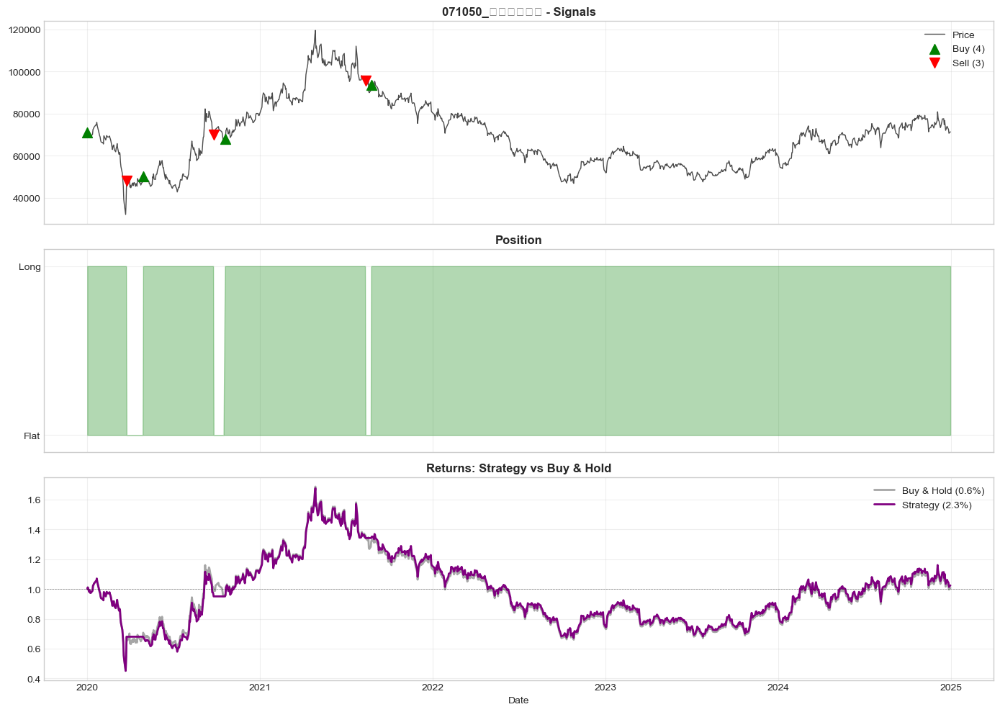


✓ Complete

[172/200] 073240_금호타이어.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4160.00 → 4775.00

Strategy:   -6.52%  |  Market:   14.78%  |  Excess:  -21.30%
Sharpe:     0.238  |  Max DD:  -62.54%  |  Win:  45.2%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-06-25: SELL
  2020-07-14: BUY
  2020-09-22: SELL
  2020-10-26: BUY


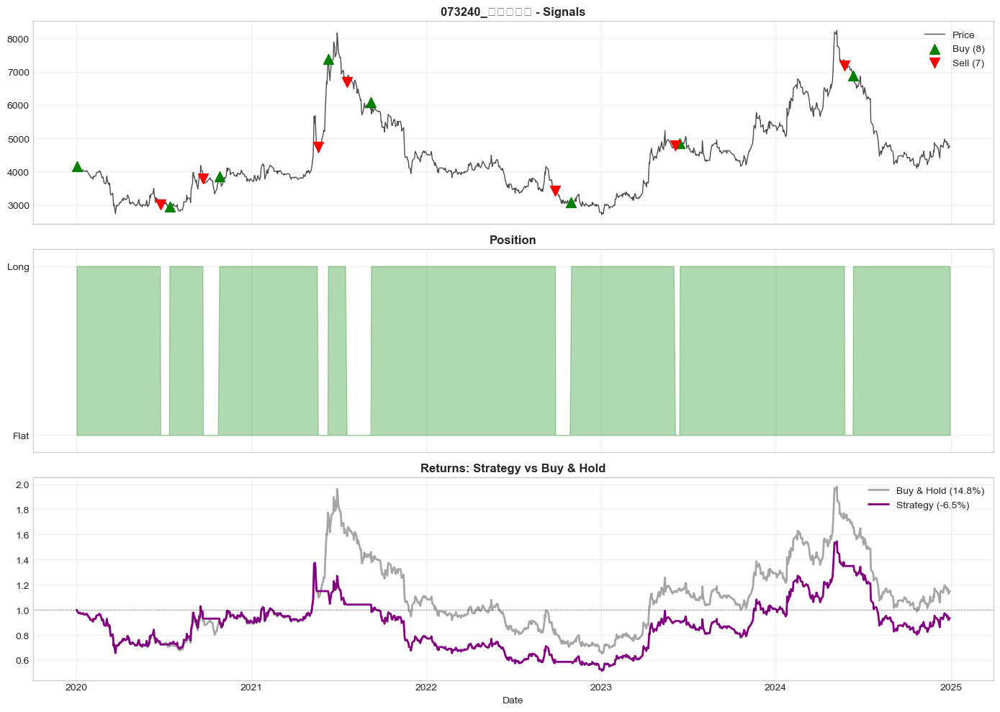


✓ Complete

[173/200] 078520_에이블씨엔씨.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 10650.00 → 6980.00

Strategy:   31.00%  |  Market:  -34.46%  |  Excess:   65.46%
Sharpe:     0.456  |  Max DD:  -60.86%  |  Win:  43.8%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-02-05: SELL
  2020-04-17: BUY
  2020-07-24: SELL
  2020-07-30: BUY


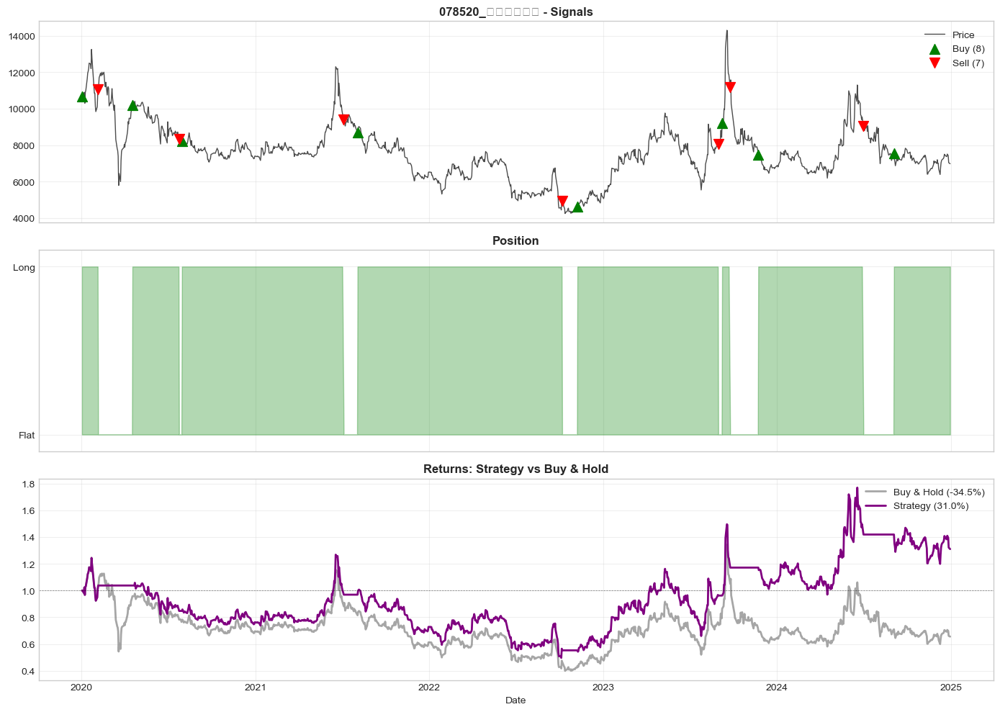


✓ Complete

[174/200] 078930_GS.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 50000.00 → 39300.00

Strategy:  -26.47%  |  Market:  -21.40%  |  Excess:   -5.07%
Sharpe:    -0.036  |  Max DD:  -35.97%  |  Win:  48.1%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-27: BUY
  2020-06-23: SELL
  2020-07-30: BUY


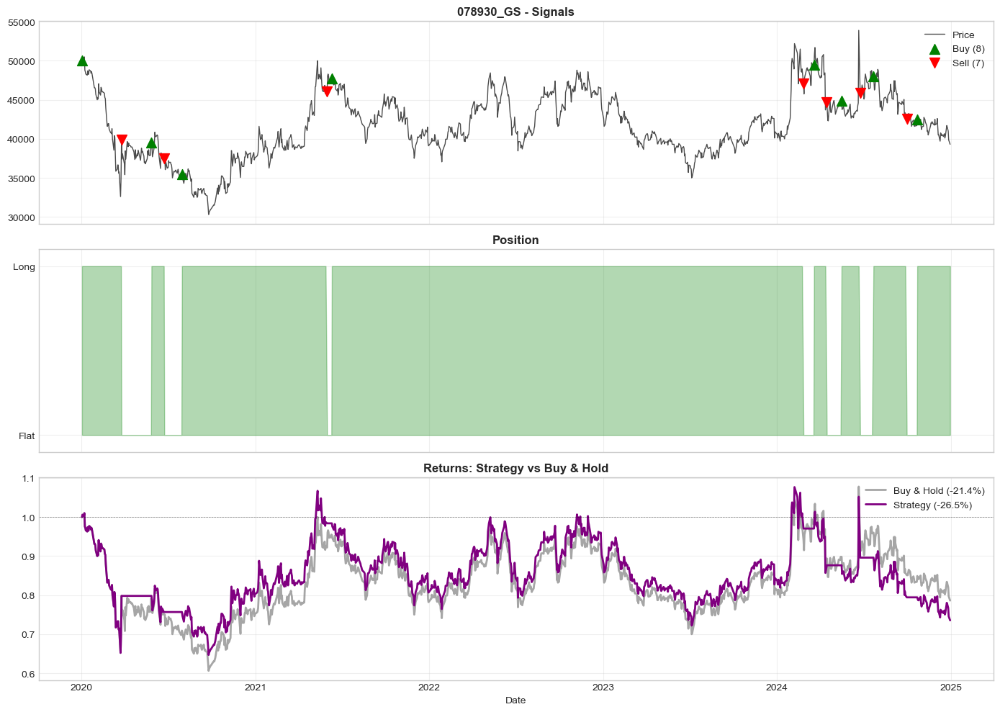


✓ Complete

[175/200] 079980_휴비스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 6000.00 → 2580.00

Strategy:  -66.15%  |  Market:  -57.00%  |  Excess:   -9.15%
Sharpe:    -0.169  |  Max DD:  -73.56%  |  Win:  42.0%  |  Trades:   9

First 5 trades:
  2020-02-03: BUY
  2020-02-13: SELL
  2020-03-03: BUY
  2020-03-19: SELL
  2020-04-17: BUY


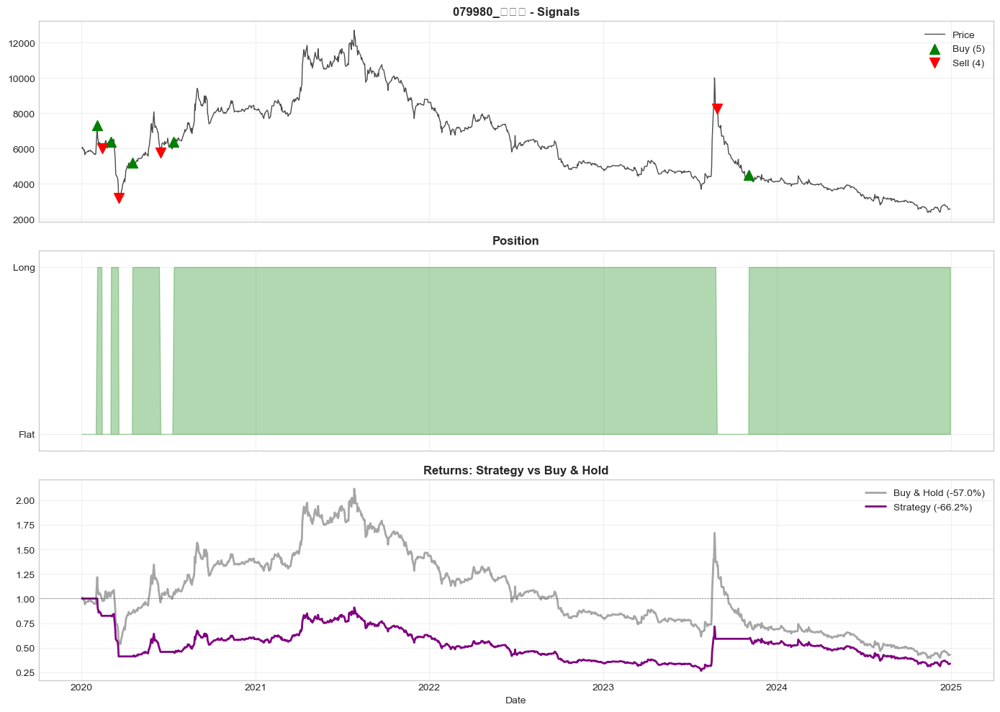


✓ Complete

[176/200] 082740_두산엔진.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 3577.00 → 18440.00

Strategy:  171.03%  |  Market:  415.52%  |  Excess: -244.49%
Sharpe:     0.802  |  Max DD:  -60.50%  |  Win:  46.0%  |  Trades:  21

First 5 trades:
  2020-01-30: BUY
  2020-03-19: SELL
  2020-04-28: BUY
  2020-06-16: SELL
  2020-08-11: BUY


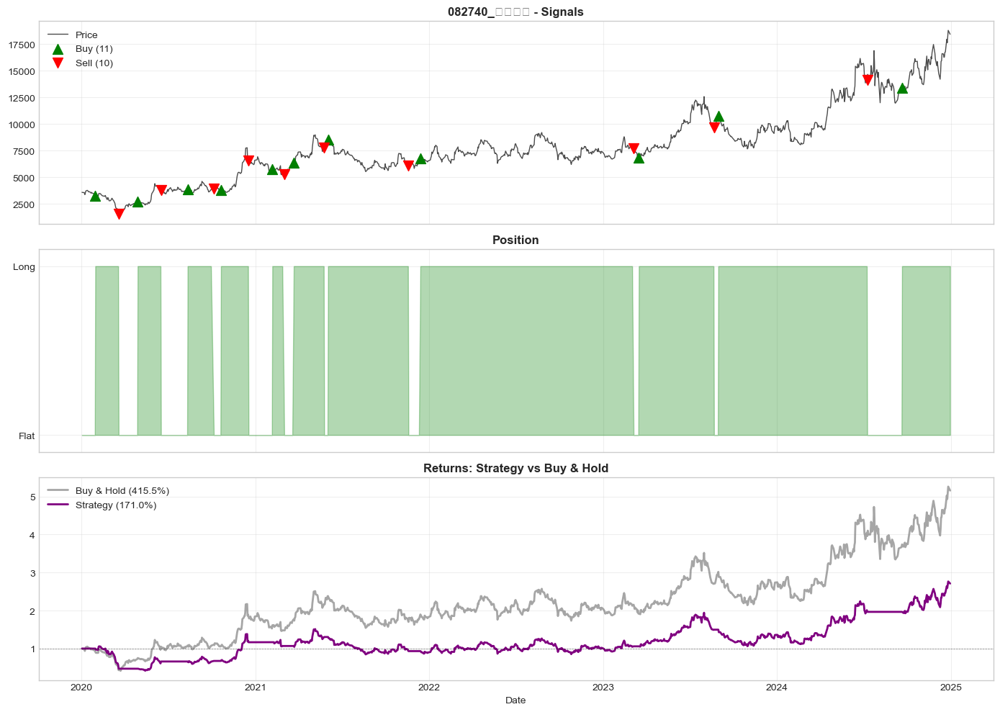


✓ Complete

[177/200] 084870_베이직하우스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 2830.00 → 1218.00

Strategy:  -59.42%  |  Market:  -56.96%  |  Excess:   -2.46%
Sharpe:    -0.044  |  Max DD:  -65.75%  |  Win:  44.6%  |  Trades:  15

First 5 trades:
  2020-02-06: BUY
  2020-03-16: SELL
  2020-04-13: BUY
  2020-06-11: SELL
  2020-07-17: BUY


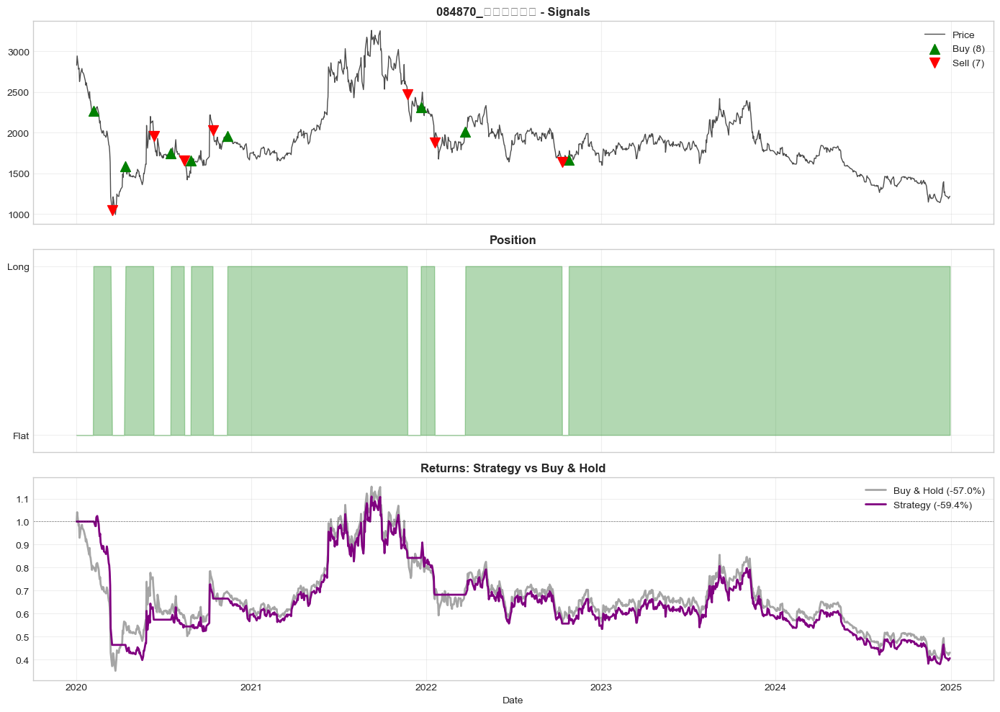


✓ Complete

[178/200] 086280_현대글로비스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 69277.00 → 118100.00

Strategy:   14.20%  |  Market:   70.48%  |  Excess:  -56.27%
Sharpe:     0.271  |  Max DD:  -53.01%  |  Win:  44.9%  |  Trades:  11

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-05-22: BUY
  2020-06-23: SELL
  2020-07-17: BUY


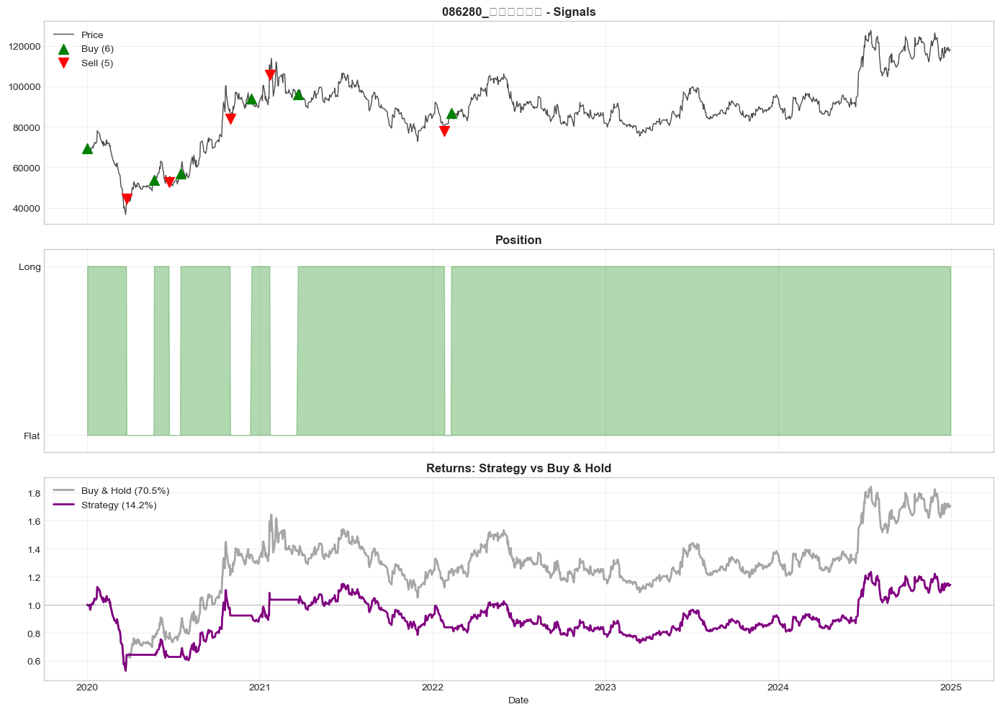


✓ Complete

[179/200] 086790_하나금융지주.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 35950.00 → 56800.00

Strategy:   24.74%  |  Market:   58.00%  |  Excess:  -33.26%
Sharpe:     0.278  |  Max DD:  -49.03%  |  Win:  46.8%  |  Trades:   6

First 5 trades:
  2020-01-02: BUY
  2020-03-26: SELL
  2020-05-28: BUY
  2020-06-22: SELL
  2020-07-15: BUY


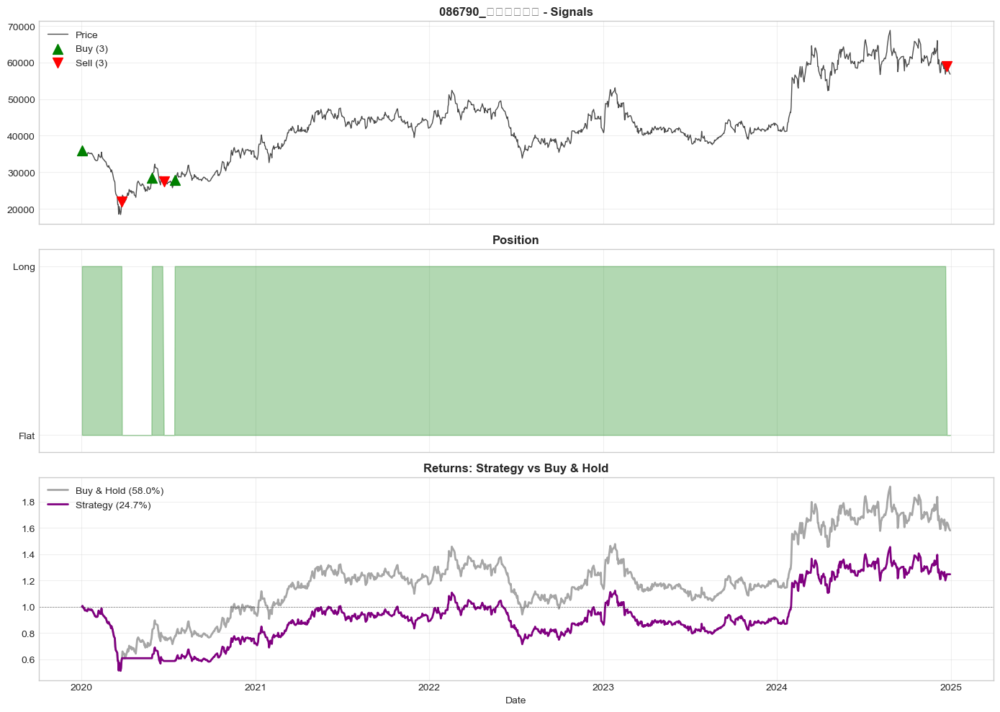


✓ Complete

[180/200] 088350_한화생명.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 2290.00 → 2460.00

Strategy:   -7.92%  |  Market:    7.42%  |  Excess:  -15.35%
Sharpe:     0.211  |  Max DD:  -60.92%  |  Win:  46.2%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-30: SELL
  2020-05-28: BUY
  2021-01-26: SELL
  2021-02-09: BUY


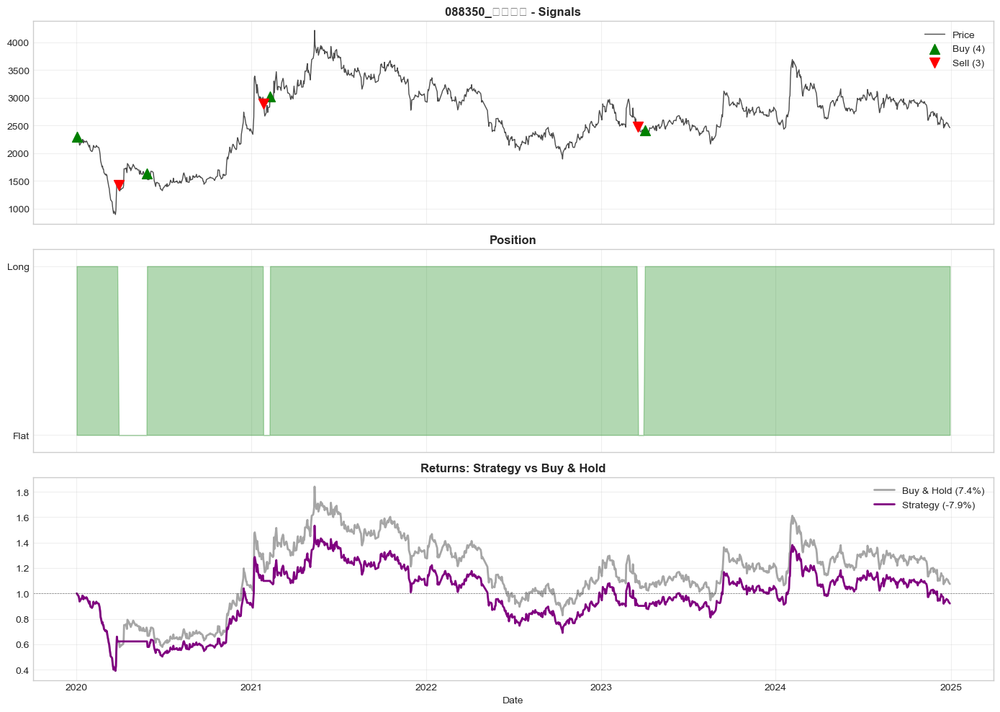


✓ Complete

[181/200] 090430_아모레퍼시픽.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 207500.00 → 104800.00

Strategy:  -33.30%  |  Market:  -49.49%  |  Excess:   16.19%
Sharpe:     0.205  |  Max DD:  -72.66%  |  Win:  46.4%  |  Trades:  15

First 5 trades:
  2020-03-18: BUY
  2020-09-03: SELL
  2020-09-16: BUY
  2022-05-19: SELL
  2022-05-31: BUY


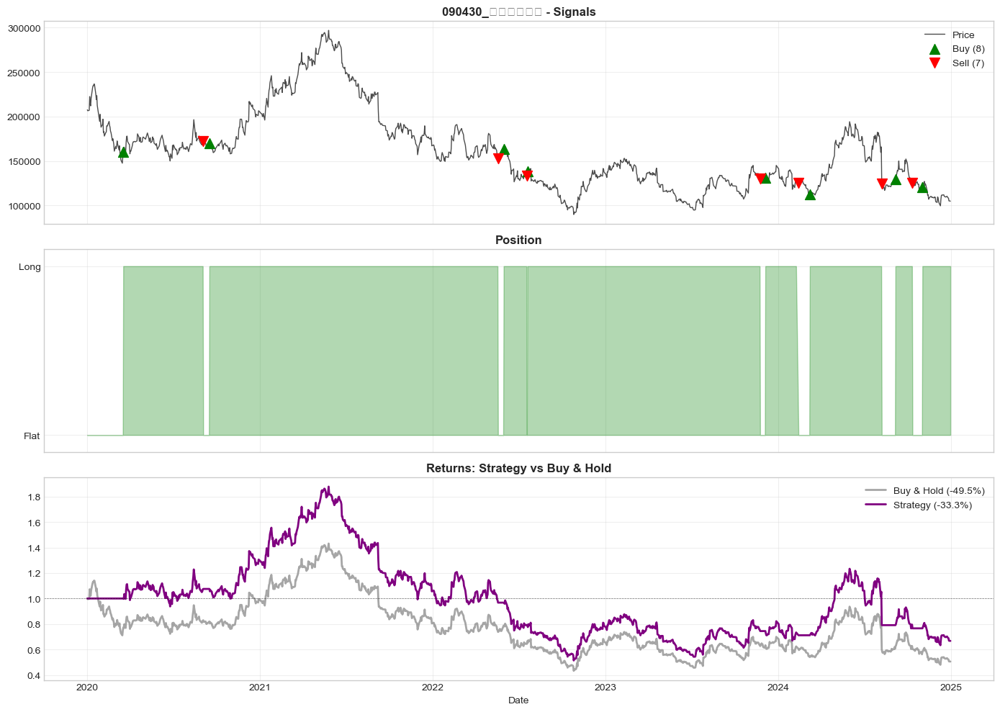


✓ Complete

[182/200] 093050_LF.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 17800.00 → 15500.00

Strategy:  -37.14%  |  Market:  -12.92%  |  Excess:  -24.22%
Sharpe:    -0.101  |  Max DD:  -49.61%  |  Win:  45.6%  |  Trades:   7

First 5 trades:
  2020-01-30: BUY
  2020-03-23: SELL
  2020-05-27: BUY
  2020-09-01: SELL
  2020-09-15: BUY


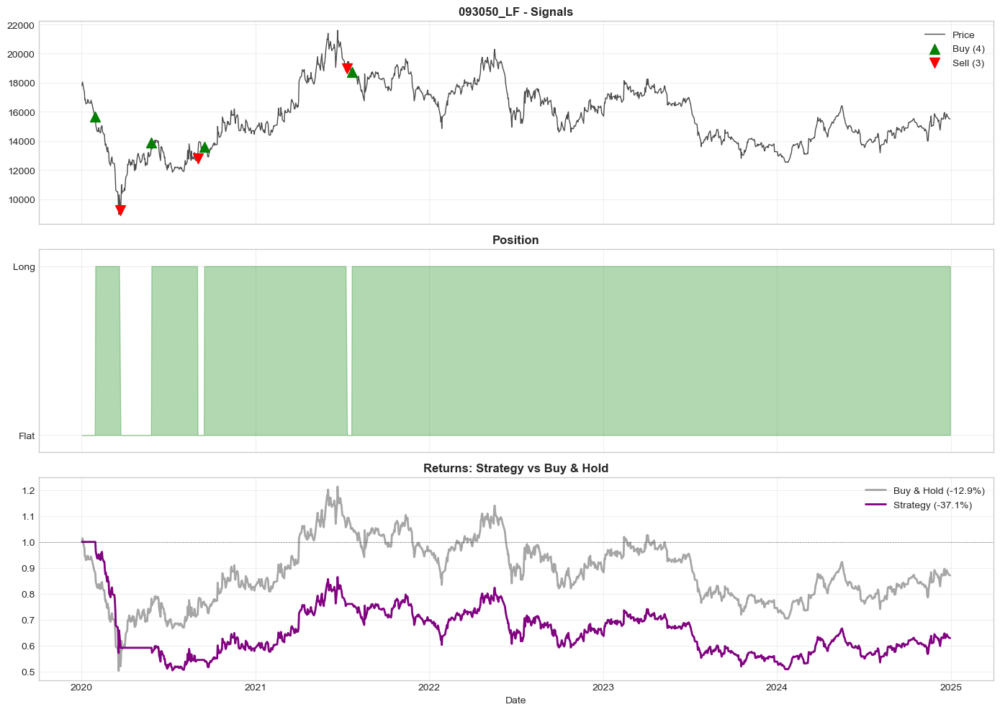


✓ Complete

[183/200] 093370_후성.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 7940.00 → 4975.00

Strategy:    0.67%  |  Market:  -37.34%  |  Excess:   38.02%
Sharpe:     0.422  |  Max DD:  -68.30%  |  Win:  46.5%  |  Trades:  26

First 5 trades:
  2020-01-02: BUY
  2020-02-24: SELL
  2020-04-20: BUY
  2020-06-29: SELL
  2020-07-16: BUY


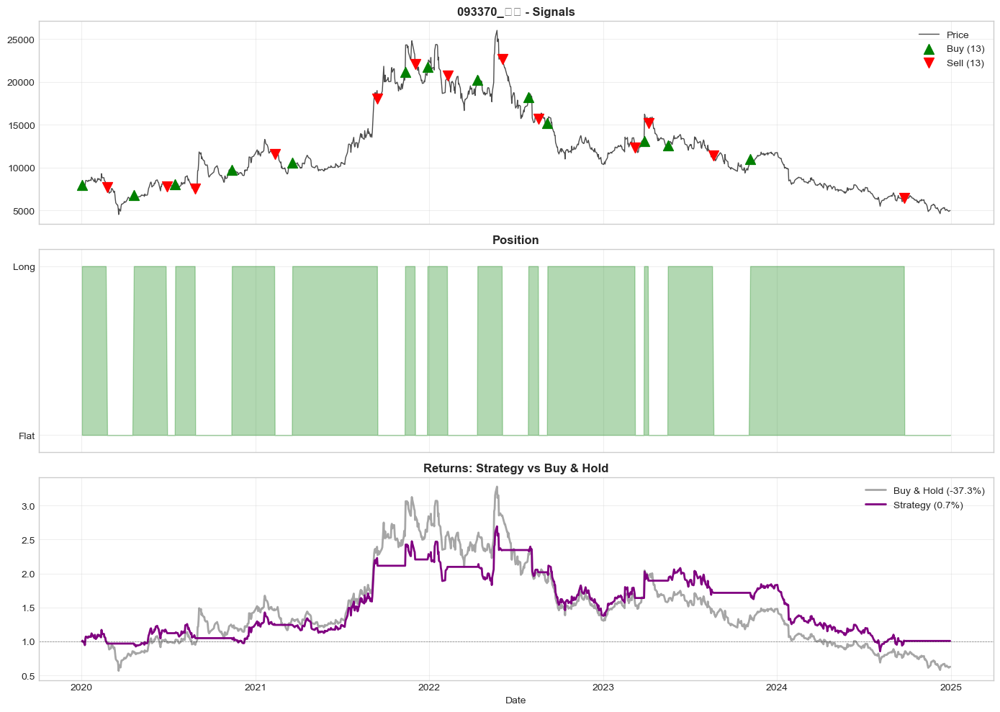


✓ Complete

[184/200] 096770_SK이노베이션.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 144148.00 → 112000.00

Strategy:  -29.89%  |  Market:  -22.30%  |  Excess:   -7.59%
Sharpe:     0.030  |  Max DD:  -70.87%  |  Win:  44.1%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-25: SELL
  2020-04-23: BUY
  2020-08-27: SELL
  2020-09-18: BUY


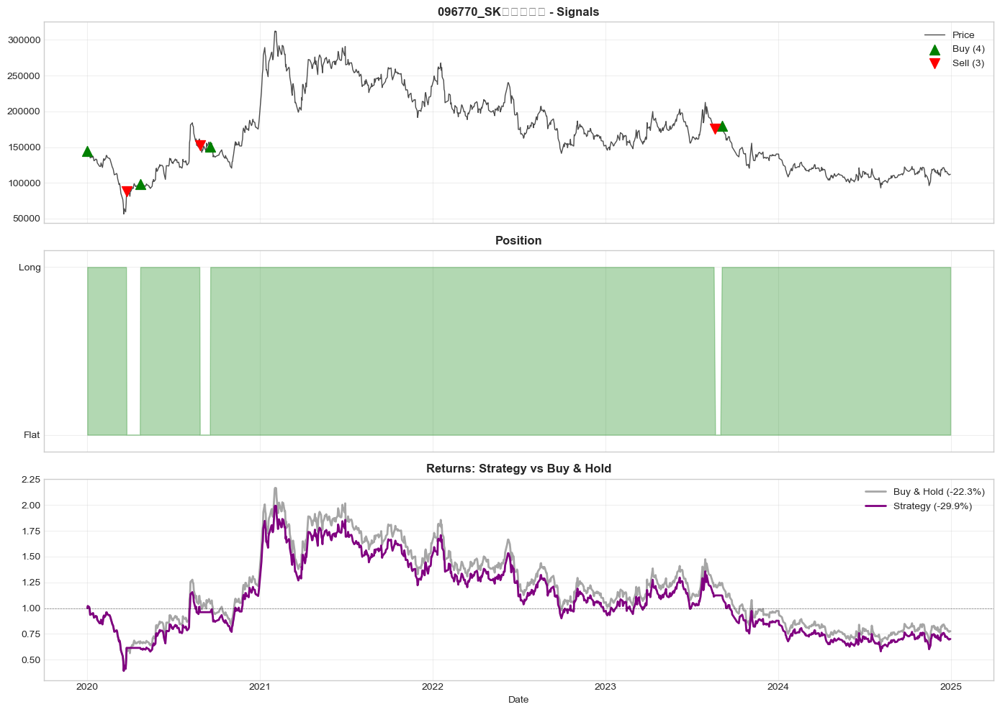


✓ Complete

[185/200] 097230_한진중공업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 5060.00 → 5930.00

Strategy:  -29.16%  |  Market:   17.19%  |  Excess:  -46.35%
Sharpe:     0.050  |  Max DD:  -77.94%  |  Win:  43.1%  |  Trades:   8

First 5 trades:
  2020-01-02: BUY
  2020-05-12: SELL
  2020-05-27: BUY
  2020-10-08: SELL
  2020-11-16: BUY


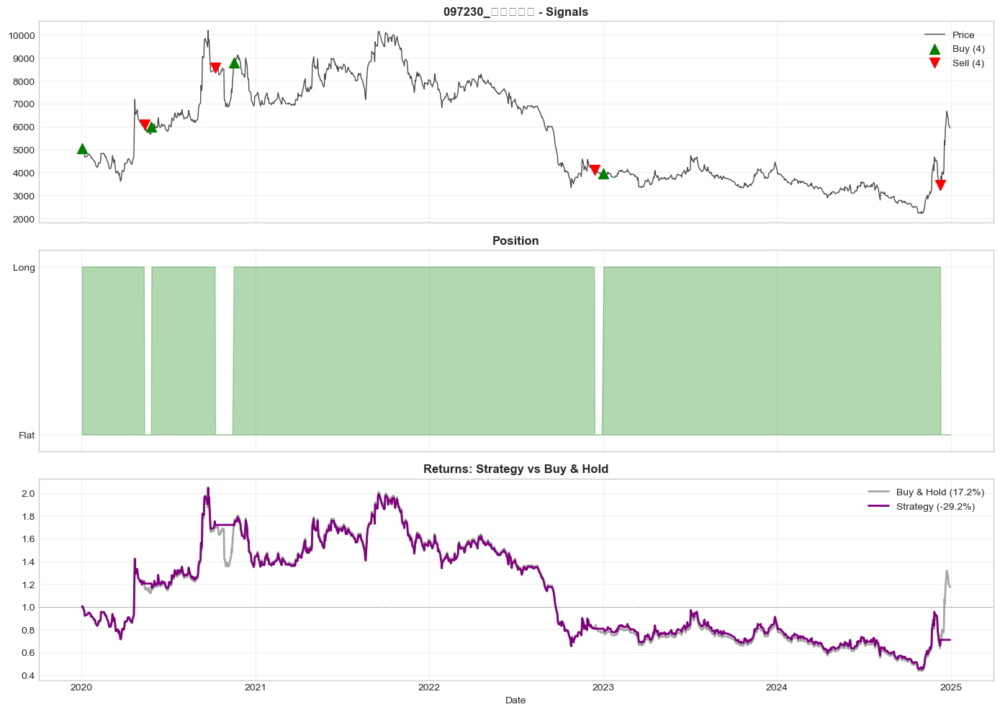


✓ Complete

[186/200] 097950_CJ제일제당.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 245000.00 → 255500.00

Strategy:  -16.92%  |  Market:    4.29%  |  Excess:  -21.21%
Sharpe:    -0.075  |  Max DD:  -51.17%  |  Win:  44.5%  |  Trades:   3

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-22: BUY


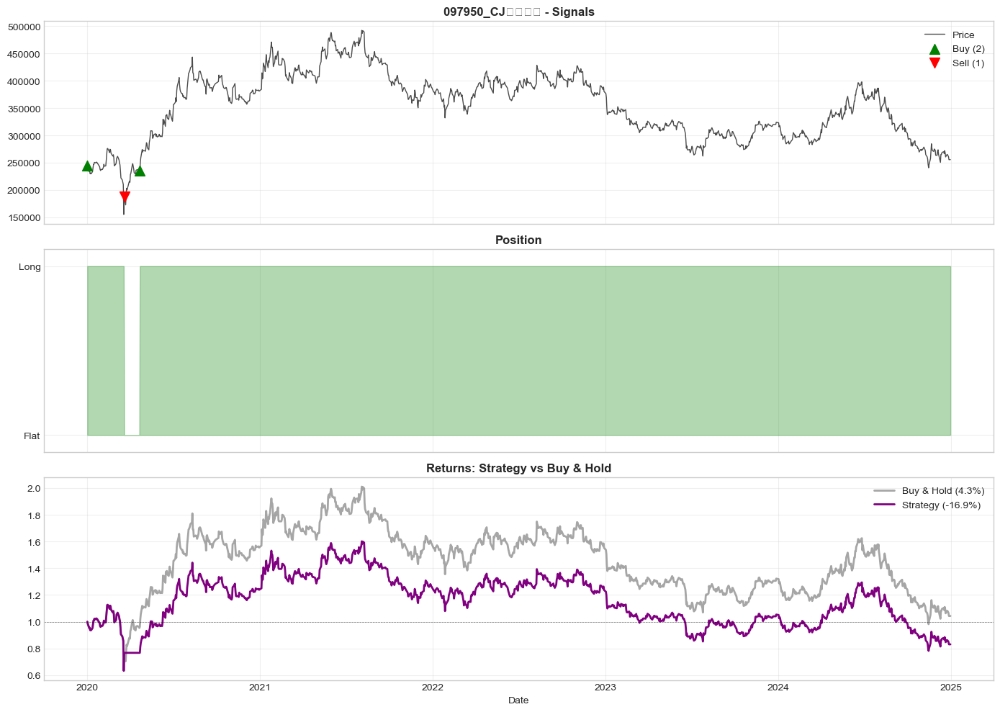


✓ Complete

[187/200] 103140_풍산.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 23300.00 → 49950.00

Strategy:   32.87%  |  Market:  114.38%  |  Excess:  -81.51%
Sharpe:     0.311  |  Max DD:  -49.33%  |  Win:  47.9%  |  Trades:  17

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2020-06-23: SELL
  2020-07-15: BUY


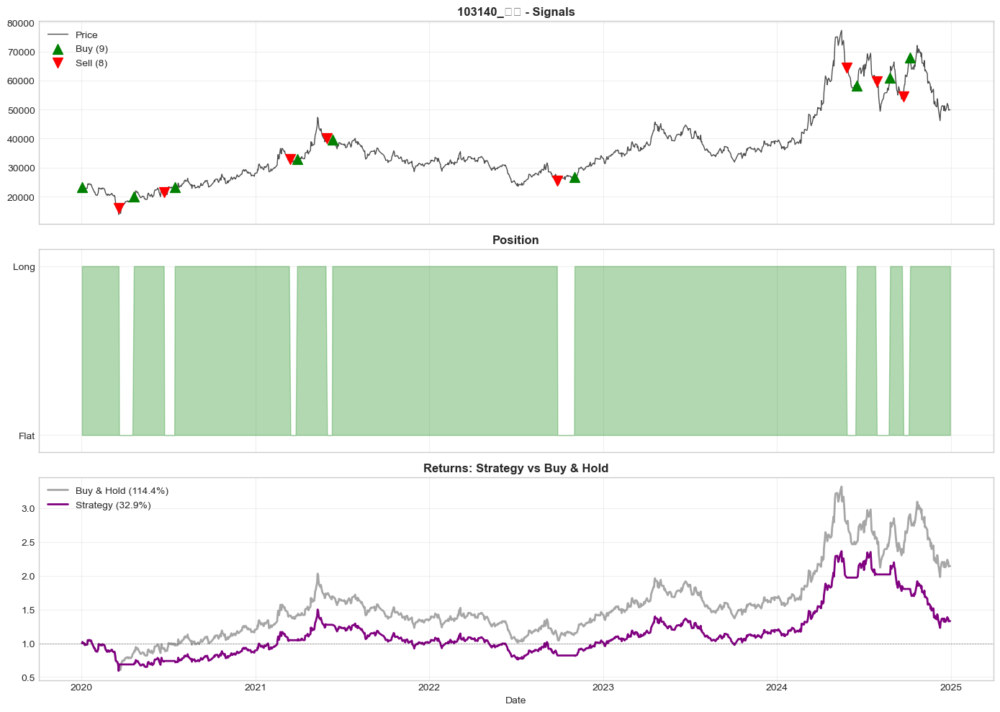


✓ Complete

[188/200] 104700_한국철강.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 4785.00 → 8380.00

Strategy:   41.97%  |  Market:   75.13%  |  Excess:  -33.16%
Sharpe:     0.492  |  Max DD:  -45.11%  |  Win:  46.4%  |  Trades:  15

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-17: BUY
  2020-06-29: SELL
  2020-07-17: BUY


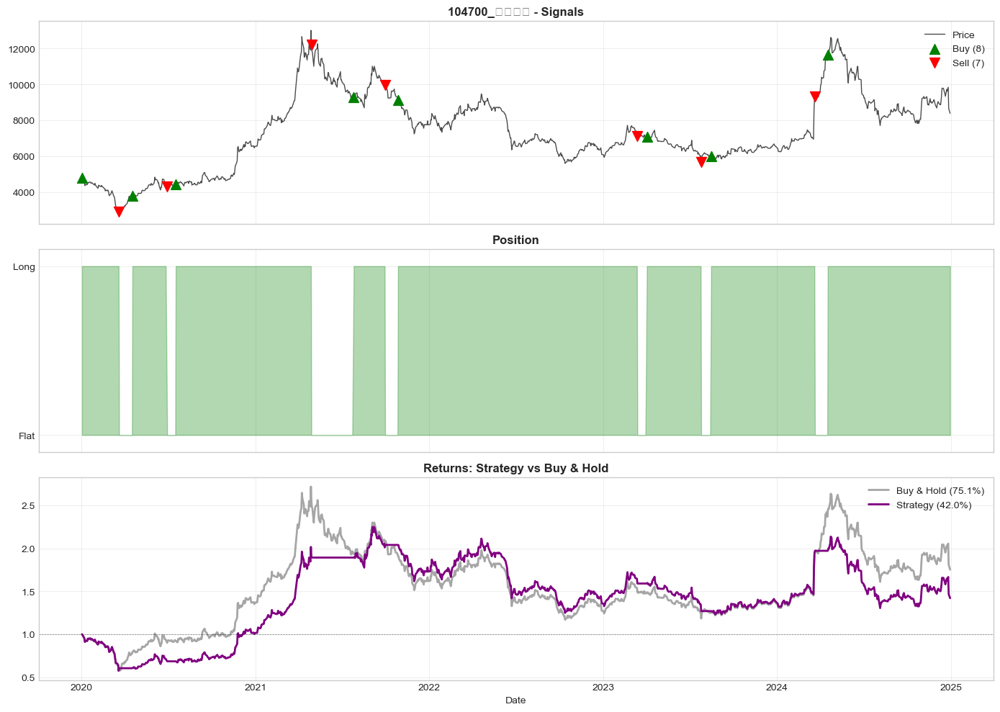


✓ Complete

[189/200] 105560_KB금융.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 46550.00 → 82900.00

Strategy:   53.17%  |  Market:   78.09%  |  Excess:  -24.92%
Sharpe:     0.410  |  Max DD:  -46.07%  |  Win:  47.9%  |  Trades:   6

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-04-27: BUY
  2020-06-25: SELL
  2020-07-14: BUY


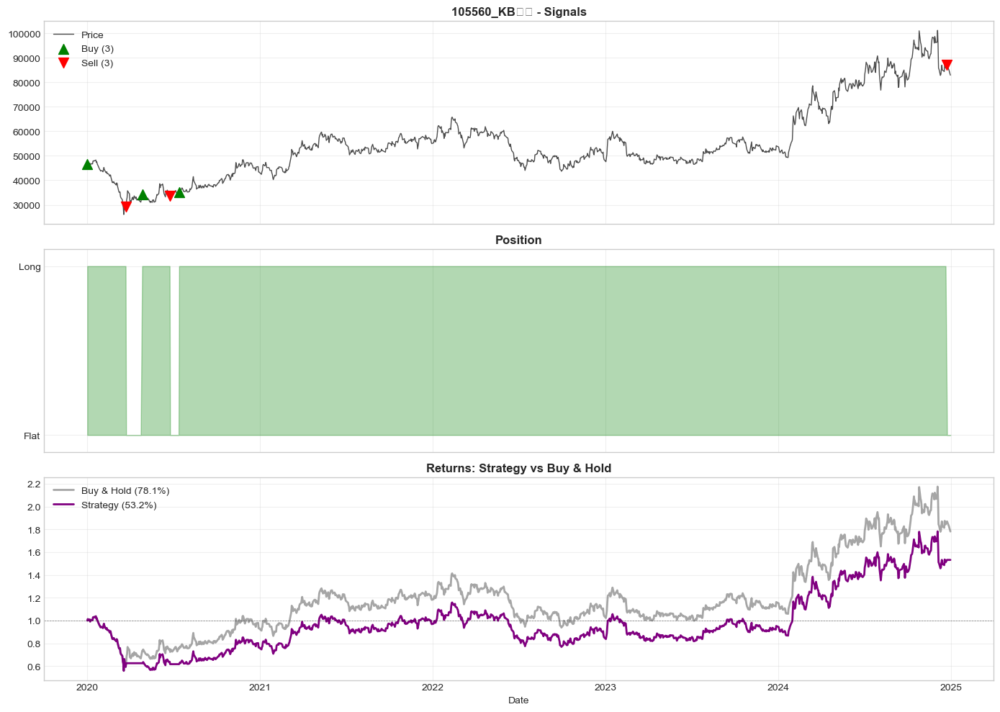


✓ Complete

[190/200] 105630_한세실업.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 17350.00 → 14170.00

Strategy:  -41.52%  |  Market:  -18.33%  |  Excess:  -23.19%
Sharpe:     0.100  |  Max DD:  -63.60%  |  Win:  45.4%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-03-19: SELL
  2020-04-20: BUY
  2021-06-04: SELL
  2021-06-25: BUY


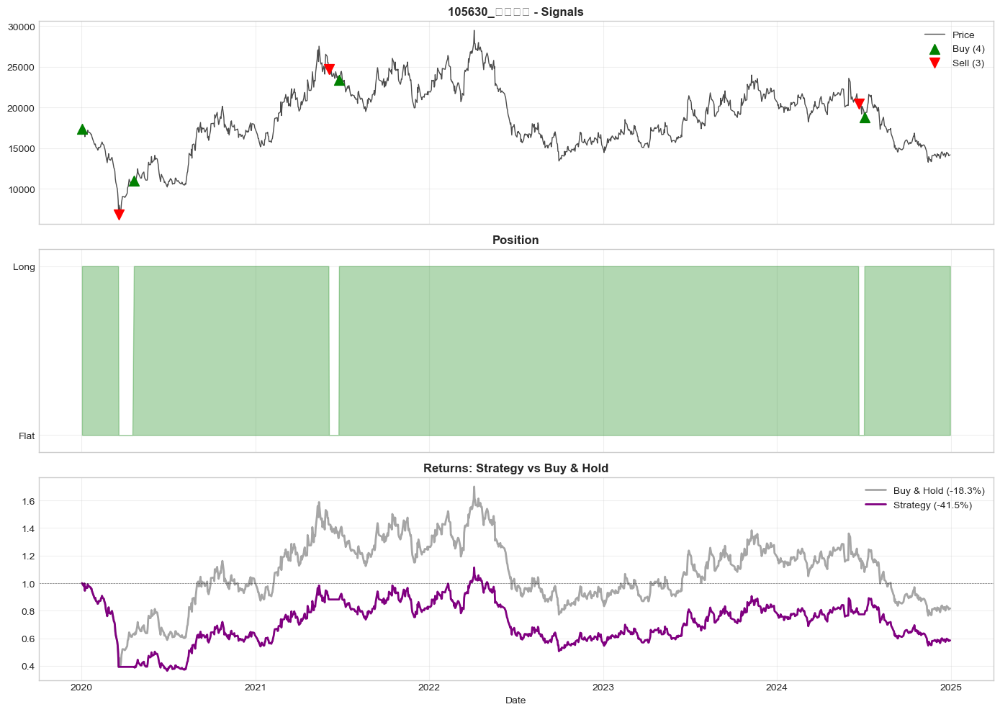


✓ Complete

[191/200] 108670_LG하우시스.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 54900.00 → 31900.00

Strategy:  -41.80%  |  Market:  -41.89%  |  Excess:    0.09%
Sharpe:    -0.109  |  Max DD:  -71.01%  |  Win:  44.9%  |  Trades:  19

First 5 trades:
  2020-01-02: BUY
  2020-03-20: SELL
  2020-04-20: BUY
  2020-06-18: SELL
  2020-07-13: BUY


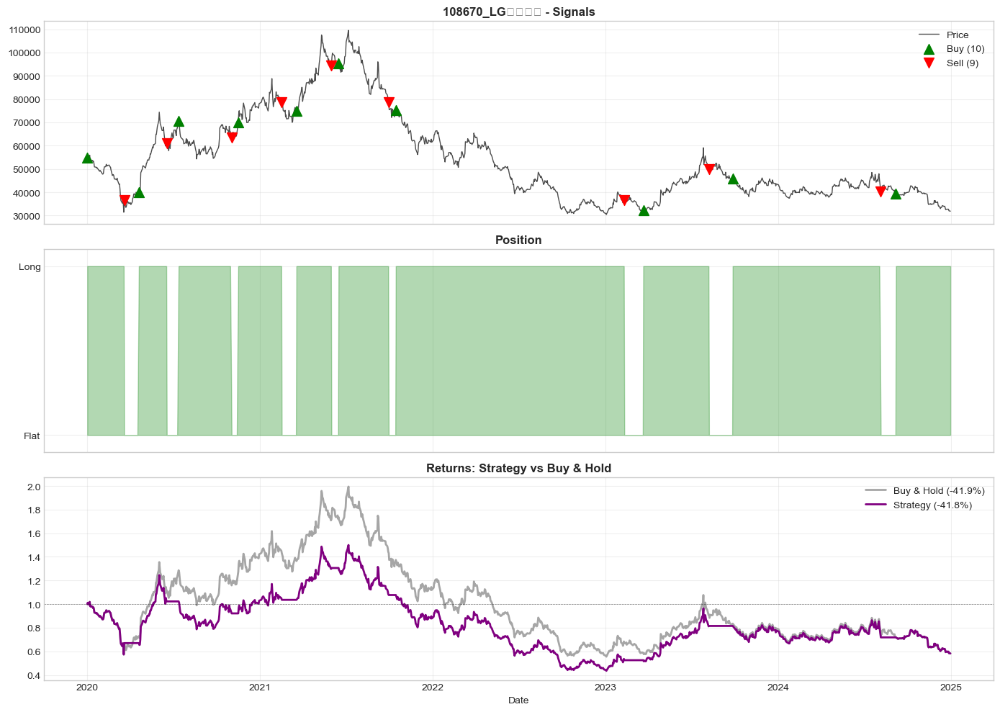


✓ Complete

[192/200] 114090_GKL.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 19450.00 → 11040.00

Strategy:  -60.01%  |  Market:  -43.24%  |  Excess:  -16.77%
Sharpe:    -0.405  |  Max DD:  -67.45%  |  Win:  45.7%  |  Trades:   9

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-06-04: BUY
  2020-09-03: SELL
  2020-09-15: BUY


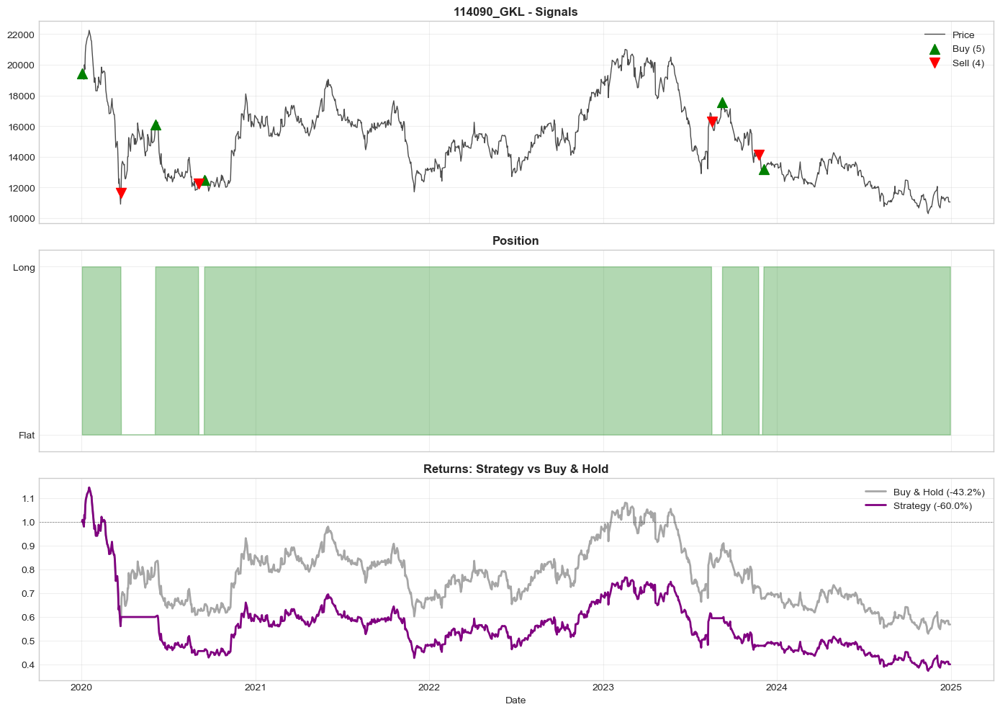


✓ Complete

[193/200] 115390_락앤락.parquet
Data: 1216 days (2020-01-02 to 2024-12-06)
Price: 14117.00 → 8660.00

Strategy:  -71.48%  |  Market:  -38.66%  |  Excess:  -32.82%
Sharpe:    -0.685  |  Max DD:  -75.53%  |  Win:  39.2%  |  Trades:   7

First 5 trades:
  2020-01-28: BUY
  2020-03-20: SELL
  2020-05-19: BUY
  2024-01-16: SELL
  2024-01-26: BUY


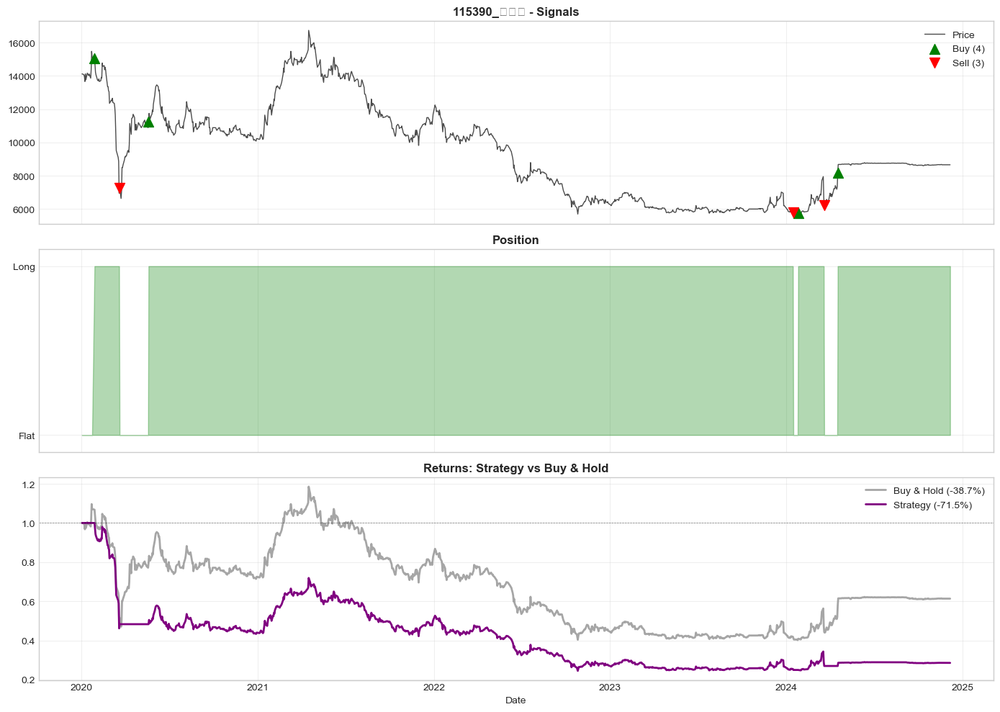


✓ Complete

[194/200] 120110_코오롱인더.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 49450.00 → 27150.00

Strategy:  -58.85%  |  Market:  -45.10%  |  Excess:  -13.76%
Sharpe:    -0.282  |  Max DD:  -71.08%  |  Win:  46.5%  |  Trades:  13

First 5 trades:
  2020-02-10: BUY
  2020-03-25: SELL
  2020-04-13: BUY
  2020-04-14: SELL
  2020-05-19: BUY


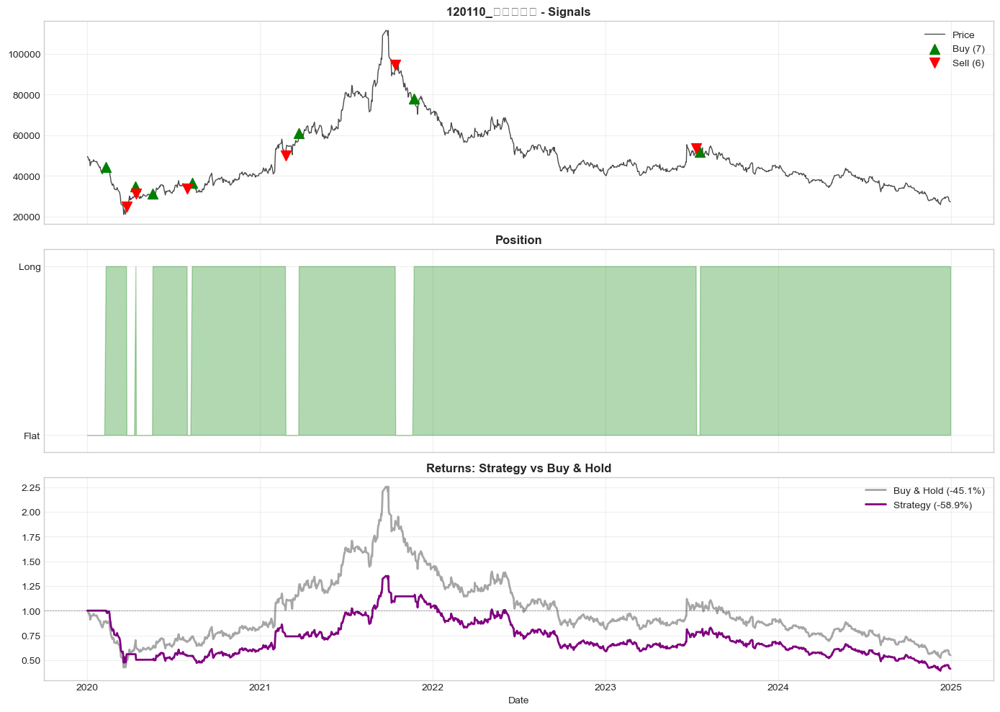


✓ Complete

[195/200] 128940_한미약품.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 272366.00 → 280500.00

Strategy:   51.02%  |  Market:    2.99%  |  Excess:   48.04%
Sharpe:     0.432  |  Max DD:  -34.92%  |  Win:  44.6%  |  Trades:  13

First 5 trades:
  2020-01-02: BUY
  2020-08-11: SELL
  2020-09-07: BUY
  2021-02-18: SELL
  2021-03-03: BUY


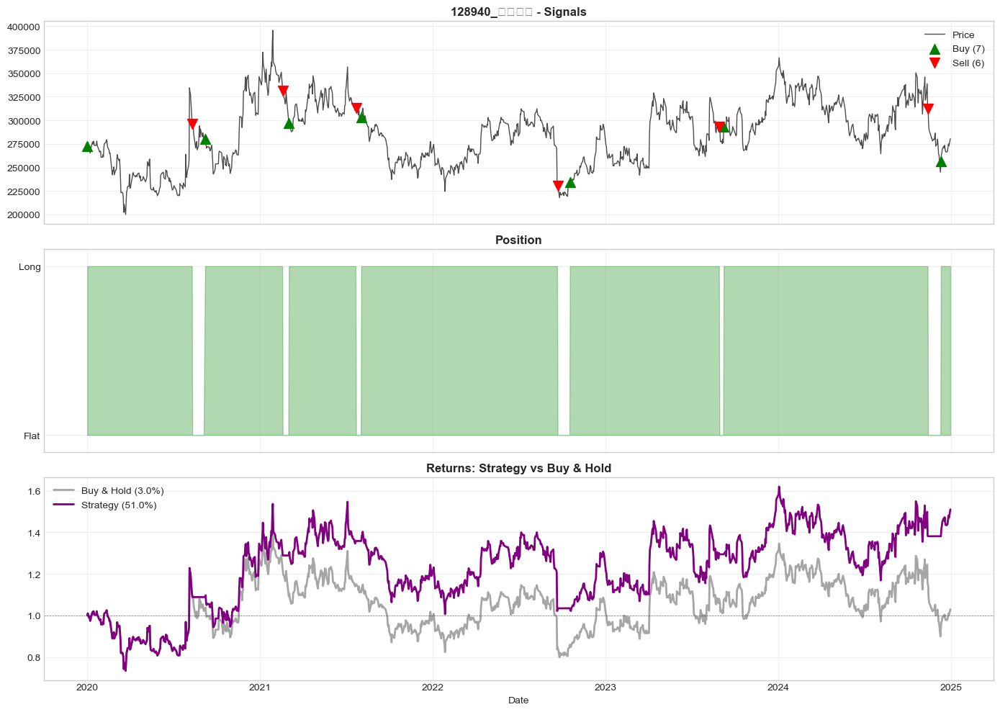


✓ Complete

[196/200] 138930_BS금융지주.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 7470.00 → 10340.00

Strategy:    4.32%  |  Market:   38.42%  |  Excess:  -34.10%
Sharpe:     0.129  |  Max DD:  -49.07%  |  Win:  48.3%  |  Trades:   8

First 5 trades:
  2020-02-03: BUY
  2020-03-25: SELL
  2020-06-02: BUY
  2020-06-22: SELL
  2020-07-29: BUY


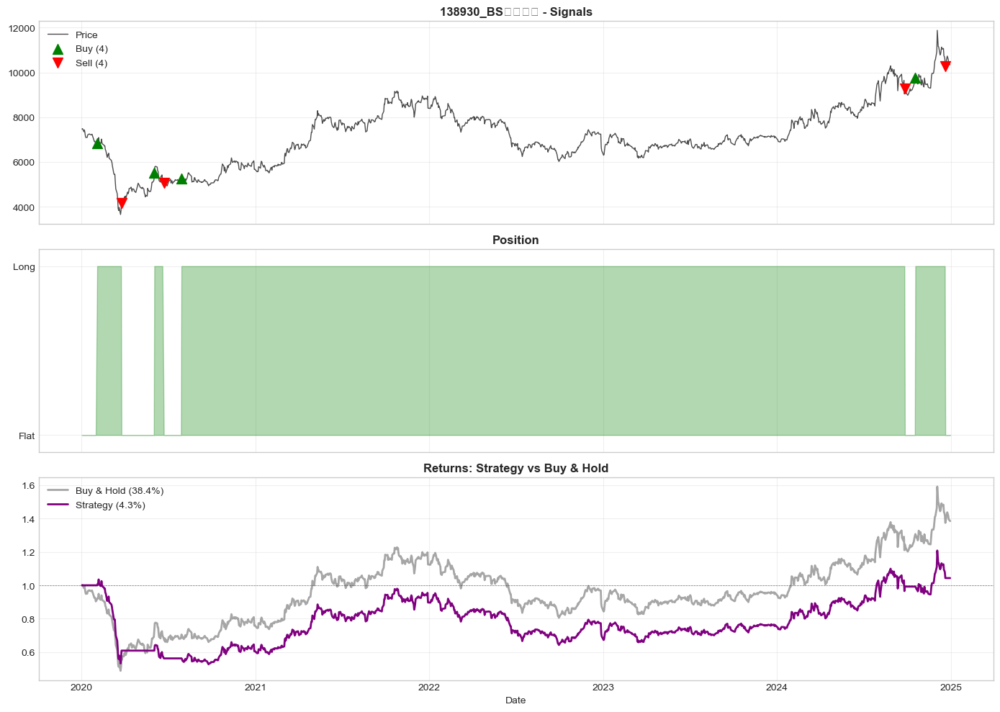


✓ Complete

[197/200] 139480_이마트.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 125500.00 → 63400.00

Strategy:  -55.44%  |  Market:  -49.48%  |  Excess:   -5.96%
Sharpe:    -0.229  |  Max DD:  -65.29%  |  Win:  42.4%  |  Trades:  20

First 5 trades:
  2020-01-02: BUY
  2020-03-18: SELL
  2020-05-29: BUY
  2020-09-04: SELL
  2020-09-10: BUY


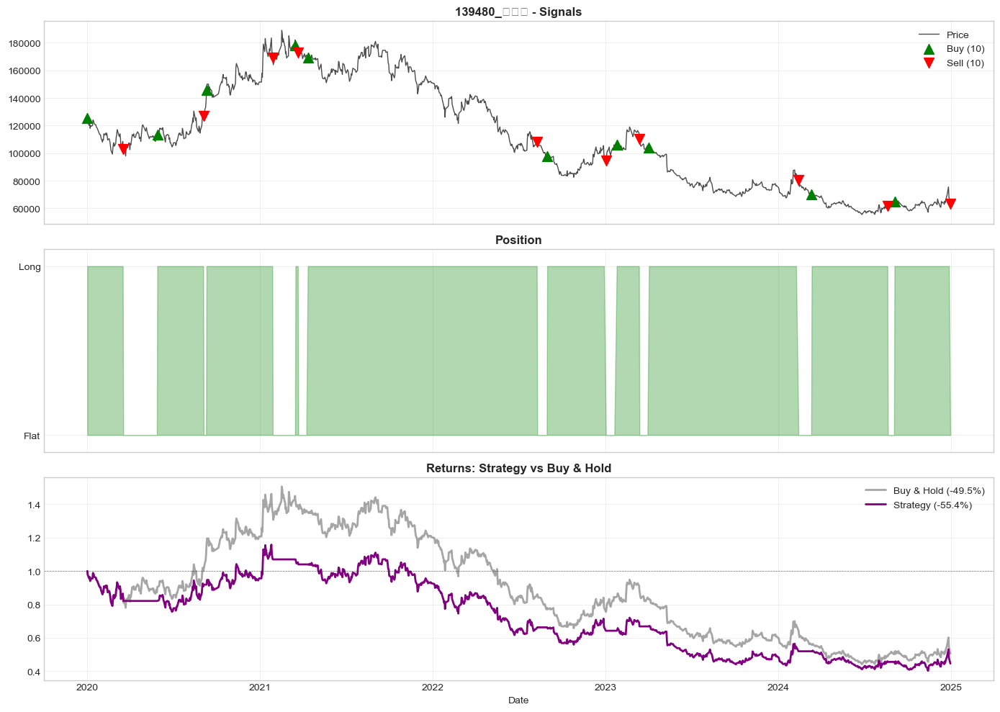


✓ Complete

[198/200] 161390_한국타이어.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 32450.00 → 38400.00

Strategy:  -27.46%  |  Market:   18.34%  |  Excess:  -45.80%
Sharpe:     0.101  |  Max DD:  -56.59%  |  Win:  46.3%  |  Trades:  21

First 5 trades:
  2020-01-02: BUY
  2020-03-24: SELL
  2020-05-26: BUY
  2020-06-15: SELL
  2020-07-30: BUY


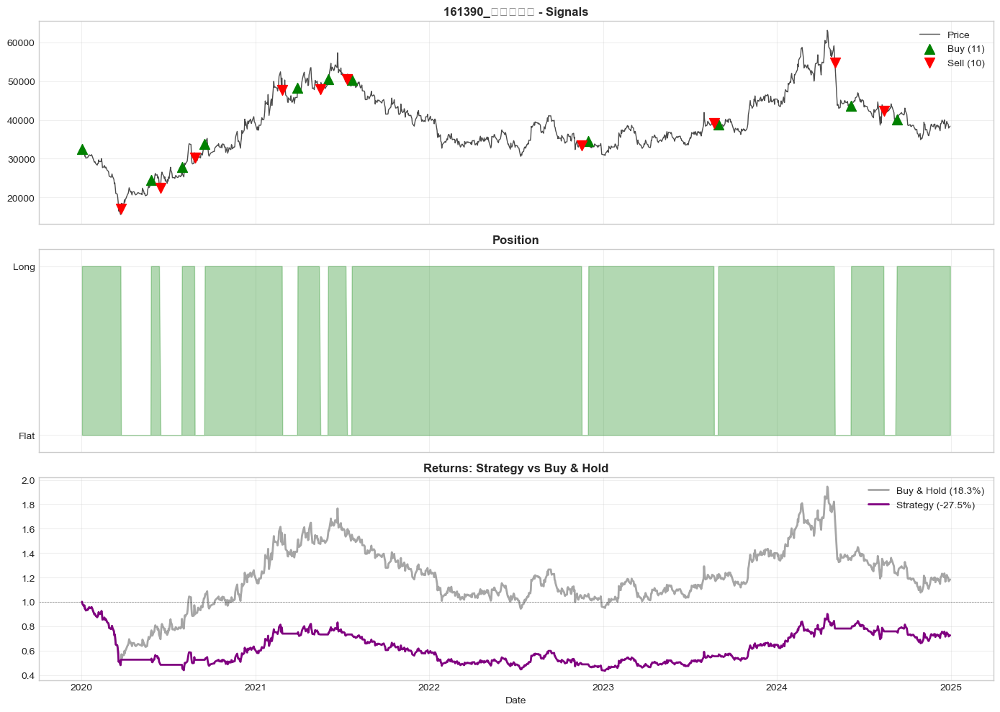


✓ Complete

[199/200] 161890_한국콜마.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 48500.00 → 55100.00

Strategy:   16.20%  |  Market:   13.61%  |  Excess:    2.59%
Sharpe:     0.532  |  Max DD:  -43.30%  |  Win:  45.5%  |  Trades:  24

First 5 trades:
  2020-02-20: BUY
  2020-03-03: SELL
  2020-04-10: BUY
  2020-06-24: SELL
  2020-06-30: BUY


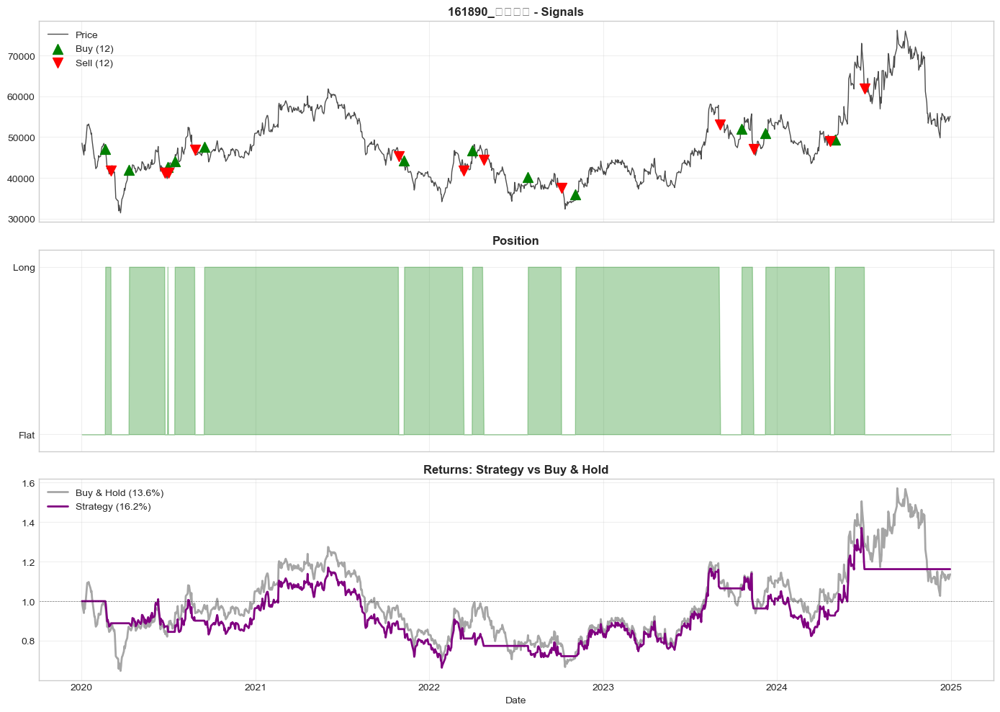


✓ Complete

[200/200] 170900_동아에스티.parquet
Data: 1231 days (2020-01-02 to 2024-12-30)
Price: 109507.00 → 57676.00

Strategy:  -32.32%  |  Market:  -47.33%  |  Excess:   15.01%
Sharpe:    -0.053  |  Max DD:  -54.69%  |  Win:  46.2%  |  Trades:   7

First 5 trades:
  2020-01-02: BUY
  2020-08-26: SELL
  2020-09-09: BUY
  2021-07-23: SELL
  2021-08-20: BUY


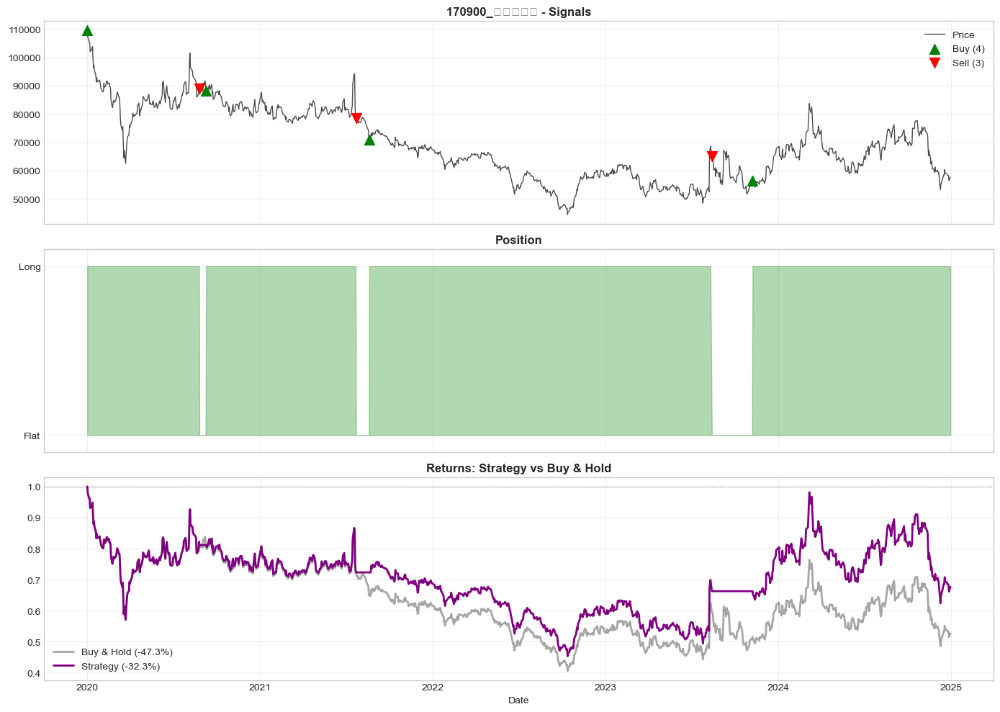


✓ Complete

SUMMARY

            stock     return     market      excess    sharpe     max_dd  win_rate  trades
      000030_우리은행        NaN        NaN         NaN       NaN        NaN       NaN       0
     000070_삼양홀딩스  17.568579  -2.674297   20.242876  0.316719 -53.916809 45.646438       7
     000080_하이트진로 -44.931345 -32.456747  -12.474597 -0.280318 -62.627564 44.215247      11
      000100_유한양행 199.735145 207.838945   -8.103799  0.922746 -30.903248 44.552702      12
    000120_CJ대한통운 -42.659609 -44.655738    1.996129 -0.351218 -64.486435 42.857143      35
  000140_하이트진로홀딩스  -6.649174 -31.060606   24.411432  0.030007 -56.692146 43.518519      11
        000150_두산 133.093574 270.101597 -137.008023  0.945115 -67.025080 45.820433      29
      000210_대림산업 -70.311659 -60.169908  -10.141751 -0.438894 -71.157213 42.439863      11
000240_한국타이어월드와이드 -39.092108  20.857143  -59.949251  0.105239 -62.700974 45.414462      11
       000270_기아차  56.352492 136.941176  -80.588684  0.570066 -50.46

In [7]:
# ===== EXECUTION =====

results = []

for i, file_path in enumerate(stock_files, 1):
    stock_name = file_path.stem
    
    print("="*80)
    print(f"[{i}/{len(stock_files)}] {file_path.name}")
    print("="*80)
    
    try:
        # Load
        ohlcv = load_ohlcv(file_path, START_DATE, END_DATE)
        print(f"Data: {len(ohlcv)} days ({ohlcv.index[0].date()} to {ohlcv.index[-1].date()})")
        print(f"Price: {ohlcv['Close'].iloc[0]:.2f} → {ohlcv['Close'].iloc[-1]:.2f}")
        
        # Backtest
        result = backtest(strategy, ohlcv)
        m = result['metrics']
        
        # Metrics
        print(f"\nStrategy: {m['total_return']:>7.2f}%  |  Market: {m['market_return']:>7.2f}%  |  Excess: {m['total_return']-m['market_return']:>7.2f}%")
        print(f"Sharpe: {m['sharpe']:>9.3f}  |  Max DD: {m['max_dd']:>7.2f}%  |  Win: {m['win_rate']:>5.1f}%  |  Trades: {m['trades']:>3}")
        
        # Trades
        if len(result['trade_log']) > 0:
            print("\nFirst 5 trades:")
            for _, t in result['trade_log'].head(5).iterrows():
                print(f"  {t['date'].date()}: {t['action']}")
        
        # Plot
        if SHOW_PLOTS:
            plot_results(result, stock_name)
        
        # Save
        results.append({
            'stock': stock_name,
            'return': m['total_return'],
            'market': m['market_return'],
            'excess': m['total_return'] - m['market_return'],
            'sharpe': m['sharpe'],
            'max_dd': m['max_dd'],
            'win_rate': m['win_rate'],
            'trades': m['trades']
        })
        
        print("\n✓ Complete\n")
        
    except Exception as e:
        print(f"\n✗ ERROR: {e}\n")
        results.append({
            'stock': stock_name, 'return': np.nan, 'market': np.nan,
            'excess': np.nan, 'sharpe': np.nan, 'max_dd': np.nan,
            'win_rate': np.nan, 'trades': 0
        })

# ===== SUMMARY =====
print("="*80)
print("SUMMARY")
print("="*80)

df = pd.DataFrame(results)
print("\n" + df.to_string(index=False))

valid = df.dropna()
if len(valid) > 0:
    print("\n" + "="*80)
    print(f"Avg Return:    {valid['return'].mean():>7.2f}%  (Market: {valid['market'].mean():>7.2f}%)")
    print(f"Avg Excess:    {valid['excess'].mean():>7.2f}%")
    print(f"Avg Sharpe:    {valid['sharpe'].mean():>7.3f}")
    print(f"Avg Max DD:    {valid['max_dd'].mean():>7.2f}%")
    print(f"Outperform:    {(valid['excess'] > 0).sum()}/{len(valid)} stocks ({(valid['excess'] > 0).mean()*100:.1f}%)")

print("\n✓ Done")